# Faster R-CNN: A Classic Two-Stage Anchor-Based Object Detector

In this exercise you will implement a **two-stage** object detector, based on [Faster R-CNN](https://arxiv.org/pdf/1506.01497.pdf), which consists of two modules - Region Proposal Networks (RPN) and Fast R-CNN.
Like one-stage detector in the first part of our assignment,
we will train it to detect a set of object classes and evaluate the detection accuracy using the classic metric mean Average Precision ([mAP](https://github.com/Cartucho/mAP)).

# Getting Started

## Setup Code
Before getting started, we need to run some boilerplate code to set up our environment, same as previous assignments. You'll need to rerun this setup code each time you start the notebook.

First, run this cell load the autoreload extension. This allows us to edit .py source files, and re-import them into the notebook for a seamless editing and debugging experience.

In [22]:
# !pip -q install matplotlib==3.5

In [23]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


### Google Colab Setup
Next we need to run a few commands to set up our environment on Google Colab. If you are running this notebook on a local machine you can skip this section.

Run the following cell to mount your Google Drive. Follow the link, sign in to your Google account (the same account you used to store this notebook!) and copy the authorization code into the text box that appears below.

In [24]:
# try:
#     import google.colab as colab
#     print('Upload the fcos.py and two_stage_detector.py file with your solution')
#     colab.files.upload()
# except:
#     print('Failed to uplaod fcos.py, try doing it manually.')

# # Load the library files
# !mkdir -p lib
# !wget --quiet "https://raw.githubusercontent.com/puhsu/dl-hse/main/week03-detection2/shw3/lib/__init__.py" -O "lib/__init__.py"
# !wget --quiet "https://raw.githubusercontent.com/puhsu/dl-hse/main/week03-detection2/shw3/lib/train.py" -O "lib/train.py"
# !wget --quiet "https://raw.githubusercontent.com/puhsu/dl-hse/main/week03-detection2/shw3/lib/grad.py" -O "lib/grad.py"
# !wget --quiet "https://raw.githubusercontent.com/puhsu/dl-hse/main/week03-detection2/shw3/lib/data.py" -O "lib/data.py"
# !wget --quiet "https://raw.githubusercontent.com/puhsu/dl-hse/main/week03-detection2/shw3/lib/utils.py" -O "lib/utils.py"

Load several useful packages that are used in this notebook:

In [25]:
import os
import time

import matplotlib.pyplot as plt
import torch
import torchvision

%matplotlib inline

from lib.utils import *
from lib import reset_seed
from lib.grad import rel_error

# for plotting
plt.rcParams["figure.figsize"] = (10.0, 8.0)  # set default size of plots
plt.rcParams["font.size"] = 16
plt.rcParams["image.interpolation"] = "nearest"
plt.rcParams["image.cmap"] = "gray"

# To download the dataset
!pip install wget

# for mAP evaluation
!rm -rf mAP
!git clone https://github.com/Cartucho/mAP.git
!rm -rf mAP/input/*

Cloning into 'mAP'...
remote: Enumerating objects: 908, done.
remote: Counting objects: 100% (150/150), done.
remote: Compressing objects: 100% (25/25), done.
remote: Total 908 (delta 135), reused 125 (delta 125), pack-reused 758 (from 1)
Receiving objects: 100% (908/908), 14.70 MiB | 29.29 MiB/s, done.
Resolving deltas: 100% (329/329), done.


We will use GPUs to accelerate our computation in this notebook. Run the following to make sure GPUs are enabled:

In [26]:
if torch.cuda.is_available():
    print("Good to go!")
    DEVICE = torch.device("cuda")
else:
    print("Please set GPU via Edit -> Notebook Settings.")
    DEVICE = torch.device("cpu")

Good to go!


## Load PASCAL VOC 2007 data
As in the previous notebook, we will use PASCAL VOC 2007 dataset to train our model. The following two cells are exactly same as those in `one_stage_detector.ipynb`:

In [27]:
import multiprocessing

# Set a few constants related to data loading.
NUM_CLASSES = 20
BATCH_SIZE = 16
IMAGE_SHAPE = (224, 224)
NUM_WORKERS = multiprocessing.cpu_count()

In [28]:
# # Download the dataset
# !wget --quiet --show-progress "https://web.eecs.umich.edu/~justincj/data/VOCtrainval_06-Nov-2007.tar"
# !wget --quiet "https://web.eecs.umich.edu/~justincj/data/voc07_train.json"
# !wget --quiet "https://web.eecs.umich.edu/~justincj/data/voc07_val.json"

# !tar -xf "VOCtrainval_06-Nov-2007.tar"

In [29]:
from lib.data import VOC2007DetectionTiny

PATH = os.getcwd()
train_dataset = VOC2007DetectionTiny(
    PATH, "train", image_size=IMAGE_SHAPE[0],
    download=False  # True (for the first time)
)
val_dataset = VOC2007DetectionTiny(PATH, "val", image_size=IMAGE_SHAPE[0])

print(f"Dataset sizes: train ({len(train_dataset)}), val ({len(val_dataset)})")

Dataset sizes: train (2501), val (2510)


Now we wrap these dataset objects with PyTorch dataloaders, similar to `one_stage_detector.ipynb`. The format of output batches will also be same as what you have seen before:

In [30]:
# `pin_memory` speeds up CPU-GPU batch transfer, `num_workers=NUM_WORKERS` loads data
# on the main CPU process, suitable for Colab.
train_loader = torch.utils.data.DataLoader(
    train_dataset, batch_size=BATCH_SIZE, pin_memory=True, num_workers=NUM_WORKERS
)

# Use batch_size = 1 during inference - during inference we do not center crop
# the image to detect all objects, hence they may be of different size. It is
# easier and less redundant to use batch_size=1 rather than zero-padding images.
val_loader = torch.utils.data.DataLoader(
    val_dataset, batch_size=1, pin_memory=True, num_workers=NUM_WORKERS
)

train_loader_iter = iter(train_loader)
image_paths, images, gt_boxes = next(train_loader_iter)

print(f"image paths           : {image_paths}")
print(f"image batch has shape : {images.shape}")
print(f"gt_boxes has shape    : {gt_boxes.shape}")

print(f"Five boxes per image  :")
print(gt_boxes[:, :5, :])

image paths           : ['/home/jovyan/free001style/diffusion/HW3/VOCdevkit/VOC2007/JPEGImages/000012.jpg', '/home/jovyan/free001style/diffusion/HW3/VOCdevkit/VOC2007/JPEGImages/000017.jpg', '/home/jovyan/free001style/diffusion/HW3/VOCdevkit/VOC2007/JPEGImages/000023.jpg', '/home/jovyan/free001style/diffusion/HW3/VOCdevkit/VOC2007/JPEGImages/000026.jpg', '/home/jovyan/free001style/diffusion/HW3/VOCdevkit/VOC2007/JPEGImages/000032.jpg', '/home/jovyan/free001style/diffusion/HW3/VOCdevkit/VOC2007/JPEGImages/000033.jpg', '/home/jovyan/free001style/diffusion/HW3/VOCdevkit/VOC2007/JPEGImages/000034.jpg', '/home/jovyan/free001style/diffusion/HW3/VOCdevkit/VOC2007/JPEGImages/000035.jpg', '/home/jovyan/free001style/diffusion/HW3/VOCdevkit/VOC2007/JPEGImages/000036.jpg', '/home/jovyan/free001style/diffusion/HW3/VOCdevkit/VOC2007/JPEGImages/000042.jpg', '/home/jovyan/free001style/diffusion/HW3/VOCdevkit/VOC2007/JPEGImages/000044.jpg', '/home/jovyan/free001style/diffusion/HW3/VOCdevkit/VOC2007/JPE

## Visualize PASCAL VOC 2007

We will visualize a few images and their GT boxes, just to make sure that everything is loaded properly. You would have already seen these visualizations (and the code snippet below) in `one_stage_detector.ipynb`.

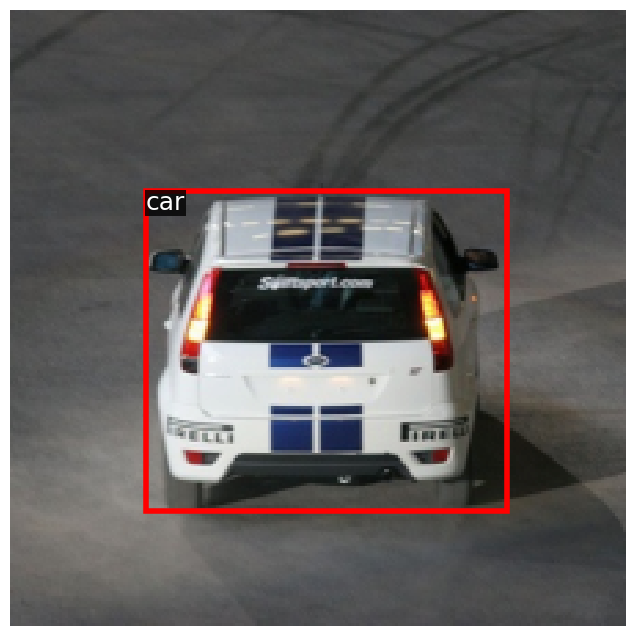

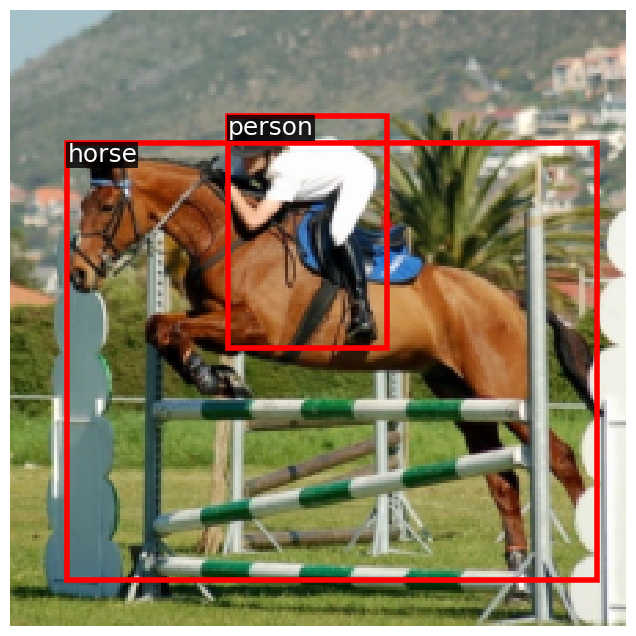

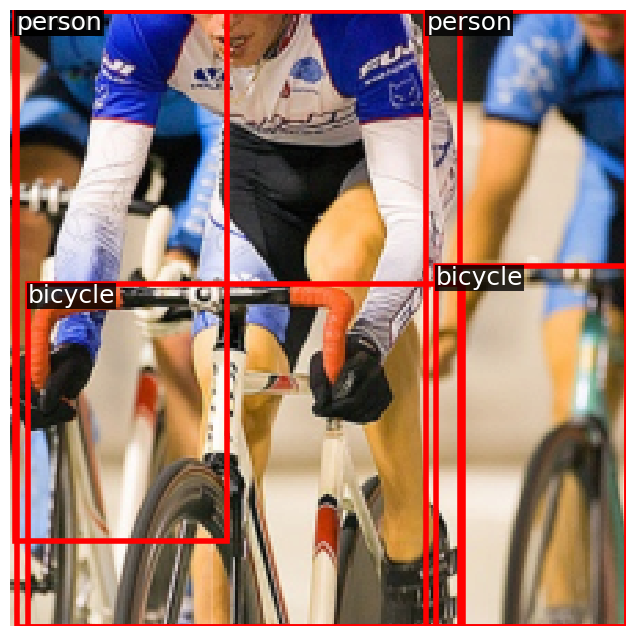

In [31]:
from torchvision import transforms
from lib.utils import detection_visualizer

inverse_norm = transforms.Compose(
    [
        transforms.Normalize(mean=[0., 0., 0.], std=[1 / 0.229, 1 / 0.224, 1 / 0.225]),
        transforms.Normalize(mean=[-0.485, -0.456, -0.406], std=[1., 1., 1.]),
    ]
)

for idx, (_, image, gt_boxes) in enumerate(train_dataset):
    if idx > 2:
        break

    image = inverse_norm(image)
    is_valid = gt_boxes[:, 4] >= 0
    detection_visualizer(image, val_dataset.idx_to_class, gt_boxes[is_valid])

## Backbone with Feature Pyramid Networks (FPN)

Faster R-CNN uses a convolutional backbone with FPN in the exact same way as you implemented in FCOS. So you can directly re-use it for this part of the assignment.

**NOTE:** Typical state-of-the-art detectors based o nFaster R-CNN use four multi-scale features from different FPN levels — `(p2, p3, p4, p5)` with strides `(4, 8, 16, 32)`.
Due to computational limits of Google Colab, we will instead simply use `(p3, p4, p5)` features like FCOS.
In all your implementations for this part, you may assume that you will receive features from these three FPN levels (and may hard-code these names as Python strings). Your code will not be tested with `p2` FPN features and you will not lose points.

In [32]:
import torch
from fcos import DetectorBackboneWithFPN
from two_stage_detector import RPNPredictionNetwork


backbone = DetectorBackboneWithFPN(out_channels=64)

# Pass a batch of dummy images (random tensors) in NCHW format and observe the output.
dummy_images = torch.randn(2, 3, 224, 224)

# Collect dummy output.
dummy_fpn_feats = backbone(dummy_images)

For dummy input images with shape: (2, 3, 224, 224)
Shape of c3 features: torch.Size([2, 64, 28, 28])
Shape of c4 features: torch.Size([2, 160, 14, 14])
Shape of c5 features: torch.Size([2, 400, 7, 7])


## Faster R-CNN first stage: Region Proposal Network (RPN)

We will now implement the first-stage of Faster R-CNN. It comprises a **Region Proposal Network (RPN)** that learns to predict general _object proposals_, which will then be used by the second stage to make final predictions.

**RPN prediction:** An input image is passed through the backbone and we obtain its FPN feature maps `(p3, p4, p5)`.
The RPN predicts multiple values at _every location on FPN features_. Faster R-CNN is _anchor-based_ — the model assumes that every location has multiple pre-defined boxes (called "anchors") and it predicts two measures per anchor, per FPN location:

1. **Objectness:** The likelihood of having _any_ object inside the anchor. This is similar to classification head in FCOS, except that this is _class-agnostic_: it only performs binary foreground/background classification.
2. **Box regression deltas:** 4-D "deltas" that _transform_ an anchor at that location to a ground-truth box.

![pred_scores2](https://miro.medium.com/max/918/1*wB3ctS9WGNmw6pP_kjLjgg.png)

**SIDE NOTE:** We will use the more common practice of predicting `k` logits and use a logistic regressor instead of `2k` scores (and 2-way softmax) as shown in Figure. This slightly reduces the number of trainable parameters.

This RPN is conceptually quite similar to a one-stage detector like FCOS.
The main differences with what you implemented in FCOS are: (1) RPN is anchor-based, and make predictions for multiple anchor boxes instead of location "points", (2) it performs class-agnostic object classification, and (3) it excludes centerness regression, which was inntroduced in FCOS itself, years after Faster R-CNN was published.

Like we saw in FCOS, each anchor will be matched with a GT box for supervision — we will get to it shortly.
For now, let's assume there are some `A` anchor boxes at every FPN location, and implement an RPN module.
Structurally, this module is similar to FCOS prediction network.
Now follow the instructions in `RPNPredictionNetwork` of `two_stage_detector.py` and implement layers to predict objectness and box regression deltas.
Execute the following cell to test your implementation:

In [33]:
from two_stage_detector import RPNPredictionNetwork

rpn_pred_net = RPNPredictionNetwork(
    in_channels=64, stem_channels=[64], num_anchors=3
)

# Pass the dummy FPN feats to RPN prediction network and view its output shapes.
dummy_rpn_obj, dummy_rpn_box = rpn_pred_net(dummy_fpn_feats)

# Few expected outputs:
# Shape of p4 RPN objectness: torch.Size([2,  588])
# Shape of p5 RPN box deltas: torch.Size([2, 147, 4])

print(f"\nFor dummy input images with shape: {dummy_images.shape}")
for level_name in dummy_fpn_feats.keys():
    print(f"Shape of {level_name} FPN features  : {dummy_fpn_feats[level_name].shape}")
    print(f"Shape of {level_name} RPN objectness: {dummy_rpn_obj[level_name].shape}")
    print(f"Shape of {level_name} RPN box deltas: {dummy_rpn_box[level_name].shape}")
    print("")


For dummy input images with shape: torch.Size([2, 3, 224, 224])
Shape of p3 FPN features  : torch.Size([2, 64, 28, 28])
Shape of p3 RPN objectness: torch.Size([2, 2352])
Shape of p3 RPN box deltas: torch.Size([2, 2352, 4])

Shape of p4 FPN features  : torch.Size([2, 64, 14, 14])
Shape of p4 RPN objectness: torch.Size([2, 588])
Shape of p4 RPN box deltas: torch.Size([2, 588, 4])

Shape of p5 FPN features  : torch.Size([2, 64, 7, 7])
Shape of p5 RPN objectness: torch.Size([2, 147])
Shape of p5 RPN box deltas: torch.Size([2, 147, 4])



## Anchor-based Training of RPN

Now that we implemented this RPN head, our goal is to have it predict _high objectness_ and _accurate box deltas_ for anchors that are likely to contain objects.
Similar to first part of our assignment, we need to assign a target GT box to every RPN prediction for training supervision.

**Recall FCOS location matching:** FCOS matched every FPN feature map location with a GT box (or marked them background), based on a heuristic that a location whether that location was _inside_ any GT Box.
On the other hand, Faster R-CNN is anchor-based: instead of _locations_, it makes predictions with reference to some pre-defined _anchor boxes_, and matches each anchor with a single GT box if they have a high enough Intersection-over-Union (IoU).

In the next few cells, we will perform the following steps, which are procedurally very similar to what you have already done with FCOS:

1. **Anchor generation:** Generate a set of anchors for every location in FPN feature map.
2. **Anchor to GT matching:** Match these anchors with GT boxes based on their IoU-overlap.
3. **Format of box deltas:** Implement the tranformation functions to obtain _box deltas_ from GT boxes (model training supervision) and apply deltas to anchors (final proposal boxes for second stage).

Let's approach these steps, one at a time.

### Anchor Generation

Recall that you already implemented a function to get the absolute image co-ordinates of FPN feature map locations, for FCOS — in `get_fpn_location_coords` of `common.py`.
First we need to form multiple anchor boxes centered at these locations.
RPN defines square anchor boxes of size `scale * stride` at every location, where `stride` is the FPN level stride, and `scale` is a hyperparameter.
For example, anchor boxes for P5 level (`stride = 32`), with `scale = 2` will be boxes of `(64 x 64)` pixels.
RPN also considers anchors of different aspect ratios, apart from square anchor boxes —
follow the instructions in `generate_fpn_anchors` of `two_stage_detector.py` to implement creation of multiple anchor boxes per location.

Execute the next cell to verify your implementation:

In [34]:
from fcos import get_fpn_location_coords
from two_stage_detector import generate_fpn_anchors


# Sanity check: Get 2x2 location co-ordinates of p5 (original shape is 7x7).
locations = get_fpn_location_coords(
    shape_per_fpn_level={"p5": (2, 64, 2, 2)}, strides_per_fpn_level={"p5": 32}
)

print("P5 locations:\n", locations["p5"])

# Generate anchors for these locations.
anchors = generate_fpn_anchors(
    locations_per_fpn_level=locations,
    strides_per_fpn_level={"p5": 32},
    stride_scale=2,
    aspect_ratios=[0.5, 1.0, 2.0],
)

print("P5 anchors with different aspect ratios:")
print("P5 1:2 anchors:\n", anchors["p5"][0::3, :], "\n")
# Expected (any ordering is fine):
# [-29.2548,  -6.6274,  61.2548,  38.6274]
# [-29.2548,  25.3726,  61.2548,  70.6274]
# [  2.7452,  -6.6274,  93.2548,  38.6274]
# [  2.7452,  25.3726,  93.2548,  70.6274]

print("P5 1:1 anchors:\n", anchors["p5"][1::3, :], "\n")
# Expected (any ordering is fine):
# [-16., -16.,  48.,  48.]
# [-16.,  16.,  48.,  80.]
# [ 16., -16.,  80.,  48.]
# [ 16.,  16.,  80.,  80.]

print("P5 2:1 anchors:\n", anchors["p5"][2::3, :], "\n")
# Similar to 1:2 anchors, but with flipped co-ordinates

P5 locations:
 tensor([[16., 16.],
        [48., 16.],
        [16., 48.],
        [48., 48.]])
P5 anchors with different aspect ratios:
P5 1:2 anchors:
 tensor([[-29.2548,  -6.6274,  61.2548,  38.6274],
        [-29.2548,  25.3726,  61.2548,  70.6274],
        [  2.7452,  -6.6274,  93.2548,  38.6274],
        [  2.7452,  25.3726,  93.2548,  70.6274]]) 

P5 1:1 anchors:
 tensor([[-16., -16.,  48.,  48.],
        [-16.,  16.,  48.,  80.],
        [ 16., -16.,  80.,  48.],
        [ 16.,  16.,  80.,  80.]]) 

P5 2:1 anchors:
 tensor([[ -6.6274, -29.2548,  38.6274,  61.2548],
        [ -6.6274,   2.7452,  38.6274,  93.2548],
        [ 25.3726, -29.2548,  70.6274,  61.2548],
        [ 25.3726,   2.7452,  70.6274,  93.2548]]) 



### Matching anchor boxes with GT boxes

Similar to FCOS, we will now match these generated anchors with GT boxes. Faster R-CNN matches some `N` anchor boxes with `M` GT boxes by applying a simple rule:

> Anchor box $N_i$ is matched with box $M_i$ if it has an IoU overlap higher than 0.6 with that box. For multiple such GT boxes, the anchor is assigned with the GT box that has the highest IoU. Note that a single ground-truth box may assign positive labels to multiple anchors.

**NOTE:** _Faster R-CNN uses 0.7 default threshold_ as mentioned in the lecture slides. We use a lower threeshold to increase the number of positive matches for sampling — this helps in speeding up training in a resource constrained setting like Google Colab.

Anchor boxes with `IoU < 0.3` with ALL GT boxes is assigned background GT box `(-1, -1, -1, -1, -1)`. All other anchors with IoU between `(0.3, 0.6)` are considered "neutral" and ignored during training. This matching differs from FCOS, which assigns ALL anchors to either object or background — the "neutral" Faster R-CNN anchors cause wasted computation, and removing this redundancy would overly complicate our implementation.

We have implemented this matching procedure for you — see `rcnn_match_anchors_to_gt` of `two_stage_detector.py`.
Read its documentation to understand its input/output format, it is slightly different than `fcos_match_locations_to_gt`.
It serves the same purpose as location matching in FCOS — to define GT targets for model predictions during training.

This function internally requires IoU computation between all anchors and GT boxes — which you have to implement.
Follow the instructions in `two_stage_detector.py` to implement IoU computation, and execute the next cell for a sanity check — you should observe an error of `1e-7` or less

In [35]:
import torch
from two_stage_detector import iou


boxes1 = torch.Tensor([[10, 10, 90, 90], [20, 20, 40, 40], [60, 60, 80, 80]])
boxes2 = torch.Tensor([[10, 10, 90, 90], [60, 60, 80, 80], [30, 30, 70, 70]])

expected_iou = torch.Tensor(
    [[1.0, 0.0625, 0.25], [0.0625, 0.0, 0.052631579], [0.0625, 1.0, 0.052631579]]
)
result_iou = iou(boxes1, boxes2)

print("Relative error:", rel_error(expected_iou, result_iou))

Relative error: 0.0


### Visualizing matched GT boxes

Now we apply our anchor matching function and visualize one GT box with a random matched positive anchor box.
You may try different images by indexing `train_dataset` below,
make sure to try different FPN levels as certain images may not get any matched GT boxes due to their size.

Unlabeled red box is positive anchor:


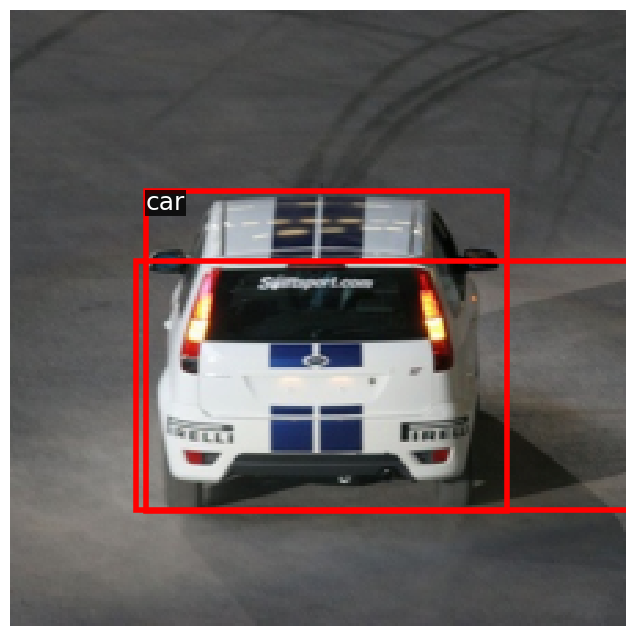

In [36]:
import random
from fcos import get_fpn_location_coords
from two_stage_detector import generate_fpn_anchors, rcnn_match_anchors_to_gt


# Sanity check: Match anchors of p4 level with GT boxes of first image
# in the training dataset.
_, image, gt_boxes = train_dataset[0]

FPN_LEVEL = "p4"
FPN_STRIDE = 16
locations = get_fpn_location_coords(
    shape_per_fpn_level={FPN_LEVEL: (2, 64, 224 // FPN_STRIDE, 224 // FPN_STRIDE)},
    strides_per_fpn_level={FPN_LEVEL: FPN_STRIDE}
)
# Generate anchors for these locations.
anchors = generate_fpn_anchors(
    locations_per_fpn_level=locations,
    strides_per_fpn_level={FPN_LEVEL: FPN_STRIDE},
    stride_scale=8,  # Default value used by Faster R-CNN
    aspect_ratios=[0.5, 1.0, 2.0],
)

matched_gt_boxes = rcnn_match_anchors_to_gt(
    anchors[FPN_LEVEL], gt_boxes, iou_thresholds=(0.3, 0.6)
)

# Flatten anchors and matched boxes:
anchors_p4 = anchors[FPN_LEVEL].view(-1, 4)
matched_boxes_p4 = matched_gt_boxes.view(-1, 5)

# Visualize one selected anchor and its matched GT box.
# NOTE: Run this cell multiple times to see different matched anchors. For car
# image, p3/5 will not work because the GT box was already assigned to p4.
fg_idxs_p4 = (matched_boxes_p4[:, 4] > 0).nonzero()
fg_idx = random.choice(fg_idxs_p4)

# Combine both boxes for visualization:
dummy_vis_boxes = [anchors_p4[fg_idx][0], matched_boxes_p4[fg_idx][0]]

print("Unlabeled red box is positive anchor:")
detection_visualizer(
    inverse_norm(image),
    val_dataset.idx_to_class,
    bbox=dummy_vis_boxes,
)

### GT Targets for box regression

Now we work on the third and final component needed to train our RPN — we define transformation functions for box regression deltas.
Recall in the first part of the assignment, you implemented two such functions for FCOS (quoting from `one_stage_detector.ipynb`):

> 1. `fcos_get_deltas_from_locations`: Accepts locations (centers) and GT boxes, and returns deltas. Required for training supervision.
> 2. `fcos_apply_deltas_to_locations`: Accepts predicted deltas and locations, and returns predicted boxes. Required during inference.

Here you will implement similar transformation functions for R-CNN, albeit with a different transformation logic than FCOS. You will find these transforms in [Lecture 13, slides 68-71](https://web.eecs.umich.edu/~justincj/slides/eecs498/WI2022/598_WI2022_lecture13.pdf), follow these and implement two functions in `two_stage_detector.py`:

1. `rcnn_get_deltas_from_anchors`: Accepts anchor boxes and GT boxes, and returns deltas. Required for training supervision.
2. `rcnn_apply_deltas_to_anchors`: Accepts predicted deltas and anchor boxes, and returns predicted boxes. Required during inference.

Run the following cell to check your implementation.

In [37]:
import torch
from two_stage_detector import rcnn_get_deltas_from_anchors, rcnn_apply_deltas_to_anchors

# Three hard-coded anchor boxes and GT boxes that have a fairly high overlap.
# Add a dummy class ID = 1 indicating foreground
input_anchors = torch.Tensor(
    [[20, 40, 80, 90], [10, 10, 50, 50], [120, 100, 200, 200]]
)
input_boxes = torch.Tensor(
    [[10, 15, 100, 115, 1], [30, 20, 40, 30, 1], [120, 100, 200, 200, 1]]
)

# Here we do a simple sanity check - getting deltas for a particular set of boxes
# and applying them back to anchors should give us the same boxes.
_deltas = rcnn_get_deltas_from_anchors(input_anchors, input_boxes)
print(_deltas)

output_boxes = rcnn_apply_deltas_to_anchors(_deltas, input_anchors)

print("Rel error in reconstructed boxes:", rel_error(input_boxes[:, :4], output_boxes.cpu()))

# Another check: deltas for GT class label = -1 should be -1e8
background_box = torch.Tensor([[-1, -1, -1, -1, -1]])
input_anchor = torch.Tensor([[100, 100, 200, 200]])
_deltas = rcnn_get_deltas_from_anchors(input_anchor, background_box)

output_box = rcnn_apply_deltas_to_anchors(_deltas, input_anchor)

print("Background deltas should be all -1e8  :", _deltas)
print("Output box should be -1e8 or lower    :", output_box)

tensor([[ 0.0833,  0.0000,  0.4055,  0.6931],
        [ 0.1250, -0.1250, -1.3863, -1.3863],
        [ 0.0000,  0.0000,  0.0000,  0.0000]])
Rel error in reconstructed boxes: 0.0
Background deltas should be all -1e8  : tensor([[-1.0000e-08, -1.0000e-08, -1.0000e-08, -1.0000e-08]])
Output box should be -1e8 or lower    : tensor([[-1.0000e-08, -1.0000e-08, -1.0000e-08, -1.0000e-08]])


## Loss Functions

With all predictions assigned with GT targets, we will proceed to compute losses for training the RPN.
Recall that you used [Focal Loss](https://arxiv.org/abs/1708.02002) for classification and L1 loss for box regression in FCOS.
Here, you will use L1 loss for box regression, similar to FCOS.

**Objectness classification loss:** Focal Loss was proposed in RetinaNet (2017) to deal with heavy class imbalance caused by "background". Faster R-CNN predates this paper — it dealt with class imbalance by randomly sampling roughly equal amount of foreground-background anchors to train RPN. We have implemented a very simple sampling function for you in `sample_rpn_training` function of `two_stage_detector.py` — you may directly use it while you piece all these components (coming up next).

**Total loss** is the sum of both loss components _per sampled anchor_, averaged by total number of foreground + background anchors.

Execute the next cell to quickly recap their usage — you have already seen these in the first part of this assignment.

In [38]:
import torch
from torch.nn import functional as F


# Sanity check: dummy predictions from model - box regression deltas and
# objectness logits for two anchors.
# shape: (batch_size, HWA, 4 or 1)
dummy_pred_boxreg_deltas = torch.randn(1, 2, 4)
dummy_pred_obj_logits = torch.randn(1, 2, 1)

# Dummy deltas and objectness targets. Let the second box be background.
# Dummy GT boxes (matched with both anchors).
dummy_gt_deltas = torch.randn_like(dummy_pred_boxreg_deltas)
dummy_gt_deltas[:, 1, :] = -1e8

# Background objectness targets should be 0 (not -1), and foreground
# should be 1. Neutral anchors will not occur here due to sampling.
dummy_gt_objectness = torch.Tensor([1, 0])

# Note that loss is not multiplied with 0.25 here:
loss_box = F.l1_loss(
    dummy_pred_boxreg_deltas, dummy_gt_deltas, reduction="none"
)

# No loss for background anchors:
loss_box[dummy_gt_deltas == -1e8] *= 0.0
print("Box regression loss (L1):", loss_box)

# Now calculate objectness loss.
loss_obj = F.binary_cross_entropy_with_logits(
    dummy_pred_obj_logits.view(-1), dummy_gt_objectness, reduction="none"
)
print("Objectness loss (BCE):", loss_obj)

Box regression loss (L1): tensor([[[1.3441, 0.5690, 0.9567, 0.4340],
         [0.0000, 0.0000, 0.0000, 0.0000]]])
Objectness loss (BCE): tensor([1.0531, 0.1466])


## Putting it all together: RPN module

Now you will put together all the things you have implemented into the `RPN` class in `two_stage_detector.py`.
Implement `forward` and `predict_proposals` functions of this module — you have already done most of the heavy lifting, you simply need to call all the functions in a correct way!
Use the previous two cells as a reference to implement loss calculation in `forward()`.

**TIP:** It may help if you draw analogies between the implementation logic in this module vs FCOS (`RPN.predict_proposals()` -> `FCOS.inference()`).

## Overfit small data

In Faster R-CNN, the RPN is trained jointly with the second-stage network.
However, to test our RPN implementation, we will first train just the RPN — this is basically a class-agnostic FCOS without centerness.
We will use the `train_detector` function that we used for training FCOS.
You can read its implementation in `a4_helper.py`.

The loss should generally do down, however the forward pass here is a bit slower than FCOS.

For dummy input images with shape: (2, 3, 224, 224)
Shape of c3 features: torch.Size([2, 64, 28, 28])
Shape of c4 features: torch.Size([2, 160, 14, 14])
Shape of c5 features: torch.Size([2, 400, 7, 7])
[Iter 0][loss: 0.945][loss_rpn_obj: 0.693][loss_rpn_box: 0.252]
[Iter 20][loss: 0.921][loss_rpn_obj: 0.686][loss_rpn_box: 0.236]
[Iter 40][loss: 0.920][loss_rpn_obj: 0.648][loss_rpn_box: 0.272]
[Iter 60][loss: 0.909][loss_rpn_obj: 0.657][loss_rpn_box: 0.252]
[Iter 80][loss: 0.881][loss_rpn_obj: 0.637][loss_rpn_box: 0.244]
[Iter 100][loss: 0.849][loss_rpn_obj: 0.610][loss_rpn_box: 0.239]
[Iter 120][loss: 0.825][loss_rpn_obj: 0.564][loss_rpn_box: 0.261]
[Iter 140][loss: 0.766][loss_rpn_obj: 0.517][loss_rpn_box: 0.249]
[Iter 160][loss: 0.678][loss_rpn_obj: 0.437][loss_rpn_box: 0.241]
[Iter 180][loss: 0.640][loss_rpn_obj: 0.360][loss_rpn_box: 0.280]
[Iter 200][loss: 0.688][loss_rpn_obj: 0.402][loss_rpn_box: 0.286]
[Iter 220][loss: 0.729][loss_rpn_obj: 0.484][loss_rpn_box: 0.244]
[Iter 240][l

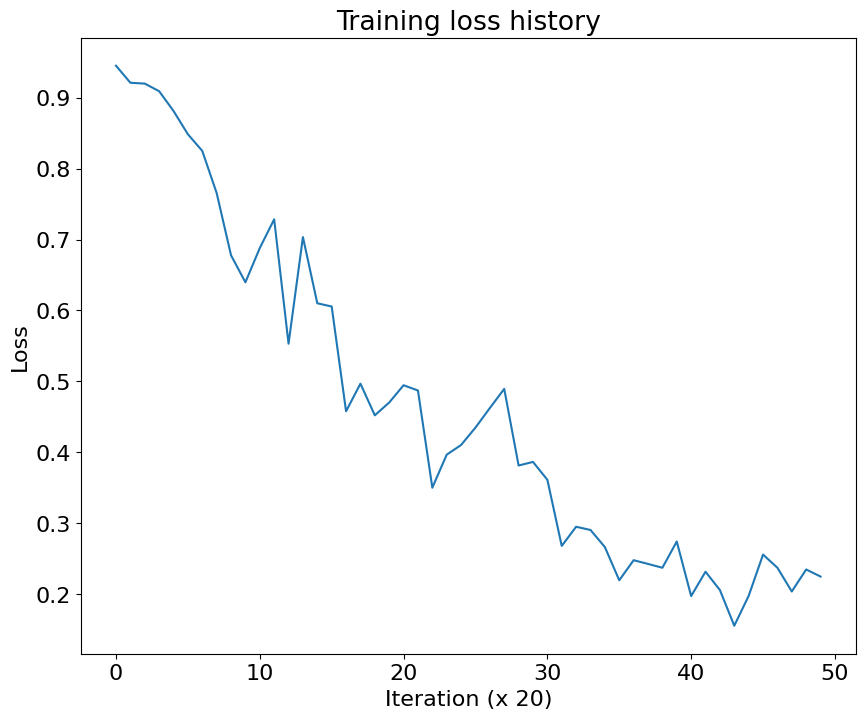

In [39]:
from torch import nn

from lib.train import train_detector
from fcos import DetectorBackboneWithFPN
from two_stage_detector import RPN
DEVICE='cuda'
reset_seed(0)

# Take equally spaced examples from training dataset to make a subset.
small_dataset = torch.utils.data.Subset(
    train_dataset,
    torch.linspace(0, len(train_dataset) - 1, steps=BATCH_SIZE * 10).long()
)
small_train_loader = torch.utils.data.DataLoader(
    small_dataset, batch_size=BATCH_SIZE, pin_memory=True, num_workers=NUM_WORKERS
)

# Create a wrapper module to contain backbone + RPN:
class FirstStage(nn.Module):
    def __init__(self, fpn_channels: int):
        super().__init__()
        self.backbone = DetectorBackboneWithFPN(out_channels=fpn_channels)
        self.rpn = RPN(
            fpn_channels=fpn_channels,
            # Simple stem of two layers:
            stem_channels=[fpn_channels, fpn_channels],
            batch_size_per_image=16,
            anchor_stride_scale=8,
            anchor_aspect_ratios=[0.5, 1.0, 2.0],
            anchor_iou_thresholds=(0.3, 0.6),
        )

    def forward(self, images, gt_boxes=None):
        feats_per_fpn_level = self.backbone(images)
        return self.rpn(feats_per_fpn_level, self.backbone.fpn_strides, gt_boxes)


first_stage = FirstStage(fpn_channels=64).to(DEVICE)

train_detector(
    first_stage,
    small_train_loader,
    learning_rate=8e-3,
    max_iters=1000,
    log_period=20,
    device=DEVICE,
)

# Faster R-CNN

We have implemented the first half of Faster R-CNN, i.e., RPN, which is class-agnostic. Here, we briefly describe the second half Fast R-CNN.

Given a set of proposal boxes from RPN (per FPN level, per image),
we warp each region from the correspondng map to a fixed size 7x7 by using [RoI Align](https://arxiv.org/pdf/1703.06870.pdf).
We will use the `roi_align` function from `torchvision`. For usage instructions, see https://pytorch.org/docs/stable/torchvision/ops.html#torchvision.ops.roi_align

For simplicity and computational constraints of Google Colab,
our two-stage detector here differs from a standard Faster R-CNN system in the second stage:
In a full implementation, the second stage of the network would predict a box deltas to further refine RPN proposals.
We omit this for simplicity and keep RPN proposal boxes as final predictions.
Your model will definitely perform better if you add an extra box regression head in second stage.

### Your implementation exercise

Read `FasterRCNN` class documentation and code to understand how everything is pieced together.
By now you have already implemented the core components of a typical object detection system - you have dealt with anchor boxes or locations (FCOS), matched them with GT boxes, supervised model with your matching, and wrote inference utilities like NMS.
Great work!

### Classification Loss: cross entropy

The classification loss for second-stage is a cross entropy loss — you would have seen this in A3, and it is a multi-class extension of binary cross entropy loss used in RPN objectness classification. You may use `torch.nn.functional.cross_entropy` directly — follow instructions in Python script.

Beyond these, the second stage of Faster R-CNN doesn't add anything that is conceptually new — hence your implementation exercise is fairly lightweight.
We have implemented most of this module for you. We left out a few 3-4 line TODO blocks, only because if we wrote them, they would given away the solution for prior exercises (RPN and FCOS).
Moreover, empty code blocks will encourage you to carefully read the remaining portions for making everything work.
Feel free to refer/re-use your own implementation from the first part of the assignment for filling these blocks.

## Overfit small data

After adding your implementation, overfit the model on a small dataset.

For dummy input images with shape: (2, 3, 224, 224)
Shape of c3 features: torch.Size([2, 64, 28, 28])
Shape of c4 features: torch.Size([2, 160, 14, 14])
Shape of c5 features: torch.Size([2, 400, 7, 7])
[Iter 0][loss: 4.053][loss_rpn_obj: 0.693][loss_rpn_box: 0.251][loss_cls: 3.110]
[Iter 10][loss: 3.394][loss_rpn_obj: 0.692][loss_rpn_box: 0.247][loss_cls: 2.454]
[Iter 20][loss: 2.381][loss_rpn_obj: 0.692][loss_rpn_box: 0.244][loss_cls: 1.445]
[Iter 30][loss: 2.128][loss_rpn_obj: 0.691][loss_rpn_box: 0.247][loss_cls: 1.189]
[Iter 40][loss: 2.110][loss_rpn_obj: 0.692][loss_rpn_box: 0.249][loss_cls: 1.169]
[Iter 50][loss: 2.083][loss_rpn_obj: 0.690][loss_rpn_box: 0.248][loss_cls: 1.145]
[Iter 60][loss: 2.090][loss_rpn_obj: 0.691][loss_rpn_box: 0.243][loss_cls: 1.157]
[Iter 70][loss: 2.101][loss_rpn_obj: 0.689][loss_rpn_box: 0.244][loss_cls: 1.167]
[Iter 80][loss: 2.091][loss_rpn_obj: 0.689][loss_rpn_box: 0.243][loss_cls: 1.159]
[Iter 90][loss: 2.069][loss_rpn_obj: 0.688][loss_rpn_box: 0.2

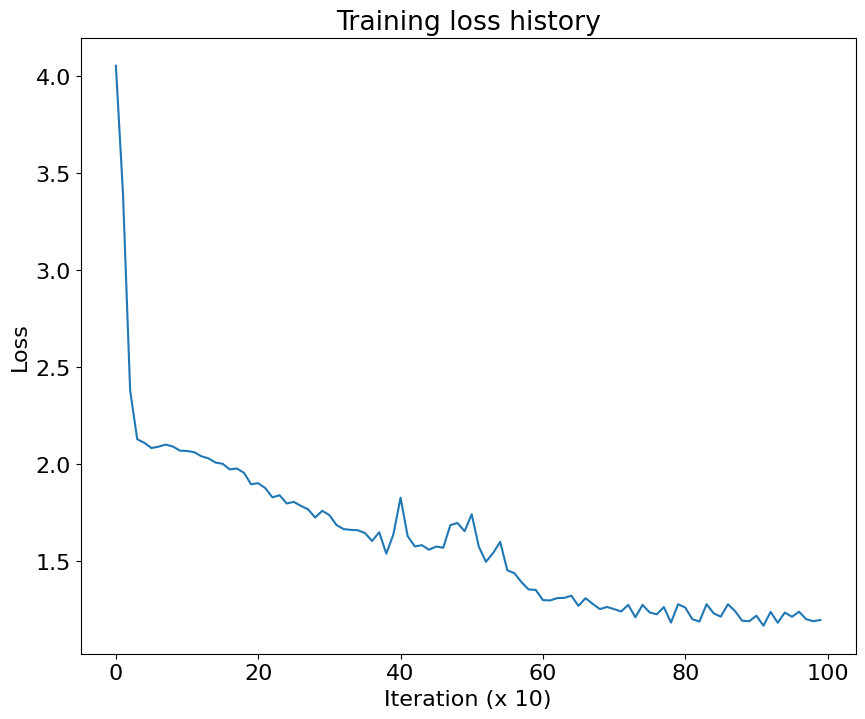

In [40]:
from two_stage_detector import FasterRCNN, RPN


# Re-initialize dataset objects for independent debugging.
small_dataset = torch.utils.data.Subset(
    train_dataset,
    torch.linspace(0, len(train_dataset) - 1, steps=BATCH_SIZE * 10).long()
)
small_train_loader = torch.utils.data.DataLoader(
    small_dataset, batch_size=BATCH_SIZE, pin_memory=True, num_workers=NUM_WORKERS
)

FPN_CHANNELS = 64
backbone = DetectorBackboneWithFPN(out_channels=FPN_CHANNELS)
rpn = RPN(
    fpn_channels=FPN_CHANNELS,
    stem_channels=[FPN_CHANNELS, FPN_CHANNELS],
    batch_size_per_image=16,
    anchor_stride_scale=8,
    anchor_aspect_ratios=[0.5, 1.0, 2.0],
    anchor_iou_thresholds=(0.3, 0.6),
    pre_nms_topk=400,
    post_nms_topk=80,
)
# fmt: off
faster_rcnn = FasterRCNN(
    backbone, rpn, num_classes=20, roi_size=(7, 7),
    stem_channels=[FPN_CHANNELS, FPN_CHANNELS],
    batch_size_per_image=32,
)
# fmt: on

train_detector(
    faster_rcnn,
    small_train_loader,
    learning_rate=0.001,
    max_iters=1000,
    log_period=10,
    device=DEVICE,
)

## Inference

Now, follow the instructions in `FasterRCNN.inference` to implement inference, similar to `FCOS.inference`.

Visualize the output from the trained model on a few images by executing the next cell, the bounding boxes should be somewhat accurate. They would get even better by using a bigger model and training it for longer.

tensor([[  0.0000, 169.0533, 134.4818, 224.0000],
        [  0.0000,  35.1648,  72.9425, 204.5837],
        [ 71.5840, 181.1616, 161.3143, 224.0000],
        [  0.0000, 100.8925,  87.2356, 224.0000],
        [  6.5817,   0.0000, 105.3676, 123.7260],
        [ 30.4277,   0.0000, 147.3224,  73.4257],
        [ 82.0324, 158.4416, 132.0151, 224.0000],
        [ 76.8105, 153.6775, 193.5756, 224.0000],
        [ 91.0636,   5.5370, 139.5362,  99.6140],
        [ 16.2384,   0.0000, 218.9013,  90.1363],
        [ 43.3047,   0.0000, 166.6991, 124.3948],
        [  2.7343, 134.5020, 201.4039, 224.0000],
        [ 73.8430,  29.3183, 159.8334,  75.4014],
        [ 94.5194,   0.0000, 211.3007,  73.1033],
        [ 39.2084, 115.7690, 136.6903, 224.0000],
        [ 87.3164,  85.7423, 184.7530, 224.0000],
        [ 17.8058,  38.4222, 218.1410, 138.4714],
        [ 26.5699,  51.4680, 152.8670, 186.7191],
        [ 67.5670, 108.9056, 163.0056, 156.0545],
        [ 86.1150,  98.7108, 147.0477, 168.7961],


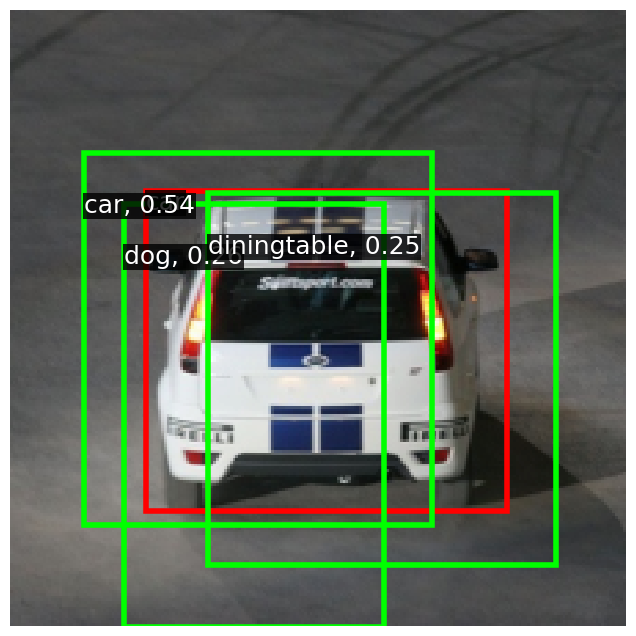

tensor([[ 45.9093, 152.8862, 163.4363, 224.0000],
        [  0.0000, 169.1863, 118.1755, 224.0000],
        [  0.0000,   0.0000,  71.1908,  93.8694],
        [  0.0000,   3.6972,  88.5053, 172.2328],
        [149.4764,   0.0000, 224.0000, 123.9508],
        [124.8445, 134.2841, 224.0000, 224.0000],
        [  0.0000,  56.7767, 121.1959, 154.6158],
        [ 22.5799, 115.1907, 120.2512, 224.0000],
        [  4.4091,   0.0000, 197.4415,  57.4192],
        [ 91.9300,   0.0000, 214.8502, 125.4645],
        [ 27.2236,  19.3515, 149.9393, 156.3258],
        [ 15.1718,  39.5858, 219.6490, 138.6503],
        [141.0257,  53.5597, 224.0000, 184.9718],
        [  0.0000, 119.6487, 186.5523, 218.1960],
        [ 38.1514,   0.0000, 135.6586,  93.6109],
        [ 71.0661,   5.2604, 169.7337, 171.7179],
        [ 98.4331,   0.0000, 147.7619,  90.6132],
        [ 99.6697,  71.2118, 147.4187, 160.6005],
        [ 54.8853,  52.0280, 153.6606, 217.3701],
        [  0.7809,  87.6086, 202.8322, 187.3003],


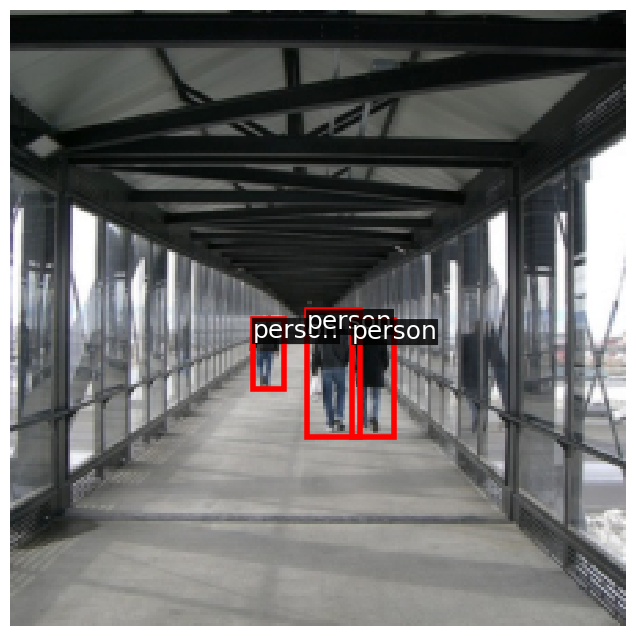

tensor([[ 42.1666, 169.1075, 224.0000, 224.0000],
        [  0.0000, 169.1129, 100.6322, 224.0000],
        [ 59.8536, 135.2324, 179.9642, 224.0000],
        [  0.0000, 114.2753,  72.3852, 224.0000],
        [119.0363, 116.5032, 216.1680, 224.0000],
        [ 22.8601, 115.6874, 119.1479, 224.0000],
        [ 18.4202, 119.0159, 216.1305, 217.0522],
        [ 38.7642,   0.0000, 224.0000,  56.7003],
        [ 54.5315,   0.0000, 150.1694,  94.9404],
        [  0.0000,   0.0000, 120.9637,  90.7634],
        [  5.8527,   7.4070, 201.4660, 105.5151],
        [ 83.6095,  88.1998, 224.0000, 185.5015],
        [ 71.0215,   0.0000, 167.2598, 140.0413],
        [102.5504,   0.0000, 200.6019, 110.3621],
        [ 85.9960,  36.7629, 183.9355, 204.2309],
        [  0.0000,  89.0715, 121.0475, 186.7058],
        [  0.0000,  39.5319, 185.4030, 137.9510],
        [ 38.7618,  53.1776, 137.3913, 221.6405],
        [  6.2918,   3.8343, 105.0920, 171.8413],
        [ 18.7659,  71.4007, 216.1325, 169.1111],


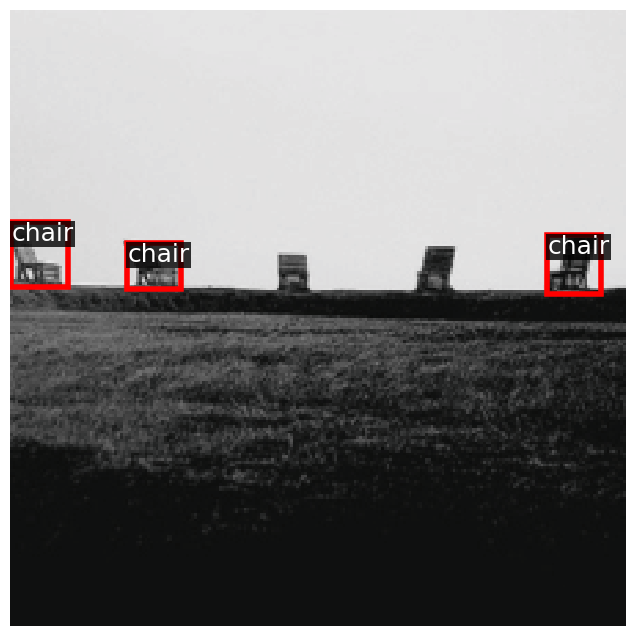

tensor([[  0.0000,  80.6308,  57.3717, 224.0000],
        [  0.0000, 153.5468, 101.7323, 224.0000],
        [ 61.1744, 133.6901, 181.2698, 224.0000],
        [  0.0000,   2.6876,  72.6776, 172.5508],
        [  0.0000, 120.0142, 137.2563, 218.0306],
        [ 25.8385, 169.2198, 214.7377, 224.0000],
        [  0.0000,   0.0000, 117.7308, 123.1111],
        [  0.0000,   0.0000,  99.4496,  71.5622],
        [  2.3357,  23.8993, 201.8019, 121.8539],
        [  6.8372,  35.3360, 105.6149, 203.5875],
        [ 16.5327, 103.7098, 217.5615, 201.9251],
        [149.4599, 117.6381, 224.0000, 224.0000],
        [ 87.6249,  36.6136, 185.0812, 206.4175],
        [102.5109,   0.0000, 200.6582, 141.8077],
        [ 20.5912,   0.0000, 213.2367,  57.5269],
        [ 59.6105,   0.0000, 181.6364, 106.9665],
        [ 38.5213,   0.0000, 135.0695,  93.1555],
        [ 33.9889,  55.7560, 224.0000, 153.5360],
        [ 55.1582,   4.9168, 153.0090, 173.1329],
        [  0.0000,  72.5165, 137.9377, 170.5379]],

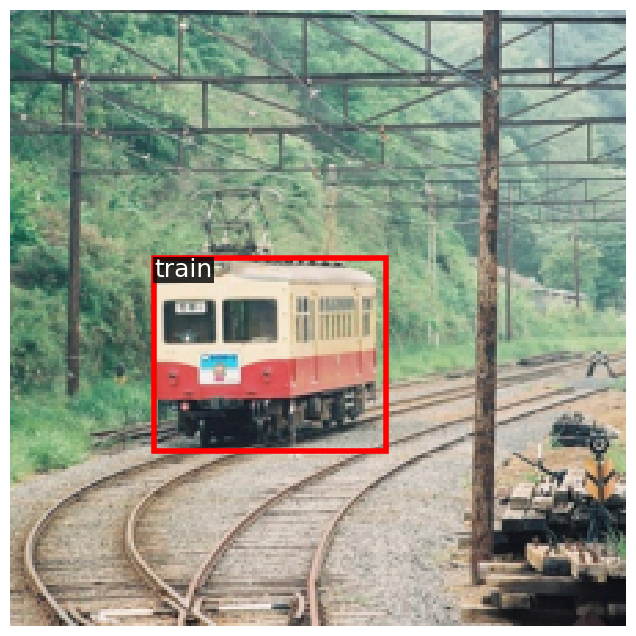

tensor([[  0.0000,   0.0000, 155.4674,  90.2568],
        [ 62.2887,   0.0000, 179.2413,  72.8321],
        [  0.0000,   0.0000,  73.9928, 124.5389],
        [102.4431,   0.0000, 201.3163, 108.3323],
        [  0.0000, 153.4505, 120.9038, 224.0000],
        [  0.0000,  81.7842,  73.7943, 224.0000],
        [140.8979,   0.0000, 224.0000,  89.2049],
        [  0.0000,  39.2967,  85.5411, 167.8019],
        [ 25.2506, 169.0294, 215.2443, 224.0000],
        [ 16.7937,  24.3011, 217.7726, 122.4751],
        [ 54.4548,   0.0000, 153.9166, 140.6314],
        [ 43.8477, 135.1501, 165.9594, 224.0000],
        [  0.0000,  89.0320, 120.5155, 186.6873],
        [118.0438,   4.0517, 217.9626, 172.8767],
        [ 74.9662,  18.8545, 198.0798, 155.9936],
        [  2.6114, 103.9498, 201.9885, 202.5243],
        [ 86.9207,  83.9560, 185.8072, 224.0000],
        [ 38.9150,  37.5345, 136.4847, 203.3493]], device='cuda:0') tensor([-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1],
 

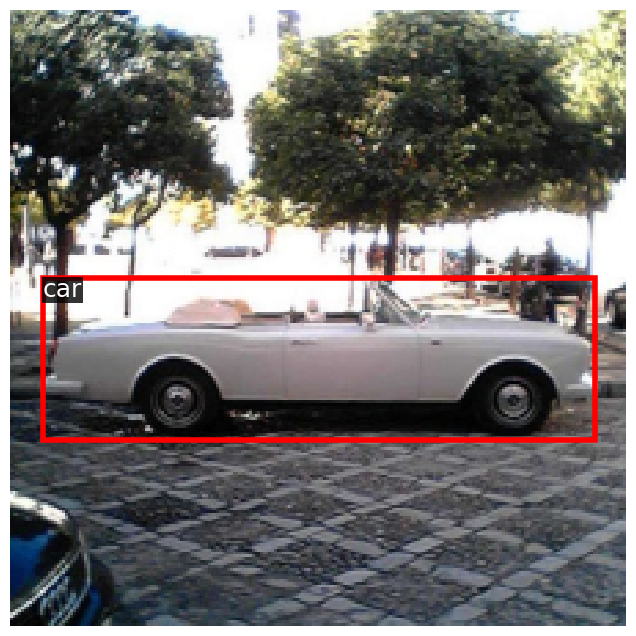

tensor([[  0.0000, 153.2302, 120.9443, 224.0000],
        [  0.0000, 164.2571,  81.3703, 211.5204],
        [  9.0552, 168.5968, 198.4445, 224.0000],
        [ 18.9478,   0.0000, 213.3636,  57.9272],
        [  0.0000, 100.1234,  89.4872, 224.0000],
        [ 22.7497,  83.3799, 122.5573, 224.0000],
        [  0.0000,   0.0000, 120.2653,  75.2181],
        [ 54.5137,   0.0000, 151.3743,  93.8034],
        [ 91.2693,   0.0000, 140.8407,  82.1393],
        [ 62.0379, 164.1356, 154.5954, 211.5931],
        [  0.0000, 119.7951, 186.9935, 219.4203],
        [ 98.7636, 159.3679, 148.3409, 224.0000],
        [  6.1968,  20.5441, 104.9930, 185.9304],
        [ 70.8165,  20.3861, 161.3186,  67.7347],
        [ 14.8858,   7.2296, 217.2826, 106.6299],
        [ 82.7964, 134.1757, 133.9824, 224.0000],
        [ 38.0126,   0.0000, 137.0068, 155.5699],
        [ 69.7360, 100.2772, 169.4414, 224.0000],
        [ 98.4467,  97.3866, 162.5490, 171.4035],
        [101.7595,  25.0981, 162.4271,  97.6718],


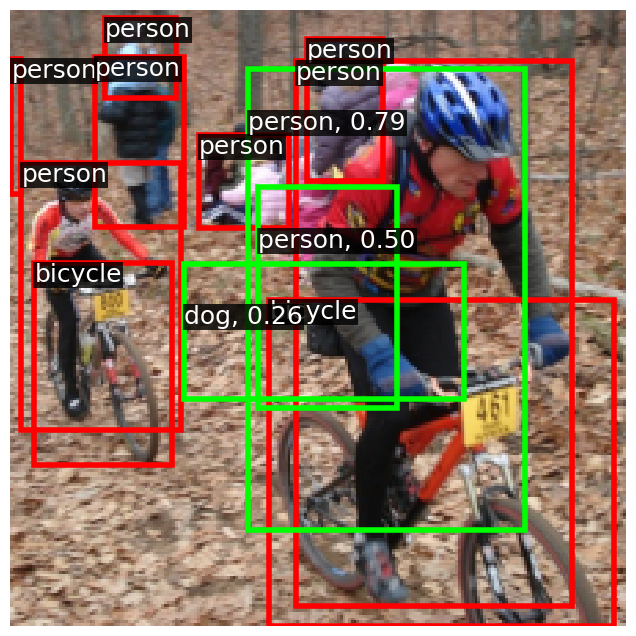

tensor([[  0.0000,   0.0000,  84.5016, 118.8320],
        [ 21.3948,   0.0000, 121.1575, 108.5880],
        [  0.0000, 115.4535,  88.5986, 224.0000],
        [  0.0000,   0.0000, 187.7581,  90.3577],
        [  0.0000,  33.5660,  73.5464, 203.7966],
        [ 92.5487,   0.0000, 213.6502,  91.6110],
        [  0.0000, 152.9755, 138.9314, 224.0000],
        [ 54.6230,   0.0000, 153.4106, 139.2289],
        [  0.0000,  40.8524, 138.5362, 138.3979],
        [ 31.9779,  23.0533, 224.0000, 122.3847],
        [124.1434, 133.0197, 224.0000, 224.0000],
        [ 25.3848, 169.3757, 215.0623, 224.0000],
        [133.6589,  36.8573, 224.0000, 204.2553],
        [  1.3582, 118.9058, 202.6905, 218.5581],
        [  0.0000,  88.5395, 138.5171, 186.6864],
        [ 99.0201,  87.8518, 224.0000, 185.2380],
        [ 70.7421, 116.1513, 168.2570, 224.0000],
        [ 39.6569,  67.6059, 137.8127, 224.0000],
        [ 86.9163,  20.1890, 185.6374, 186.5705],
        [ 26.1629,  50.1274, 152.1503, 188.6811],


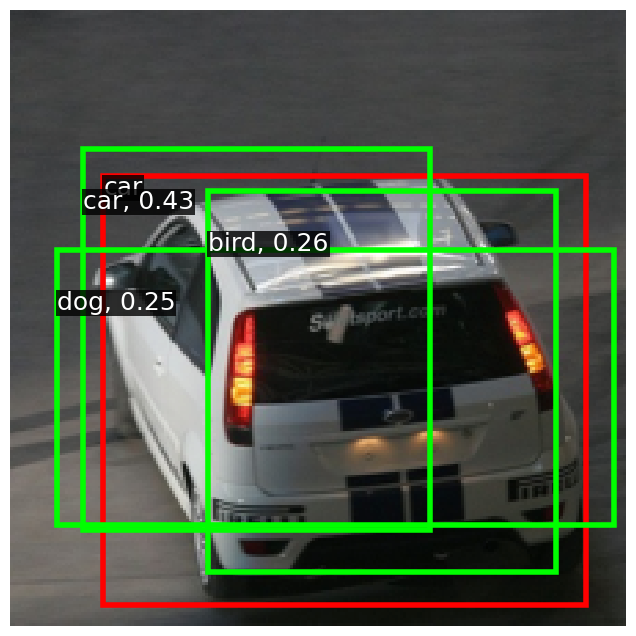

tensor([[  0.0000,  39.1325,  84.9752, 166.2064],
        [ 27.5455,   0.0000, 150.9249, 124.5294],
        [ 98.7846,   0.0000, 147.4396,  83.1363],
        [ 46.4668,   0.0000, 163.9677,  73.0289],
        [ 79.7124,  20.7209, 168.1117,  67.3053],
        [  0.0000,   0.0000, 102.8820, 105.7298],
        [  1.0773,   0.0000, 201.7242,  89.9563],
        [  0.0000, 152.9082, 120.6347, 224.0000],
        [  0.0000,  39.5498, 188.3274, 139.6937],
        [ 47.3907,  22.8833, 224.0000, 122.3092],
        [ 86.8738,   0.0000, 186.3016, 140.5212],
        [  0.0000,  98.5869,  73.8461, 224.0000],
        [ 43.8046, 132.8114, 165.6958, 224.0000],
        [ 86.3979, 153.4296, 145.9415, 222.3389],
        [  0.0000,  65.4708, 119.7849, 207.5353],
        [ 42.0646, 169.1881, 224.0000, 224.0000],
        [ 75.8494,  92.3285, 172.9495, 140.5604],
        [ 92.1082,  77.0600, 156.8747, 156.6750],
        [ 55.7563,  62.7861, 187.7132, 207.8217],
        [ 54.8069,  21.4466, 152.7518, 186.0168]],

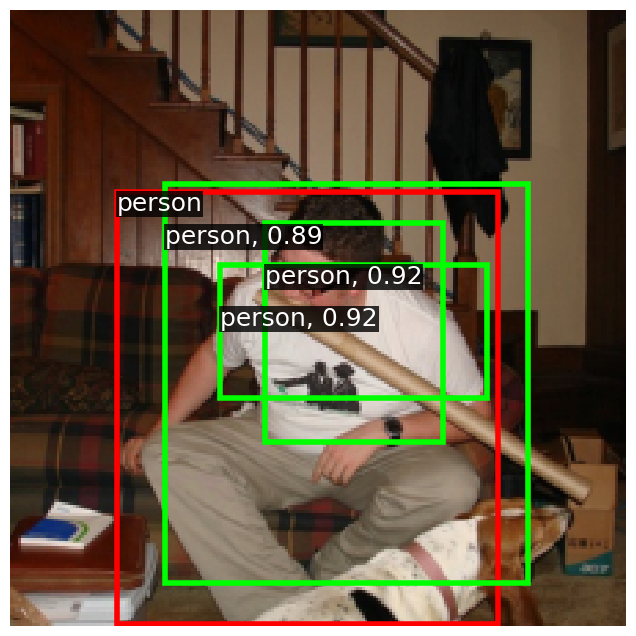

tensor([[  0.0000, 137.3901,  83.4570, 224.0000],
        [  0.0000, 135.2970, 170.5013, 224.0000],
        [ 82.9353, 141.6285, 132.4678, 224.0000],
        [ 62.1050, 154.3348, 178.7037, 224.0000],
        [  5.2999,   0.0000, 197.4550,  58.2129],
        [  0.0000,   0.0000, 102.8067, 107.7702],
        [102.3588,   0.0000, 200.1089,  94.1373],
        [ 89.5105,   0.0000, 142.0632,  76.5822],
        [ 85.8862, 100.4360, 184.3316, 224.0000],
        [ 27.9196,   0.0000, 151.7585,  92.1512],
        [ 39.3063,  82.8218, 137.8275, 224.0000],
        [ 60.4083,  19.7461, 156.3160,  67.9210],
        [ 32.2737,  22.5234, 224.0000, 121.6543],
        [ 70.6874,   0.0000, 169.0194, 121.5337],
        [  0.0000,  18.6217,  72.8293, 188.2823],
        [ 14.2008,  86.1663, 219.3747, 186.8316],
        [ 41.5824,  17.9419, 168.7195, 158.3933],
        [  0.0000,  71.9998, 139.7594, 171.1008],
        [ 39.2973,   5.3594, 137.4596, 170.3942],
        [ 81.4258,  71.5708, 133.1854, 156.0660],


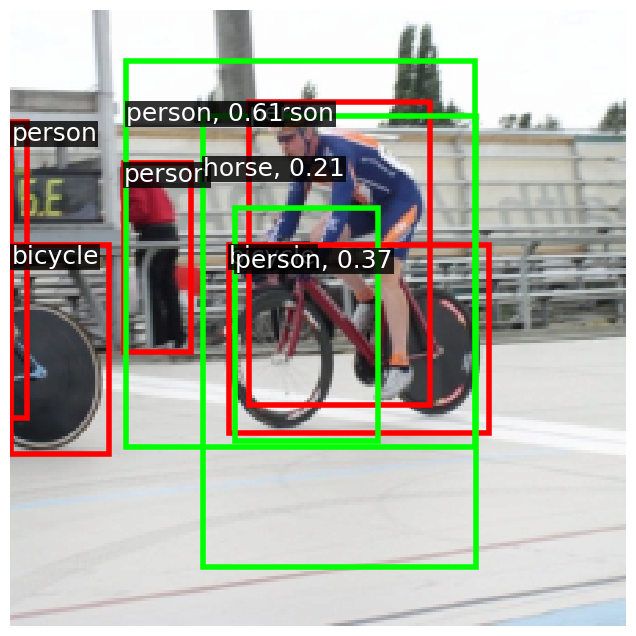

tensor([[  0.0000,   0.0000, 153.1229,  74.2310],
        [ 29.6591, 153.2514, 146.8422, 224.0000],
        [ 62.3458,   0.0000, 180.6140,  72.9915],
        [102.0197,   0.0000, 198.8645,  93.3164],
        [  0.0000,   0.0000,  72.8613, 109.0820],
        [140.1722,   0.0000, 224.0000, 122.1386],
        [ 18.4549,   7.2307, 217.5585, 106.1205],
        [ 55.0029,   0.0000, 152.7545, 138.5969],
        [ 34.4620,  39.6687, 224.0000, 138.8707],
        [  0.0000,  19.6620, 118.2289, 155.7680],
        [ 87.5951,  20.9109, 184.0685, 186.3865],
        [ 27.8238,  34.8374, 151.1288, 172.8331],
        [ 83.5415, 152.4462, 224.0000, 224.0000],
        [ 71.2077, 115.8587, 169.6156, 224.0000],
        [  0.0000,  71.7764, 200.6966, 170.5884],
        [  0.0000, 121.1656, 120.4164, 218.5411],
        [133.9018,  37.0703, 224.0000, 205.5356],
        [ 39.5541,  68.0772, 137.2952, 224.0000],
        [ 16.5258, 119.6879, 218.5632, 219.6380],
        [  0.0000,  81.9554,  73.2241, 224.0000],


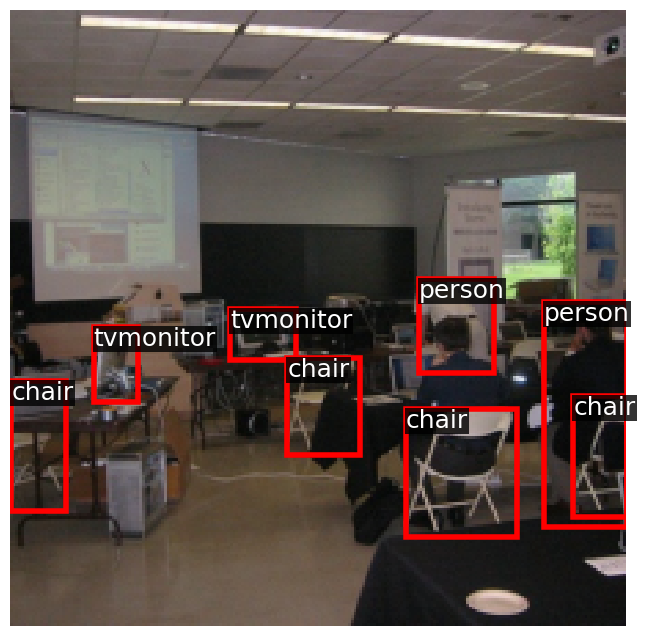

tensor([[  3.5726,   0.0000, 197.7039,  58.1249],
        [  0.0000,   0.0000, 119.2904,  75.0361],
        [  0.0000,  96.1070,  57.6294, 224.0000],
        [  0.0000, 153.4893, 121.5728, 224.0000],
        [133.7682, 100.4679, 224.0000, 224.0000],
        [  9.7447, 168.8089, 198.8537, 224.0000],
        [ 22.7837,  67.7702, 121.9187, 224.0000],
        [  0.0000,  34.4337,  73.5195, 203.6061],
        [ 94.5333,   0.0000, 211.6023,  73.8330],
        [ 54.0483,   0.0000, 152.0355,  93.0055],
        [  0.0000,   0.0000,  73.7188, 123.8816],
        [ 53.8305, 102.2174, 153.6992, 224.0000],
        [ 47.0109,  23.7297, 224.0000, 122.8230],
        [  0.0000,  55.9874, 155.0747, 155.2102],
        [148.8369,   0.0000, 224.0000, 124.4578],
        [ 38.2963,   4.6338, 137.7778, 172.5945],
        [ 30.1322, 103.5188, 224.0000, 203.3547],
        [ 75.0665, 133.5582, 196.7367, 224.0000],
        [ 85.8467,   3.2935, 186.0512, 171.2801],
        [ 13.9720,  71.4650, 218.8711, 171.0603],


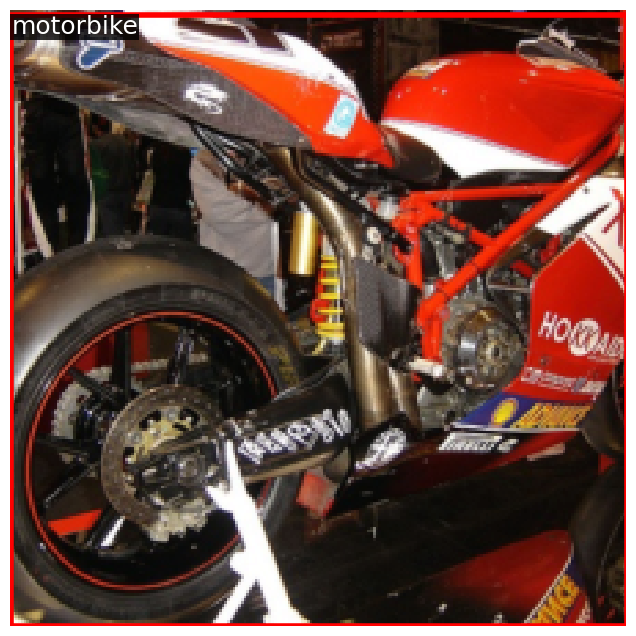

tensor([[9.3300e+01, 0.0000e+00, 1.8815e+02, 4.4907e+01],
        [7.1125e+01, 0.0000e+00, 2.0224e+02, 1.1272e+02],
        [1.0663e+02, 1.0163e-01, 1.5709e+02, 7.8899e+01],
        [9.9047e+01, 3.9697e+01, 1.4796e+02, 1.2553e+02],
        [1.7827e+01, 0.0000e+00, 2.2105e+02, 7.5553e+01],
        [0.0000e+00, 2.3533e+01, 1.8846e+02, 1.2375e+02],
        [6.6124e+01, 2.7626e+01, 1.6485e+02, 7.7075e+01],
        [3.8111e+01, 0.0000e+00, 1.3699e+02, 1.0750e+02],
        [6.9692e+01, 1.7181e+02, 1.6466e+02, 2.2028e+02],
        [8.9176e+00, 1.6822e+02, 1.9863e+02, 2.2400e+02],
        [9.2920e+01, 1.5160e+02, 1.5547e+02, 2.2400e+02],
        [8.6894e+01, 2.1484e+01, 1.8433e+02, 1.8579e+02],
        [9.1546e+01, 6.4213e+01, 1.3940e+02, 1.4723e+02],
        [2.6112e+01, 1.3129e+02, 1.5137e+02, 2.2400e+02],
        [7.4007e+01, 6.8951e+01, 1.6986e+02, 1.1686e+02],
        [1.1190e+02, 5.8720e+01, 1.6976e+02, 1.2323e+02],
        [7.3409e+01, 1.0082e+02, 1.6993e+02, 1.4897e+02],
        [1.846

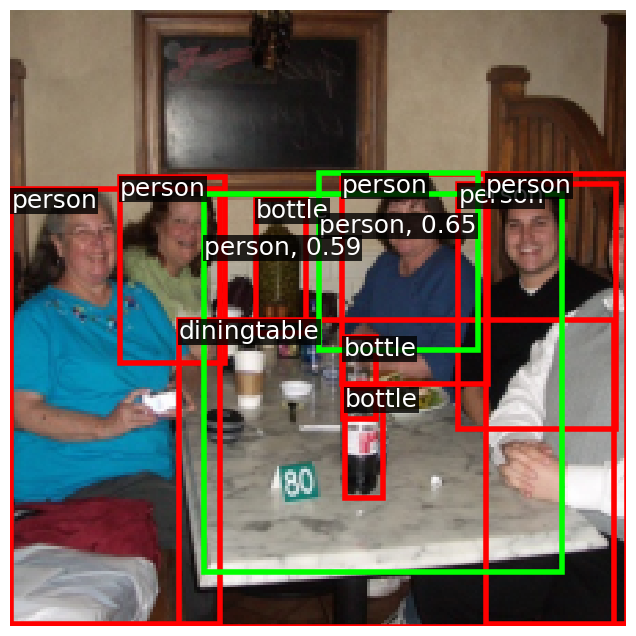

tensor([[ 21.9614,   0.0000, 120.8208, 108.8265],
        [140.4286,   0.0000, 224.0000, 105.6943],
        [ 42.8286,   2.2851, 167.3794, 142.2763],
        [  0.0000,   7.7102, 202.5524, 107.0634],
        [ 21.0430,   0.0000, 213.4379,  57.5456],
        [ 91.0667,   0.0000, 216.7399, 127.2290],
        [  0.0000,   0.0000,  71.6069,  94.2780],
        [  0.0000, 169.4471, 166.3681, 224.0000],
        [  0.0000,  19.0835,  89.3277, 187.9135],
        [ 14.5461,  38.9275, 218.8958, 138.4228],
        [  0.0000, 114.4416,  72.3441, 224.0000],
        [  0.0000,  56.1737, 121.7988, 154.3445],
        [ 77.9049, 154.6805, 193.7105, 224.0000],
        [125.2902, 134.6297, 224.0000, 224.0000],
        [140.3991,  36.8113, 224.0000, 169.6650],
        [ 73.6238,  33.5871, 200.5012, 174.6066],
        [ 55.9157,  36.4005, 153.8031, 201.9943],
        [ 16.7814, 135.4758, 218.6501, 224.0000],
        [ 39.4625, 129.7154, 135.8617, 224.0000],
        [  0.0000,  88.4062, 139.6413, 186.6570],


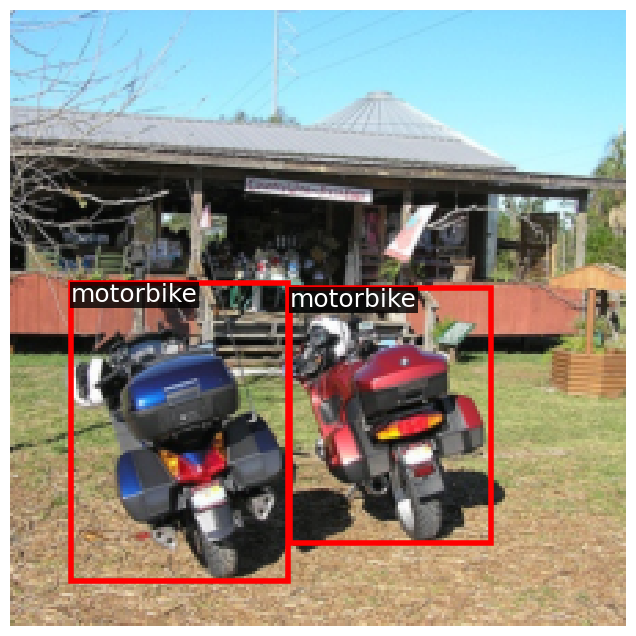

tensor([[0.0000e+00, 0.0000e+00, 7.3190e+01, 1.2476e+02],
        [0.0000e+00, 0.0000e+00, 1.0019e+02, 7.2469e+01],
        [5.0560e+00, 0.0000e+00, 1.9771e+02, 5.7910e+01],
        [6.8780e+01, 1.5213e+02, 2.2400e+02, 2.2400e+02],
        [0.0000e+00, 4.0684e+01, 1.2092e+02, 1.3899e+02],
        [3.8655e+01, 0.0000e+00, 1.3471e+02, 9.2962e+01],
        [0.0000e+00, 3.5435e+01, 7.3344e+01, 2.0502e+02],
        [1.0303e+01, 1.6900e+02, 1.9905e+02, 2.2400e+02],
        [9.1839e+01, 0.0000e+00, 2.1443e+02, 9.1579e+01],
        [1.4674e-01, 7.7367e+00, 2.0351e+02, 1.0671e+02],
        [6.9589e+01, 0.0000e+00, 1.6935e+02, 1.4111e+02],
        [0.0000e+00, 1.6902e+02, 1.0047e+02, 2.2400e+02],
        [1.1893e+02, 1.0080e+02, 2.1661e+02, 2.2400e+02],
        [7.0757e+01, 1.1620e+02, 1.6901e+02, 2.2400e+02],
        [2.7516e+01, 3.5056e+01, 1.5002e+02, 1.7233e+02],
        [1.3410e+02, 0.0000e+00, 2.2400e+02, 1.2485e+02],
        [1.8592e+01, 5.5663e+01, 2.1712e+02, 1.5429e+02],
        [0.000

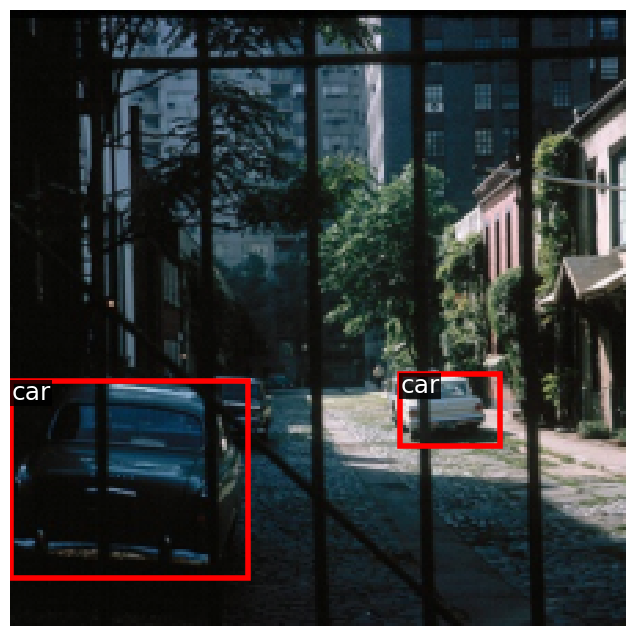

tensor([[  0.0000,   0.0000, 181.5478,  57.8868],
        [  0.0000,   0.0000,  83.1901,  69.8499],
        [  0.0000,   0.0000, 102.4881, 121.6631],
        [ 54.8914,   0.0000, 151.4769,  93.0871],
        [  0.0000,  34.7086,  74.0205, 203.7757],
        [ 78.4917,   0.0000, 195.9552,  72.8290],
        [  0.0000,   7.7219, 201.2397, 106.9220],
        [123.1223,   0.0000, 224.0000, 123.0971],
        [117.9094,  37.1757, 216.7240, 204.8790],
        [  0.0000, 169.1752, 100.8721, 224.0000],
        [  0.0000, 112.1920,  57.0762, 224.0000],
        [  0.0000,  56.5629, 121.5035, 155.5085],
        [ 81.3706,  86.9458, 224.0000, 185.5015],
        [ 70.7217,   0.0000, 169.7574, 139.4820],
        [  9.9516, 168.7879, 198.6764, 224.0000],
        [  0.0000,  39.5456, 184.6765, 138.5614],
        [107.7215, 133.9348, 224.0000, 224.0000],
        [ 39.0907,  20.3339, 137.2610, 187.5313],
        [ 58.4911,  66.1133, 183.5440, 203.6392],
        [ 23.1215, 115.9797, 120.2868, 224.0000],


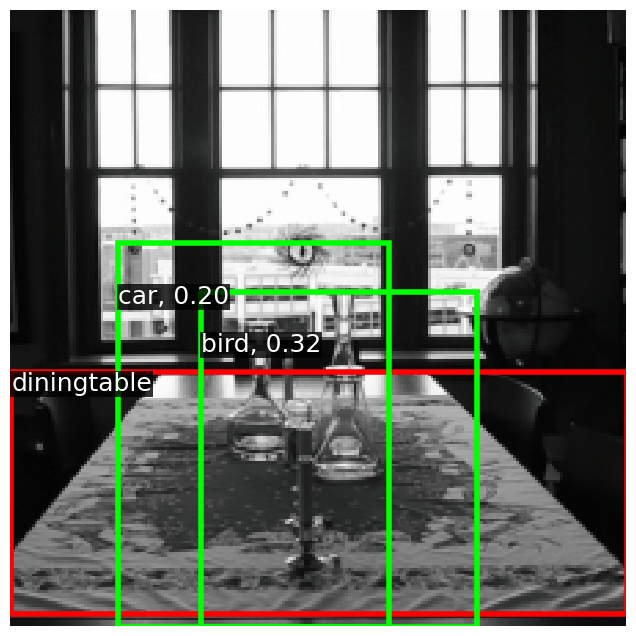

tensor([[ 85.3202,   3.3539, 144.4141,  70.4240],
        [ 54.5909,   0.0000, 151.0466,  93.4988],
        [ 68.2856,  12.1655, 162.8057,  59.4788],
        [ 21.0497,   0.0000, 213.9993,  58.0800],
        [  0.0000,   0.0000,  87.7657,  92.8131],
        [  1.9866,   6.9345, 202.0655, 106.5183],
        [ 22.3868,   0.0000, 120.8386, 120.8264],
        [ 91.2496,   0.0000, 214.2469,  90.0752],
        [ 25.3863, 169.1247, 214.6235, 224.0000],
        [ 82.5339, 135.8456, 132.1749, 224.0000],
        [ 71.8883,   3.6057, 167.6246, 168.2307],
        [ 76.1608, 133.3614, 198.0067, 224.0000],
        [  0.0000, 134.9022, 100.2961, 224.0000],
        [ 62.4959, 164.0555, 153.5436, 211.2790],
        [  0.0000,  40.0984, 136.8978, 137.7120],
        [ 28.9602, 134.2484, 149.5015, 224.0000],
        [ 33.9063, 103.1707, 224.0000, 202.6829],
        [  0.0000,   1.8548,  73.3444, 172.0879],
        [ 19.5997,  55.4175, 218.2190, 154.7940],
        [ 88.2073,  51.4355, 184.8565, 216.8784],


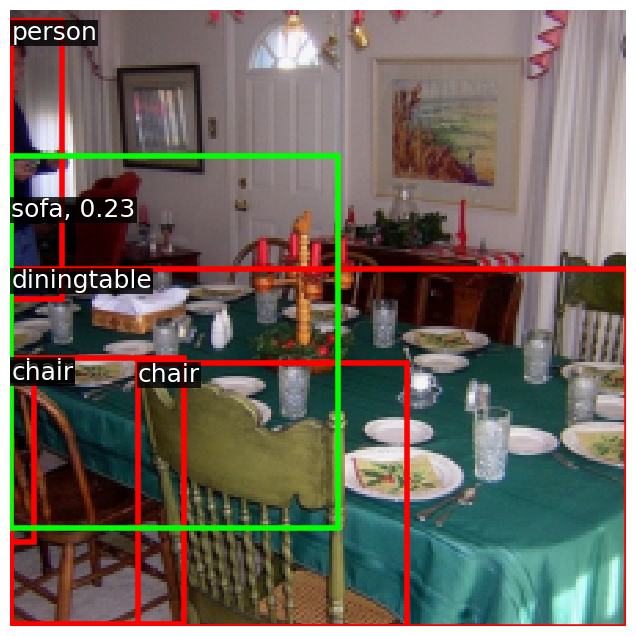

tensor([[ 70.2302, 188.8528, 128.5876, 224.0000],
        [ 30.4046,   0.0000, 147.2621,  73.0904],
        [ 78.2384, 160.7600, 137.3648, 224.0000],
        [  0.0000, 168.0039, 182.0542, 224.0000],
        [  0.0000,   8.0407, 138.0567, 106.1637],
        [  8.5239, 164.4377,  66.6699, 224.0000],
        [  0.0000, 114.4605,  73.1561, 224.0000],
        [  9.2650, 132.9941, 134.3763, 224.0000],
        [ 78.4549,   0.0000, 195.5488,  73.2241],
        [ 90.3778,   0.0000, 140.8683,  91.0549],
        [ 19.3097,   0.0000,  67.2083,  89.9307],
        [  6.8316,  89.9026,  67.7560, 156.3568],
        [ 52.9575, 102.8997, 154.0759, 224.0000],
        [  0.0000,  36.3452,  89.0744, 203.4747],
        [ 75.2606, 132.4677, 196.3327, 224.0000],
        [ 12.9908, 117.4247, 219.6709, 219.2030],
        [ 74.8509,  95.9958, 124.3484, 175.2525],
        [ 75.4825,  22.3162, 123.9914, 113.8358],
        [ 46.9584, 123.5725, 147.8682, 172.9649],
        [ 54.8958,   0.0000, 152.0739, 140.1062],


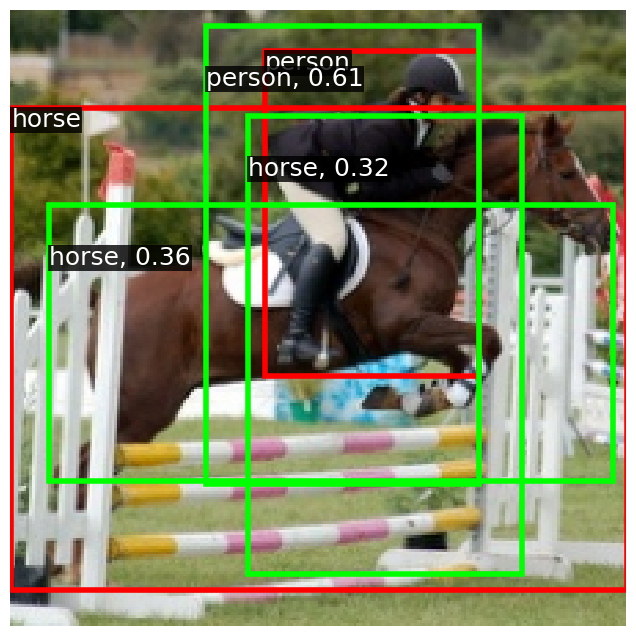

tensor([[ 30.5709,   0.0000, 147.3857,  72.6858],
        [163.4061,   0.0000, 224.0000, 113.3325],
        [  0.0000,   0.0000, 118.2886, 107.4801],
        [  0.0000,  71.9174, 138.7272, 170.5741],
        [ 33.6781,   0.0000, 224.0000,  89.8724],
        [118.9609,   0.0000, 178.0822,  60.3488],
        [  0.0000,  18.5135,  73.7472, 188.9180],
        [ 38.7611,  21.4167, 136.9370, 188.1301],
        [  0.0000,  23.7887, 185.2318, 121.8613],
        [ 32.4150,  55.3989, 224.0000, 154.1970],
        [102.8255,   0.0000, 200.6668, 123.0565],
        [ 14.4417,  87.4677, 219.0972, 187.1074],
        [ 55.1153,   0.0000, 152.4848, 138.9187],
        [ 74.6756,  66.2868, 198.9543, 205.8490],
        [ 42.8040,  82.4432, 167.4046, 222.5872],
        [115.3847, 127.5303, 162.7906, 218.8379],
        [ 87.4485,  76.8166, 176.0445, 123.4199],
        [  6.7157,  82.8997, 105.7469, 224.0000],
        [ 61.5717, 154.0972, 178.2747, 224.0000],
        [ 88.8972, 157.0797, 176.2833, 203.1818],


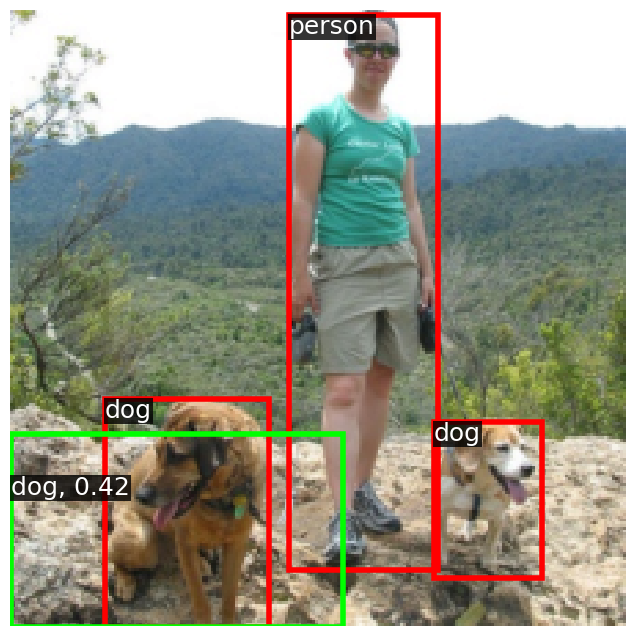

tensor([[ 36.4878,   0.0000, 224.0000,  57.7017],
        [ 86.0707,   0.0000, 147.2424,  73.0569],
        [  0.0000, 169.1579, 182.3654, 224.0000],
        [  0.0000,  83.4802,  88.8601, 224.0000],
        [ 82.2989, 133.9736, 131.8746, 224.0000],
        [ 86.3827,   0.0000, 183.5718,  93.4317],
        [ 11.5477, 116.9460, 133.4230, 224.0000],
        [  0.0000,   0.0000, 137.8219,  90.0873],
        [123.5245,   0.0000, 224.0000, 107.4164],
        [ 64.9709, 165.3070, 151.9019, 211.3103],
        [  0.0000,   0.0000,  73.1790, 124.7811],
        [  7.0098,   4.5631, 104.7702, 170.3523],
        [ 77.8228, 154.4272, 194.1763, 224.0000],
        [ 70.1451, 101.0865, 169.3164, 224.0000],
        [133.5926,  19.9344, 224.0000, 187.8571],
        [ 54.8099,   0.0000, 152.9907, 124.0809],
        [  0.6508, 103.6741, 201.5241, 201.9785],
        [ 80.1991,  71.6846, 224.0000, 169.5912],
        [ 16.6755,  23.7582, 219.2760, 122.6047],
        [  0.0000,  72.3388, 138.1149, 170.5488],


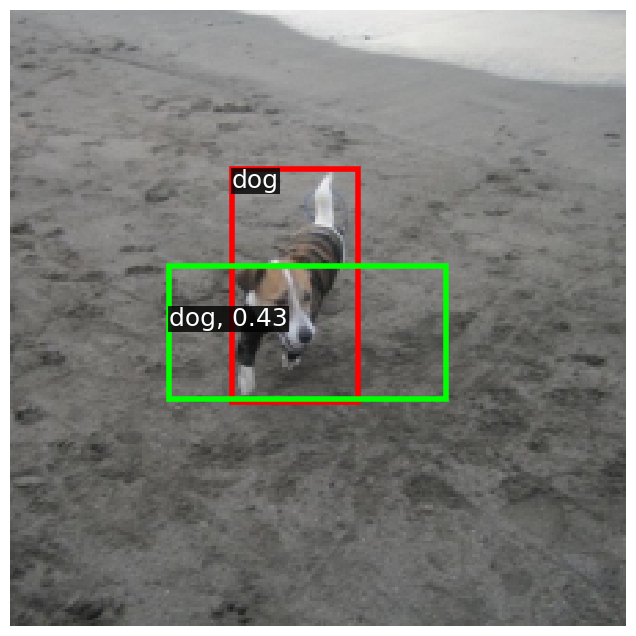

tensor([[  0.0000, 137.2541,  83.5022, 224.0000],
        [ 52.7630,   0.0000, 224.0000,  57.3166],
        [  0.0000,   0.0000,  87.3458,  93.1242],
        [  5.9939, 152.4574, 200.9381, 224.0000],
        [ 30.3547,   0.0000, 149.1108,  73.6100],
        [103.1891,   0.0000, 199.8543,  93.8738],
        [150.0896,   0.0000, 224.0000,  94.2190],
        [ 70.5321,   0.0000, 167.3156,  93.8508],
        [  1.6086,   7.2856, 202.5805, 105.9358],
        [ 38.9870, 115.5999, 136.1122, 224.0000],
        [ 72.1262, 129.4961, 167.1687, 224.0000],
        [ 80.7431, 119.7959, 224.0000, 217.3767],
        [  0.0000,  40.4071, 138.9092, 138.0444],
        [ 91.3071,  29.7998, 140.0937, 123.5260],
        [ 39.1677,   4.7163, 136.5932, 171.9782],
        [ 80.8663,  40.0280, 224.0000, 137.8217],
        [  0.0000,  18.2693,  73.5176, 188.5005],
        [  0.0000,  89.1555, 120.8449, 186.6186],
        [ 86.7302,  21.6348, 185.6259, 189.7757],
        [ 41.9091,  67.3973, 167.4162, 205.1322],


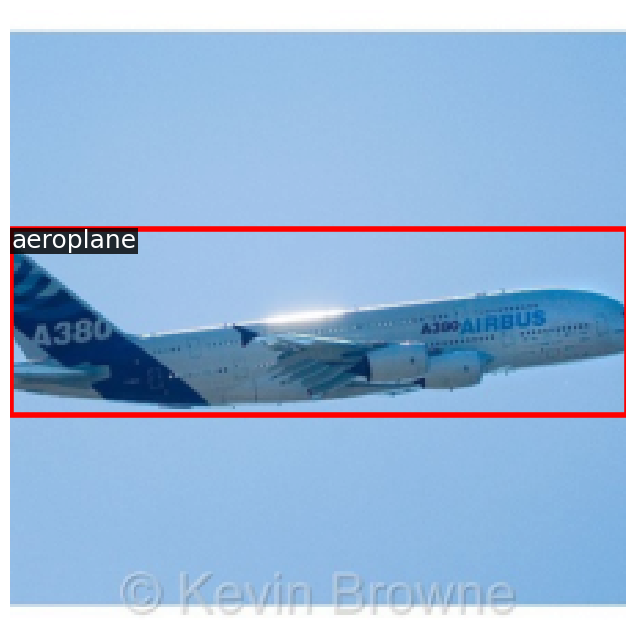

tensor([[ 99.0105,   0.0000, 147.9328,  67.0774],
        [  0.0000,   0.0000, 185.3245,  74.5309],
        [ 80.9077,   5.2687, 168.2720,  51.4511],
        [  0.0000, 169.0790, 182.1932, 224.0000],
        [  0.0000, 138.7629,  65.6257, 224.0000],
        [ 54.3725,   0.0000, 151.3186,  93.7913],
        [ 93.2366,   0.0000, 213.9411,  90.6029],
        [ 71.5809, 157.0528, 161.1098, 203.2692],
        [ 71.7381, 129.7305, 167.3889, 224.0000],
        [  0.0000,   0.0000,  73.2702, 108.5079],
        [ 91.1546, 126.7958, 139.6999, 218.4321],
        [ 18.6403, 119.9417, 215.1187, 217.7319],
        [135.5039,  84.8436, 224.0000, 224.0000],
        [ 82.1255,  57.0416, 132.3417, 146.2722],
        [ 59.3446,  68.5199, 181.7513, 201.4050],
        [  0.0000,  84.2893,  89.5240, 224.0000],
        [ 16.3032,  22.6886, 217.6306, 123.4778],
        [ 85.9662,   5.4214, 183.8074, 170.0796],
        [  0.0000,  18.4030,  73.4726, 188.6740],
        [ 39.0818, 115.2167, 136.2933, 224.0000],


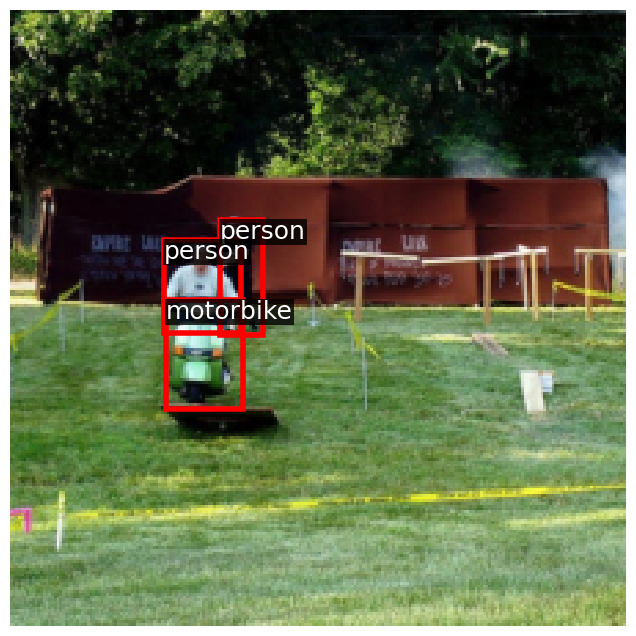

tensor([[  0.0000,   0.0000,  85.2821, 104.0369],
        [  0.0000,  98.7386,  73.6922, 224.0000],
        [  0.0000,  17.9641,  74.3726, 186.4656],
        [ 87.1326, 181.1414, 176.3651, 224.0000],
        [  0.0000, 152.7057, 120.5341, 224.0000],
        [  0.0000,  72.0231, 122.9646, 171.2062],
        [  5.1933,   0.0000, 197.4541,  57.3977],
        [102.6942,   0.0000, 199.3302,  93.4539],
        [ 25.8464, 169.5386, 215.2397, 224.0000],
        [ 55.4547, 172.4234, 145.7618, 219.7070],
        [ 37.1779,  98.9809, 138.1954, 224.0000],
        [  0.0000, 119.6307, 188.8516, 219.3952],
        [ 31.4516,  87.2797, 224.0000, 187.6525],
        [ 68.4759,  79.1001, 131.5878, 154.4583],
        [ 32.5696,   8.2666, 224.0000, 106.0889],
        [ 86.6694,   4.9585, 185.3429, 172.3756],
        [ 78.9952,   1.7090, 138.5413,  70.1609],
        [ 49.3495,  92.2139, 151.0047, 140.9405],
        [106.7915, 149.9096, 156.7451, 224.0000],
        [ 84.3075, 107.9126, 179.4639, 155.7646],


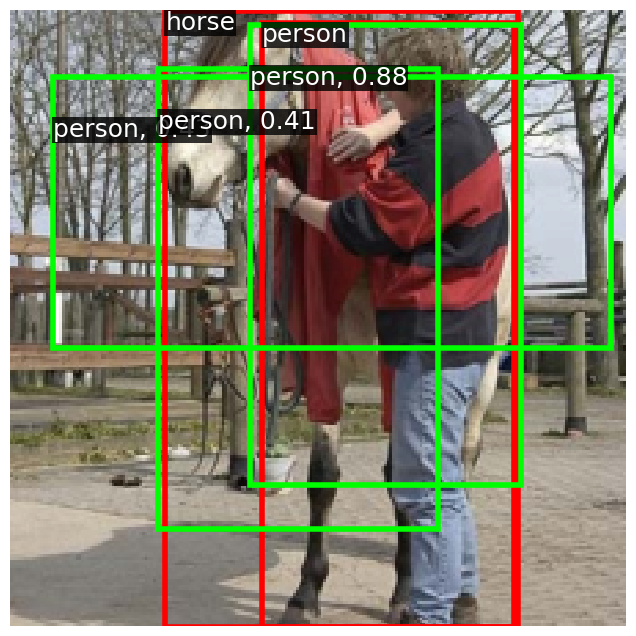

tensor([[  0.0000,   0.0000,  85.1595,  87.3145],
        [107.3468, 114.8575, 224.0000, 224.0000],
        [122.7473,   0.0000, 224.0000, 110.4140],
        [133.9567,  21.4737, 224.0000, 189.5193],
        [  0.0000,  18.7525,  73.0058, 187.1302],
        [  0.0000, 169.5115, 182.5017, 224.0000],
        [ 20.0843,   0.0000, 213.7521,  57.9445],
        [ 78.0834, 153.3663, 194.8044, 224.0000],
        [  0.0000, 118.7364,  84.9092, 224.0000],
        [ 86.2013,  83.3680, 185.3812, 224.0000],
        [ 30.2754, 103.6747, 224.0000, 202.3000],
        [ 57.7343, 165.2720, 143.6096, 211.5995],
        [ 86.4751,   0.0000, 183.5633,  92.5996],
        [ 43.8797, 115.4610, 166.4261, 224.0000],
        [ 22.4087,  84.2682, 122.1106, 224.0000],
        [ 78.4853,  71.2198, 224.0000, 169.9738],
        [ 78.6016,   0.8950, 139.5173,  69.9559],
        [  0.0000,  56.4950, 121.0591, 154.7763],
        [ 15.3188,   7.9919, 219.4217, 106.6639],
        [ 68.1645,  37.8204, 170.1460, 204.0858],


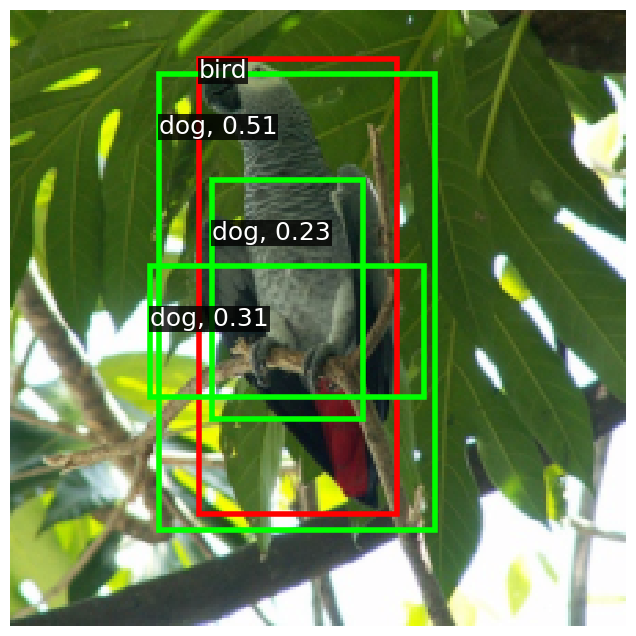

tensor([[  0.0000,   0.0000,  83.0913,  70.3479],
        [ 78.9287,   0.0000, 195.2416,  71.9676],
        [  0.0000,   0.0000, 181.7700,  57.1978],
        [  0.0000, 169.1362, 117.0364, 224.0000],
        [ 22.8140,   0.0000, 119.0262,  93.4211],
        [  0.0000, 104.1158,  84.5858, 224.0000],
        [ 92.6718,   0.0000, 213.1111, 121.7775],
        [ 44.3046,   0.0000, 165.9620, 107.4086],
        [  0.0000,  38.7983, 100.8992, 167.9250],
        [  0.0000,  89.4371, 119.7337, 186.5539],
        [ 86.7359, 115.4742, 184.5240, 224.0000],
        [135.1680, 115.8661, 224.0000, 224.0000],
        [  0.0000,  23.5612, 201.7144, 122.4778],
        [ 20.3012, 152.5392, 216.8051, 224.0000],
        [  1.6803, 103.8306, 202.1915, 202.3844],
        [ 87.3465,  37.1755, 184.8810, 205.7200],
        [ 27.1351,  51.7643, 149.8412, 187.1256],
        [ 82.3634,  55.4812, 224.0000, 153.9964],
        [ 54.9163,  84.9629, 152.6499, 224.0000]], device='cuda:0') tensor([-1, -1, -1, -1, -1, -1, 

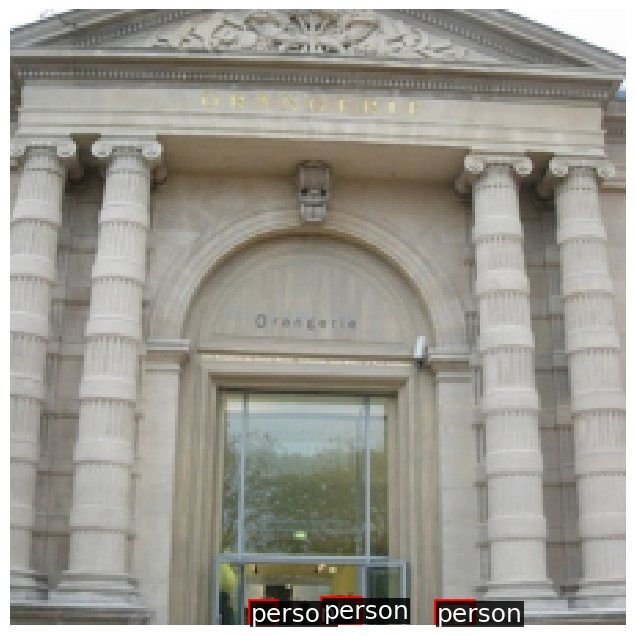

tensor([[1.0295e+02, 0.0000e+00, 1.9947e+02, 9.4880e+01],
        [9.9659e+01, 3.4286e+01, 1.6132e+02, 1.0340e+02],
        [0.0000e+00, 0.0000e+00, 1.0197e+02, 1.2232e+02],
        [1.7300e+01, 6.5001e+00, 2.1934e+02, 1.0624e+02],
        [6.6527e+01, 3.5639e+01, 1.6482e+02, 8.4389e+01],
        [8.4147e+01, 2.6518e+01, 1.4522e+02, 9.4715e+01],
        [7.0119e+01, 0.0000e+00, 1.6747e+02, 9.3994e+01],
        [3.9501e+01, 0.0000e+00, 1.3756e+02, 1.2247e+02],
        [1.0669e+02, 0.0000e+00, 1.5713e+02, 5.5100e+01],
        [7.7004e+01, 0.0000e+00, 1.7247e+02, 3.6303e+01],
        [9.1021e+01, 3.9117e+01, 1.4012e+02, 1.2835e+02],
        [5.1627e+00, 0.0000e+00, 1.9909e+02, 5.9032e+01],
        [9.0846e+01, 0.0000e+00, 1.4056e+02, 5.3238e+01],
        [0.0000e+00, 1.8918e+02, 8.0535e+01, 2.2400e+02],
        [6.0394e+01, 1.8750e+02, 1.5714e+02, 2.2400e+02],
        [7.4423e+01, 5.1785e+01, 1.9908e+02, 1.8826e+02],
        [2.6176e+01, 3.4429e+01, 1.5212e+02, 1.7503e+02],
        [2.402

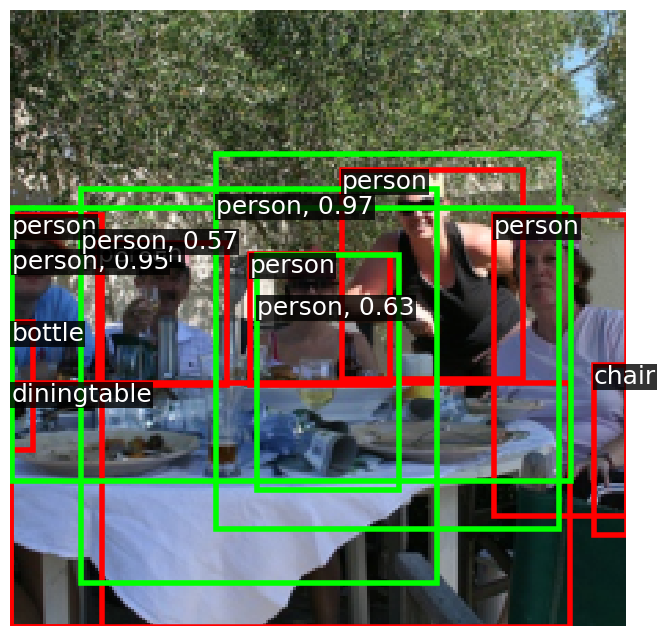

tensor([[  4.7003,   0.0000, 197.4168,  57.6062],
        [ 78.7511,   0.5715, 139.6641,  72.4443],
        [ 93.0236,   0.0000, 214.3977,  92.1217],
        [ 80.7918,  12.8666, 167.8472,  59.3806],
        [ 54.2178,  22.5763, 152.8652, 187.4851],
        [ 86.9297,  37.1887, 185.4930, 202.1215],
        [ 54.1623,   0.0000, 151.3327,  93.2483],
        [  9.0272, 168.4757, 198.9522, 224.0000],
        [ 68.6892, 152.7016, 131.0946, 224.0000],
        [  0.0000,  39.3150, 187.8404, 139.4032],
        [ 27.5739, 133.4075, 150.0184, 224.0000],
        [ 76.1585,  92.0919, 173.1849, 139.7854],
        [ 85.6926, 168.2984, 146.9985, 224.0000],
        [ 94.6050,  17.3697, 155.1259,  88.0505],
        [ 79.8987, 189.0350, 168.8866, 224.0000],
        [ 97.3175,  61.3792, 149.2257, 147.0262],
        [ 32.6305,  87.1973, 224.0000, 187.1387],
        [105.2584,  86.7655, 157.5415, 172.9645],
        [ 49.8302,  84.4322, 149.6446, 132.9031],
        [102.7645,  25.3036, 163.6683,  95.7120],


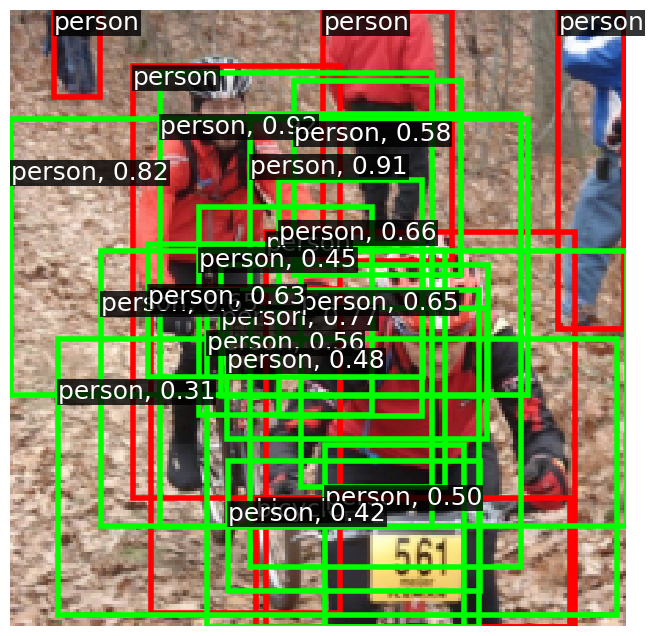

tensor([[  6.5503,   0.0000, 105.8521, 123.1598],
        [  0.0000,   2.7584,  73.6876, 171.2101],
        [  0.0000,   0.0000, 153.9791,  74.9783],
        [  0.0000, 100.0811,  87.9713, 224.0000],
        [124.5956, 131.9241, 224.0000, 224.0000],
        [  6.0408,  36.3276, 103.6283, 204.5436],
        [ 77.2066, 152.7358, 193.9557, 224.0000],
        [ 23.2693,  82.5076, 121.2087, 224.0000],
        [  0.0000, 135.1885, 186.3867, 224.0000],
        [ 51.6537,   0.0000, 224.0000,  57.7076],
        [  0.0000,  73.0042, 138.0905, 170.9131],
        [ 38.1941,  19.5663, 137.1744, 187.7282],
        [ 54.5592,  67.6590, 153.6023, 224.0000],
        [134.1214,  35.8920, 224.0000, 203.4288],
        [ 86.3359,   0.0000, 183.6931,  93.1379],
        [ 86.5099,  83.1610, 185.5530, 224.0000],
        [ 97.2927,  87.5746, 224.0000, 185.7009],
        [ 43.7759,   0.0000, 167.6890, 125.3570],
        [141.1244,   0.0000, 224.0000, 123.4164],
        [  0.7611,  40.6175, 201.8873, 138.6080],


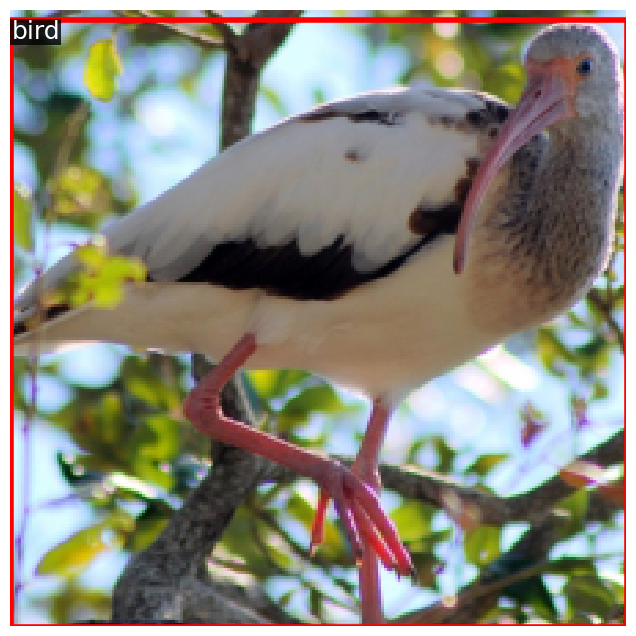

tensor([[  0.0000,   0.0000,  82.9003,  70.5022],
        [  0.0000, 169.2258, 117.6060, 224.0000],
        [  3.9089,   0.0000, 198.1515,  57.5468],
        [ 46.5228, 154.3435, 161.9677, 224.0000],
        [  0.0000, 139.7445,  65.9030, 224.0000],
        [107.6339, 115.5188, 224.0000, 224.0000],
        [  0.0000,  18.6855,  73.4868, 187.8317],
        [ 86.9504,   0.0000, 183.3348,  93.0527],
        [ 75.7771,  83.2096, 197.3707, 218.2732],
        [  0.0000,   9.2414, 121.4583, 107.1189],
        [  0.0000, 119.5781, 170.2367, 217.9391],
        [  6.9713,  99.6828, 104.8885, 224.0000],
        [ 32.6166,   7.3679, 224.0000, 106.2865],
        [ 32.7888,  70.4925, 224.0000, 170.2081],
        [ 55.3756,   0.0000, 152.8714, 139.9932],
        [  0.0000,  72.6908, 121.8599, 171.4798],
        [ 17.1876,  39.4306, 218.8930, 138.0346],
        [ 26.0971,  50.5860, 149.6018, 187.3496],
        [ 37.9005,  34.9024, 137.5677, 201.7221]], device='cuda:0') tensor([-1, -1, -1, -1, -1, -1, 

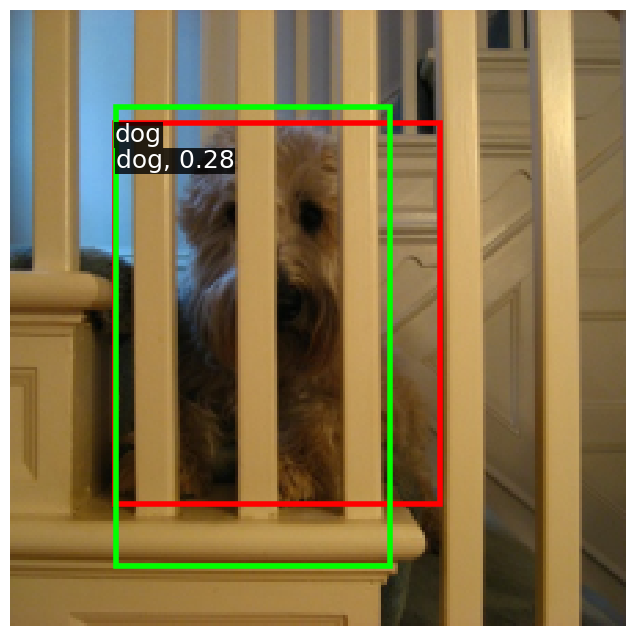

tensor([[  0.0000, 153.0782, 120.0763, 224.0000],
        [ 19.8322,   0.0000, 213.8512,  57.6684],
        [  0.0000,   0.0000, 137.5625,  74.6875],
        [ 62.7201, 172.7788, 152.9354, 219.5249],
        [ 26.7877, 168.7603, 214.0318, 224.0000],
        [  0.0000, 103.0724,  84.8367, 224.0000],
        [ 83.2680, 142.0886, 131.4929, 224.0000],
        [ 90.8784,   0.0000, 215.4034, 127.7941],
        [ 43.7040, 135.2064, 166.0065, 224.0000],
        [  0.9471, 119.5748, 201.2245, 218.0643],
        [ 86.8855, 101.7152, 184.3913, 224.0000],
        [  6.9075,   0.0000, 105.9925, 123.1555],
        [  0.0000,  88.2218, 121.3351, 186.8575],
        [ 15.8823,  38.3390, 219.9201, 137.7003],
        [ 54.1228,   0.0000, 151.5554,  92.8798],
        [  0.0000,   2.9396,  73.5582, 172.7238],
        [ 70.3123,  20.4871, 161.7671,  67.6918],
        [ 55.7180,   4.5219, 153.2366, 170.1870],
        [ 26.0994,  65.8723, 153.3487, 205.1003],
        [ 89.0087,  61.5434, 143.3445, 145.9337],


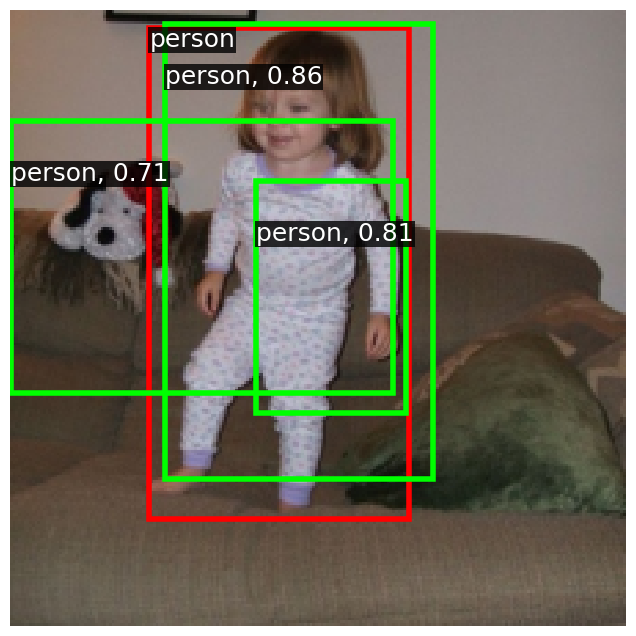

tensor([[133.4240,   0.0000, 224.0000, 122.7824],
        [101.9713,   0.0000, 200.7695, 106.9714],
        [  0.0000,  79.2300,  57.0838, 224.0000],
        [149.4121,  37.7752, 224.0000, 203.5137],
        [ 14.3290,   0.0000, 220.1804,  90.6976],
        [  0.0000,  17.8056,  74.5776, 187.2157],
        [  0.0000,   0.0000,  71.4097,  93.8591],
        [134.8386, 100.1648, 224.0000, 224.0000],
        [ 62.2041,   0.0000, 180.3288,  73.8698],
        [ 78.2060,  70.5649, 224.0000, 171.1596],
        [  0.0000,  65.6154, 120.1464, 206.7785],
        [ 14.7185,  39.5953, 220.5670, 139.8623],
        [ 11.0469,   0.0000, 135.3910, 126.7204],
        [ 84.6651, 152.4973, 224.0000, 224.0000],
        [ 85.8873,   5.1164, 185.9342, 172.3825],
        [  0.0000, 153.5606, 101.8337, 224.0000],
        [ 14.9733, 119.3311, 219.8183, 219.0081],
        [ 38.9184,  82.2750, 137.6194, 224.0000],
        [  0.0000,  55.4356, 155.2802, 154.4748],
        [ 86.4040, 101.2281, 185.7372, 224.0000],


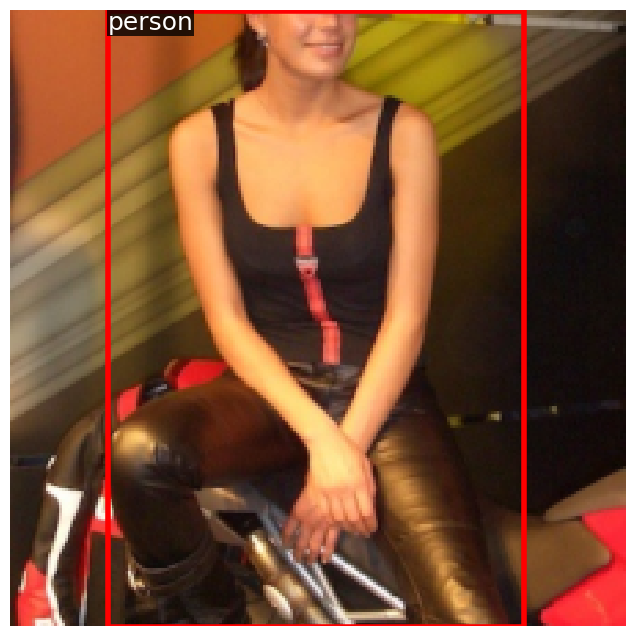

tensor([[ 77.8091,   0.0000, 195.4271,  74.1310],
        [ 53.9377,   5.1660, 146.3425,  52.2547],
        [ 74.0831,   0.0000, 126.2732,  67.0201],
        [ 10.2428, 168.7673, 198.8397, 224.0000],
        [ 43.1026, 133.3235, 165.7603, 224.0000],
        [ 45.4548, 156.3489, 139.2995, 203.4988],
        [  0.0000,   0.0000, 182.4705,  57.0263],
        [ 68.4900, 138.3801, 131.2681, 210.3555],
        [  0.0000, 136.9588, 123.9281, 224.0000],
        [ 14.4426, 118.7153, 218.4219, 218.4979],
        [ 85.1506, 100.3893, 184.5919, 224.0000],
        [  0.0000,  94.3266,  58.7719, 224.0000],
        [ 22.6762,  68.8033, 120.9310, 224.0000],
        [ 89.3711,   0.0000, 215.2761, 125.8887],
        [ 53.3223,   0.0000, 153.1543, 109.7445],
        [ 53.9005,  52.8597, 153.1996, 217.4565],
        [  0.0000,  86.1292, 203.2708, 186.5344],
        [  0.0000,  47.3889, 105.8208, 190.7436],
        [  0.0000,   1.3788,  75.1465, 169.7843],
        [ 52.7599,  68.4589, 150.2021, 116.2142],


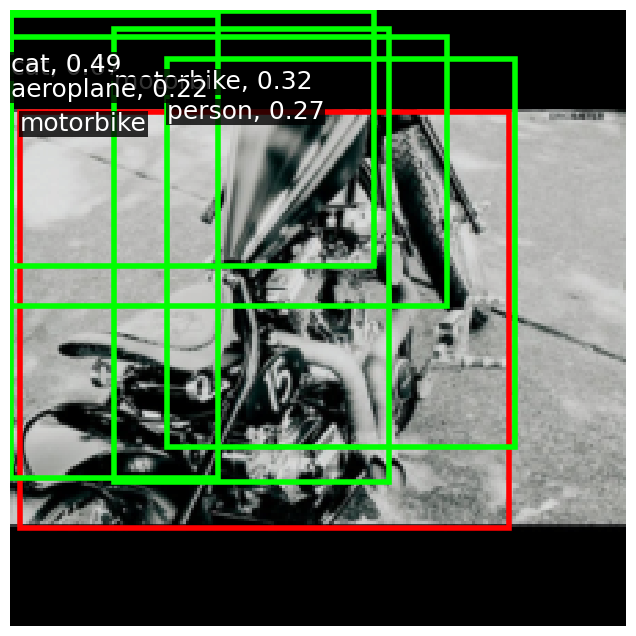

tensor([[  0.0000,  71.1212,  87.0401, 202.1448],
        [  0.0000,   0.0000,  99.5327,  71.8626],
        [  0.0000, 137.3030,  83.3846, 224.0000],
        [  0.0000,   0.0000,  73.2939, 140.6214],
        [133.1125,  36.5371, 224.0000, 202.9014],
        [ 85.1660, 152.5246, 224.0000, 224.0000],
        [123.9148,   0.0000, 224.0000, 108.7096],
        [ 20.7535,   0.0000, 213.3290,  57.7428],
        [ 22.2472, 100.9708, 121.0977, 224.0000],
        [  9.7793, 169.1884, 198.5125, 224.0000],
        [ 44.4157, 134.2149, 165.3700, 224.0000],
        [ 13.9180, 119.1675, 218.4111, 217.8302],
        [ 85.6151, 100.0685, 185.1613, 224.0000],
        [  0.0000,  40.7229, 139.4241, 139.7240],
        [  0.0000,  86.5527, 185.9295, 186.3683],
        [ 60.8477,  71.1284, 224.0000, 170.6132],
        [  0.0000,   8.4320, 138.5589, 106.6543],
        [ 86.5272,   0.0000, 183.4859,  93.3985],
        [ 37.8275,  37.1510, 137.5819, 202.2990],
        [ 75.1720,  19.6842, 199.8388, 155.8431],


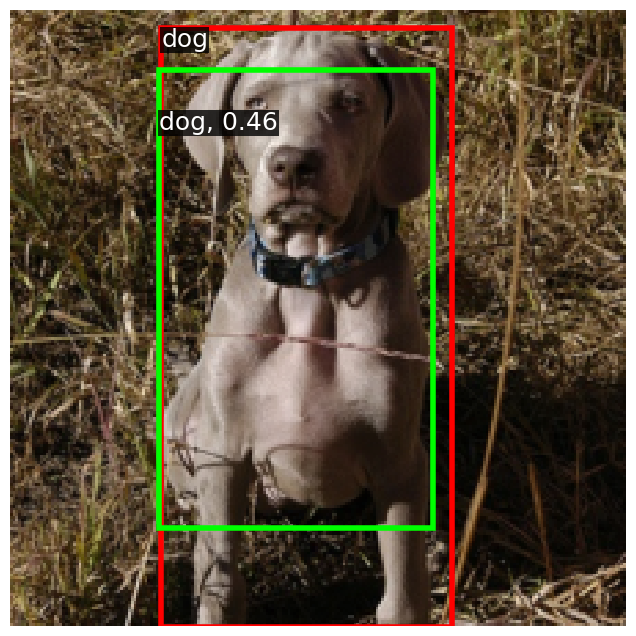

tensor([[102.0751,   0.0000, 163.3383,  65.0519],
        [  0.0000,   0.0000, 181.4331,  57.1886],
        [ 79.1277,   0.0000, 195.5592,  72.7521],
        [102.7492,   0.0000, 199.8488, 123.8760],
        [ 34.7181,   0.0000, 224.0000,  89.9590],
        [ 38.2042,   0.0000, 135.5383, 141.4203],
        [  0.0000,  40.2414, 185.7680, 137.3274],
        [115.6160,  56.0243, 163.8464, 137.9326],
        [ 89.4931,  22.0192, 183.9952, 186.9762],
        [ 96.6829, 165.5406, 184.0387, 211.4638],
        [110.5344, 144.4920, 170.6778, 215.8589],
        [100.8968,  64.6893, 147.3356, 150.2173],
        [ 89.5575,  92.2406, 187.0545, 140.4230],
        [ 78.5478, 154.1060, 194.7062, 224.0000],
        [ 35.6290,  71.0403, 224.0000, 170.3654],
        [ 98.7493, 134.0391, 147.7371, 224.0000],
        [ 86.3753,  84.5605, 185.3541, 224.0000],
        [ 55.4397,  37.6470, 152.6875, 206.1427],
        [ 32.3942, 119.3588, 224.0000, 217.7383],
        [ 30.5083, 154.1717, 146.3166, 224.0000],


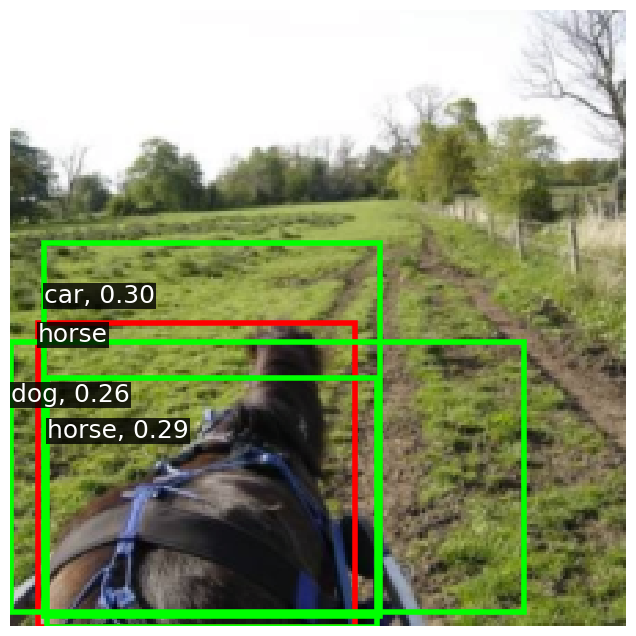

tensor([[  0.0000,   0.0000,  85.2010,  87.0337],
        [  0.0000, 112.0549,  57.2430, 224.0000],
        [  0.0000,  19.9456,  72.5207, 187.0628],
        [149.6294,  84.7371, 224.0000, 224.0000],
        [ 97.9341, 135.7521, 224.0000, 224.0000],
        [ 92.9383,   0.0000, 215.0506,  92.4506],
        [ 61.5453, 153.6113, 178.9621, 224.0000],
        [  6.7328,  83.9282, 105.5607, 224.0000],
        [  0.0000, 152.9177, 120.5161, 224.0000],
        [  3.2021,   0.0000, 197.0534,  57.6371],
        [  0.0000,  71.5390, 138.9899, 171.1430],
        [ 21.6301,   0.0000, 121.7112, 109.1524],
        [ 69.1990,  79.9934, 130.0351, 154.7742],
        [ 74.2329,  97.0739, 199.0240, 224.0000],
        [ 51.5501,  91.9002, 147.2280, 139.8354],
        [ 15.2866,  86.7721, 218.9026, 186.2088],
        [ 55.1062, 164.8507, 144.7841, 212.0697],
        [ 13.9537,   7.5111, 219.6206, 106.6034],
        [ 31.6454,  54.9921, 224.0000, 154.8488],
        [ 54.1932,  51.3530, 153.4758, 217.4370],


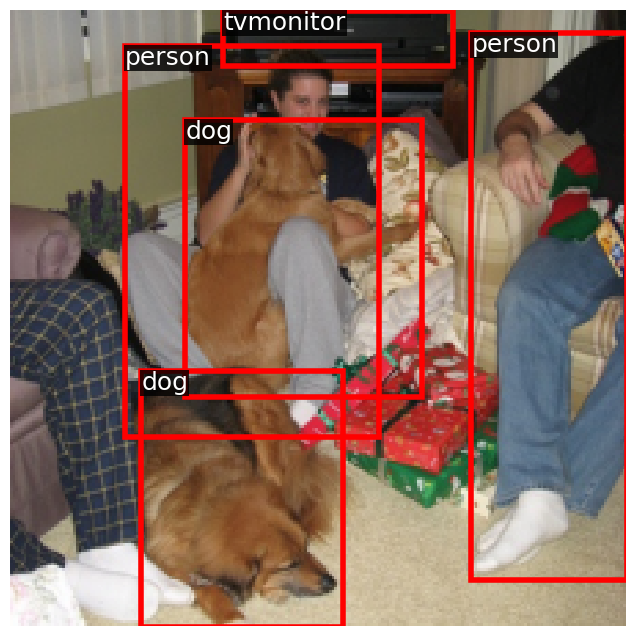

tensor([[  0.0000, 169.0372, 100.6770, 224.0000],
        [ 36.8273,   0.0000, 224.0000,  57.6763],
        [123.9344,   0.0000, 224.0000, 106.5472],
        [  0.0000,   0.0000,  71.4100,  94.1451],
        [  0.0000,  21.7028,  86.6617, 151.7581],
        [ 86.3588,  35.8703, 184.4024, 203.3961],
        [ 30.3833,   0.0000, 147.4150,  73.2832],
        [ 34.5720,  39.7465, 224.0000, 138.5300],
        [ 54.7041,   0.0000, 153.2930, 123.1613],
        [  0.0000,   8.9677, 120.7632, 106.8774],
        [106.5920,  53.7359, 224.0000, 185.9206],
        [ 86.8354,   0.0000, 183.6906,  93.5889],
        [  0.0000, 112.9632,  57.2253, 224.0000],
        [  8.8663, 168.9912, 198.7447, 224.0000],
        [ 75.4835,  99.8484, 199.4673, 224.0000],
        [ 27.3575,  34.4113, 151.2193, 172.1996],
        [107.6158, 133.6671, 224.0000, 224.0000],
        [ 27.9520, 132.9382, 149.5569, 224.0000],
        [  0.0000,  71.4865, 202.3557, 170.3659],
        [  0.0000,  68.1297, 102.7725, 201.6264]],

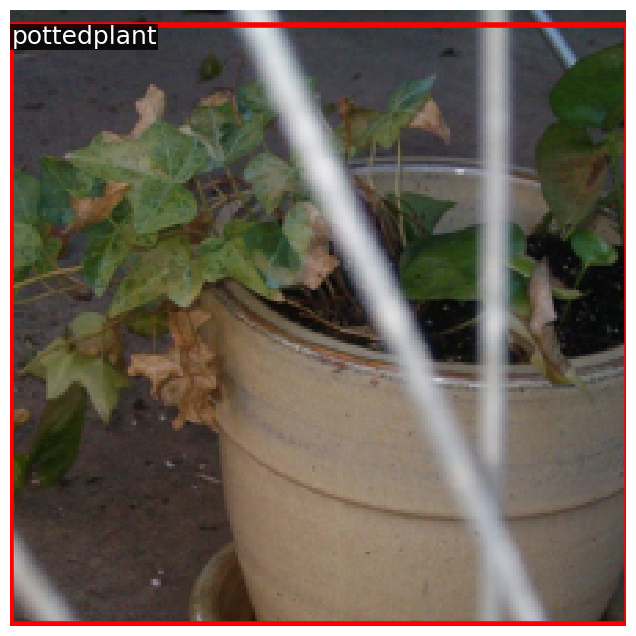

tensor([[ 90.8733,   0.0000, 140.6072,  45.7638],
        [ 58.0058,   0.0000, 155.8072,  29.3484],
        [ 74.4324,   0.0000, 124.0433,  44.1930],
        [ 18.7219,   0.0000, 214.5387,  58.8102],
        [ 61.5905, 122.3580, 122.3210, 191.3004],
        [  0.0000, 118.6509, 187.3252, 218.7103],
        [ 60.8499, 132.2286, 155.6601, 179.7011],
        [ 21.6245,  84.5900, 123.1623, 224.0000],
        [ 66.6147,  39.1017, 116.4082, 129.6534],
        [  0.0000, 100.1369,  89.4700, 224.0000],
        [ 54.8023,   0.0000, 152.1983,  93.5176],
        [ 69.8221, 101.2001, 169.1797, 224.0000],
        [ 74.4566,   0.0000, 199.1511, 107.6821],
        [ 55.0539,  60.3829, 144.8181, 107.4507],
        [ 76.8917, 152.9568, 194.6465, 224.0000],
        [ 82.6549, 101.2543, 132.5958, 187.9718],
        [ 39.0821,   5.2759, 136.5069, 170.3313],
        [  0.0000,  34.2282,  74.3400, 202.0315],
        [  0.3066,  86.4724, 204.1663, 187.9004],
        [ 86.1401,  41.8542, 146.9774, 112.4646],


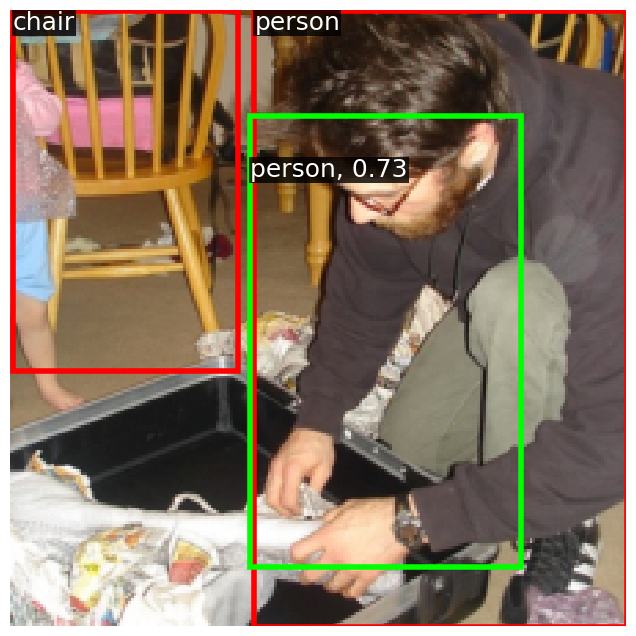

tensor([[  0.0000,   0.0000, 119.2049,  74.4326],
        [  0.0000, 137.0596,  84.4696, 224.0000],
        [ 98.5763,  71.6978, 224.0000, 169.3362],
        [  0.0000,   0.0000,  73.8698, 125.0585],
        [149.1836, 101.2784, 224.0000, 224.0000],
        [102.3009,   0.0000, 199.3692,  92.7917],
        [ 36.8919,   0.0000, 224.0000,  57.6866],
        [  7.5313,  23.2559, 105.0794, 189.2935],
        [101.8026, 152.3355, 224.0000, 224.0000],
        [ 52.1095,  92.5953, 147.5034, 139.6775],
        [ 22.6117,  84.1346, 120.7739, 224.0000],
        [  0.0000,  70.4800, 187.5219, 169.9292],
        [ 73.6285,  50.9534, 200.2581, 190.3217],
        [  0.0000,   7.7782, 185.4838, 106.2678],
        [ 38.6779,   0.0000, 137.1352, 123.8766],
        [ 30.7452, 103.1911, 224.0000, 202.5128],
        [ 37.7249,  35.7421, 137.2069, 202.1111],
        [ 82.8041,   0.0000, 131.0111,  81.8377],
        [  0.0000,  40.1459, 202.9572, 138.9561],
        [ 87.4336, 115.8127, 185.1047, 224.0000],


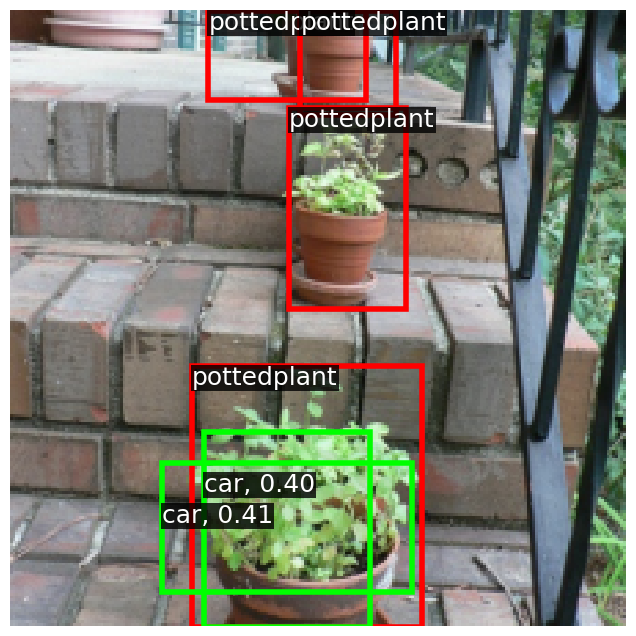

tensor([[ 52.4429,   0.0000, 224.0000,  57.8869],
        [  0.0000,  19.1643,  73.9578, 187.9999],
        [149.1955, 101.1599, 224.0000, 224.0000],
        [  0.0000,   0.0000, 153.0836,  74.5891],
        [  0.0000,  39.8916, 139.1445, 139.6866],
        [ 22.4487,   0.0000, 121.3637, 122.9667],
        [  0.0000, 111.6197,  57.1605, 224.0000],
        [  0.0000, 169.1170, 117.7716, 224.0000],
        [  0.0000,   0.0000,  71.5143,  94.4158],
        [  0.0000,  70.7945, 153.8420, 169.9681],
        [ 91.0142,   0.0000, 216.0348, 126.4876],
        [ 38.2757,  36.3530, 136.8968, 203.4780],
        [149.3162,  20.6769, 224.0000, 189.5781],
        [ 31.1731,  87.2198, 224.0000, 186.0086],
        [ 57.6887,  34.0264, 183.4848, 175.1565],
        [  6.1164, 100.1545, 106.3342, 224.0000],
        [ 45.1710, 153.6030, 162.3861, 224.0000],
        [ 70.1635, 101.0070, 168.2675, 224.0000],
        [ 99.3965,  71.6057, 224.0000, 168.6326],
        [  0.0000, 118.7495, 186.5761, 218.4666]],

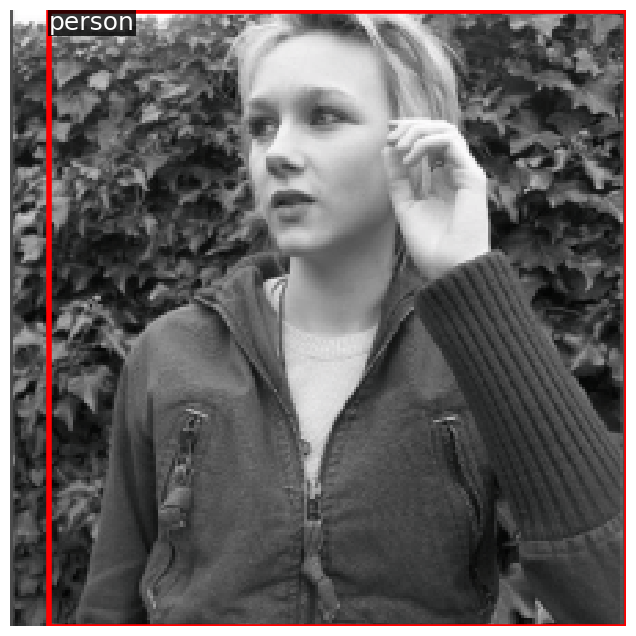

tensor([[  0.0000,   0.0000,  73.3640, 123.6294],
        [  0.0000, 138.9220,  65.6211, 224.0000],
        [157.0797,   0.0000, 224.0000, 121.0099],
        [  0.0000,   0.0000, 136.4190,  74.7010],
        [  0.0000,  36.0754,  73.3739, 203.2987],
        [  0.0000, 169.3488, 166.7239, 224.0000],
        [  6.4320,  99.2576, 105.6307, 224.0000],
        [  0.0000,  17.6046, 120.9067, 160.9191],
        [ 28.1730, 132.4595, 149.4428, 224.0000],
        [ 36.0090,   0.0000, 224.0000,  57.5377],
        [ 70.6981, 115.1752, 168.6505, 224.0000],
        [ 17.3940, 103.2906, 217.7673, 201.7741],
        [ 42.2131,  65.8775, 167.0994, 206.7399],
        [  0.0000,   7.3795, 203.2702, 106.6581],
        [118.3764,  36.5212, 217.3907, 204.1865],
        [ 64.1372,  71.2208, 224.0000, 169.9303],
        [ 30.7625,  39.0269, 224.0000, 138.1517],
        [149.4822, 116.5930, 224.0000, 224.0000],
        [102.3817,   0.0000, 199.7472,  94.2899],
        [ 54.6843,   0.0000, 153.3137, 124.2204],


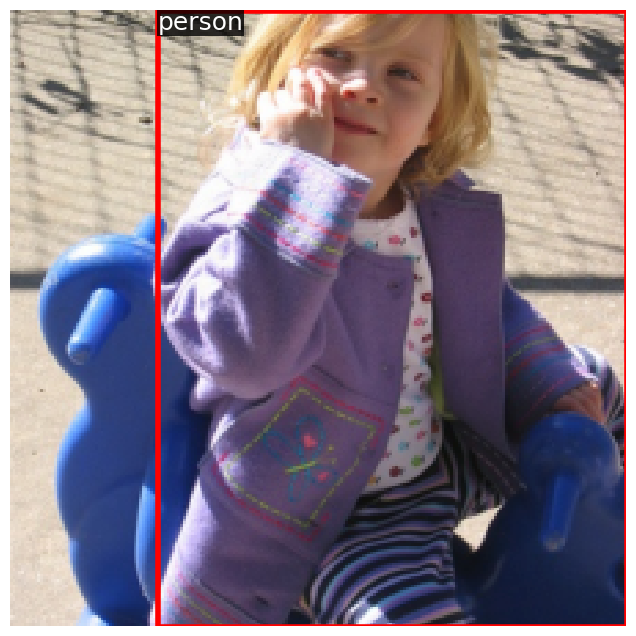

tensor([[  0.0000,   0.0000,  84.6344,  87.4167],
        [ 37.1209,   0.0000, 224.0000,  57.7867],
        [132.5150,  20.6952, 224.0000, 188.3479],
        [ 82.7609, 135.9297, 224.0000, 224.0000],
        [ 30.4705,   0.0000, 148.2802,  73.2724],
        [124.3127,   0.0000, 224.0000,  90.8877],
        [ 45.7733, 153.8494, 162.5190, 224.0000],
        [ 99.4068,  55.9646, 224.0000, 153.0647],
        [ 89.8208,   0.0000, 215.6125, 127.7219],
        [  0.0000,   3.6360,  73.3129, 173.3553],
        [  0.0000, 134.4159, 100.7879, 224.0000],
        [  0.0000,   7.6375, 201.5936, 107.1022],
        [ 70.1977, 100.6636, 169.3035, 224.0000],
        [  0.0000,  79.7542,  57.7866, 224.0000],
        [ 71.1977,  31.5055, 199.5974, 177.2886],
        [ 54.6822,   0.0000, 153.1309, 122.8328],
        [ 22.3446,  83.9560, 121.7218, 224.0000],
        [ 12.9911,  38.4249, 218.6736, 138.6848],
        [  0.0000,  86.2404, 202.9971, 186.3449],
        [  0.0000,  56.7542, 121.9460, 155.0774],


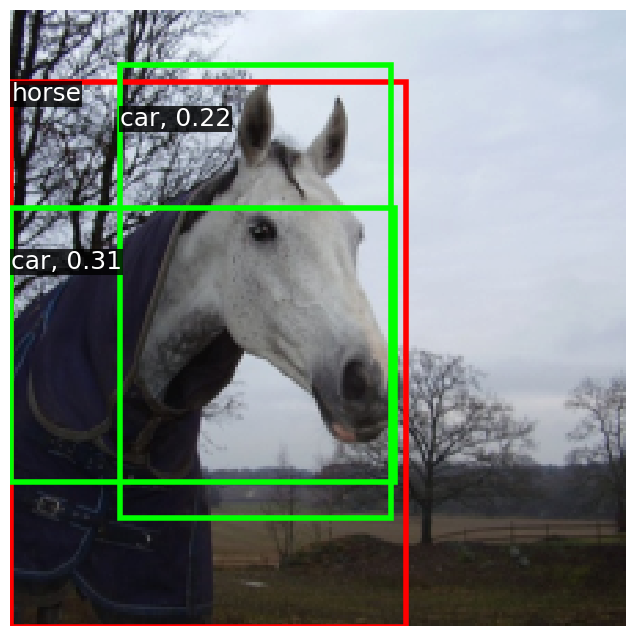

tensor([[  0.0000, 138.9509,  66.0656, 224.0000],
        [  0.0000,   0.0000,  84.2957,  88.3117],
        [  0.0000,  66.7313,  73.4939, 224.0000],
        [ 62.2634,   0.0000, 180.2612,  74.6752],
        [ 55.0985, 113.9579, 152.7770, 224.0000],
        [  0.0000, 103.6181, 186.7589, 202.3799],
        [ 77.4484, 152.9157, 195.1945, 224.0000],
        [  0.0000, 152.5196, 138.1335, 224.0000],
        [ 15.2945,   0.0000, 219.8253,  90.1700],
        [ 38.3023,   0.0000, 135.5476,  92.9837],
        [ 90.7580,   0.0000, 215.9846, 125.9996],
        [123.3995, 114.8954, 224.0000, 224.0000],
        [149.4223,   0.0000, 224.0000, 124.4309],
        [ 86.8754,  52.1171, 185.6519, 217.6841],
        [  0.0000,  22.6325,  85.4445, 151.8226],
        [  0.0000,  50.1318, 119.4066, 188.4180],
        [ 78.7512,  87.6301, 224.0000, 186.6764],
        [ 54.6087,  20.3761, 153.4669, 186.5639],
        [ 29.4700,  55.2805, 224.0000, 154.5359],
        [  0.0000,  23.6957, 187.6303, 122.3728],


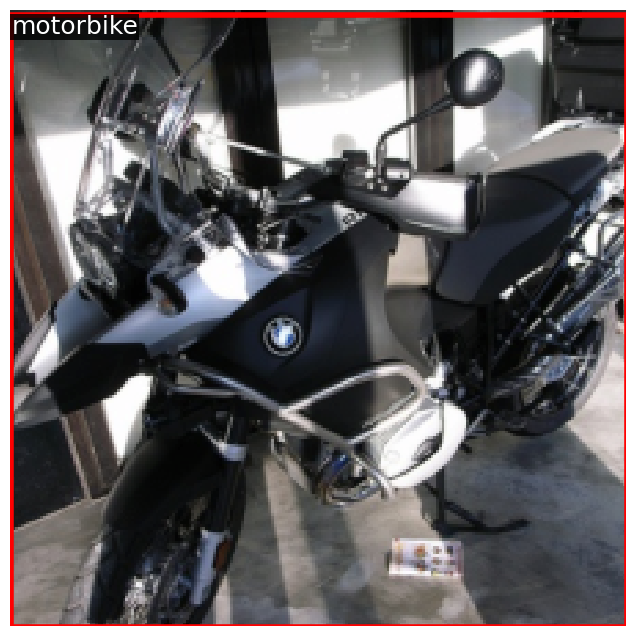

tensor([[  0.0000,   0.0000, 117.8724, 122.8880],
        [ 43.9649,   0.0000, 165.9931, 123.0604],
        [  5.9165,   0.0000, 197.7947,  57.5899],
        [106.9309,   0.0000, 156.0742,  81.9139],
        [106.7533,  61.8191, 156.1978, 154.6933],
        [  0.0000,  39.9367, 185.8135, 137.8563],
        [ 87.7966,   4.8082, 184.6696, 172.3045],
        [ 88.3106,  92.8715, 176.6941, 139.0439],
        [ 39.3108,  20.3667, 136.7908, 189.2453],
        [ 87.7211,  20.2519, 177.1557,  67.3358],
        [ 76.0725,   0.0000, 198.4050,  91.3299],
        [ 33.2806,  71.8509, 224.0000, 171.6922],
        [ 34.8400,  61.2282,  82.6860, 154.7891],
        [  0.0000,  52.8585, 117.1667, 187.8535],
        [  0.0000, 169.1205, 133.0301, 224.0000],
        [ 18.5902,  93.6769, 103.2676, 139.5974],
        [ 88.4880, 172.8279, 177.5373, 219.1688],
        [ 71.2449,  51.7174, 169.5582, 219.8245],
        [ 77.5969, 152.7039, 194.6797, 224.0000],
        [  7.0667, 100.6683, 103.3466, 224.0000],


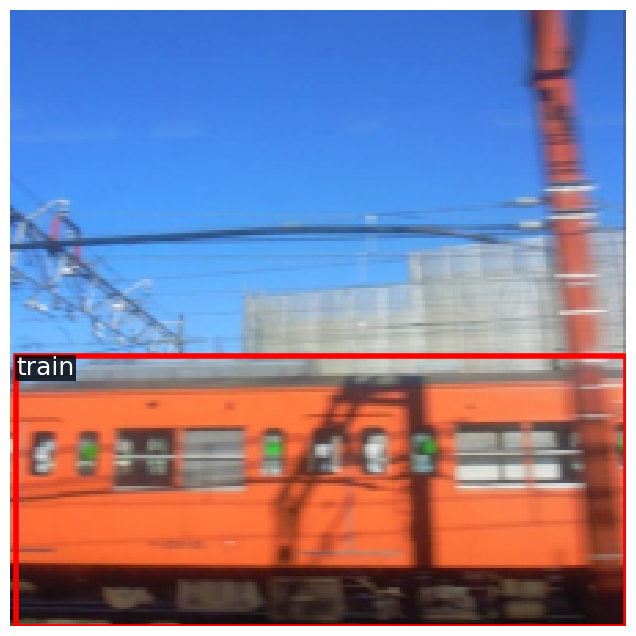

tensor([[ 86.2085, 117.6528, 184.2614, 224.0000],
        [  0.0000, 139.5424,  65.4232, 224.0000],
        [  0.0000, 169.1894, 182.4949, 224.0000],
        [ 11.9871, 116.4161, 133.8863, 224.0000],
        [  0.0000,   3.0309,  73.3437, 172.8792],
        [102.6798,   0.0000, 201.3154, 124.3005],
        [ 65.1039, 165.1594, 151.3492, 211.3741],
        [ 83.1890, 135.4227, 130.3605, 224.0000],
        [  0.0000,   0.0000, 120.0694,  90.6147],
        [ 61.2780,   0.0000, 182.0260,  91.6836],
        [134.0569,  20.7201, 224.0000, 189.8037],
        [  0.0000,  71.3235,  84.6681, 200.0745],
        [  4.7377,   0.0000, 197.5298,  57.6417],
        [  0.0000, 103.9199, 202.0500, 202.1494],
        [ 85.3764,  20.8229, 185.3008, 189.2235],
        [ 37.9000,   0.0000, 137.3812, 124.3141],
        [ 16.7640,  22.9340, 217.9200, 121.8795],
        [ 54.3635,  83.6315, 153.4071, 224.0000],
        [  0.0000,  56.6121, 120.6229, 154.6087],
        [ 40.8545,  35.5584, 167.5872, 173.7275]],

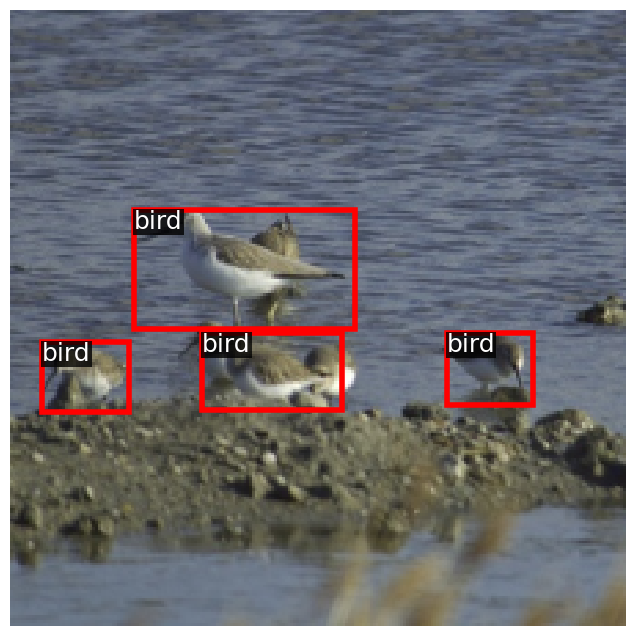

tensor([[2.1020e+01, 0.0000e+00, 2.1358e+02, 5.7597e+01],
        [7.7015e+01, 0.0000e+00, 1.9818e+02, 9.0164e+01],
        [7.1378e+01, 1.3097e+01, 1.5994e+02, 5.9071e+01],
        [0.0000e+00, 0.0000e+00, 9.0039e+01, 1.2340e+02],
        [6.1474e+01, 1.7208e+02, 1.5466e+02, 2.1951e+02],
        [4.1422e+01, 1.6893e+02, 2.2400e+02, 2.2400e+02],
        [3.7478e+01, 0.0000e+00, 1.3683e+02, 1.0786e+02],
        [1.0987e-01, 7.7632e+00, 2.0251e+02, 1.0661e+02],
        [8.2959e+01, 1.4470e+02, 1.3239e+02, 2.2400e+02],
        [9.8663e+01, 0.0000e+00, 1.4760e+02, 7.5560e+01],
        [2.9705e+01, 1.5295e+02, 1.4692e+02, 2.2400e+02],
        [6.7857e+01, 1.5628e+02, 1.6285e+02, 2.0366e+02],
        [7.5927e+01, 1.3353e+02, 1.9611e+02, 2.2400e+02],
        [0.0000e+00, 9.8370e+01, 7.2975e+01, 2.2400e+02],
        [9.3620e+01, 1.3953e+02, 1.5357e+02, 2.0756e+02],
        [5.4668e+01, 1.0184e+02, 1.5304e+02, 2.2400e+02],
        [0.0000e+00, 5.1629e+01, 1.0406e+02, 1.8789e+02],
        [0.000

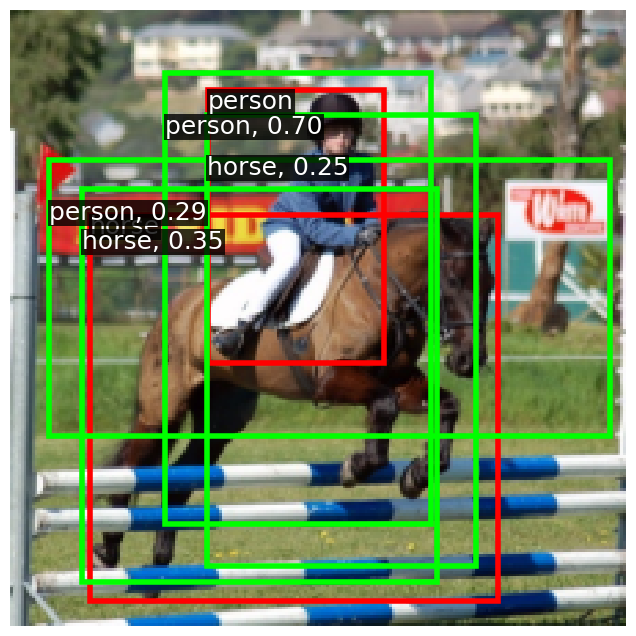

tensor([[ 78.4892, 154.0909, 194.5655, 224.0000],
        [  0.0000, 169.1467, 100.5030, 224.0000],
        [  0.0000,   0.0000, 181.6310,  57.3395],
        [ 78.5100,   0.0000, 195.4703,  73.0020],
        [109.3880, 134.8371, 224.0000, 224.0000],
        [  0.0000,  55.7869,  84.8506, 183.0142],
        [  0.0000,   0.0000,  84.1962,  86.5512],
        [ 22.0308,  68.5604, 121.0603, 224.0000],
        [ 33.0574,   0.0000, 224.0000,  89.8688],
        [ 28.7909, 134.4754, 149.6154, 224.0000],
        [ 54.5054,   0.0000, 151.4530,  93.7421],
        [ 42.5032,  83.4714, 165.3376, 219.8747],
        [  0.0000,  99.3050,  73.1538, 224.0000],
        [  1.1633,  87.5325, 202.7050, 186.1002],
        [  6.4063,   0.0000, 105.7842, 138.3021],
        [ 27.1304,  35.4293, 151.0381, 171.4038],
        [ 86.8626,  37.1608, 184.6140, 205.5754],
        [  0.0000,  23.6318, 185.4996, 122.1773],
        [107.8117,  52.8638, 224.0000, 187.6934]], device='cuda:0') tensor([-1, -1, -1, -1, -1, -1, 

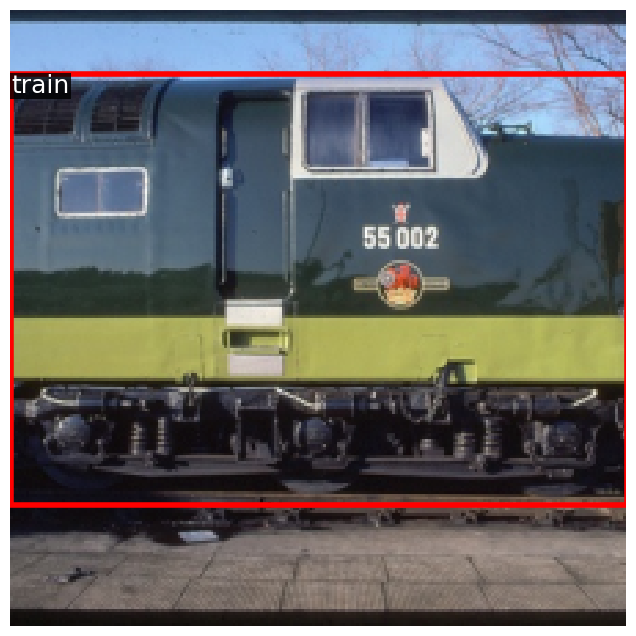

tensor([[  9.3816, 168.5877, 198.8510, 224.0000],
        [ 18.3003,   0.0000, 212.9974,  57.8670],
        [  0.0000, 136.3829,  84.3240, 224.0000],
        [ 63.1684, 164.6861, 154.6647, 211.3556],
        [ 71.6703,  13.3043, 161.3281,  59.6233],
        [ 26.6813, 132.7663, 149.7734, 224.0000],
        [ 85.1487,   0.0000, 148.4327,  76.7391],
        [  0.0000,   0.0000,  71.5503,  93.1536],
        [102.0719,   0.0000, 199.6282,  92.1435],
        [ 38.1839,   0.0000, 135.7896,  93.2243],
        [ 73.6850, 112.8185, 198.5555, 224.0000],
        [ 81.2617, 135.0415, 133.5071, 224.0000],
        [ 23.4118,  68.7464, 121.1916, 224.0000],
        [ 57.6151,   0.0000, 183.8270, 110.2670],
        [  0.3896, 102.8252, 202.8937, 201.9972],
        [  0.0000,  34.2122,  73.4663, 204.6574],
        [133.6671,  21.1037, 224.0000, 189.3434],
        [ 81.8670,  63.7143, 132.3692, 146.2672],
        [  7.3337,   5.1519, 104.2945, 171.0128],
        [ 86.5448,  21.8834, 185.1929, 187.8757],


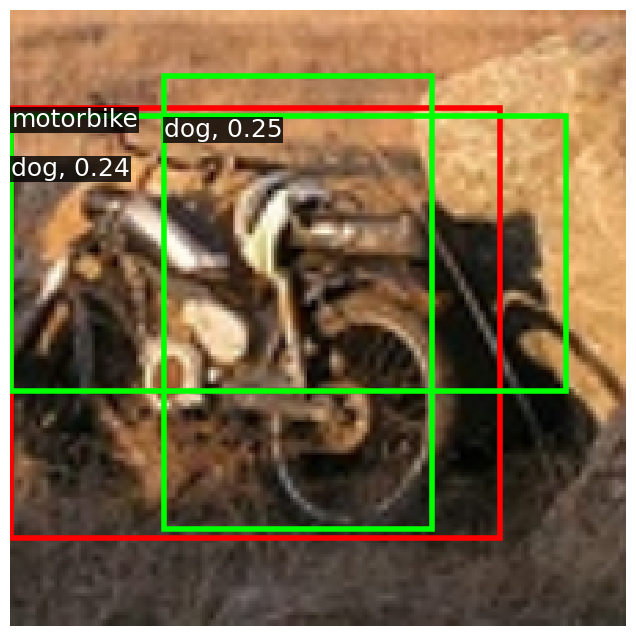

tensor([[5.4854e+01, 0.0000e+00, 1.5166e+02, 9.3343e+01],
        [0.0000e+00, 0.0000e+00, 1.3723e+02, 7.4274e+01],
        [0.0000e+00, 0.0000e+00, 1.0352e+02, 1.2470e+02],
        [3.5022e+01, 0.0000e+00, 2.2400e+02, 5.7579e+01],
        [0.0000e+00, 1.1082e+02, 5.7912e+01, 2.2400e+02],
        [1.3393e-01, 8.2808e+00, 2.0406e+02, 1.0716e+02],
        [1.4834e+02, 1.0214e+02, 2.2400e+02, 2.2400e+02],
        [1.5636e+02, 0.0000e+00, 2.2400e+02, 1.0475e+02],
        [0.0000e+00, 1.8345e+01, 7.3988e+01, 1.8827e+02],
        [2.6955e+01, 1.8899e+01, 1.5227e+02, 1.5725e+02],
        [1.3749e+02, 5.0714e+01, 2.2400e+02, 1.8891e+02],
        [7.1183e+01, 3.3066e+00, 1.6971e+02, 1.7162e+02],
        [8.9583e+01, 0.0000e+00, 2.1569e+02, 1.2555e+02],
        [3.1765e+01, 3.9033e+01, 2.2400e+02, 1.3810e+02],
        [8.4265e+00, 1.6858e+02, 1.9883e+02, 2.2400e+02],
        [1.0248e+02, 1.5277e+02, 2.2400e+02, 2.2400e+02],
        [7.7677e+01, 8.6259e+01, 2.2400e+02, 1.8613e+02],
        [5.640

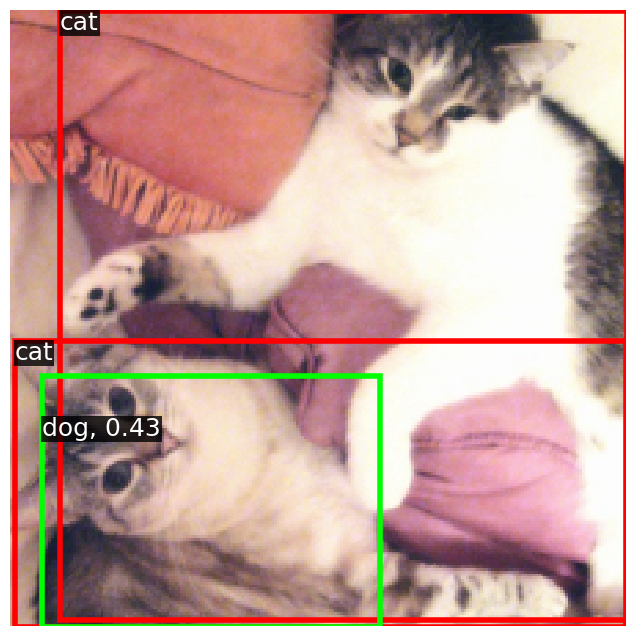

tensor([[  0.0000,  98.4241,  73.5428, 224.0000],
        [  0.0000,   0.0000, 101.9638,  89.8530],
        [ 20.4913,   0.0000, 213.1477,  57.3183],
        [  0.0000,  18.7488,  89.7684, 185.4047],
        [  0.0000,  88.8523, 121.8401, 187.1485],
        [  0.0000, 153.2367, 120.2134, 224.0000],
        [ 72.2325, 180.9281, 161.3451, 224.0000],
        [ 92.9276,   0.0000, 213.2031,  91.6534],
        [ 25.5975, 168.9505, 213.9677, 224.0000],
        [ 81.0963, 141.1730, 133.3171, 224.0000],
        [ 28.9644,   0.0000, 150.9265,  91.6596],
        [ 24.0472, 113.2831, 151.2033, 224.0000],
        [ 86.9689,   9.5539, 147.5820,  78.6269],
        [ 14.4632,   7.3241, 218.4136, 106.1125],
        [ 75.4167, 132.4389, 197.8352, 224.0000],
        [ 69.6778,   0.0000, 169.0607, 123.7751],
        [122.8285,  51.3276, 224.0000, 187.9449],
        [ 38.7449,  22.2305, 137.9225, 186.8869],
        [ 13.1907,  85.6745, 220.4231, 187.3204],
        [ 69.5426,  69.5458, 170.0755, 224.0000],


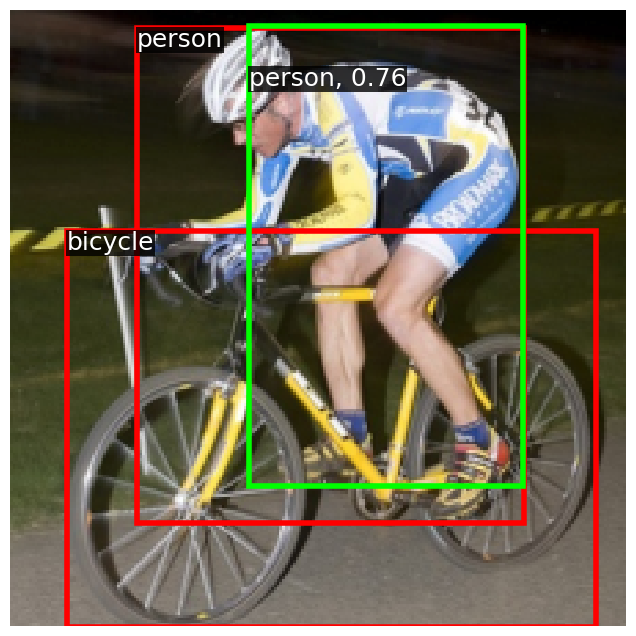

tensor([[  0.0000, 152.8194, 168.8826, 224.0000],
        [ 86.0201, 150.9619, 147.9109, 224.0000],
        [  0.0000,   0.0000,  88.6798, 109.0271],
        [  0.0000,   0.0000, 183.8109,  74.4157],
        [ 38.3036,   0.0000, 135.2560,  92.8235],
        [ 95.1513,   1.9091, 154.1065,  69.0647],
        [ 92.2192,   0.0000, 214.8129, 108.6385],
        [  0.0000,  99.4908,  88.5590, 224.0000],
        [  0.0000,  20.1513,  89.8794, 187.7133],
        [ 16.5920,  22.8961, 218.8367, 122.8866],
        [ 87.2600, 115.9686, 184.9581, 224.0000],
        [ 70.8804,   0.0000, 169.2466, 153.9131],
        [ 17.3200, 119.8357, 218.8613, 218.2157],
        [100.0873,  64.4352, 149.1038, 149.3139],
        [ 86.9332,  38.0407, 185.0444, 203.9375],
        [  2.6183,  54.5593, 203.6007, 155.4724],
        [ 22.5781,  83.7536, 120.8835, 224.0000],
        [ 75.0201,  92.5280, 172.1345, 140.3926],
        [ 39.0976,  22.1072, 136.6187, 187.8116],
        [ 33.4249,  86.9857, 224.0000, 186.0925],


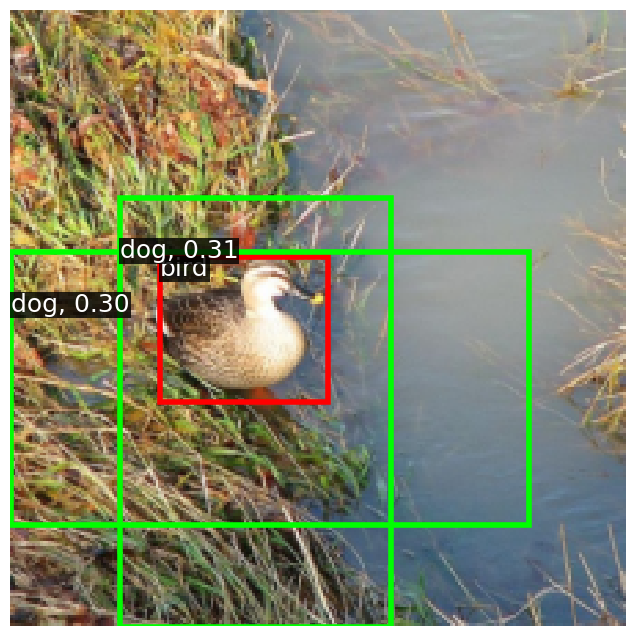

tensor([[ 77.2648, 153.5285, 195.2503, 224.0000],
        [ 45.7210, 167.8312, 108.0668, 224.0000],
        [  0.0000, 152.0416, 138.7745, 224.0000],
        [  0.0000,  98.8202,  89.0718, 224.0000],
        [  0.0000,  34.7723,  74.5469, 204.2048],
        [ 69.5884,  62.8637, 131.6765, 139.9873],
        [ 21.9573,  68.8617, 120.8319, 224.0000],
        [ 74.8181,  17.7488, 199.8295, 157.0440],
        [  0.0000,   0.0000,  71.1580,  94.3078],
        [ 30.0180,   0.0000, 148.0839,  75.1448],
        [ 15.5224, 119.3831, 219.3907, 219.0899],
        [  0.7833,  54.7203, 203.5411, 154.3677],
        [ 38.8251,  29.0389, 129.6696,  76.0542],
        [ 58.9962,   0.0000, 183.2281, 111.0570],
        [132.3454, 100.6103, 224.0000, 224.0000],
        [ 53.5201,   5.1299, 153.0104, 170.6243],
        [ 86.3946,  54.4637, 184.5790, 219.3937],
        [ 53.9417,  14.4346, 116.7683,  91.5342],
        [  0.0000,   7.4179, 155.5890, 107.2330],
        [  0.0000,  86.7164, 186.6751, 186.6179],


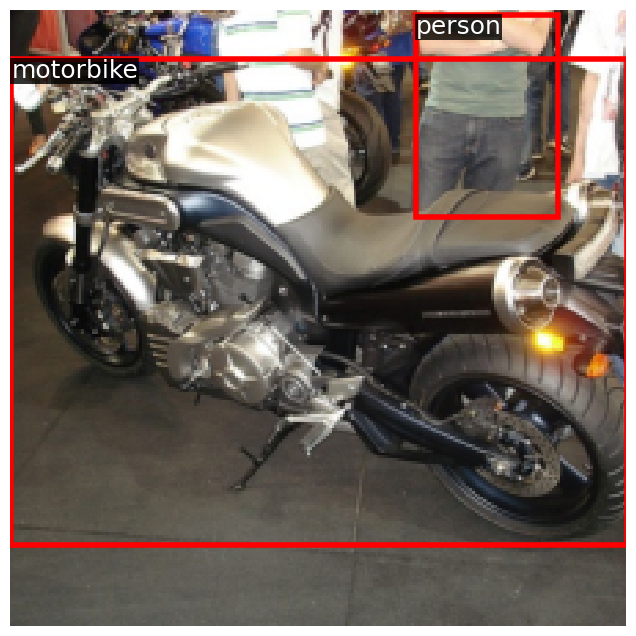

tensor([[  0.0000,  96.7431,  56.7854, 224.0000],
        [  0.0000, 169.3390, 118.2719, 224.0000],
        [  0.0000,  34.7561,  89.1163, 203.3109],
        [  0.0000,   0.0000, 137.3278,  74.6514],
        [  6.5890,   0.0000, 105.2404, 124.1430],
        [  0.0000,   0.0000,  71.8806,  93.4647],
        [ 78.7672,   0.0000, 195.1387,  72.9930],
        [ 45.6893, 153.4170, 161.6917, 224.0000],
        [  0.0000, 121.4359, 120.5785, 218.9123],
        [ 99.3527,   8.4038, 224.0000, 104.9369],
        [ 43.9499,   0.0000, 166.3632, 110.0285],
        [134.2080, 116.0609, 224.0000, 224.0000],
        [  0.0000,  24.5211, 187.9789, 123.6058],
        [  0.0000,  56.1968, 138.0444, 154.4795],
        [ 72.2327,  97.9021, 197.8197, 224.0000],
        [ 39.3938,  67.6312, 136.9437, 224.0000],
        [  0.0000, 103.2954, 186.0687, 201.9475],
        [  3.7941,  71.6472, 201.9148, 170.2574],
        [ 86.2617,  21.5240, 186.6909, 191.2796],
        [ 55.6019,  37.8033, 151.9289, 205.1358],


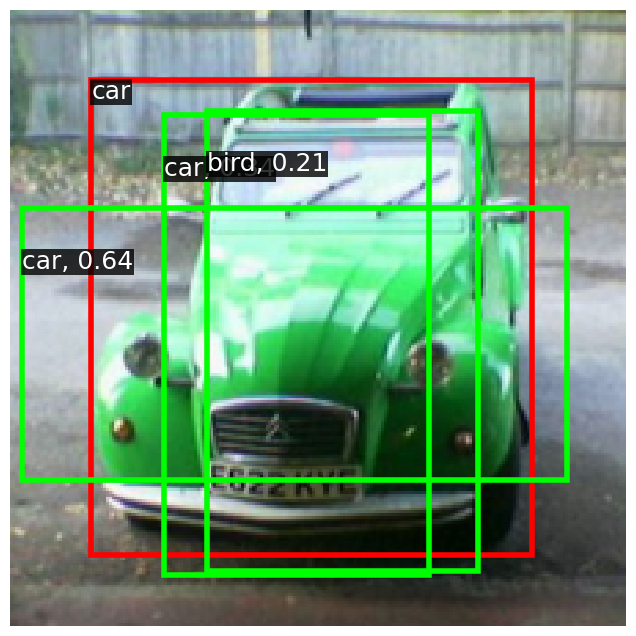

tensor([[ 62.6576, 180.5785, 155.2530, 224.0000],
        [ 25.5479, 168.4717, 214.8424, 224.0000],
        [ 21.0339,   0.0000, 213.7776,  57.7110],
        [ 85.9128,   0.0000, 147.7642,  74.0382],
        [ 69.6697,  37.8677, 162.6330,  84.4164],
        [  0.0000,   0.0000, 154.1900,  90.4328],
        [ 72.3102,  13.3293, 160.9921,  59.5547],
        [ 86.0464,   0.0000, 183.1660,  94.0155],
        [ 74.4763, 133.1819, 197.2234, 224.0000],
        [ 91.8091, 152.8551, 155.2212, 224.0000],
        [ 76.6505, 164.3853, 172.8234, 211.4862],
        [  0.0000,  23.3714, 186.2383, 122.1877],
        [ 11.9147, 135.2516, 133.6884, 224.0000],
        [ 85.1193,  97.8876, 147.4683, 169.0221],
        [ 65.4548, 109.5689, 163.6774, 157.1533],
        [ 82.1305,  93.1085, 179.7078, 140.9075],
        [ 39.4497,   5.0956, 135.7692, 171.9039],
        [ 72.6485,  19.6474, 168.8353, 185.2830],
        [ 90.2386,  64.1140, 139.5320, 148.0590],
        [101.0483,  74.0077, 163.0480, 143.1838],


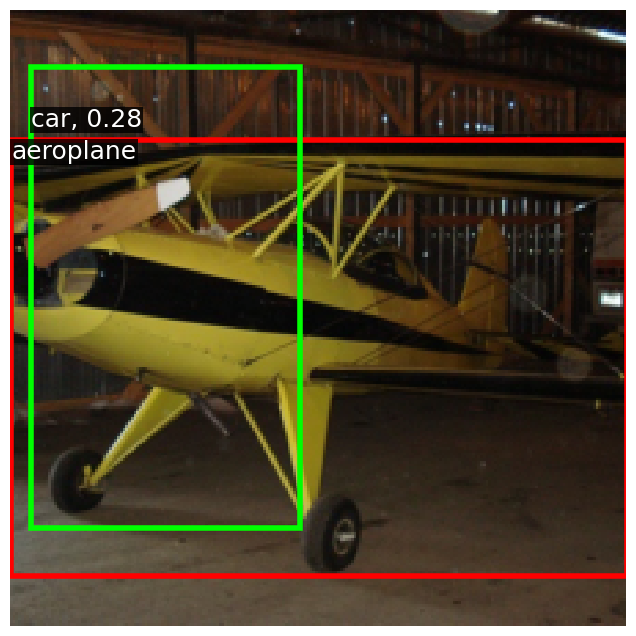

tensor([[  6.5142,   4.8430, 106.1838, 172.2517],
        [  0.0000,   0.0000, 120.6312,  90.5406],
        [  0.0000, 139.0460,  65.4738, 224.0000],
        [ 38.5011,   0.0000, 137.5584, 124.1267],
        [  0.0000,  23.7522, 186.7305, 122.8544],
        [  0.0000,  55.9347, 140.4015, 155.7429],
        [ 87.4162,  44.5798, 176.6808,  91.5721],
        [139.2543,   0.0000, 224.0000, 123.2637],
        [101.7473,  31.4667, 163.8803, 106.3419],
        [  5.3732, 100.0035, 105.0776, 224.0000],
        [  5.3640,   0.0000, 197.7859,  57.6191],
        [  0.0000, 168.9345, 133.9285, 224.0000],
        [ 75.0200,   0.0000, 198.9617, 109.9647],
        [ 41.7047,  32.7880, 169.3786, 177.4238],
        [ 72.5051,  63.8427, 201.7273, 209.0433],
        [ 39.0576, 100.5839, 137.4837, 224.0000],
        [ 18.7623, 151.3155, 220.2190, 224.0000],
        [ 98.1467,  87.1369, 224.0000, 184.7909],
        [138.5118,  52.0999, 224.0000, 185.7397],
        [  0.0000, 103.1842, 205.1956, 204.1914],


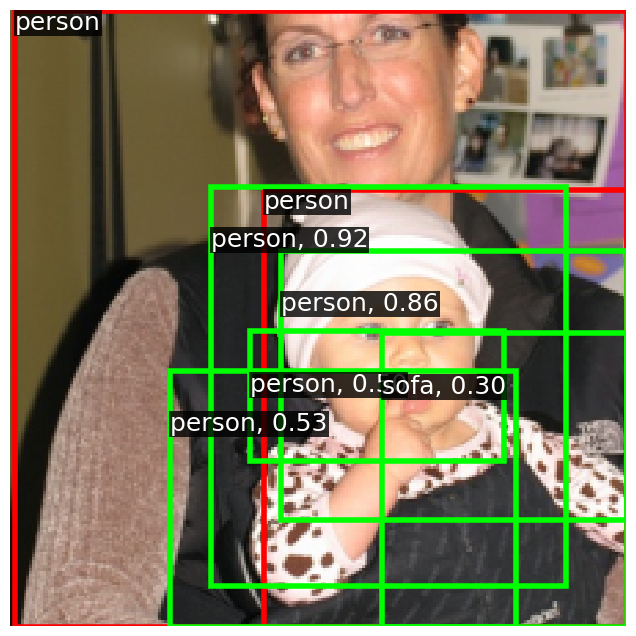

tensor([[ 10.6155, 169.3373, 198.3324, 224.0000],
        [ 77.5815,   0.0000, 137.0124,  63.2316],
        [  0.0000, 120.3700,  83.9971, 224.0000],
        [ 78.3826, 144.7773, 139.5025, 214.6414],
        [ 21.3980,   0.0000, 213.5397,  57.9036],
        [ 65.2913, 136.0359, 224.0000, 224.0000],
        [133.8180,   0.0000, 224.0000, 108.4305],
        [ 23.6954, 115.9437, 120.1618, 224.0000],
        [ 86.6931,   0.0000, 183.6936,  94.6157],
        [122.9021,  36.0414, 224.0000, 171.8907],
        [  0.0000,   0.0000, 139.3030,  90.8082],
        [ 48.7230,   7.9859, 224.0000, 106.9288],
        [ 54.7244,  84.2562, 152.2180, 224.0000],
        [ 72.8741,  67.7268, 197.5862, 203.6181],
        [ 61.4740,  84.1787, 155.6061, 130.9706],
        [ 69.5177,   3.8621, 169.7609, 171.6241],
        [ 14.5679,  69.9722, 220.5868, 169.8936],
        [  0.0000,  18.0967,  73.5344, 188.9106],
        [ 74.8405,  55.9209, 124.3582, 140.5087],
        [  0.0000,  22.8106, 185.7691, 123.8897],


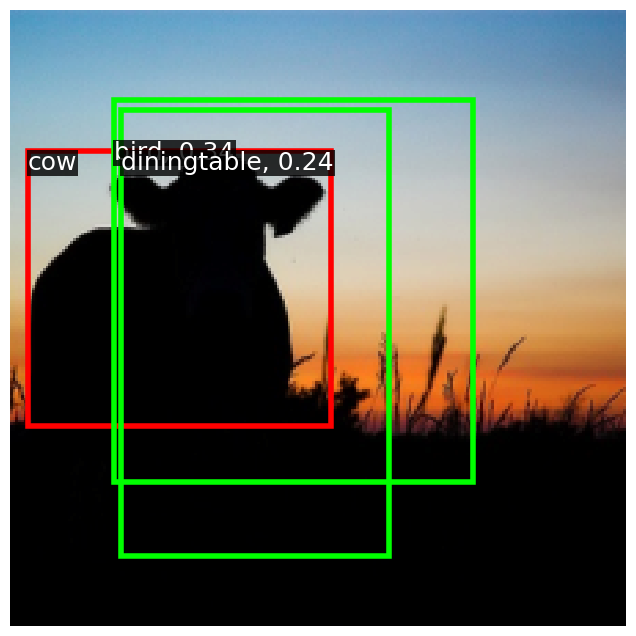

tensor([[ 93.9959,   0.0000, 212.0712,  72.5725],
        [  4.9100,   0.0000, 197.6811,  57.6109],
        [ 26.9190, 168.9428, 214.5663, 224.0000],
        [138.4669,   0.0000, 224.0000, 120.9352],
        [ 27.5065,   0.0000, 150.4426, 123.5883],
        [ 16.1468,  38.9522, 219.2469, 138.2152],
        [  0.0000,   0.0000, 120.3020,  74.8073],
        [  0.0000,  19.0148, 117.9487, 154.8678],
        [ 87.6378,   0.0000, 185.0786, 141.1592],
        [135.4799,  36.5094, 224.0000, 202.6322],
        [ 74.3556, 134.2911, 197.5029, 224.0000],
        [ 39.2303,  21.2735, 137.6429, 189.0311],
        [124.0992, 133.3677, 224.0000, 224.0000],
        [ 30.8381, 102.8999, 224.0000, 203.0072],
        [ 98.7306,  87.4335, 224.0000, 184.6788],
        [ 39.3596, 115.6594, 135.7818, 224.0000],
        [  0.0000,  71.8439, 187.7762, 171.1606],
        [ 70.9287,  37.1986, 168.6701, 203.3043],
        [  0.0000, 152.8220, 120.5965, 224.0000],
        [  6.9663,  83.3468, 105.5260, 224.0000]],

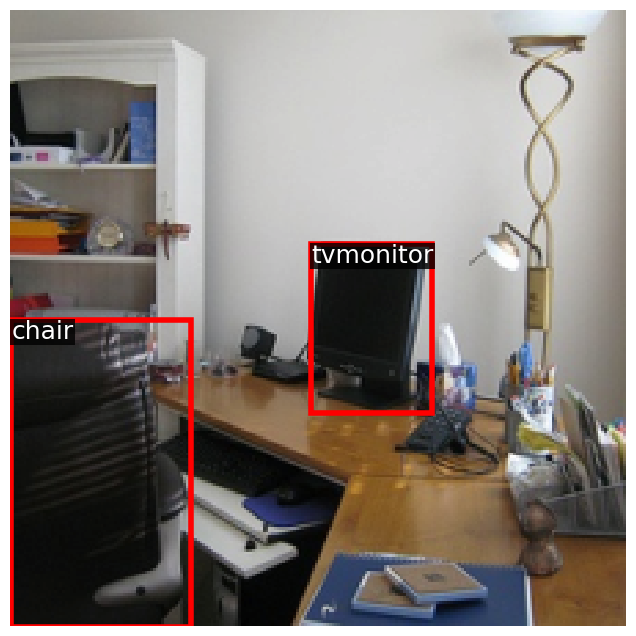

tensor([[ 41.3084,   0.0000, 168.7203, 123.7432],
        [ 90.9060,   0.0000, 141.3244,  80.0945],
        [ 77.9900,   0.0000, 195.6632,  73.3115],
        [ 68.5833,  36.0473, 162.7000,  83.6113],
        [110.7656,   3.3336, 169.6673,  70.7991],
        [ 70.2839,  12.6621, 161.8982,  59.3750],
        [ 85.9040,   7.8662, 185.7200, 172.3281],
        [ 68.0538, 180.9437, 162.5520, 224.0000],
        [ 15.4238,  38.2764, 221.8564, 139.2797],
        [ 40.4610,  65.9699, 171.6471, 205.4518],
        [ 10.4569, 168.5926, 197.7362, 224.0000],
        [ 89.9415,  72.6027, 141.5071, 154.5779],
        [ 71.7231,  83.6628, 174.8445, 133.4339],
        [ 93.9840, 154.0330, 154.7771, 222.0582],
        [ 40.1532,  21.3870, 137.2904, 185.0948],
        [ 83.7921, 135.6005, 131.8820, 220.7305],
        [  0.0000,  54.4282, 206.1010, 156.2641],
        [ 63.9999, 107.6868, 165.8234, 157.0844],
        [ 71.2566, 100.1278, 174.3084, 149.7194],
        [ 92.1293,  94.9995, 156.0440, 168.9864],


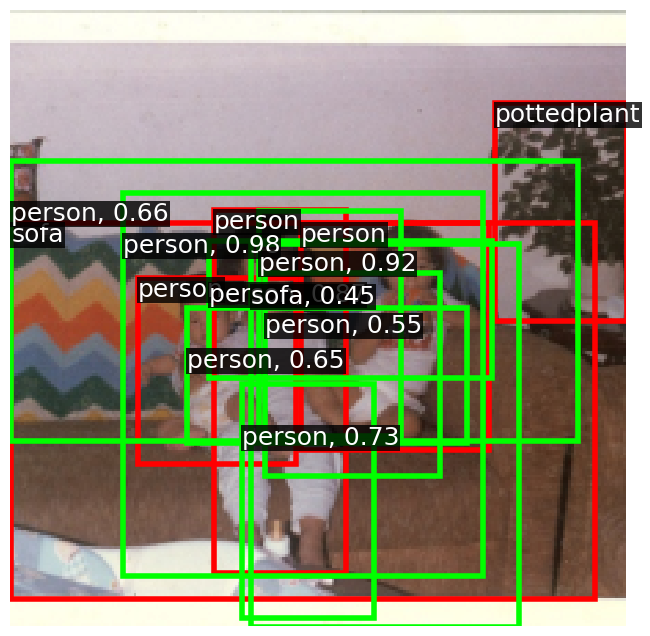

tensor([[  0.0000,   0.0000,  82.4746,  70.4337],
        [  0.0000,   0.0000, 181.7715,  57.3033],
        [ 78.4474,   0.0000, 196.2340,  73.0029],
        [  0.0000,  71.7138, 185.9972, 169.8314],
        [120.1124,   0.0000, 224.0000,  87.5940],
        [ 54.2650,   0.0000, 151.1244,  92.6870],
        [ 71.4440,   3.8000, 169.6672, 171.5163],
        [138.9501,  53.0574, 224.0000, 184.7977],
        [ 39.0125,  19.9160, 137.0644, 187.5489],
        [ 21.9521,   0.0000, 120.5059, 108.0397],
        [  0.0000,   4.8082,  88.0507, 173.6665],
        [ 15.9476,   8.3237, 218.3330, 106.8219],
        [ 32.0081,  39.8855, 224.0000, 138.9876],
        [ 23.5863,  68.6136, 120.8775, 224.0000],
        [  0.0000,  99.1968,  72.4463, 224.0000],
        [ 74.3363,  65.9196, 200.5661, 207.1421],
        [  0.0000, 169.4885, 133.9823, 224.0000],
        [149.2608, 102.0318, 224.0000, 224.0000],
        [102.3393, 152.4448, 224.0000, 224.0000],
        [  0.0000, 136.1530, 186.1475, 224.0000],


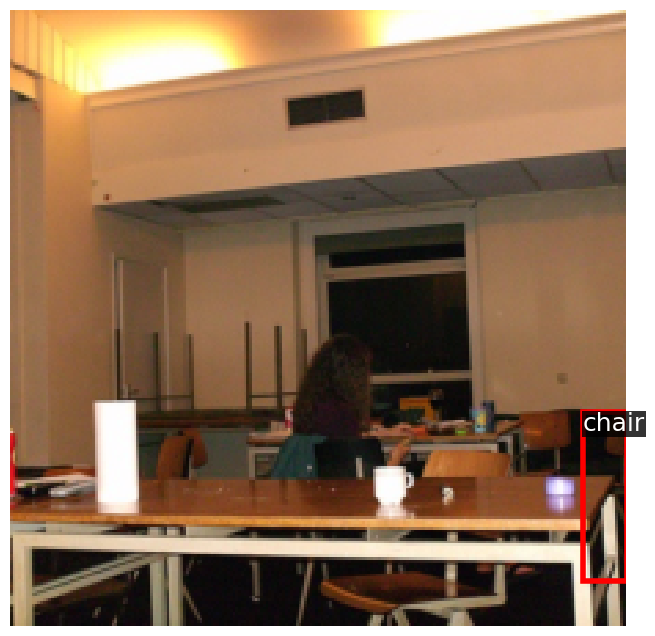

tensor([[ 70.2127,   0.0000, 169.1779, 109.7922],
        [  1.2193,  23.3917, 203.7774, 123.4162],
        [ 85.6048,  17.5442, 146.1281,  89.0547],
        [ 20.3961,   0.0000, 213.2585,  57.7255],
        [ 71.5521,  12.3776, 161.4097,  59.2117],
        [  0.0000,  21.2466, 117.6483, 153.9956],
        [ 89.6171,   0.0000, 216.1924, 124.0871],
        [ 55.8578,   2.3528, 152.8068, 168.5367],
        [ 70.4304, 181.0725, 162.0170, 224.0000],
        [  0.0000, 168.8609, 150.2209, 224.0000],
        [ 83.9169,  68.3790, 178.5890, 115.8615],
        [ 86.7287,  83.0377, 145.4905, 148.5904],
        [ 66.5493,  92.6019, 163.7235, 140.6249],
        [ 85.6197, 153.6504, 145.5606, 223.0328],
        [  1.6258,  71.2984, 203.0931, 171.0390],
        [ 17.6976,  54.8112, 219.9625, 155.2093],
        [  0.0000,  69.1670, 117.7497, 202.9731],
        [  0.0000, 116.8270,  87.6671, 224.0000],
        [ 91.7643,  63.5676, 140.0971, 148.3212],
        [ 71.5422,  37.9306, 168.6166, 203.8266],


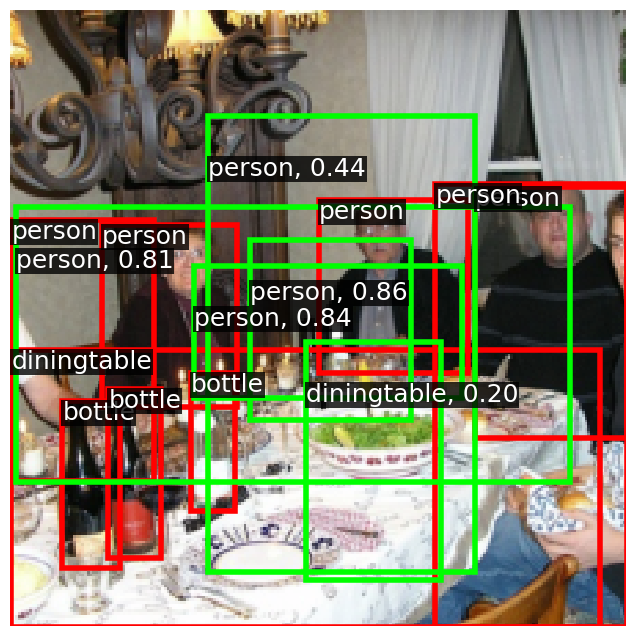

tensor([[  0.0000, 152.6747, 119.9869, 224.0000],
        [  0.0000,  98.3599,  73.9046, 224.0000],
        [123.7042, 116.5396, 224.0000, 224.0000],
        [  0.0000,   0.0000,  74.0228, 123.9415],
        [  0.0000,  20.0221,  88.8817, 186.3539],
        [ 20.1528, 152.8112, 216.6616, 224.0000],
        [ 63.2387, 164.9095, 152.9361, 211.8982],
        [ 37.0777,   0.0000, 224.0000,  57.3268],
        [ 30.2766,   0.0000, 147.4246,  73.5057],
        [ 75.4944, 115.2335, 197.1784, 224.0000],
        [106.0716,  49.2855, 224.0000, 190.3880],
        [  0.0000,  88.5642, 121.0708, 186.8561],
        [124.0228,   0.0000, 224.0000, 107.7192],
        [ 37.4133, 101.2493, 137.3756, 224.0000],
        [ 77.4482,   0.0000, 197.8069,  91.3923],
        [  0.0000, 102.0812, 203.1304, 202.4833],
        [  0.0000,   8.3180, 204.2371, 107.4473],
        [ 54.0486,   0.0000, 153.4555, 123.8432],
        [ 90.7842,  62.2642, 141.3355, 145.7432],
        [ 85.5968,  21.4539, 185.9093, 186.9315],


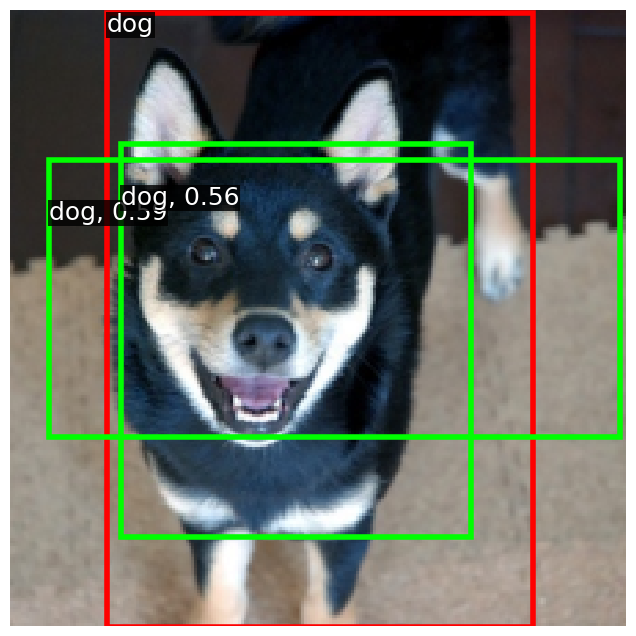

tensor([[ 77.0328, 154.0286, 192.7774, 224.0000],
        [  0.0000, 106.2838,  66.8371, 224.0000],
        [  0.0000, 169.2955, 134.5233, 224.0000],
        [ 91.6201,   0.0000, 214.2489, 108.6781],
        [  1.8515, 135.4781, 201.2614, 224.0000],
        [ 54.5713,   0.0000, 151.3890,  93.3090],
        [  0.0000,   7.3745, 202.4854, 106.1566],
        [ 22.6744, 116.2367, 120.8960, 224.0000],
        [ 20.7400,   0.0000, 213.2440,  57.4385],
        [ 70.1722,   0.0000, 169.2531, 139.6632],
        [ 70.8455, 100.4073, 169.4454, 224.0000],
        [  0.0000,   0.0000, 119.5308,  75.2630],
        [  0.0000,  67.5520, 101.9083, 203.7572],
        [  0.0000,  40.3671, 140.2519, 138.9689],
        [  6.0533,   3.8202, 106.5687, 170.5687],
        [133.9243, 100.7384, 224.0000, 224.0000],
        [ 38.0424,  20.4134, 137.1813, 187.1737],
        [  0.0000,  88.1370, 187.1743, 187.3934],
        [133.4288,  21.1215, 224.0000, 188.9940],
        [ 74.1817,  49.0133, 198.6944, 189.5199]],

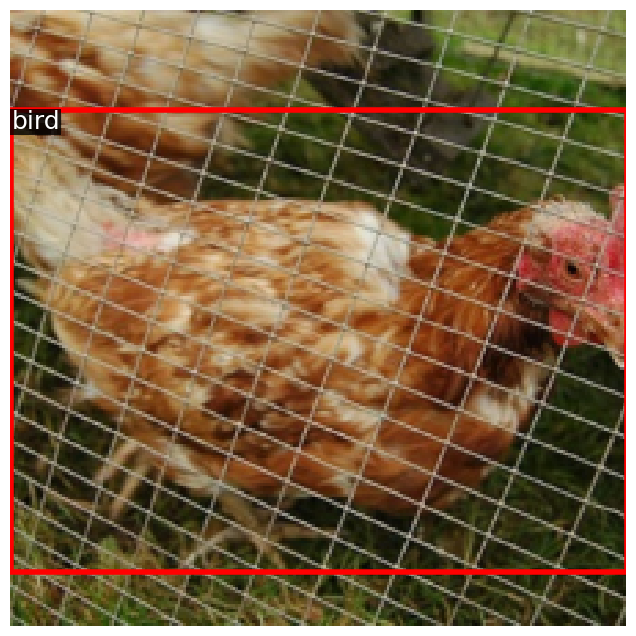

tensor([[  0.0000, 169.3628, 134.3671, 224.0000],
        [ 86.8465,   0.0000, 183.6395,  93.1177],
        [ 11.9750,  99.2353, 135.1863, 224.0000],
        [ 34.0298,   0.0000, 224.0000,  74.3112],
        [ 44.7630, 152.0041, 162.4607, 224.0000],
        [ 88.7120, 169.1857, 224.0000, 224.0000],
        [141.0641,   0.0000, 224.0000, 120.0534],
        [ 33.2664,  24.0051, 224.0000, 122.0927],
        [  0.0000,  69.4662, 101.3503, 199.9949],
        [ 55.2617,   0.0000, 152.2984, 140.5362],
        [ 54.1509,  52.9556, 152.7553, 218.8687],
        [  0.0000, 135.2867, 204.1133, 224.0000],
        [  0.0000,  56.1146, 185.9064, 154.6026],
        [ 38.4029,   0.0000, 134.7963,  93.4643],
        [ 86.8740,  20.1227, 185.5079, 188.1924],
        [  0.0000,   0.0000, 116.9826, 123.0442],
        [  0.0000,   0.0000,  70.8428,  94.2031],
        [ 17.3968,  87.4559, 217.3954, 186.5444],
        [133.5453, 117.0335, 224.0000, 224.0000],
        [ 86.5693, 102.3741, 184.4918, 224.0000]],

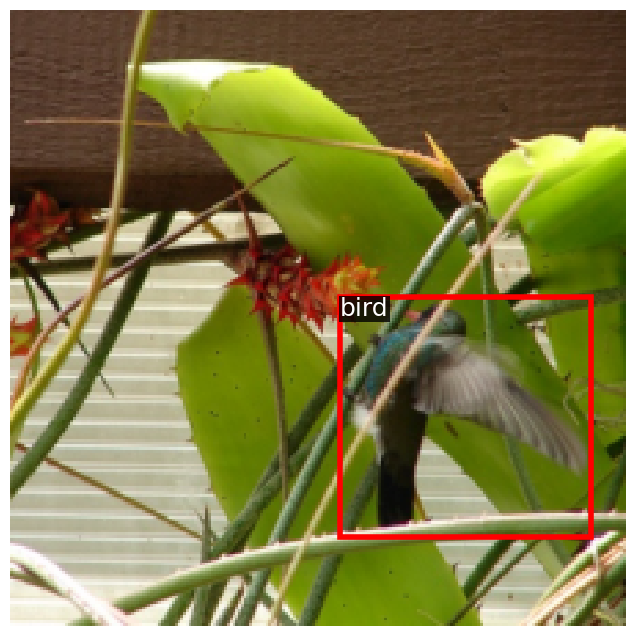

tensor([[ 38.4041,   0.0000, 135.3612,  93.4450],
        [  0.0000, 168.7662, 117.4044, 224.0000],
        [  0.0000,   0.0000, 118.1705, 124.0116],
        [  4.8830,   0.0000, 197.8064,  57.5731],
        [  0.0000,   0.0000,  83.9193,  86.5285],
        [  0.0000,   3.6106,  73.8120, 174.4008],
        [ 70.9227,  35.2315, 169.3289, 203.4125],
        [  0.0000,  39.9723, 154.9511, 138.0817],
        [  0.0000, 114.5098,  72.1290, 224.0000],
        [ 28.1313, 134.3552, 148.6116, 224.0000],
        [ 31.3362,  87.5068, 224.0000, 186.1912],
        [ 74.9152,   0.0000, 197.8792, 124.1354],
        [149.5749,  37.1186, 224.0000, 205.6954],
        [  5.9096,  35.8660, 104.9830, 203.5862],
        [ 27.2376,  51.2144, 149.7372, 187.9093],
        [ 15.9994, 119.9189, 217.9315, 218.2915],
        [ 41.8801, 169.4797, 224.0000, 224.0000],
        [ 87.2480, 115.3575, 184.8012, 224.0000]], device='cuda:0') tensor([-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1],
 

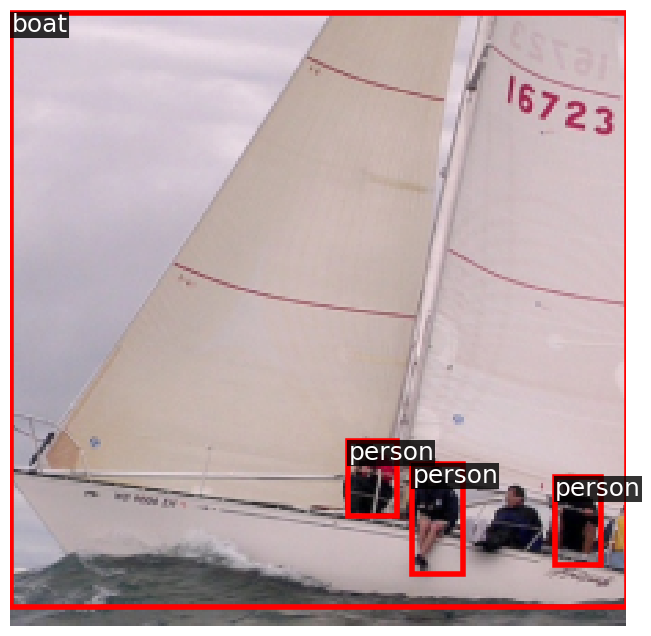

tensor([[ 54.8303, 154.8068, 114.3089, 221.1314],
        [ 25.4087, 168.5976, 214.2680, 224.0000],
        [  0.0000, 153.6112, 101.4846, 224.0000],
        [ 28.3123, 134.1840, 149.3631, 224.0000],
        [  0.0000,   0.0000,  84.6068,  86.2800],
        [108.0399,   0.0000, 224.0000, 105.5530],
        [ 73.9636,  35.2480, 198.1115, 171.6868],
        [ 21.1369,  67.7318, 121.8553, 224.0000],
        [ 73.3977, 116.2235, 199.3124, 224.0000],
        [ 33.9927,  23.4140, 224.0000, 122.2352],
        [ 88.0655,   0.0000, 183.9076, 140.6088],
        [ 38.6953,   0.0000, 136.9077, 123.2754],
        [  0.0000,  18.7334, 103.1450, 154.1233],
        [  0.0000,  95.7691,  58.0652, 224.0000],
        [ 42.3204,  67.5206, 167.8992, 203.7517],
        [ 67.0464,   0.0000, 116.2819,  79.8285],
        [  4.8289,   0.0000, 197.8655,  57.7919],
        [  0.0000,  69.3728,  86.4563, 200.1608],
        [ 66.9481,  71.0873, 115.3771, 160.8385],
        [ 47.4836,  20.5003, 137.3423,  67.2286],


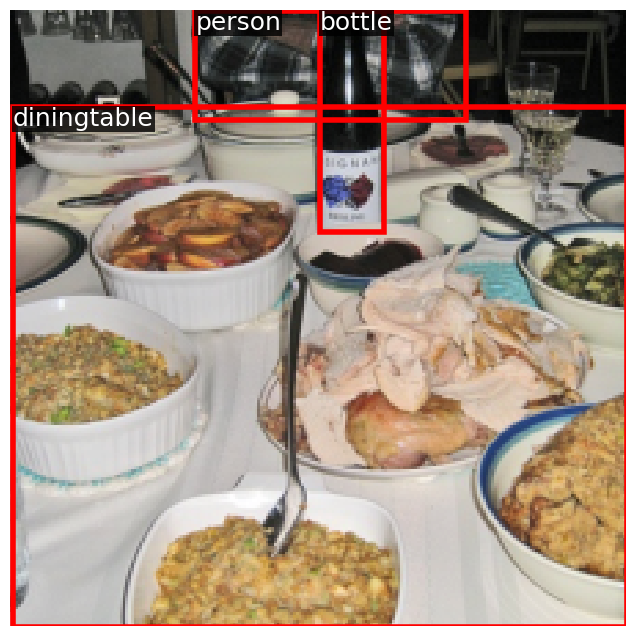

tensor([[1.4467e+01, 9.7672e-02, 7.5762e+01, 7.1524e+01],
        [6.4019e+01, 2.0844e+01, 1.5283e+02, 6.7643e+01],
        [3.2744e+01, 0.0000e+00, 2.2400e+02, 7.4052e+01],
        [8.2430e+01, 0.0000e+00, 1.3317e+02, 8.1335e+01],
        [6.7521e+00, 1.5291e+02, 6.7197e+01, 2.2193e+02],
        [6.7765e+00, 0.0000e+00, 1.0529e+02, 1.2432e+02],
        [0.0000e+00, 9.9869e+01, 8.8855e+01, 2.2400e+02],
        [1.1651e+01, 6.1537e+01, 6.0298e+01, 1.5465e+02],
        [1.0277e+02, 0.0000e+00, 2.0115e+02, 1.2432e+02],
        [0.0000e+00, 9.3044e+01, 8.0592e+01, 1.4002e+02],
        [4.2147e+01, 0.0000e+00, 1.6701e+02, 1.1109e+02],
        [1.1193e+01, 1.3426e+02, 1.3360e+02, 2.2400e+02],
        [7.1302e+01, 3.5390e+01, 1.6936e+02, 2.0091e+02],
        [0.0000e+00, 5.1581e+01, 1.0428e+02, 1.8954e+02],
        [7.5451e+01, 1.4276e+02, 1.2460e+02, 2.2400e+02],
        [0.0000e+00, 2.3366e+01, 2.0506e+02, 1.2388e+02],
        [0.0000e+00, 3.9954e+01, 1.9074e+02, 1.4006e+02],
        [3.095

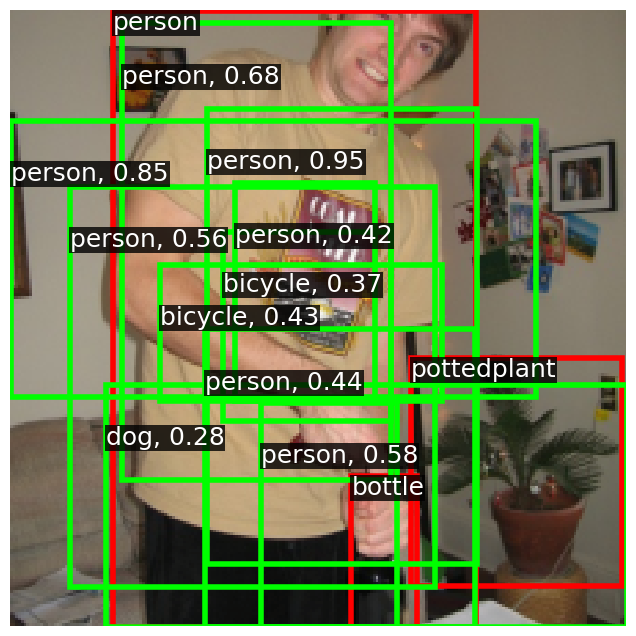

tensor([[ 63.7652,   0.0000, 153.8468,  44.0156],
        [ 85.6548,   0.0000, 147.7246,  75.6282],
        [  0.0000, 168.7673, 183.2605, 224.0000],
        [ 77.5737, 154.2699, 137.6378, 224.0000],
        [ 60.9399, 164.6018, 155.2535, 211.3930],
        [ 41.1136, 131.7037, 166.0625, 224.0000],
        [ 35.2808,   0.0000, 224.0000,  58.0892],
        [  0.0000, 136.6736, 122.0715, 224.0000],
        [ 62.9288, 138.3398, 122.7862, 205.7045],
        [ 74.8169,   0.0000, 199.8907, 111.2808],
        [154.0882,   0.0000, 203.9858,  60.1490],
        [ 61.8444,   0.0000, 124.7274,  66.6460],
        [  0.0000,  52.3854, 102.8875, 187.0794],
        [ 54.9506,  68.4456, 145.7088, 115.5564],
        [ 74.7729,  39.1761, 124.3445, 130.5577],
        [ 39.5496,  63.5205, 169.8465, 210.4167],
        [  0.0000,  86.3503, 206.4288, 187.7285],
        [ 55.2864,  16.3585, 183.5242, 159.0497],
        [  0.0000,  21.5004, 205.6784, 122.8689],
        [  0.0000,  61.0102,  58.7302, 122.3674],


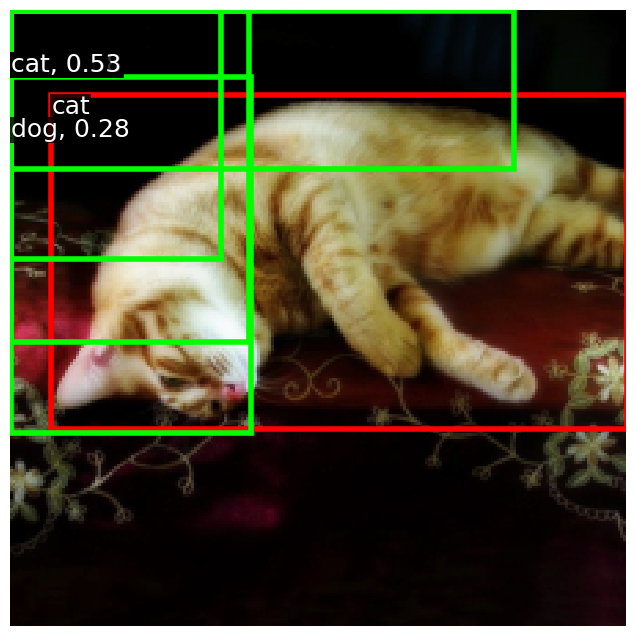

tensor([[  0.0000,   0.0000, 101.4506,  89.3097],
        [  0.0000, 152.9217, 120.9105, 224.0000],
        [ 22.6883,   0.0000, 121.4651, 123.8453],
        [  0.0000,  23.5664,  84.3609, 150.7590],
        [  0.0000,  99.5764,  89.7136, 224.0000],
        [  1.0289,   0.0000, 200.5917,  74.1231],
        [124.9883, 133.7255, 224.0000, 224.0000],
        [149.9188,   0.0000, 224.0000, 124.3255],
        [ 25.1912, 168.7910, 215.3213, 224.0000],
        [ 23.0125,  68.1371, 121.7500, 224.0000],
        [ 92.8368,   0.0000, 213.2447,  91.2187],
        [  0.0000, 119.1752, 188.3706, 219.4927],
        [ 43.7838,   0.0000, 166.2737, 108.3727],
        [ 54.0214, 100.2083, 154.6158, 224.0000],
        [  0.0000,  56.4748, 138.4488, 155.0695],
        [ 75.1411, 131.8348, 197.6746, 224.0000],
        [148.6926,  36.9277, 224.0000, 204.1633],
        [  0.0000,  23.5387, 186.4064, 122.7045],
        [ 14.1807,  86.6428, 221.8830, 187.6177],
        [ 54.2525,  22.1073, 154.1527, 187.1375],


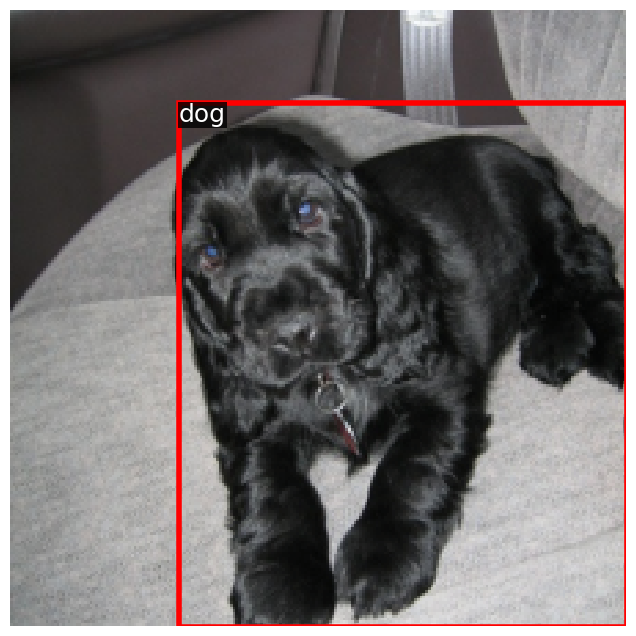

tensor([[ 26.6649,   0.0000, 149.9683, 123.1432],
        [ 90.9312,   0.0000, 139.9454,  90.5187],
        [ 80.1626,  37.0358, 168.9063,  83.3195],
        [  0.0000,   0.0000, 182.7262,  58.3969],
        [ 82.7237, 150.0383, 132.4271, 224.0000],
        [ 86.5255, 178.5929, 145.2142, 224.0000],
        [  0.0000, 168.9499, 133.6133, 224.0000],
        [  0.0000,   0.0000, 101.6739, 121.9670],
        [107.3351,  15.2065, 155.6565, 105.1780],
        [ 73.9804,   0.0000, 199.8949, 106.9997],
        [ 39.6414,  20.3863, 137.4887, 187.1868],
        [ 42.9344, 133.5814, 168.0055, 224.0000],
        [ 23.0181, 116.4278, 120.2849, 224.0000],
        [  0.0000, 113.4991,  72.8711, 224.0000],
        [  0.0000,  35.2909,  88.9653, 202.2999],
        [  0.0000,  88.4004, 138.7845, 188.0093],
        [ 18.1197,  39.4873, 218.6354, 138.6176],
        [ 98.5126,  78.0624, 149.2640, 164.6716],
        [ 72.1355,   4.2380, 169.1694, 171.2798],
        [ 69.7775, 100.0647, 163.5976, 147.9849],


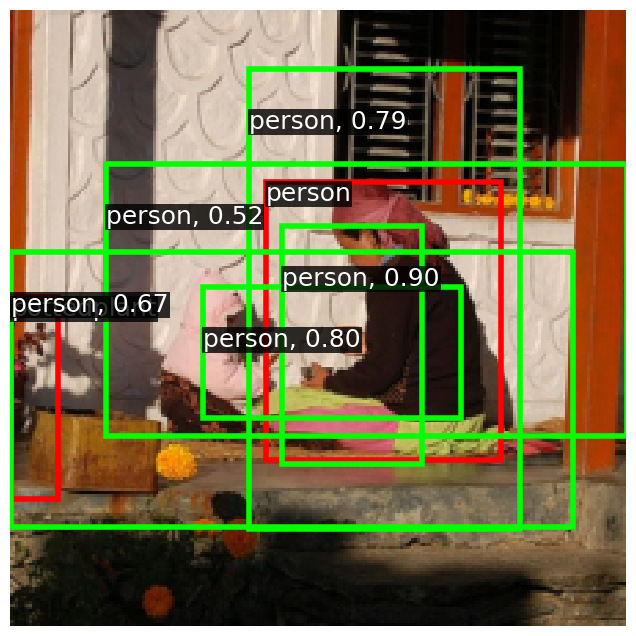

tensor([[  5.4038,   0.0000, 197.7267,  57.7539],
        [  0.0000,   0.0000,  73.5280, 125.1425],
        [  0.0000, 139.3250,  65.2951, 224.0000],
        [  1.2823,  39.1581, 202.3264, 138.0415],
        [ 28.9632, 134.5328, 148.8640, 224.0000],
        [  0.0000, 169.3130, 101.0112, 224.0000],
        [ 74.9115,   2.0782, 198.9257, 141.7562],
        [141.0027,   0.0000, 224.0000, 122.3969],
        [ 76.9958, 153.6218, 193.8873, 224.0000],
        [ 94.8769,   0.0000, 211.4374,  73.2236],
        [  0.0000,  19.2143, 118.2046, 156.2173],
        [ 22.5278,   0.0000, 119.5335,  93.2182],
        [ 54.6346,   0.0000, 152.5226, 107.6261],
        [ 15.4150,   7.2609, 219.1849, 106.3731],
        [  0.5568, 119.7249, 202.5643, 218.3502],
        [ 38.7752,   2.6956, 137.2080, 170.7870],
        [ 71.2634,  35.9779, 169.1086, 203.6840],
        [ 33.3654,  71.5225, 224.0000, 170.0876],
        [ 28.4872,  68.3637, 149.5678, 202.6434],
        [123.7529,  99.4090, 224.0000, 224.0000]],

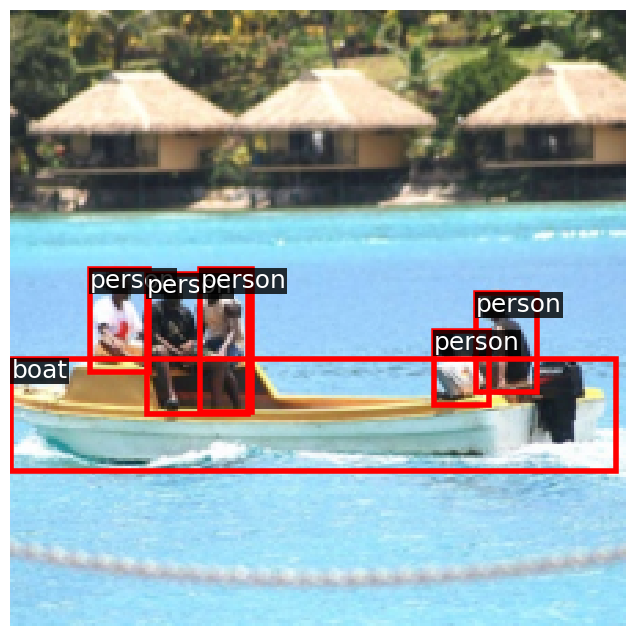

tensor([[ 54.7599,   0.0000, 153.0164, 120.0397],
        [ 32.6021,  22.5842, 224.0000, 123.1821],
        [ 96.5284,  55.1514, 149.2616, 137.6760],
        [ 70.6100,   6.2687, 170.0574, 171.6237],
        [102.2223,   0.0000, 199.8637, 140.8222],
        [ 49.4455,   0.0000, 224.0000,  74.5753],
        [ 97.4857,   0.0000, 149.9855,  73.2785],
        [  0.0000,   0.0000, 138.9483,  91.1109],
        [ 79.6154,  12.5406, 170.1340,  59.2065],
        [ 14.0119,  54.6327, 221.8147, 155.7485],
        [ 42.8888, 169.0376, 224.0000, 224.0000],
        [ 38.6728,  68.0479, 137.4897, 224.0000],
        [ 76.6565,  82.8779, 174.1150, 131.9107],
        [  0.0000,  41.0344, 120.7925, 138.9994],
        [121.9160,  36.2588, 224.0000, 171.2661],
        [ 72.6139, 165.2147, 161.3121, 211.7526],
        [ 88.7855, 114.5152, 183.5644, 224.0000],
        [  0.0000, 137.3843,  83.5234, 224.0000],
        [ 33.0527,  86.8155, 224.0000, 186.1376],
        [  5.0076, 135.6466, 201.4232, 224.0000],


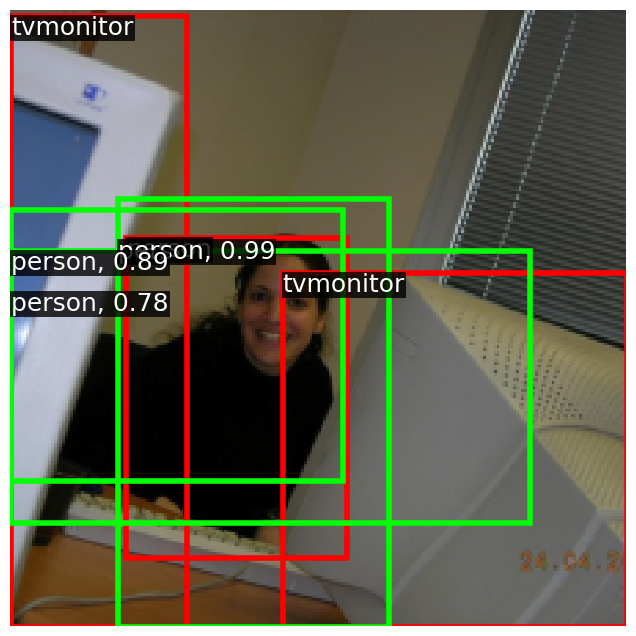

tensor([[ 37.2404,   0.0000, 224.0000,  57.9403],
        [  0.0000,   0.0000,  82.8816,  70.5123],
        [ 43.0028,  34.4777, 166.3902, 173.9305],
        [ 60.7304,   0.0000, 182.3331,  91.8937],
        [ 38.3427, 115.2544, 135.0443, 224.0000],
        [  0.0000,  56.2147, 137.9806, 154.3760],
        [  0.0000, 168.9995, 182.2550, 224.0000],
        [ 11.2078,   0.0000, 134.4290, 124.6547],
        [ 86.2301,   0.0000, 185.1970, 155.1617],
        [ 15.3474,  23.9770, 219.1045, 122.6527],
        [149.8870,   0.0000, 224.0000,  94.4294],
        [  0.0000,  88.1378, 187.1161, 186.2661],
        [  0.0000, 153.5296, 101.6953, 224.0000],
        [ 59.1224, 134.6116, 181.6353, 224.0000],
        [  0.0000,   3.0810,  88.8536, 171.1315],
        [ 70.8906,  67.7536, 168.2592, 224.0000],
        [  0.0000, 112.6936,  57.1414, 224.0000],
        [  0.0000,  71.7283,  85.4591, 200.4190],
        [122.9616,  99.5111, 224.0000, 224.0000]], device='cuda:0') tensor([-1, -1, -1, -1, -1, -1, 

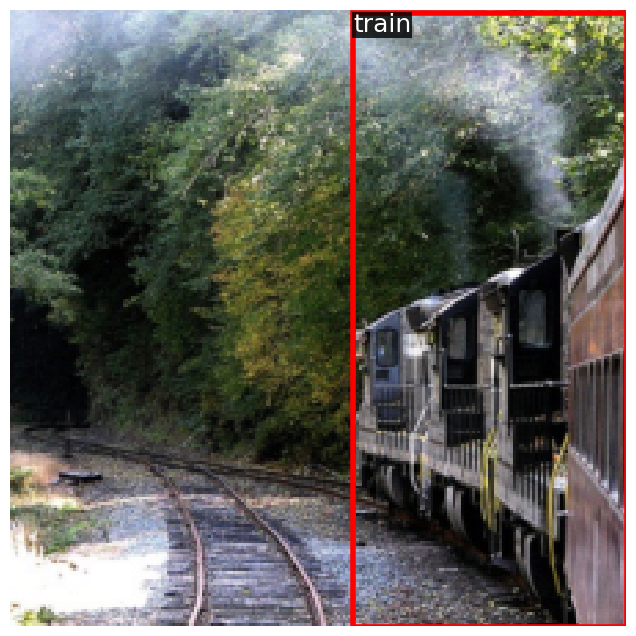

tensor([[  0.0000,   0.0000,  84.2695,  87.3972],
        [ 94.4646,   0.0000, 211.4806,  72.9366],
        [140.8267,   0.0000, 224.0000, 105.6544],
        [  0.0000,  16.9023,  73.7848, 187.2602],
        [ 41.8676, 169.4773, 224.0000, 224.0000],
        [ 30.5950,   0.0000, 147.1237,  73.4181],
        [ 16.1036,   0.0000, 219.4781,  90.6363],
        [ 86.7787,   0.0000, 184.9696, 124.4452],
        [148.9882,  20.0939, 224.0000, 188.1276],
        [ 76.9972, 134.7098, 196.3802, 224.0000],
        [  0.0000, 122.9193,  66.4205, 224.0000],
        [ 29.6965, 153.9230, 146.6992, 224.0000],
        [134.2854, 100.8683, 224.0000, 224.0000],
        [  0.0000,  23.9430, 187.1455, 122.6986],
        [ 79.9034,  71.1171, 224.0000, 169.7491],
        [ 16.7442, 119.1942, 218.3676, 218.0724],
        [ 86.3932,  35.8492, 185.9320, 200.4521],
        [ 53.9274, 100.9296, 153.0631, 224.0000],
        [  0.0000,  57.0122, 121.3904, 154.8851],
        [  5.9947,  83.6599, 106.0617, 224.0000],


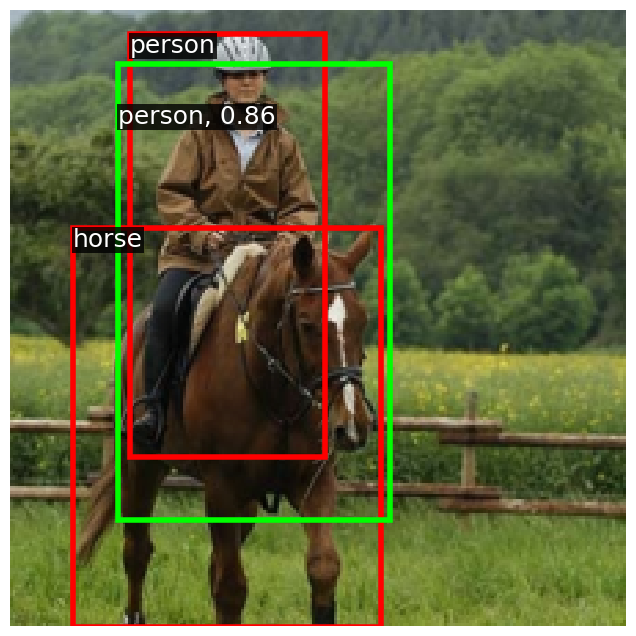

tensor([[  0.0000, 169.2664, 182.3079, 224.0000],
        [140.3216, 102.2117, 224.0000, 224.0000],
        [ 75.9986, 134.0292, 196.7421, 224.0000],
        [  0.0000,   0.0000,  82.3758,  70.6088],
        [  0.0000,  66.1390,  73.7095, 224.0000],
        [  0.0000,   2.7228,  73.2245, 173.0025],
        [  0.0000,  73.0664, 120.7963, 170.6119],
        [ 39.5666, 129.0771, 135.6452, 224.0000],
        [  0.0000, 139.5955,  65.6031, 224.0000],
        [  0.0000,   0.0000, 117.8909, 124.9913],
        [ 16.0863, 119.7184, 217.7059, 217.8913],
        [ 20.4881,   0.0000, 213.4822,  57.7005],
        [140.6009,  21.6338, 224.0000, 153.6206],
        [ 38.3567,   0.0000, 137.1457, 156.4205],
        [  0.8653,  24.1313, 201.6462, 121.9024],
        [102.9819,   0.0000, 201.4930, 123.6944],
        [ 54.5612,   0.0000, 151.5456,  93.3084],
        [ 27.7127,  69.0573, 150.6539, 202.7422],
        [  0.0000,  56.0889, 186.5276, 154.3044],
        [ 70.9736,  35.7181, 168.8574, 204.0098]],

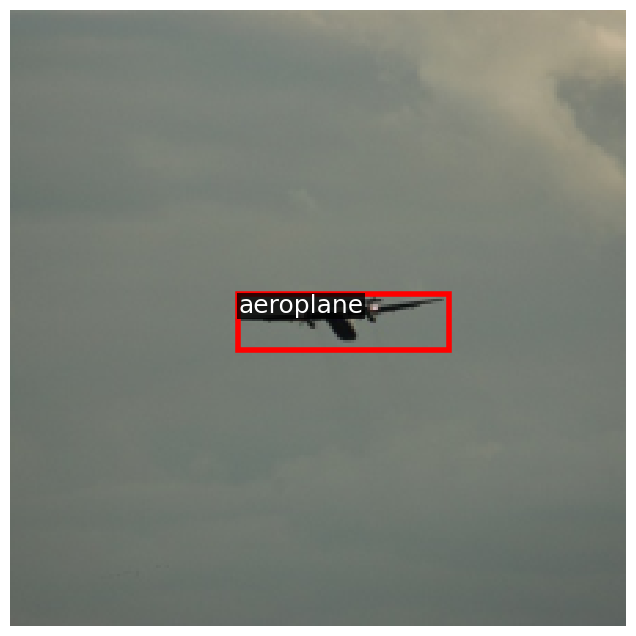

tensor([[  0.0000,   0.0000, 117.8013, 106.2408],
        [ 54.9157,   0.0000, 152.9217, 138.3726],
        [  0.0000,  23.9614, 187.2988, 122.1227],
        [ 32.6379,   0.0000, 224.0000,  90.1724],
        [ 85.7465,   0.0000, 184.5203, 108.4652],
        [ 96.6060,   5.3237, 184.1396,  51.6338],
        [ 71.4305,  15.1203, 203.9184, 164.2740],
        [109.6096,  32.7082, 171.9209, 105.1472],
        [114.4879,   0.0000, 164.3314,  75.3792],
        [104.7810,  52.8654, 158.7059, 139.7676],
        [ 93.9286,  90.9938, 190.0108, 140.1591],
        [ 95.5715,  21.1267, 185.2213,  67.8606],
        [101.9725, 104.8787, 161.1391, 173.9745],
        [  7.2553,  21.0392, 105.1115, 189.9845],
        [ 12.2616,  70.7130, 220.0825, 171.8419],
        [ 38.2721, 115.5410, 136.2157, 224.0000],
        [ 88.6809, 197.0238, 176.5953, 224.0000],
        [103.7029, 179.2525, 162.5073, 224.0000],
        [  0.0000, 100.5940,  88.9469, 224.0000],
        [ 26.1145,  34.3731, 153.4035, 176.8259],


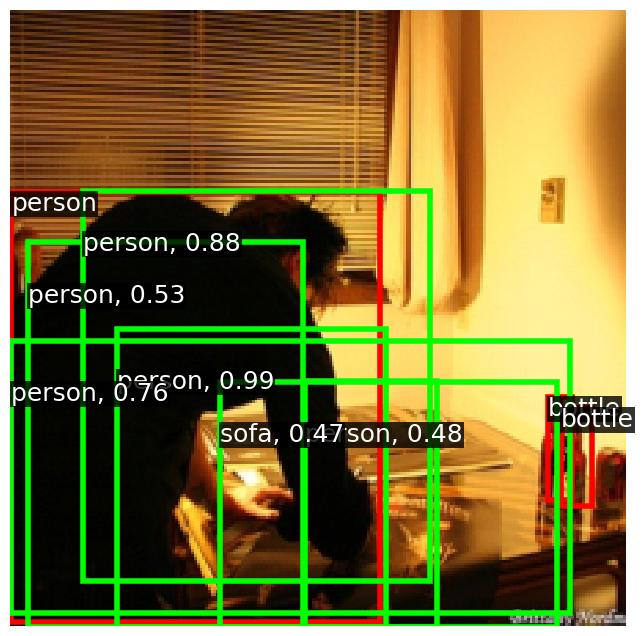

tensor([[ 54.8192, 124.4444, 145.1336, 171.4004],
        [ 61.4285, 186.7266, 121.0516, 224.0000],
        [ 75.1409,  98.4604, 198.4272, 224.0000],
        [  0.0000, 102.8861, 186.9220, 203.5064],
        [ 37.2282, 116.3228, 136.1674, 224.0000],
        [119.2094, 115.6863, 215.6718, 224.0000],
        [  0.0000, 113.5722,  72.0303, 224.0000],
        [  0.0000, 168.7294, 183.0667, 224.0000],
        [ 74.7136,  95.4555, 124.0201, 186.3460],
        [  0.0000,  88.7270, 120.3051, 187.2616],
        [108.2688,  68.1770, 224.0000, 203.9708],
        [ 58.8409,  50.9292, 181.7079, 188.1232],
        [ 16.2270,  71.6540, 217.9575, 169.9987],
        [  0.0000,  34.8514,  73.0819, 204.0656],
        [ 38.9246,   4.6630, 136.5700, 170.8840],
        [ 45.6763,   0.0000, 162.9405,  73.2420],
        [ 55.5725,  45.2796, 144.9069,  91.4477],
        [ 70.3042,  33.2522, 130.7572, 104.3587],
        [  0.0000,  23.9393, 185.0135, 122.1927],
        [ 16.0842,   0.0000, 216.7621,  89.9650],


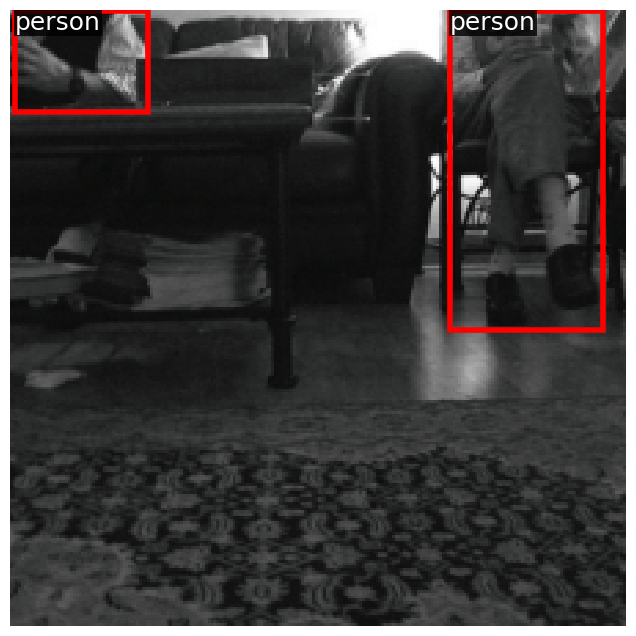

tensor([[101.2856,  48.4935, 163.4891, 121.6217],
        [ 71.0639,  15.0137, 203.4914, 162.6666],
        [ 89.2135,   0.0000, 218.2753,  97.3788],
        [ 77.2411,  68.1721, 172.1379, 116.4215],
        [ 14.2805,  54.2249, 220.2766, 155.0117],
        [ 99.4053,  62.7587, 148.9097, 146.3154],
        [ 35.6354,   0.0000, 224.0000,  59.0682],
        [ 86.8254,   0.0000, 179.7530,  35.7585],
        [107.5398,   0.0000, 156.3288,  56.7366],
        [  0.0000, 101.7589, 101.7911, 224.0000],
        [ 76.3193,  20.1989, 172.7082,  68.5170],
        [ 56.1764,   0.0000, 153.9263, 123.9019],
        [  0.0000,   7.1846, 202.8731, 107.3968],
        [ 39.2841,  19.5111, 137.4786, 185.6390],
        [  0.0000,   0.0000, 117.8966,  89.3772],
        [  7.2229,   5.0766, 104.9380, 170.1704],
        [ 74.5256,  92.3690, 172.7269, 140.4959],
        [ 78.1243, 164.2000, 170.7978, 211.5783],
        [  9.4148, 168.8648, 197.9255, 224.0000],
        [ 55.9035,  84.7163, 153.8077, 224.0000],


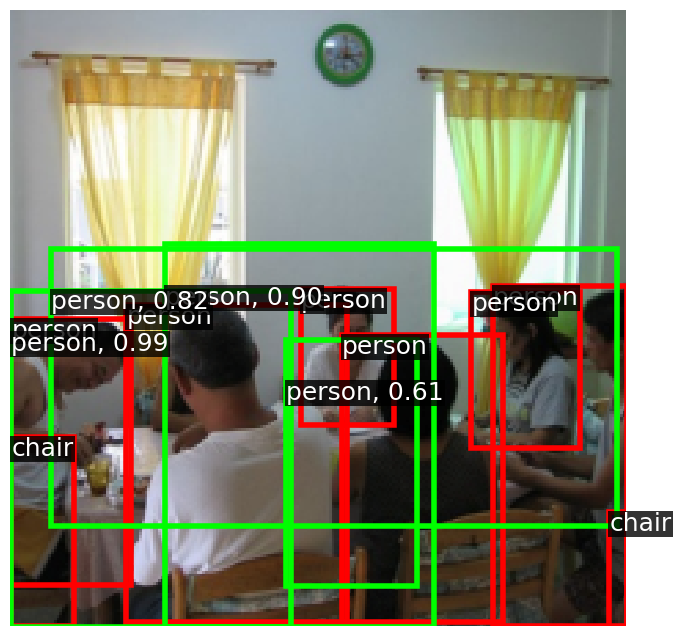

tensor([[  0.0000, 169.2381, 100.1045, 224.0000],
        [ 24.2061, 168.8654, 214.3696, 224.0000],
        [  0.0000, 139.1024,  65.7372, 224.0000],
        [ 11.5354, 132.8857, 133.1795, 224.0000],
        [  0.0000,   0.0000,  83.4332,  70.4913],
        [ 46.2106,   0.0000, 163.4518,  72.7130],
        [ 75.8342, 131.9202, 198.3264, 224.0000],
        [  0.0000,  84.0598,  88.7032, 224.0000],
        [ 86.5820,   0.0000, 183.8829,  93.6148],
        [ 54.3225,  83.4416, 153.0687, 224.0000],
        [ 17.1095,   0.0000, 217.8420,  89.9370],
        [149.7483,   0.0000, 224.0000,  93.5181],
        [123.1017, 115.6230, 224.0000, 224.0000],
        [  0.4143, 103.9901, 202.2502, 202.5167],
        [102.1681,   0.0000, 201.4109, 140.4780],
        [  0.0000,   0.0000, 119.8895, 124.3737],
        [  0.0000,   2.9757,  73.6158, 173.2363],
        [ 98.3512,  88.3425, 224.0000, 185.2577],
        [141.2913,  21.4159, 224.0000, 153.8817],
        [ 85.6280,  36.4196, 185.6024, 203.5900],


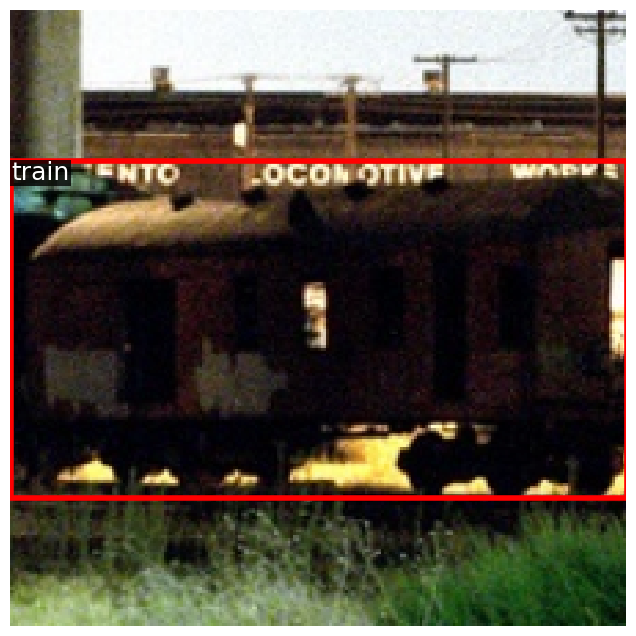

tensor([[ 58.9526,   0.0000, 182.9637, 106.0480],
        [106.5257,   0.0000, 157.3683,  80.1714],
        [ 90.6519,   0.0000, 140.9705,  85.5246],
        [ 84.6342,  28.2519, 178.3878,  75.4057],
        [ 76.9888,  13.0555, 169.3887,  59.8147],
        [ 21.5264,   0.0000, 212.9550,  57.1619],
        [  2.6810,  23.9143, 201.3724, 123.2345],
        [ 76.3534,  84.6053, 141.0552, 165.9640],
        [ 54.2171,  63.9983, 187.3145, 207.2518],
        [104.2130,  62.9484, 159.3438, 145.8765],
        [ 39.6604,  82.7643, 137.1993, 224.0000],
        [  0.0000,   0.0000,  87.5278, 122.8558],
        [ 24.8641, 168.6383, 214.7441, 224.0000],
        [ 72.4859,  99.2489, 175.1222, 148.7617],
        [ 57.0071,   5.9063, 152.4565, 171.3795],
        [ 83.0389, 150.8914, 132.3399, 224.0000],
        [  0.0000,  52.7420, 102.0698, 185.5274],
        [ 98.7059, 134.4505, 148.9428, 224.0000],
        [ 70.0512, 165.1114, 160.1473, 211.4466],
        [ 75.8598, 133.5211, 197.6827, 224.0000],


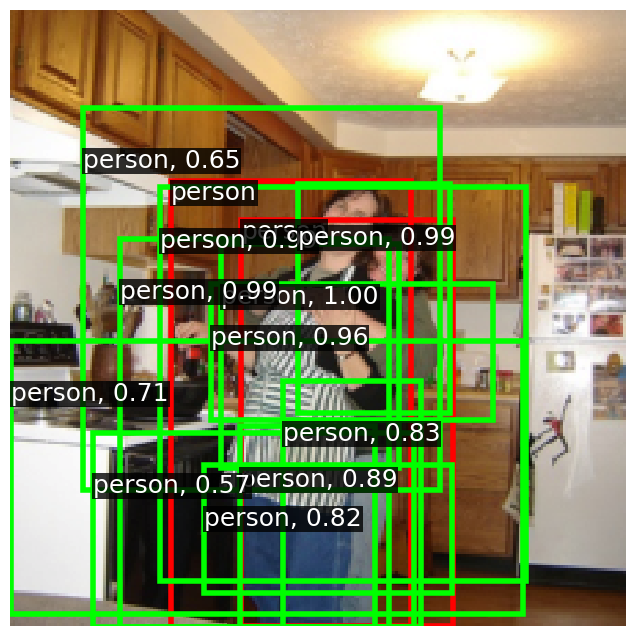

tensor([[  0.0000, 169.1261, 100.5815, 224.0000],
        [ 43.7664, 169.0106, 224.0000, 224.0000],
        [  0.0000,   0.0000,  85.0404, 119.3707],
        [141.2470,   0.0000, 224.0000, 104.6620],
        [ 29.7102, 154.2361, 146.0721, 224.0000],
        [  0.0000,   0.0000, 119.8986,  74.9368],
        [ 78.5299,   0.0000, 195.0515,  73.3020],
        [  7.1646, 116.2056, 104.4362, 224.0000],
        [  0.0000, 112.3377,  56.8157, 224.0000],
        [  0.0000,  34.7103,  72.7545, 204.5754],
        [  2.5884,  23.7898, 201.3330, 121.9462],
        [  0.0000,  56.8482, 120.3415, 154.5349],
        [ 39.1568,   0.0000, 137.0161, 139.5486],
        [ 71.1979, 116.3135, 167.6540, 224.0000],
        [  0.0000, 120.3491, 185.5601, 218.2627],
        [107.5669,  21.0682, 224.0000, 156.4115],
        [ 28.0405,  53.7322, 149.9383, 185.5764],
        [ 87.6547,   4.0989, 183.8740, 171.3695],
        [ 33.4910,  87.6295, 224.0000, 186.0929]], device='cuda:0') tensor([-1, -1, -1, -1, -1, -1, 

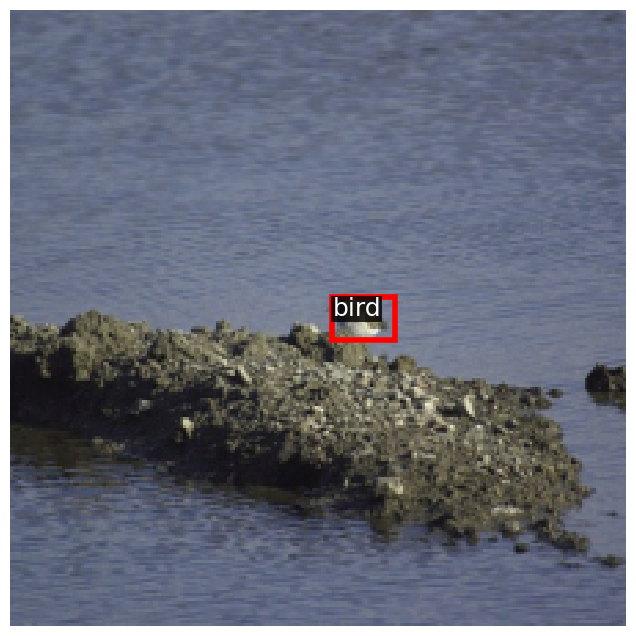

tensor([[  5.4506,   0.0000, 198.0710,  57.9143],
        [  0.0000, 169.4860, 166.0388, 224.0000],
        [ 38.6188,   0.0000, 135.2850,  92.9810],
        [ 18.3873, 136.5760, 218.5327, 224.0000],
        [ 69.6293,   0.0000, 168.2167, 109.2352],
        [ 61.9471, 154.3028, 178.0537, 224.0000],
        [ 75.4698,  51.5312, 197.7972, 188.5416],
        [ 70.6680,  83.7815, 169.1855, 224.0000],
        [  0.0000,   0.0000,  99.9449,  72.5218],
        [123.8568, 100.0052, 224.0000, 224.0000],
        [ 39.9115, 129.5868, 135.1438, 224.0000],
        [ 43.3579,  19.1788, 166.5143, 157.0002],
        [102.6934,   0.0000, 199.1503,  92.7464],
        [ 16.3217,  55.9766, 219.5052, 154.3277],
        [  0.0000,   0.0000,  73.7692, 123.5455],
        [  0.0000, 137.0778,  84.0940, 224.0000],
        [  0.0000,  41.1061, 121.0321, 138.6217],
        [ 33.7093,   7.7756, 224.0000, 106.4555],
        [ 27.5374,  68.4522, 149.5731, 204.0951],
        [123.9721,  19.6094, 224.0000, 156.3926],


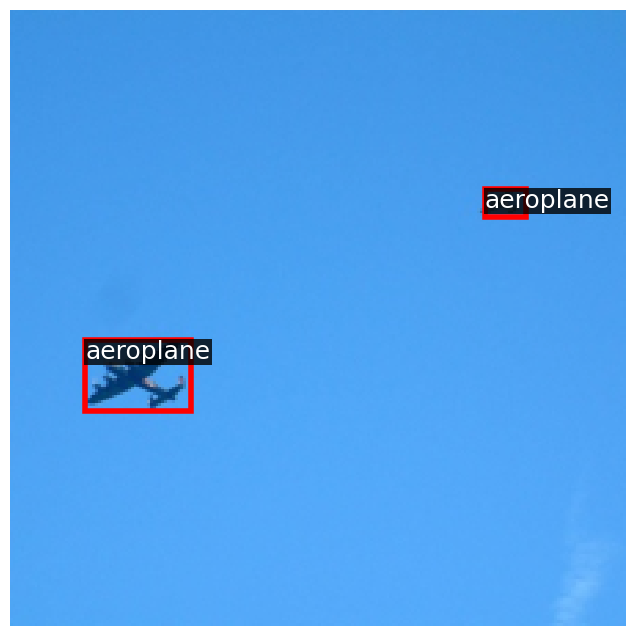

tensor([[  5.6392,   0.0000, 105.1827, 123.1661],
        [  0.0000,  34.6580, 119.0175, 174.0479],
        [  0.0000, 169.0380, 117.9502, 224.0000],
        [  0.0000, 139.3653,  65.5558, 224.0000],
        [  0.0000,  84.2718,  89.2086, 224.0000],
        [ 10.3824, 114.0686, 134.8222, 224.0000],
        [ 39.0018,   4.0861, 137.6880, 172.0374],
        [  0.0000,   0.0000, 184.7508,  74.4542],
        [ 41.8932, 169.1735, 224.0000, 224.0000],
        [140.9427, 134.8353, 224.0000, 224.0000],
        [ 54.3200,   0.0000, 151.4997,  93.0231],
        [139.7220,  51.0444, 224.0000, 186.8895],
        [  0.0000,  23.9306, 203.2573, 122.6971],
        [  0.0000, 102.2099, 205.0085, 202.9782],
        [ 55.5151,  69.9436, 154.3063, 224.0000],
        [148.9387,   0.0000, 224.0000, 124.7988],
        [ 94.3871,   0.0000, 211.3062,  73.3976],
        [ 59.8570, 133.2714, 180.2351, 224.0000],
        [ 14.9365,  55.8881, 219.7455, 154.9644],
        [ 59.8160,  18.4186, 182.6151, 156.3610],


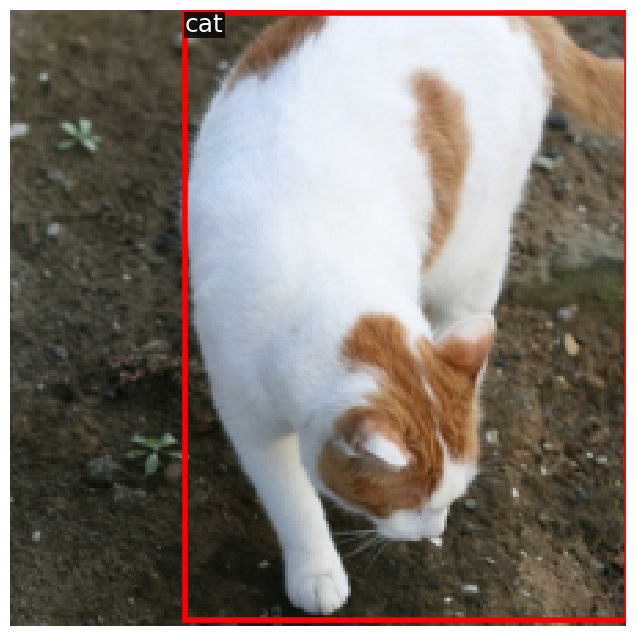

tensor([[138.8606,  37.2607, 224.0000, 170.5376],
        [  0.0000,  79.9915,  57.0607, 224.0000],
        [ 69.4506,   0.0000, 169.2074, 109.6857],
        [ 36.1885,   0.0000, 224.0000,  57.6091],
        [  0.0000,   2.5040,  72.9846, 172.0060],
        [ 15.8113,  23.4162, 218.1533, 122.5481],
        [ 22.6639,   0.0000, 121.1367, 138.5590],
        [  0.0000, 169.0800, 100.6695, 224.0000],
        [ 74.2186,  17.5531, 199.3662, 157.5999],
        [ 80.1186,  71.1537, 224.0000, 169.6576],
        [148.6420,   0.0000, 224.0000, 109.7691],
        [  0.0000,   0.0000,  82.8264,  70.2067],
        [149.5895,  85.3405, 224.0000, 224.0000],
        [ 55.9043,   5.7109, 153.0391, 172.0139],
        [ 25.3139, 168.9259, 215.0342, 224.0000],
        [  0.0000,  56.4646, 138.0138, 153.9581],
        [ 54.5343, 100.1943, 153.6075, 224.0000],
        [  0.0000,  69.3865, 101.9576, 202.3344],
        [  0.0000, 136.0136, 139.0961, 224.0000],
        [  0.0000,  88.1662, 188.0304, 186.9106],


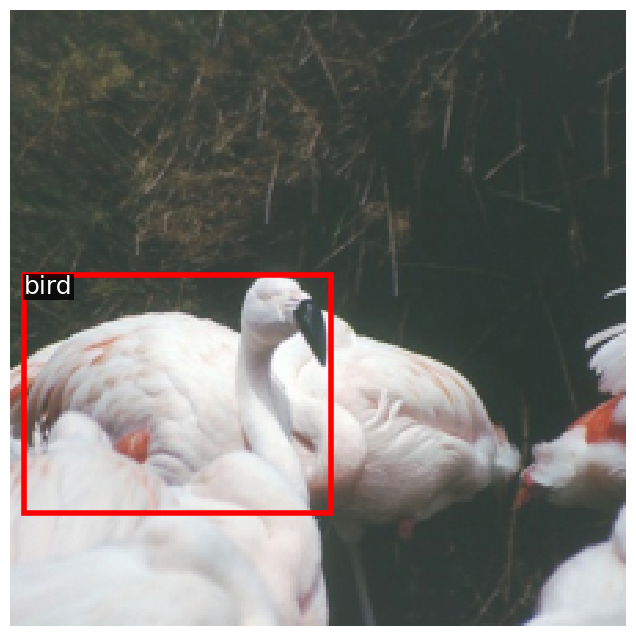

tensor([[ 90.8532,   0.0000, 214.7047,  93.6470],
        [ 39.0261,   3.7228, 137.6238, 170.6620],
        [ 87.8951,   0.0000, 178.9966,  43.5841],
        [  0.0000,   0.0000, 188.4783,  90.9102],
        [ 15.4515,  23.2899, 220.4647, 122.8561],
        [  0.0000,   0.0000,  87.4749,  92.8306],
        [105.9604,   0.0000, 157.3774,  58.6526],
        [ 86.8136,   0.0000, 185.3909, 153.7196],
        [ 54.8502, 115.7367, 153.0621, 224.0000],
        [  0.0000,  40.2945, 138.4886, 138.9470],
        [ 88.2568,  68.7226, 176.1616, 115.6040],
        [105.0293, 117.5494, 159.4783, 208.3449],
        [150.4686,   0.0000, 224.0000,  94.6499],
        [ 42.8806,  68.1085, 168.3454, 203.5925],
        [ 86.7575, 101.2965, 186.0695, 224.0000],
        [ 23.6054,  68.8768, 121.0580, 224.0000],
        [  2.0806, 118.9153, 203.7893, 219.0242],
        [  8.6082, 168.2353, 198.8668, 224.0000],
        [  0.0000,   2.2231,  74.3499, 171.9554],
        [ 31.9469,  55.6232, 224.0000, 154.6575],


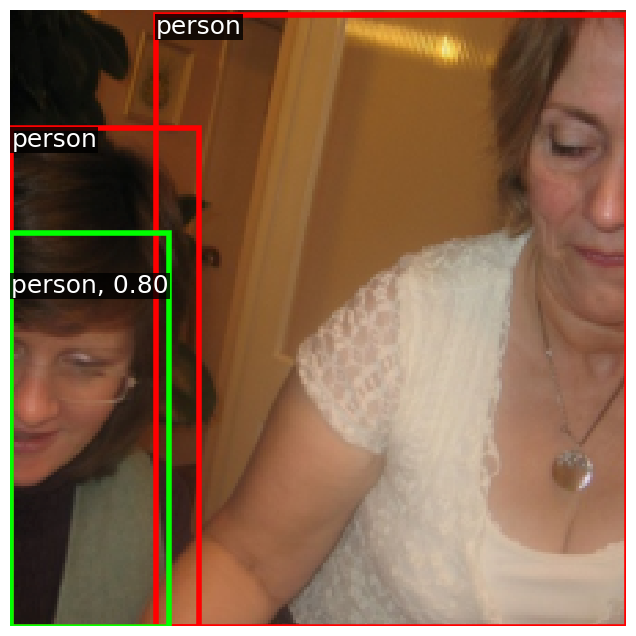

tensor([[ 94.2640,   0.0000, 211.8183,  74.0116],
        [  3.7938,   0.0000, 197.2778,  57.6682],
        [ 54.2094,   0.0000, 151.4424,  93.0754],
        [  0.0000, 135.3067, 101.6655, 224.0000],
        [ 15.3896,   7.1515, 217.5481, 105.9856],
        [ 22.3158,   0.0000, 121.3319, 109.0100],
        [  0.0000,  34.0815,  73.5192, 204.2594],
        [  0.0000,   0.0000,  88.0079, 122.8454],
        [ 87.2656,   0.0000, 185.7866, 138.4416],
        [  0.0000, 169.0594, 166.9173, 224.0000],
        [149.1779,   0.0000, 224.0000, 122.6723],
        [  0.0000,  89.0425, 121.5347, 186.7713],
        [ 38.6357,   4.9482, 136.0650, 171.0490],
        [123.8820, 133.7349, 224.0000, 224.0000],
        [  0.0000, 119.9142, 171.4472, 219.1169],
        [ 61.5003, 152.9238, 178.3968, 224.0000],
        [ 39.8719,  68.1493, 138.2805, 224.0000],
        [122.6454,  50.5553, 224.0000, 189.9962],
        [  0.0000,  55.5853, 187.6427, 155.1433],
        [ 30.0004, 102.0540, 224.0000, 202.1730],


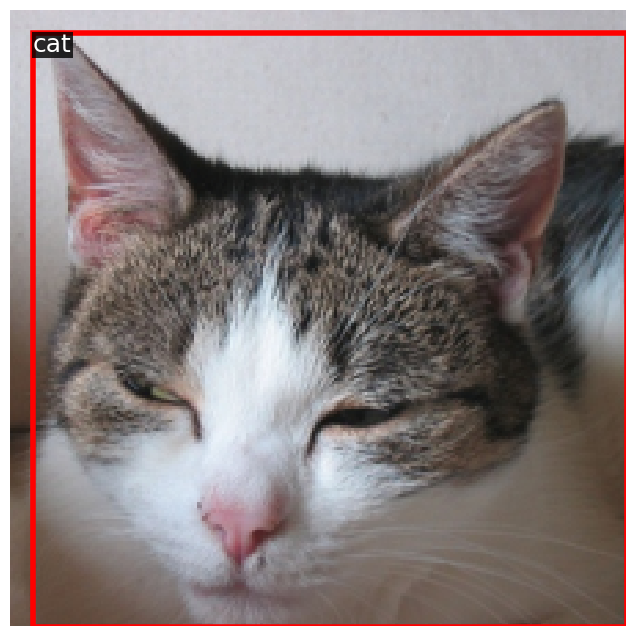

tensor([[  0.0000, 137.0829,  83.2896, 224.0000],
        [  0.0000,   0.0000,  87.1561,  93.2855],
        [ 11.1626, 115.4868, 135.3958, 224.0000],
        [ 42.1273,   0.0000, 167.3173, 108.9781],
        [ 77.8330,   0.0000, 194.9701,  74.2247],
        [  0.0000,  24.0413, 187.2469, 122.7567],
        [ 60.8995, 153.1231, 179.0011, 224.0000],
        [  0.0000,  80.4363,  57.1668, 224.0000],
        [134.9014,   0.0000, 224.0000, 122.2829],
        [  0.0000, 169.0415, 165.8535, 224.0000],
        [ 33.5975, 135.2519, 224.0000, 224.0000],
        [ 75.0999,  20.6917, 197.4081, 155.3022],
        [  6.9495,   4.7701, 105.1523, 172.5776],
        [ 38.5203,  19.8064, 138.1888, 186.9556],
        [  0.0000,  88.3895, 138.4517, 186.4151],
        [ 70.1391,  52.4209, 168.3801, 219.4678],
        [134.3830, 115.9801, 224.0000, 224.0000],
        [ 81.3814,  87.5293, 224.0000, 185.3380],
        [135.2122,  36.4802, 224.0000, 204.7884]], device='cuda:0') tensor([-1, -1, -1, -1, -1, -1, 

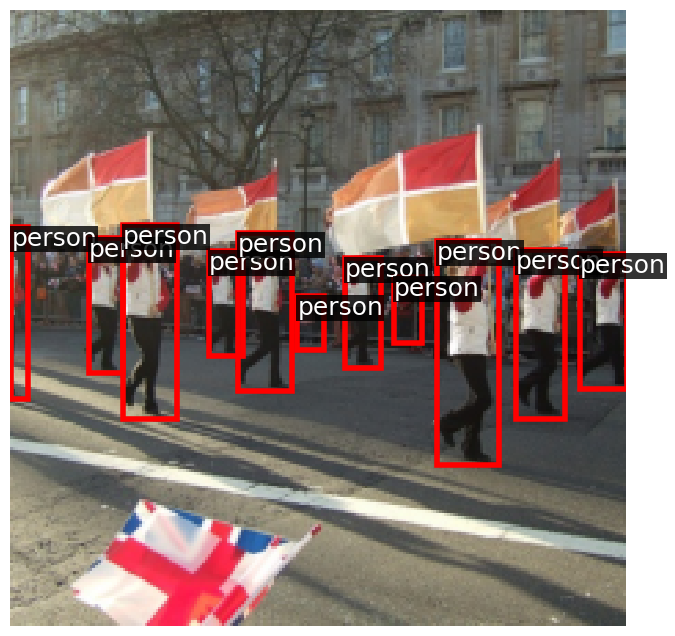

tensor([[ 21.4232,   0.0000, 213.2063,  57.6885],
        [102.8078,   0.0000, 199.2152,  92.7641],
        [  0.0000,   0.0000, 121.0997,  91.0241],
        [ 43.6467,   0.0000, 166.1124,  89.1208],
        [ 99.0820,   0.0000, 147.7004,  80.0537],
        [ 85.6869,  29.3224, 178.7673,  75.5323],
        [ 53.1835,  22.9591, 224.0000, 122.1843],
        [ 77.8988, 172.3927, 171.2902, 219.7970],
        [ 10.1597, 168.9135, 198.1477, 224.0000],
        [ 71.9851,   5.4215, 168.2250, 171.3071],
        [ 25.4136,  19.7353, 151.0304, 155.6382],
        [ 98.8267,  72.3198, 147.9401, 158.1963],
        [ 98.8749, 142.5242, 147.5405, 224.0000],
        [  0.0000,  82.1800,  73.0314, 224.0000],
        [ 59.4747, 134.3506, 181.9621, 224.0000],
        [  0.0000, 136.5671, 120.7363, 224.0000],
        [ 83.6703, 100.6089, 179.6424, 148.2580],
        [ 19.3224,  71.9203, 217.6243, 171.0798],
        [  0.0000,  39.2991,  85.6051, 166.4127],
        [ 71.6496, 115.1726, 167.6593, 224.0000],


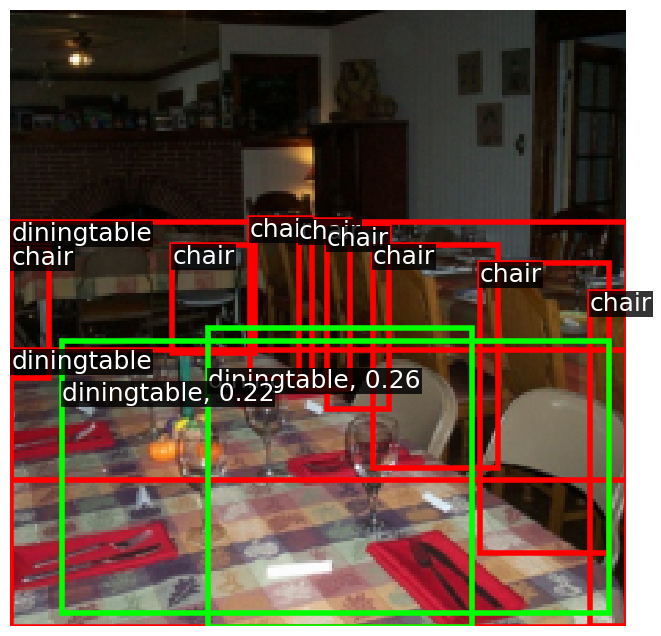

tensor([[ 87.5789,   0.0000, 145.4466,  36.2090],
        [ 93.0065,   0.0000, 212.2758,  75.1719],
        [ 77.9082, 171.7611, 170.0187, 219.2703],
        [  9.5704, 168.4309, 198.3715, 224.0000],
        [  4.4537,   0.0000, 198.7523,  59.0560],
        [ 97.6650,   0.0000, 149.1709,  90.0077],
        [ 79.9006,  28.5115, 170.2413,  75.5585],
        [ 56.9232,   0.0000, 184.3542, 110.8290],
        [ 75.8616,  11.2054, 173.0962,  59.4919],
        [  5.9973,   0.0000, 104.5454, 108.3114],
        [ 98.5462,  30.4086, 147.6165, 117.5603],
        [ 83.0721,  30.4706, 131.2594, 121.1281],
        [ 75.5432, 133.5766, 196.2600, 224.0000],
        [ 31.0985,  23.4831, 224.0000, 123.4437],
        [  0.0000, 118.1581, 101.9044, 224.0000],
        [ 89.4894, 141.5672, 141.3168, 224.0000],
        [  0.0000,  37.0691, 118.0821, 171.5132],
        [ 72.1930,  60.6426, 163.1266, 106.9037],
        [ 39.3341,  21.0349, 137.8036, 189.3780],
        [ 86.4868,  37.4376, 185.2021, 202.5274],


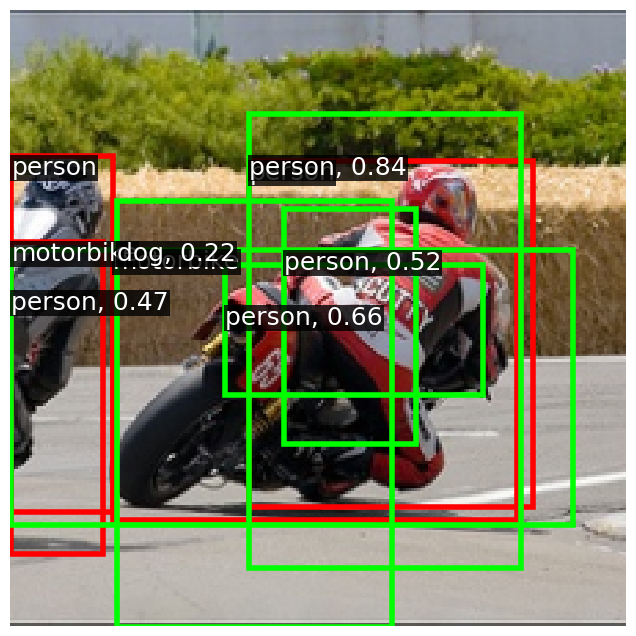

tensor([[ 20.9761,   0.0000, 213.0125,  57.5106],
        [138.9117,   0.0000, 224.0000, 121.4937],
        [  0.0000,   4.3706,  88.9025, 171.4122],
        [  0.0000,   0.0000, 136.0172,  74.6122],
        [103.1485,   0.0000, 200.3129, 140.1066],
        [  0.0000,  39.8730, 139.4503, 138.8096],
        [ 54.8224,   0.0000, 151.8598, 107.5361],
        [ 86.3264,   0.0000, 183.4281,  94.3147],
        [ 70.1696,   3.9851, 168.5061, 170.8751],
        [ 33.3141,  24.1022, 224.0000, 122.8051],
        [ 97.9675,   6.8380, 149.0813,  97.4145],
        [  0.0000,   0.0000,  72.6922, 107.8543],
        [ 78.6277,  36.2985, 169.7084,  83.1358],
        [ 80.8786, 188.9733, 169.6739, 224.0000],
        [  0.0000, 169.2450, 134.3957, 224.0000],
        [ 38.9061,  36.4498, 136.2558, 202.7654],
        [ 93.8327, 170.7556, 153.3861, 224.0000],
        [  0.0000,  71.8112, 186.2806, 170.6973],
        [ 36.7665, 151.8154, 224.0000, 224.0000],
        [ 98.7393,  86.5466, 147.6742, 174.8405],


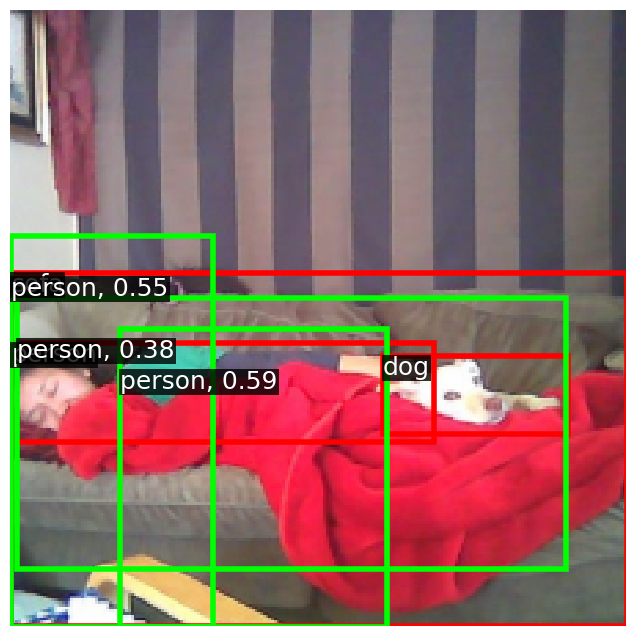

tensor([[  0.0000, 168.8588, 117.9916, 224.0000],
        [ 42.0100, 168.8592, 224.0000, 224.0000],
        [ 29.1626, 152.7462, 146.0946, 224.0000],
        [  3.1479,  39.7440, 200.2807, 137.2766],
        [  0.0000, 122.1893,  67.5513, 224.0000],
        [108.0660,  36.8755, 224.0000, 170.7157],
        [ 59.7929, 133.1919, 181.1837, 224.0000],
        [ 70.8591,  20.0037, 167.5860, 188.0262],
        [ 37.7076,  22.5330, 135.6702, 190.8456],
        [ 21.9586, 101.6092, 121.1786, 224.0000],
        [  0.0000,  56.2748, 121.0271, 155.5842],
        [  5.7831,   0.0000, 196.8971,  57.1721],
        [ 19.4918,  71.5648, 216.9169, 169.4550],
        [  0.0000, 103.9110, 184.6047, 201.9287],
        [  0.0000,   0.0000,  72.9386, 140.6974],
        [103.0641,   0.0000, 200.9527, 139.3314],
        [ 44.3142,   0.0000, 166.4576, 122.0368],
        [  0.0000,  70.1312,  85.9586, 200.6481],
        [ 86.5446,   0.0000, 182.8784,  93.5671],
        [  0.0000,   0.0000, 120.7207,  91.0600]],

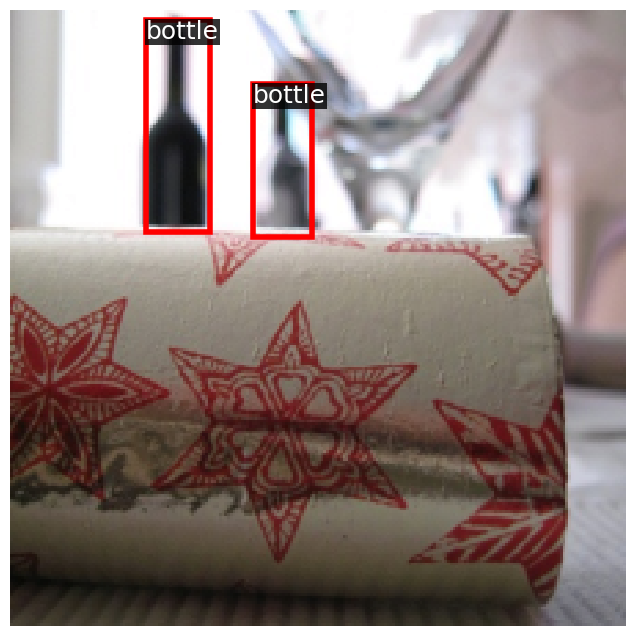

tensor([[  0.0000, 122.2026,  67.2219, 224.0000],
        [  0.0000,   0.0000,  71.2749,  94.0438],
        [  6.6085,   0.0000, 105.3888, 123.1696],
        [ 38.9740,   0.0000, 137.2406, 138.3322],
        [  0.0000,   0.0000, 153.5154,  74.6799],
        [149.0960,   0.0000, 224.0000, 109.9115],
        [103.0738,   0.0000, 203.2511, 140.5525],
        [ 60.0517,   0.0000, 182.1707,  92.4833],
        [  0.0000,  23.3244, 203.3783, 123.2354],
        [138.3936,  36.1671, 224.0000, 171.9716],
        [  0.0000,  18.7791,  74.0286, 187.8604],
        [ 98.8922,  86.7950, 224.0000, 185.3382],
        [ 58.8024,  35.5419, 183.9666, 171.4713],
        [  0.0000,  55.1848, 154.4903, 154.9911],
        [  0.0000, 152.8918, 119.8474, 224.0000],
        [149.9741, 116.5010, 224.0000, 224.0000],
        [  0.0000,  87.6843, 186.9740, 186.5984],
        [ 26.2136, 168.8002, 215.0239, 224.0000],
        [ 71.5214,  83.5134, 169.6605, 224.0000],
        [ 16.4036, 135.0842, 218.7439, 224.0000],


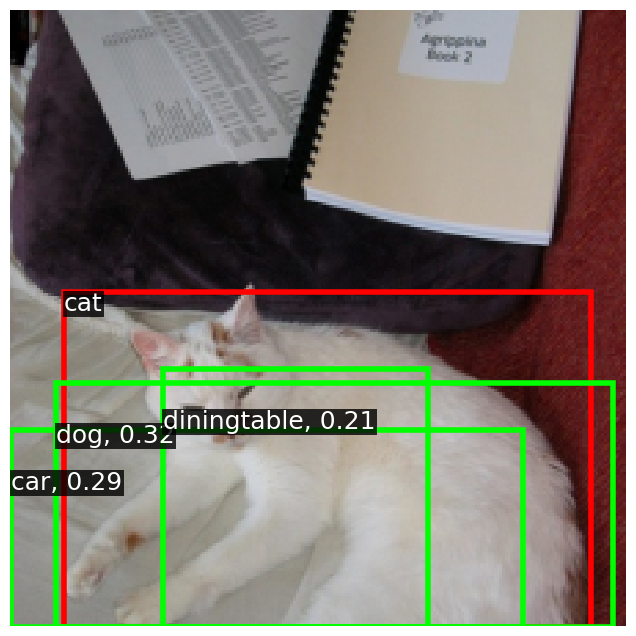

tensor([[  0.0000,   0.0000, 181.2654,  57.3924],
        [ 92.8955,   0.0000, 214.3468,  91.7136],
        [  0.0000,   0.0000,  73.1459, 123.0458],
        [  8.4090, 169.0927, 198.6237, 224.0000],
        [ 64.3677, 172.9902, 152.4181, 219.2847],
        [  0.0000,  54.2769,  87.1176, 187.3237],
        [ 95.2440,   0.0000, 156.4049,  71.7691],
        [ 22.6937, 115.4796, 121.3146, 224.0000],
        [ 83.2808, 143.0343, 132.1843, 224.0000],
        [ 61.3488, 133.5609, 180.6302, 224.0000],
        [  0.2408,   7.6439, 202.2098, 106.0579],
        [ 64.9054,  13.0151, 152.5120,  59.2987],
        [ 38.1309,   0.0000, 135.8174,  93.9289],
        [ 55.1702,   6.5219, 151.9510, 172.4243],
        [ 72.9436,  19.7066, 199.4930, 157.9046],
        [ 80.8897,  28.9458, 168.0601,  75.1286],
        [ 96.7599,  62.6438, 150.6342, 145.3514],
        [ 84.4208,  87.7167, 147.7719, 162.3334],
        [ 17.2175,  86.1869, 218.8874, 186.9043],
        [ 82.5670,   0.0000, 132.0505,  84.4362],


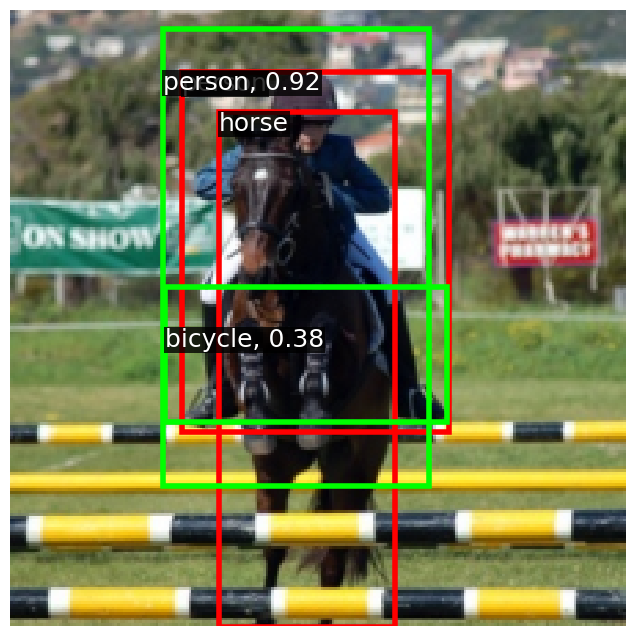

tensor([[  0.0000,   0.0000, 120.0794,  74.7264],
        [ 46.3184,   0.0000, 164.2560,  73.4485],
        [  0.0000,   0.0000,  73.5070, 124.1287],
        [ 98.2113, 159.2554, 147.3869, 224.0000],
        [  0.0000,   7.9537, 154.7288, 106.4157],
        [ 46.0035, 154.3909, 161.8643, 224.0000],
        [ 86.4243,   0.0000, 183.4479,  93.0513],
        [  0.0000, 112.5272,  56.7804, 224.0000],
        [165.0487,   0.0000, 224.0000,  96.5283],
        [ 21.6186,  23.6478, 219.0390, 122.1907],
        [ 39.8511,   0.0000, 135.9621, 154.4665],
        [  0.0000, 153.3268, 101.5027, 224.0000],
        [  0.0000,  40.1770, 137.6636, 138.0281],
        [  6.5544,   4.7563, 104.8494, 171.6672],
        [ 34.1909,  54.9148, 224.0000, 153.0250],
        [  2.2883, 119.7863, 201.8963, 218.3865],
        [149.9662,  37.6289, 224.0000, 206.7826],
        [  0.0000,  34.2021,  73.3741, 204.2587],
        [ 55.1863,  84.0557, 152.6189, 224.0000],
        [ 72.3402,  38.3988, 167.7708, 204.3224],


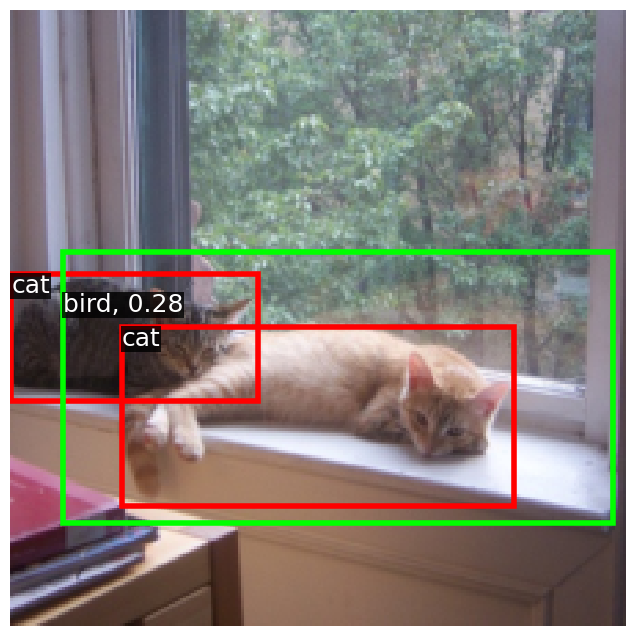

tensor([[  0.0000,   0.0000,  71.4731,  93.0918],
        [ 71.1294,   0.0000, 168.4858, 138.9893],
        [  4.7598,   0.0000, 197.4718,  57.6580],
        [ 92.4276,   0.0000, 214.6456,  91.5286],
        [ 47.4048,  23.4553, 224.0000, 122.0258],
        [  0.0000, 168.7789, 118.6742, 224.0000],
        [ 39.2925,   0.0000, 135.1649,  93.3792],
        [  0.0000,   9.1576, 120.6696, 106.9048],
        [  0.0000,  39.7341, 186.1306, 138.5063],
        [  0.0000, 114.8507,  72.9234, 224.0000],
        [ 74.5891,  51.3195, 199.1115, 189.6291],
        [ 40.8202, 168.8484, 224.0000, 224.0000],
        [ 55.0380,  36.0845, 153.4096, 203.8358],
        [  0.0000,  34.1596,  73.7732, 203.6631],
        [  0.3554,  71.4007, 201.1518, 169.7495],
        [ 27.9369, 133.4978, 150.2041, 224.0000],
        [  6.2313,  83.2541, 106.2928, 224.0000],
        [  0.0000, 104.0660, 202.2500, 202.5786],
        [139.9976, 134.7714, 224.0000, 224.0000],
        [ 71.0984, 116.6927, 169.1263, 224.0000]],

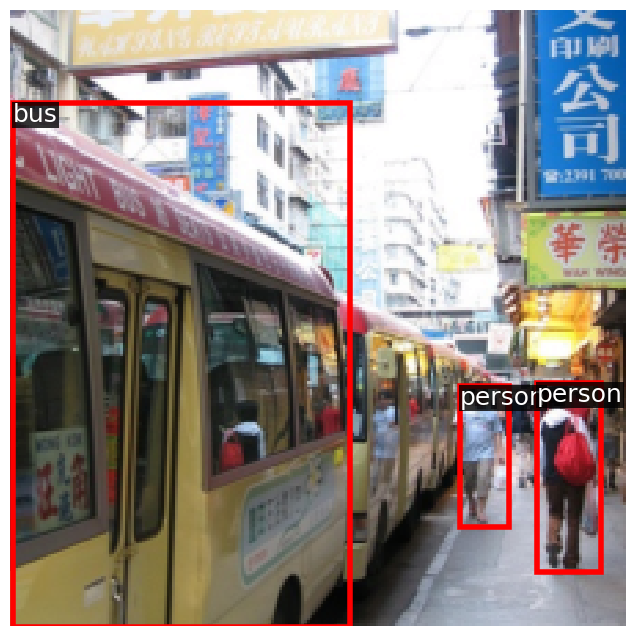

tensor([[ 68.9545,   0.0000, 163.2111,  44.2338],
        [  4.7006,   0.0000, 198.7451,  58.2708],
        [ 89.8441,   0.0000, 141.5054,  63.4471],
        [ 54.8620,   0.0000, 151.5825,  93.3658],
        [113.3062,   0.0000, 167.7571,  82.8640],
        [ 91.7112, 127.4300, 139.9333, 213.5967],
        [  0.0000,   6.5984, 187.8622, 106.6717],
        [ 83.3394,  57.4262, 146.5019, 127.4024],
        [ 90.6836,  21.3280, 155.6192, 100.6367],
        [ 15.0690,  38.5825, 218.0090, 138.6691],
        [ 62.3628, 148.2590, 153.9624, 195.4890],
        [ 71.3054,   0.0000, 201.5456, 127.6020],
        [ 70.7950, 117.2742, 168.0042, 224.0000],
        [ 86.5153,  38.0782, 183.6722, 202.4927],
        [ 38.7279,  19.5212, 137.3475, 184.2893],
        [ 88.3340,  36.1545, 191.9313,  85.0858],
        [ 76.3305, 188.1665, 171.8368, 224.0000],
        [  2.9278, 120.0413, 203.0810, 219.5788],
        [115.2273,  80.0201, 163.9363, 169.4009],
        [ 26.1033, 168.3445, 214.5533, 224.0000],


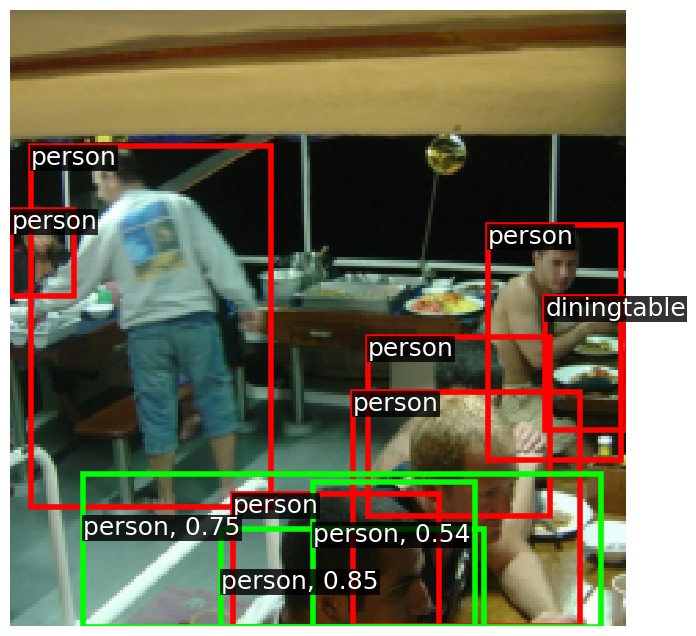

tensor([[ 86.7640,  43.2775, 145.8514, 108.2735],
        [ 91.0283, 126.1134, 139.9795, 217.9248],
        [ 61.5899, 153.8170, 178.8851, 224.0000],
        [ 76.2017,  99.6795, 198.2651, 224.0000],
        [  0.0000,  23.6454, 187.3574, 122.6774],
        [ 69.9448,   0.0000, 168.1254, 107.3644],
        [ 87.7124,   0.0000, 145.6033,  36.9065],
        [ 29.7889,   0.0000, 150.5000,  75.6071],
        [ 66.8559,   3.9289, 166.1747,  51.6225],
        [ 84.3655,   0.0000, 147.5571,  70.1390],
        [  0.0000, 135.3025, 170.5133, 224.0000],
        [ 63.4768, 132.5594, 152.5144, 179.3304],
        [ 88.8960,   0.0000, 215.9865, 126.4961],
        [ 83.6775, 101.7615, 132.3205, 193.3155],
        [ 39.1382,   0.0000, 136.6714, 155.0914],
        [ 70.5958,  20.9827, 169.3143, 187.1260],
        [  0.0000,   0.0000, 102.7917,  73.9882],
        [  0.0000, 103.0856,  86.2027, 224.0000],
        [ 16.1450,  54.4274, 218.6753, 154.1301],
        [ 90.9700,  56.2128, 140.9442, 140.9759],


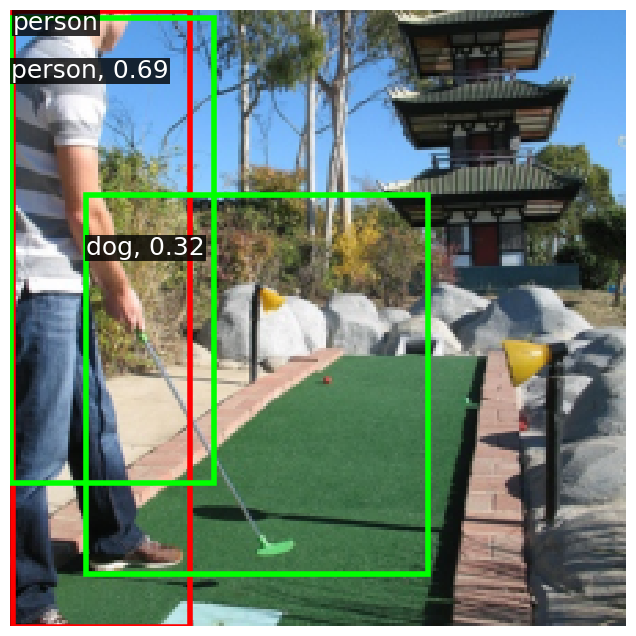

tensor([[  6.5652,   0.0000, 103.4074,  93.2492],
        [  0.0000, 168.8343, 117.2690, 224.0000],
        [  0.0000,  21.4206, 101.0136, 153.1321],
        [  0.0000, 100.4222,  72.7603, 224.0000],
        [ 87.0933, 181.4205, 144.5924, 224.0000],
        [  4.9766,   0.0000, 197.7814,  57.4661],
        [ 28.3277,   0.0000, 149.6525, 122.3877],
        [  0.0000,  89.1802, 120.6620, 187.1026],
        [ 43.1616, 168.9907, 224.0000, 224.0000],
        [ 27.6685, 134.0720, 149.8922, 224.0000],
        [ 39.5922,  35.2467, 136.8117, 201.9876],
        [ 86.2875,   0.0000, 183.1875,  93.7321],
        [ 98.5301,  12.3652, 148.4829, 106.4005],
        [  2.3965,  40.0824, 202.7560, 138.5512],
        [ 80.7729,  45.1733, 168.0764,  91.2989],
        [ 70.9955, 114.9720, 167.4274, 224.0000],
        [ 94.8092, 105.2221, 156.2878, 177.2357],
        [  1.2797, 102.8465, 201.7942, 201.7880],
        [ 70.2936,   4.4478, 168.9511, 172.6461],
        [ 78.4221, 116.5353, 171.2666, 163.5849],


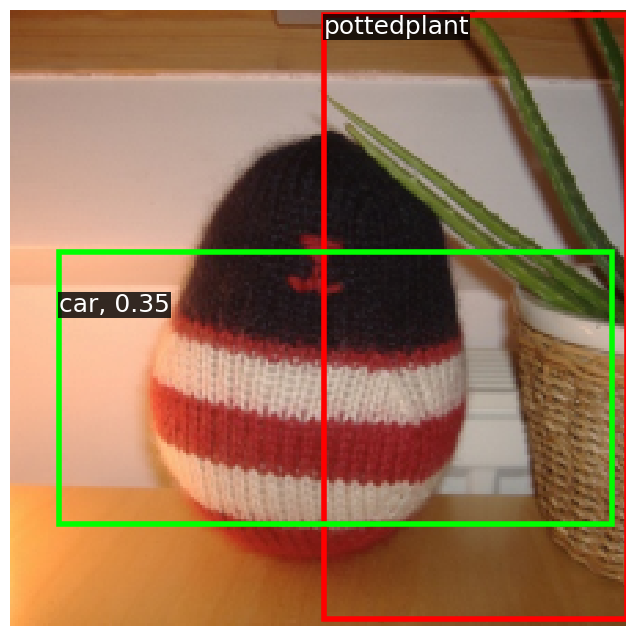

tensor([[  0.0000, 152.0432, 138.5759, 224.0000],
        [  0.0000,   0.0000,  73.8240, 124.3103],
        [ 80.7740, 181.0747, 168.6813, 224.0000],
        [  0.0000,  99.8037,  89.9747, 224.0000],
        [ 37.4368,   0.0000, 137.2518, 122.6886],
        [  6.6312,  20.6394, 106.3318, 188.4013],
        [ 41.5001, 169.0260, 224.0000, 224.0000],
        [  0.0000,  71.8968, 138.9155, 170.6709],
        [ 97.6645, 150.0827, 148.4114, 224.0000],
        [ 20.3101,   0.0000, 212.9548,  57.4222],
        [ 38.2498,  99.2453, 137.4924, 224.0000],
        [  0.0000,  39.9629, 187.9676, 139.0389],
        [ 15.0004,   7.5232, 217.7098, 105.8446],
        [150.2879,   0.0000, 224.0000, 123.9456],
        [  0.0000, 118.3272, 203.2570, 219.0473],
        [ 59.7088, 133.6355, 180.1808, 224.0000],
        [ 55.2207,  21.8312, 153.1008, 187.7544],
        [ 80.4267,  20.8959, 167.4461,  67.2971],
        [ 93.3773,   0.0000, 213.3153,  89.5172],
        [ 98.6307,   0.0000, 147.7995,  90.9216],


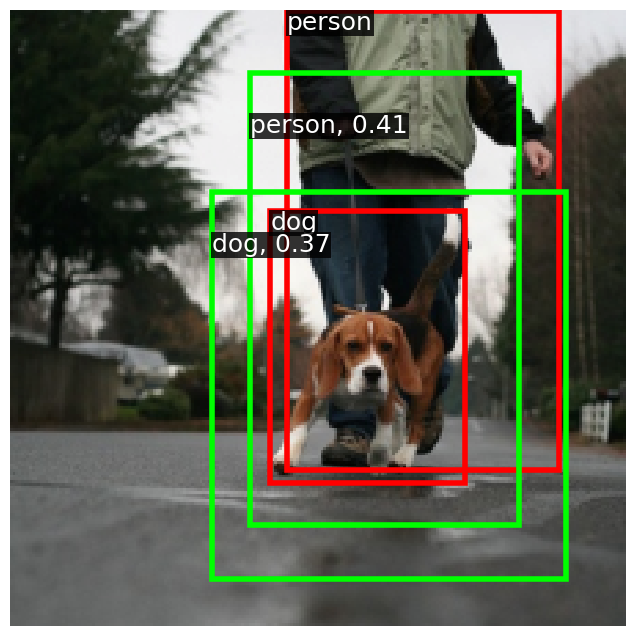

tensor([[ 45.2152, 153.0588, 161.8381, 224.0000],
        [ 82.5563, 136.0635, 224.0000, 224.0000],
        [ 21.0319,   0.0000, 213.4791,  57.8588],
        [  0.0000, 168.9878, 101.1856, 224.0000],
        [  0.0000,   0.0000, 119.3180,  74.6089],
        [  0.0000, 111.7725,  57.3815, 224.0000],
        [  0.0000,  71.4121,  84.9347, 199.6542],
        [  0.0000, 119.7823, 186.1558, 218.0660],
        [ 75.7072,   0.0000, 198.8557,  92.0665],
        [ 38.8881,   0.0000, 136.1899, 109.5191],
        [ 23.3241,  68.4969, 121.7991, 224.0000],
        [  7.3113,   4.2772, 104.9961, 171.4608],
        [  0.0000,  55.2984, 186.2212, 154.1113],
        [106.4918,   0.0000, 224.0000, 125.3335],
        [ 86.8452,  37.5596, 185.5707, 203.7768],
        [ 70.2213,  84.9782, 170.1440, 224.0000],
        [ 56.3505,   4.3560, 153.1245, 171.1851],
        [150.1800,  21.1371, 224.0000, 189.2358],
        [ 31.4760,  87.7190, 224.0000, 186.3079]], device='cuda:0') tensor([-1, -1, -1, -1, -1, -1, 

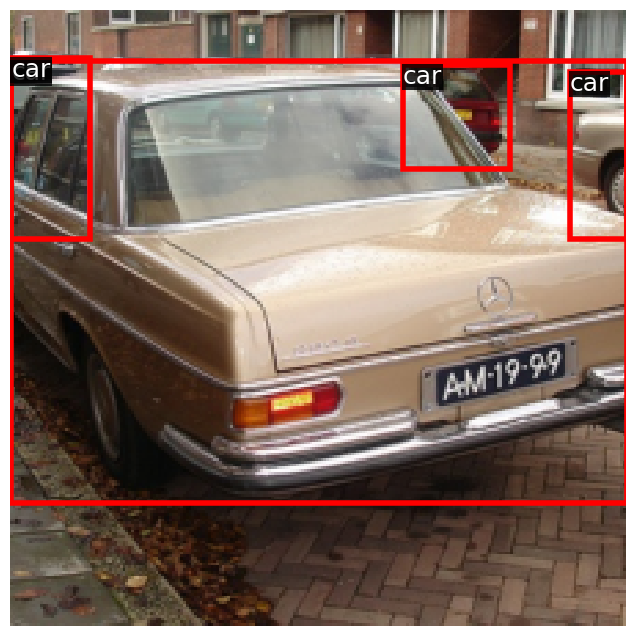

tensor([[7.6586e+01, 1.8575e+02, 1.3675e+02, 2.2400e+02],
        [1.3441e+02, 0.0000e+00, 2.2400e+02, 1.0924e+02],
        [1.0283e+02, 0.0000e+00, 1.9946e+02, 9.2618e+01],
        [8.4458e+00, 1.6832e+02, 1.9991e+02, 2.2400e+02],
        [4.0463e+01, 1.1452e+02, 1.6919e+02, 2.2400e+02],
        [6.9453e+01, 0.0000e+00, 1.7013e+02, 1.2249e+02],
        [1.3915e+01, 6.6034e+00, 2.1879e+02, 1.0624e+02],
        [0.0000e+00, 1.3690e+02, 1.2107e+02, 2.2400e+02],
        [0.0000e+00, 0.0000e+00, 1.3621e+02, 7.4262e+01],
        [0.0000e+00, 0.0000e+00, 7.2937e+01, 1.0951e+02],
        [9.0477e+01, 2.2987e+01, 1.4073e+02, 1.1092e+02],
        [2.1220e-01, 1.0349e+02, 2.0430e+02, 2.0251e+02],
        [6.9687e+01, 4.4453e+01, 1.6279e+02, 9.1684e+01],
        [0.0000e+00, 8.2059e+01, 7.3152e+01, 2.2400e+02],
        [2.3774e+01, 6.8193e+01, 1.2222e+02, 2.2400e+02],
        [1.2345e+02, 9.9295e+01, 2.2400e+02, 2.2400e+02],
        [8.0516e+01, 5.5615e+01, 2.2400e+02, 1.5303e+02],
        [3.990

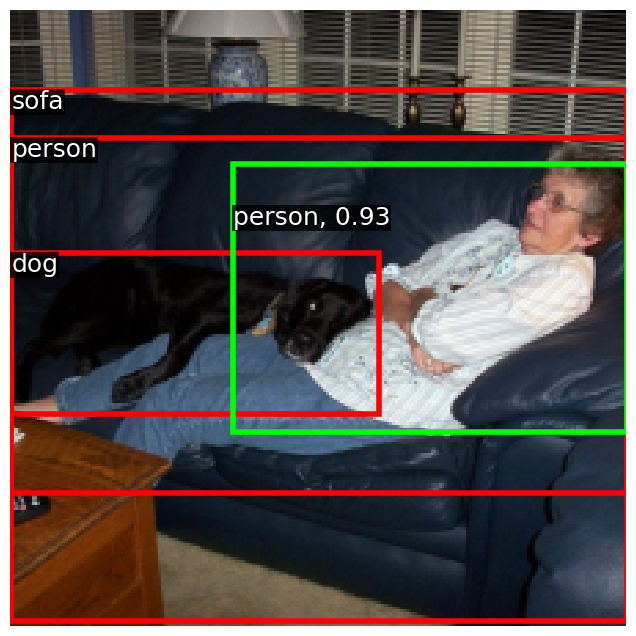

tensor([[  0.0000,   0.0000,  73.5682, 109.7927],
        [123.2473,  99.1245, 224.0000, 224.0000],
        [  0.0000,   8.1559, 139.3657, 106.3044],
        [  0.0000,  41.0400, 121.3922, 138.8969],
        [ 36.1708,   0.0000, 224.0000,  58.3143],
        [ 86.9810,   0.0000, 184.4960, 137.4836],
        [ 55.9866,   0.0000, 153.3083, 121.5392],
        [ 15.0977,  23.3201, 219.7932, 123.3144],
        [ 74.7758,  35.4598, 199.5466, 172.1373],
        [ 10.3109, 169.0701, 198.3118, 224.0000],
        [ 75.9962, 133.2237, 196.9738, 224.0000],
        [149.3857,   0.0000, 224.0000,  93.8337],
        [139.1148,  20.5717, 224.0000, 153.2119],
        [ 71.4018,  67.9845, 169.5160, 224.0000],
        [ 32.0688, 103.8032, 224.0000, 202.3816],
        [  0.4824,  72.2404, 203.3633, 170.6830],
        [ 27.1821,  50.9820, 150.4196, 189.3973],
        [  0.0000,  55.6089,  84.3759, 183.2899],
        [  0.0000, 134.8261, 116.6779, 224.0000]], device='cuda:0') tensor([-1, -1, -1, -1, -1, -1, 

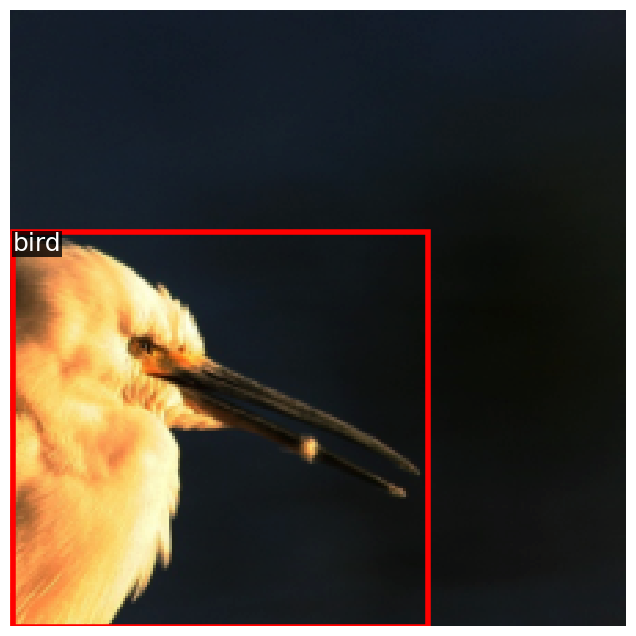

tensor([[ 21.0178,   0.0000, 213.5593,  57.9710],
        [100.2733,   0.0000, 224.0000,  73.0741],
        [  0.0000, 169.9103, 134.5433, 224.0000],
        [ 82.2748, 150.2868, 133.1445, 224.0000],
        [ 45.9787, 153.3305, 163.1077, 224.0000],
        [ 75.9092, 132.5422, 197.4059, 224.0000],
        [134.0955, 116.2491, 224.0000, 224.0000],
        [ 70.4940,   0.0000, 167.6612,  94.6561],
        [ 16.1628, 102.5677, 217.7012, 201.8363],
        [  0.0000,   0.0000, 136.3870,  74.7523],
        [  0.0000, 139.8441,  65.4468, 224.0000],
        [ 56.0704,  68.3890, 151.6558, 224.0000],
        [  0.0000,   6.8837, 202.6047, 106.5796],
        [ 23.7966, 101.3294, 120.1177, 224.0000],
        [ 79.0070,  88.9427, 140.3687, 161.6770],
        [ 38.4109,   0.0000, 137.0923, 122.5976],
        [  0.0000,  22.8208,  85.6615, 152.2099],
        [133.9829,   5.6242, 224.0000, 172.3165],
        [  0.0000,  66.7269,  73.6327, 224.0000],
        [ 86.7966,  51.3670, 185.6401, 220.2860],


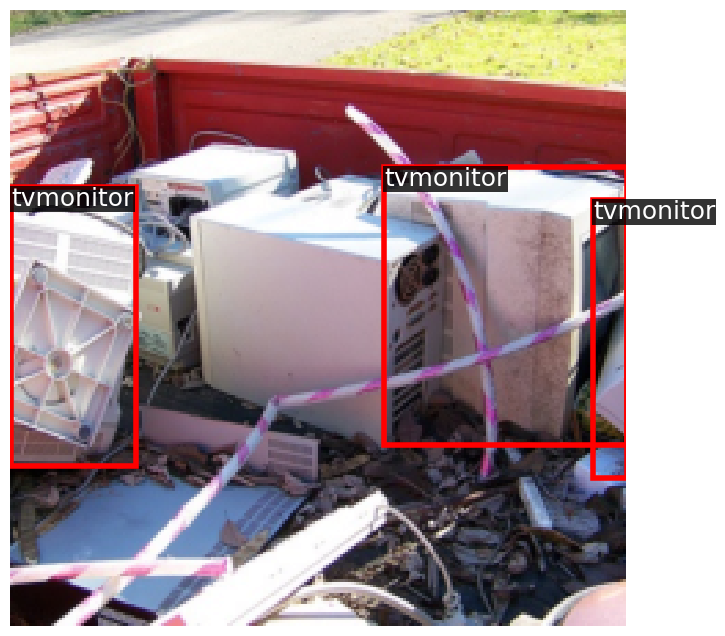

tensor([[  0.0000,   0.0000, 116.2384,  72.8894],
        [ 20.4009,   0.0000, 213.1283,  58.0381],
        [ 41.1973, 168.8285, 224.0000, 224.0000],
        [  0.0000, 169.2383, 118.0035, 224.0000],
        [ 76.2897,   0.0000, 199.0341,  91.4493],
        [117.8625,  85.0750, 216.6525, 224.0000],
        [ 32.5324, 103.1097, 224.0000, 202.6491],
        [  0.0000,  82.4850,  73.6898, 224.0000],
        [ 38.0875,   0.0000, 136.9288, 108.4938],
        [  0.0000,   2.2440,  73.5778, 172.3405],
        [ 86.3099,  18.9019, 185.0800, 185.6134],
        [ 75.1536, 115.1401, 198.9255, 224.0000],
        [ 13.7706,   7.0720, 216.9979, 107.0124],
        [ 38.4760, 101.1069, 136.2241, 224.0000],
        [  0.0000,  89.0941, 120.7594, 187.3745],
        [133.4895,   0.0000, 224.0000, 107.6489],
        [ 14.5106,  70.7674, 218.2434, 170.5060],
        [ 54.6041,  22.0402, 152.8814, 186.9845],
        [  0.0000,  39.0389, 154.2496, 138.9892]], device='cuda:0') tensor([-1, -1, -1, -1, -1, -1, 

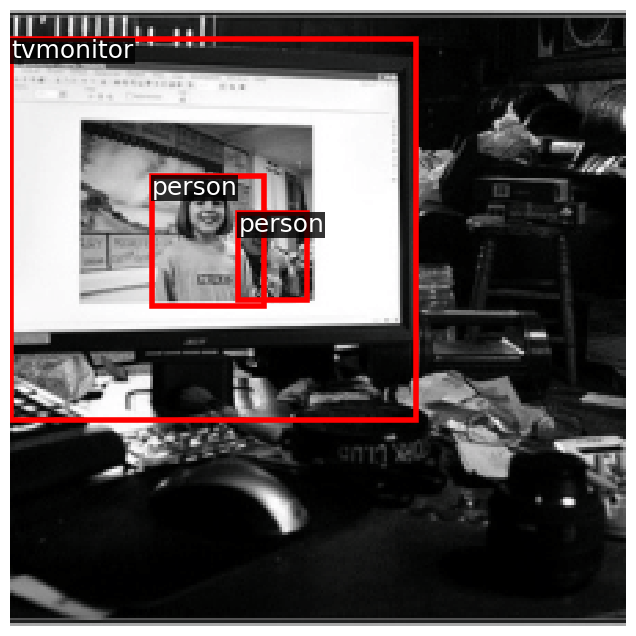

tensor([[  0.0000,  97.2751,  74.2804, 224.0000],
        [  0.0000, 169.0461, 100.6219, 224.0000],
        [ 12.3339, 132.5964, 134.4006, 224.0000],
        [  0.0000,   0.0000, 120.4205,  75.3622],
        [124.7846, 133.6838, 224.0000, 224.0000],
        [  0.0000,  36.5287,  88.1203, 203.9031],
        [ 86.6595, 102.2647, 184.9869, 224.0000],
        [  0.0000, 102.6662, 202.8813, 202.8263],
        [ 46.0490,   0.0000, 163.7290,  73.2230],
        [134.8085,   0.0000, 224.0000, 122.5956],
        [ 80.2692,  71.7635, 224.0000, 170.9880],
        [ 42.0907, 168.8690, 224.0000, 224.0000],
        [  0.0000,  88.3183, 121.6447, 187.3751],
        [  1.7198,  39.8049, 201.5576, 138.0532],
        [ 57.6077,  33.9208, 182.8754, 173.9201],
        [ 25.7531,   0.0000, 151.6595, 126.0834],
        [ 92.0775,   0.0000, 214.2427,  90.5399]], device='cuda:0') tensor([-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1],
       device='cuda:0') tensor([0.9996, 0.9991, 0.9971,

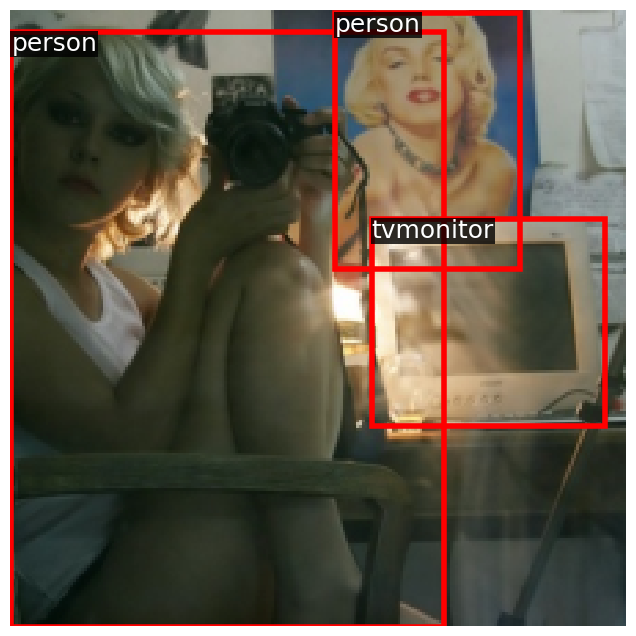

tensor([[  0.0000, 153.5816, 121.0272, 224.0000],
        [ 25.4237, 168.7197, 214.6696, 224.0000],
        [  0.0000,   0.0000, 118.5494, 108.6104],
        [  0.0000,   0.0000,  82.7477,  70.5964],
        [ 78.1692, 155.3153, 138.1594, 223.1988],
        [  0.0000,   0.0000, 186.0564,  74.4186],
        [  0.0000, 107.1903,  65.9817, 224.0000],
        [ 93.6641,   0.0000, 211.4977,  74.1737],
        [ 38.8121, 116.2804, 135.9866, 224.0000],
        [ 86.5716,   1.6683, 147.0421,  71.8210],
        [  0.0000,   3.1643,  73.2221, 172.2923],
        [ 70.9511,   0.0000, 167.8994,  92.6739],
        [  0.6494, 119.2209, 202.6562, 218.2084],
        [ 76.5439, 133.5310, 196.0791, 224.0000],
        [ 46.5625,   7.0205, 224.0000, 105.4981],
        [ 39.1704,   0.0000, 137.2567, 140.5734],
        [134.6595, 101.2796, 224.0000, 224.0000],
        [  0.0000,  24.4038, 187.0539, 123.1338],
        [  0.0000,  89.0011, 119.9693, 186.3825],
        [102.3555,   0.0000, 201.7320, 142.4059],


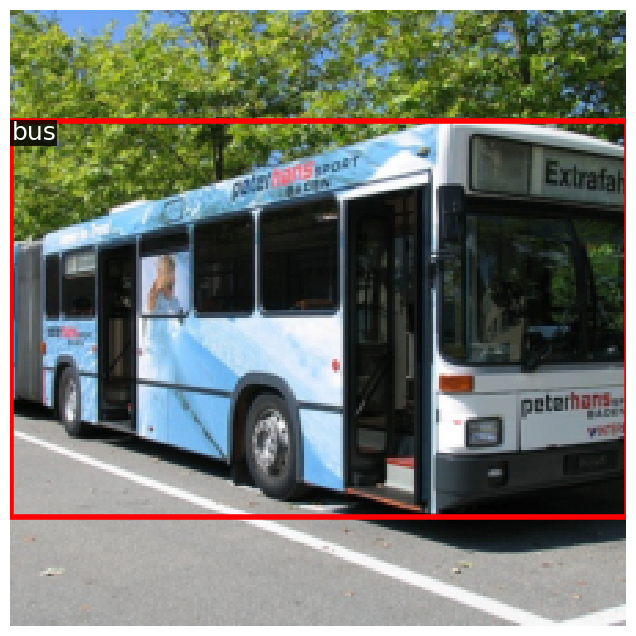

tensor([[  0.0000, 169.4755, 118.0589, 224.0000],
        [  0.0000,  18.2872,  73.7905, 186.2106],
        [ 60.1613, 153.2435, 178.4050, 224.0000],
        [118.5206,   0.0000, 217.0959, 107.2111],
        [  0.0000,   0.0000,  73.1686, 109.7823],
        [124.7505, 134.7636, 224.0000, 224.0000],
        [  0.0000,  80.4203,  57.5022, 224.0000],
        [ 78.2502,   0.0000, 195.8687,  74.4631],
        [ 13.0185, 134.5779, 134.5213, 224.0000],
        [ 17.9035,   8.4327, 218.8247, 106.4566],
        [  0.0000,  56.4684, 121.5369, 155.3833],
        [ 38.5241,   0.0000, 136.9819, 123.5450],
        [  0.0000,   0.0000, 181.4307,  57.7420],
        [ 43.1410,  19.7627, 167.1508, 157.4955],
        [ 15.7760, 119.2244, 217.9528, 217.6540],
        [  0.0000,  88.4977, 138.2094, 186.6552],
        [ 54.3595, 100.5026, 152.7061, 224.0000],
        [ 88.0821,  20.5037, 185.5272, 187.9870],
        [149.1757,  21.3621, 224.0000, 190.0646],
        [ 63.0892,  55.2096, 224.0000, 154.6965],


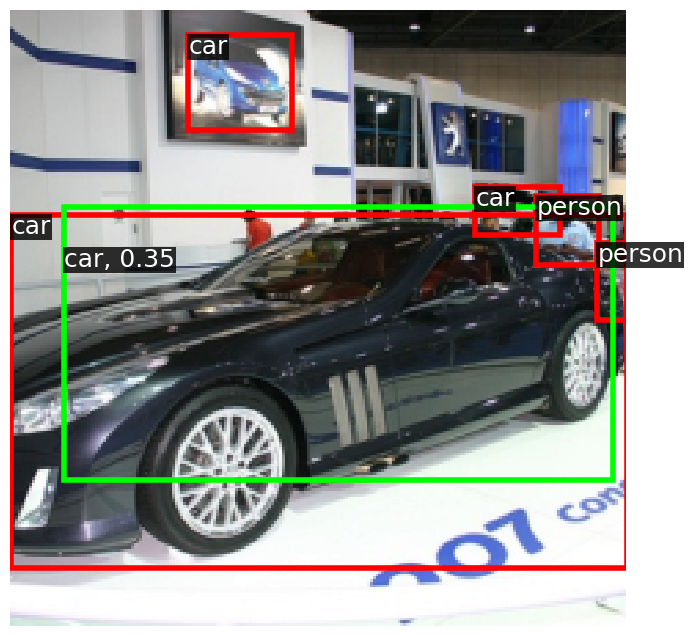

tensor([[  0.0000, 169.0341, 182.5820, 224.0000],
        [ 30.2496,   0.0000, 146.9601,  72.9798],
        [  0.0000,   0.0000, 100.7904, 104.7085],
        [ 63.1476, 173.1300, 152.9326, 219.3969],
        [  0.0000, 117.9216, 100.9432, 224.0000],
        [ 37.6506,   0.0000, 224.0000,  57.4111],
        [  0.0000, 165.2416,  79.2480, 211.2628],
        [  0.0000,  20.0941,  87.6836, 188.9519],
        [ 38.2445, 114.9433, 135.9225, 224.0000],
        [ 87.1946,   1.6970, 146.8260,  69.8333],
        [ 82.7886, 135.0779, 132.2479, 224.0000],
        [ 76.8891, 134.3034, 195.7078, 224.0000],
        [ 20.1853, 119.1073, 217.9048, 217.3587],
        [ 77.4738,   0.0000, 197.4785,  90.5227],
        [  2.2556,   7.8004, 201.5266, 106.1813],
        [ 54.9170,   0.0000, 152.6680, 124.1948],
        [  0.0000,  72.5827, 137.9562, 170.5019],
        [ 33.9620,  86.5396, 224.0000, 185.4494],
        [ 89.4626,  63.6608, 139.9350, 145.2023],
        [ 73.2795,  20.2182, 197.3453, 156.3564],


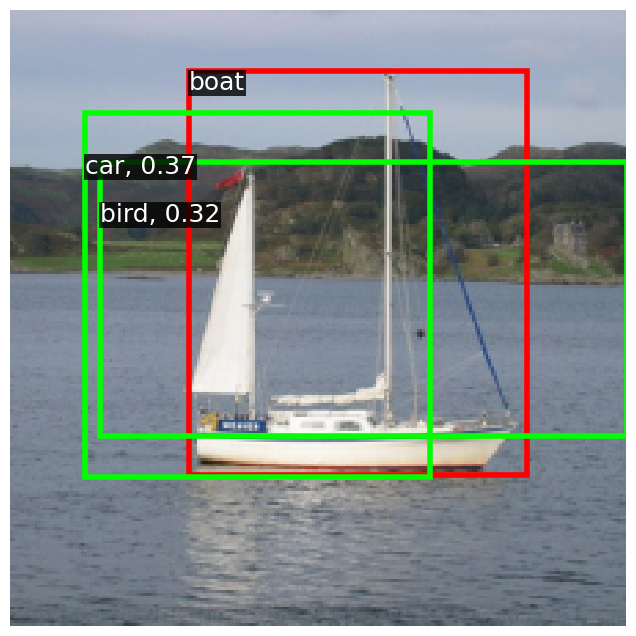

tensor([[ 94.1212,   0.0000, 211.6362,  74.5519],
        [ 74.5941,   0.0000, 200.1083, 129.2445],
        [ 42.9973,   0.0000, 167.2725,  95.1772],
        [  0.0000, 122.1667,  66.5891, 224.0000],
        [  0.0000, 153.3199, 121.3450, 224.0000],
        [  0.0000,   0.0000, 182.4018,  57.9668],
        [117.0406,   5.9787, 217.2813, 173.7150],
        [ 30.4210,  39.5445, 224.0000, 139.2570],
        [ 70.8536,  20.9775, 169.4567, 185.9640],
        [ 25.4145, 168.9161, 214.7108, 224.0000],
        [ 39.0620, 115.9847, 136.5387, 224.0000],
        [  0.0000, 120.4390, 186.4591, 218.6929],
        [ 16.0417,  71.2636, 218.4779, 170.7935],
        [  0.0000,   0.0000,  88.6167,  72.9445],
        [ 38.0603,   0.0000, 138.0315, 155.5223],
        [  0.0000,  34.2509,  73.8913, 204.7604],
        [  0.0000,  88.7388, 121.9322, 186.8617],
        [ 87.4751, 101.2717, 185.0317, 224.0000],
        [118.8015,  84.2268, 216.3502, 224.0000],
        [  0.0000,   0.0000, 122.9192, 117.3348]],

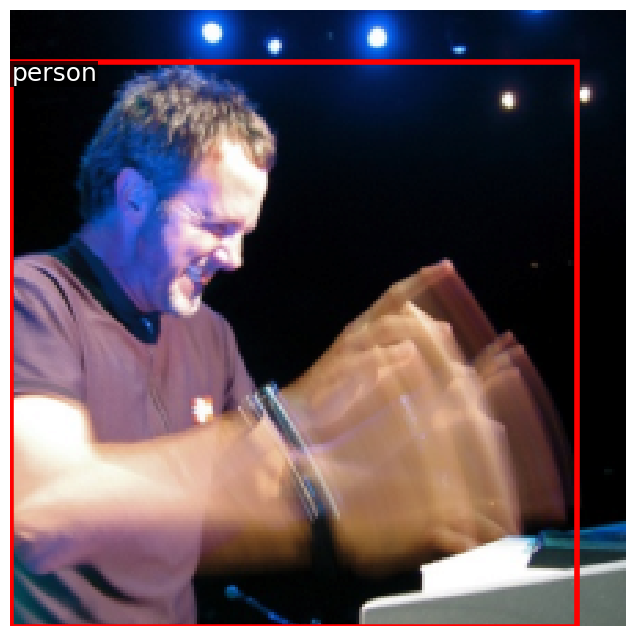

tensor([[ 94.0335,   0.0000, 211.0255,  73.1140],
        [ 15.5801,   6.7110, 220.3137, 106.8538],
        [ 37.4885,   0.0000, 136.4441, 108.8459],
        [  0.0000,   0.0000, 102.4428,  90.2741],
        [  5.4485,   0.0000, 198.9450,  57.9723],
        [100.3694,  23.9392, 162.7338,  99.2930],
        [ 85.4893,  36.3727, 180.2069,  83.7600],
        [ 77.9716, 188.3337, 170.1822, 224.0000],
        [ 72.3288,   2.2079, 198.2888, 142.1150],
        [ 98.2849, 158.4521, 149.1085, 224.0000],
        [ 84.1427,   1.3994, 146.9588,  74.3213],
        [  0.0000, 168.7228, 167.0056, 224.0000],
        [ 69.1481,  20.1573, 164.5421,  67.8988],
        [  0.0000, 116.6631,  88.5455, 224.0000],
        [ 43.9409, 132.4788, 167.6712, 224.0000],
        [ 23.5341, 100.7008, 121.0273, 224.0000],
        [  0.0000,   3.7654,  88.6308, 172.1716],
        [  1.1707,  39.3205, 203.7426, 139.2745],
        [ 86.8049, 100.9127, 185.6149, 224.0000],
        [ 55.2462,  20.3183, 153.4243, 186.3937],


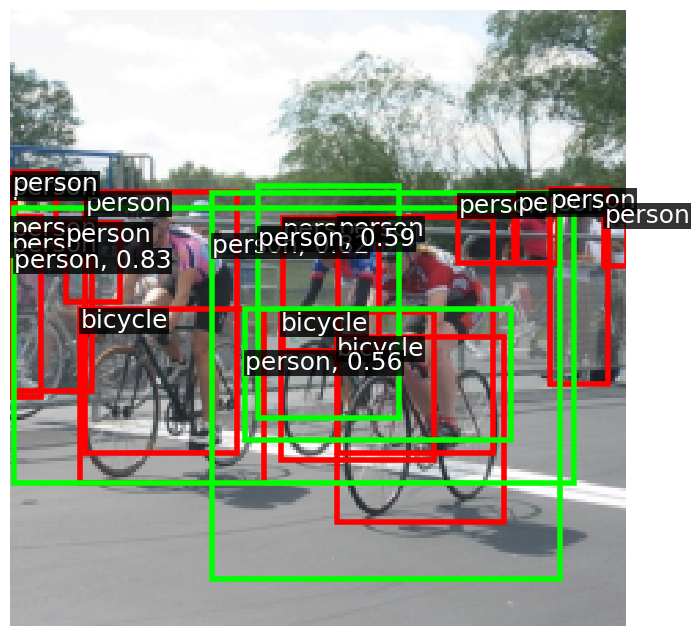

tensor([[  0.0000,   0.0000, 181.3397,  58.3462],
        [  6.1558,   0.0000, 103.6701,  92.6993],
        [  0.0000, 139.2907,  65.3064, 224.0000],
        [ 94.3516,   0.0000, 210.9556,  74.1326],
        [  0.0000, 169.1394, 117.5085, 224.0000],
        [ 53.9072,   0.0000, 151.6173,  93.8599],
        [  4.5450, 152.7157, 200.8402, 224.0000],
        [  0.0000, 114.4132, 119.1236, 224.0000],
        [109.3158, 133.7917, 224.0000, 224.0000],
        [  0.0000,  23.5157,  83.7141, 150.6892],
        [  2.2703,   7.8618, 201.8493, 105.5321],
        [ 32.8932, 119.2554, 224.0000, 217.6199],
        [124.1272,   0.0000, 224.0000, 124.3812],
        [133.9655,  36.4065, 224.0000, 204.3816],
        [ 69.2608, 100.6848, 168.4496, 224.0000],
        [  0.0000,  71.5682,  84.3323, 199.7415],
        [ 38.8695,  66.8996, 136.2581, 224.0000],
        [ 62.7379,  87.5138, 224.0000, 186.1835],
        [ 86.2736,   0.0000, 185.4359, 124.7574],
        [ 43.1533,  20.5765, 167.5242, 156.3835],


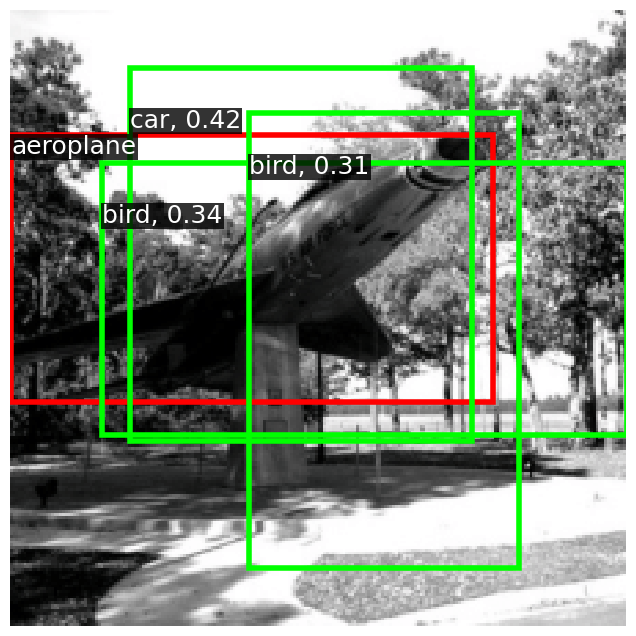

tensor([[  0.0000, 169.3340, 166.4153, 224.0000],
        [157.5134,   0.0000, 224.0000, 118.7250],
        [ 64.6420,  55.9772, 224.0000, 154.1053],
        [ 62.1950, 153.4119, 178.3672, 224.0000],
        [  0.0000,  71.2526, 188.4230, 169.8930],
        [ 53.8875,  35.8113, 153.9520, 203.0489],
        [  0.0000,  71.0088,  85.3604, 199.2187],
        [ 22.8334,  68.5218, 121.2898, 224.0000],
        [ 75.9604,  68.0355, 198.2881, 203.4098],
        [  0.0000, 111.6609,  56.8780, 224.0000],
        [  0.0000,  57.1581, 120.8843, 155.1506],
        [ 43.7701,  98.9422, 166.6365, 224.0000],
        [119.2136,  83.9813, 217.5114, 224.0000],
        [103.2117,   0.0000, 200.3416, 138.4199],
        [ 37.2448,   0.0000, 224.0000,  57.5296],
        [150.0278, 117.3153, 224.0000, 224.0000],
        [ 86.5960,   0.0000, 183.1599,  93.6843],
        [ 16.1295,  23.4992, 218.4935, 122.1702],
        [ 42.4592,   2.8129, 166.5184, 140.7134],
        [  0.0000,   3.6220,  72.1073, 172.1526],


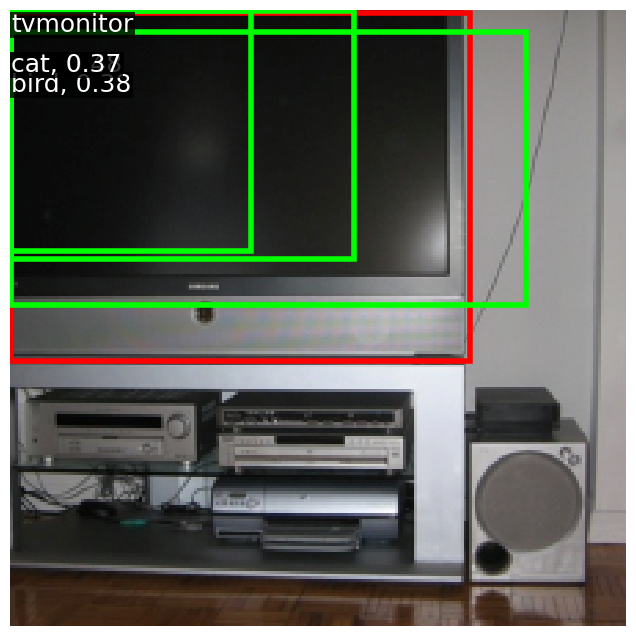

tensor([[103.8895,   0.0000, 160.9779,  35.8907],
        [102.5744,   0.0000, 198.5811,  93.0607],
        [ 86.8055,  60.5048, 177.5847, 107.1893],
        [  3.6890, 152.6340, 202.4578, 224.0000],
        [107.2027,  30.7407, 156.1248, 121.0771],
        [ 48.1013,   7.1736, 224.0000, 105.7397],
        [ 38.4780,   0.0000, 224.0000,  57.5771],
        [ 43.4056,  18.9982, 167.7113, 154.7722],
        [ 71.3216, 115.7417, 167.9223, 224.0000],
        [  0.0000,   0.0000, 115.9755,  73.0379],
        [ 38.8192,   0.0000, 136.6970, 106.7543],
        [ 55.4793,  53.0647, 153.4458, 219.8890],
        [ 77.5896, 131.7291, 168.9848, 179.3822],
        [ 85.8742,  19.7350, 185.0431, 186.3810],
        [  0.0000,  56.4324, 120.1959, 154.9432],
        [ 31.3652, 103.5059, 224.0000, 202.5382],
        [ 23.5256, 101.2842, 121.3428, 224.0000],
        [  0.2593,  71.0879, 203.4948, 170.8581],
        [  0.0000,   0.0000,  88.6019, 139.4272],
        [  0.0000,  34.4059,  73.0281, 203.5628],


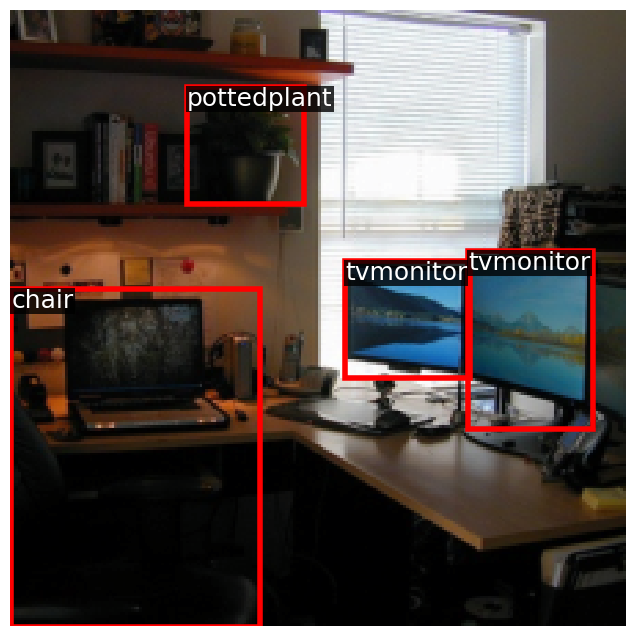

tensor([[ 30.2765,   0.0000, 147.7857,  73.3266],
        [  0.0000, 115.2398,  88.1877, 224.0000],
        [ 27.9233, 132.5251, 150.9067, 224.0000],
        [ 77.8614, 152.6398, 195.3024, 224.0000],
        [  0.0000, 168.9215, 166.5186, 224.0000],
        [  6.1597,   0.0000, 103.6297,  93.0919],
        [  0.0000,  34.7511,  73.4199, 204.9168],
        [ 47.6216,   0.0000, 224.0000,  89.7059],
        [  0.0000, 103.9817, 202.9751, 203.2255],
        [  0.0000,  41.2113, 120.8351, 138.4601],
        [ 42.4368,   2.5522, 168.0296, 142.3830],
        [ 99.5652,  88.3313, 224.0000, 185.2072],
        [ 73.5879,  65.5089, 199.0039, 207.1370],
        [133.7144, 117.2209, 224.0000, 224.0000],
        [141.4919,   0.0000, 224.0000, 120.5468],
        [  0.0000,  72.0247, 186.7539, 171.1384],
        [149.9512,  36.1164, 224.0000, 204.4568],
        [ 38.8836,  36.3775, 136.9823, 202.8577],
        [ 15.5659,  39.0317, 220.3547, 138.3955]], device='cuda:0') tensor([-1, -1, -1, -1, -1, -1, 

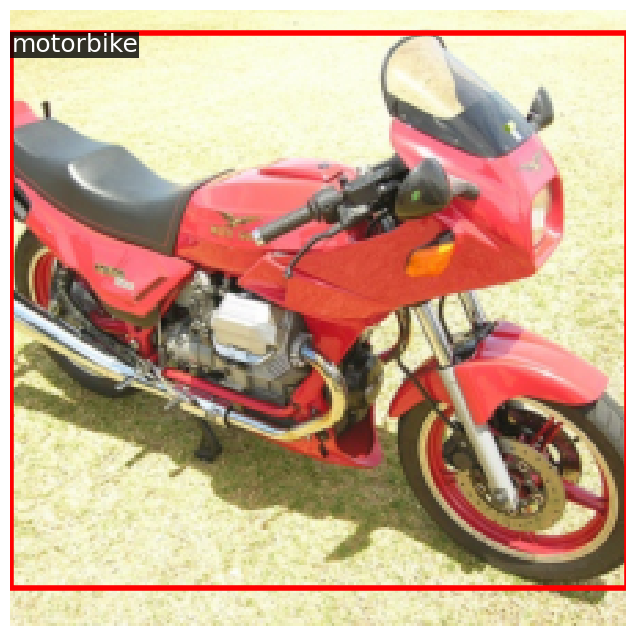

tensor([[  0.0000, 122.5073,  66.7271, 224.0000],
        [  0.0000, 169.0287, 116.9876, 224.0000],
        [  0.0000,   0.0000,  86.8688,  93.3707],
        [  0.0000,  20.8876, 101.8859, 155.0798],
        [  0.0000,  72.6332, 120.8167, 170.8681],
        [  0.0000,   7.9105, 153.9021, 105.9629],
        [123.9428, 100.6540, 224.0000, 224.0000],
        [  4.0836,   0.0000, 197.9230,  57.7377],
        [ 28.2573,  37.1466, 150.1953, 170.0612],
        [ 18.0321,  40.3113, 218.6662, 137.9501],
        [ 70.1198,   0.0000, 169.3821, 141.0373],
        [ 23.2631,  85.4365, 119.7698, 224.0000],
        [134.4872,   0.0000, 224.0000,  93.6483],
        [123.8288,  22.1750, 224.0000, 154.0256],
        [ 47.9914,   0.0000, 224.0000,  89.8115],
        [ 36.0839,  72.0641, 224.0000, 169.6746],
        [ 20.9071, 152.6021, 216.9474, 224.0000],
        [ 87.1160,  52.5737, 184.0302, 220.7100],
        [  0.0000, 103.5334, 185.2189, 201.5597],
        [ 55.7689,  67.8761, 152.7964, 224.0000]],

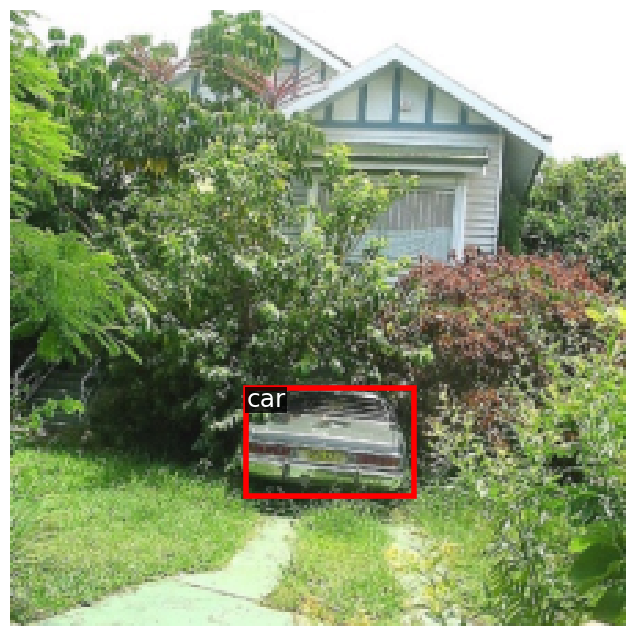

tensor([[ 46.6824,   0.0000, 164.5478,  73.6180],
        [ 72.2845,  21.5195, 159.9047,  67.4683],
        [ 90.6665,   0.0000, 140.0397,  83.7806],
        [  0.0000,   7.8540, 139.0811, 106.7369],
        [ 41.9172, 169.0780, 224.0000, 224.0000],
        [ 86.5443,   0.0000, 183.2392,  93.6641],
        [  0.0000, 168.8803, 117.4254, 224.0000],
        [134.3377, 101.3472, 224.0000, 224.0000],
        [ 62.7823, 173.1747, 153.1137, 219.3826],
        [  0.0000,  21.2997,  85.5772, 152.9227],
        [  0.0000,   0.0000,  83.8833,  71.1042],
        [ 53.2605,   0.0000, 152.5631, 139.3235],
        [ 28.5711, 152.9362, 146.7057, 224.0000],
        [ 75.0560, 133.0357, 196.2951, 224.0000],
        [ 33.2126,  23.3661, 224.0000, 122.1235],
        [ 82.3488, 142.2083, 133.1328, 224.0000],
        [  0.0000, 120.6817, 121.5261, 219.1307],
        [  0.0000,  79.9116,  57.4413, 224.0000],
        [123.9058,  51.3311, 224.0000, 189.2599],
        [ 53.8998, 101.0401, 153.8332, 224.0000],


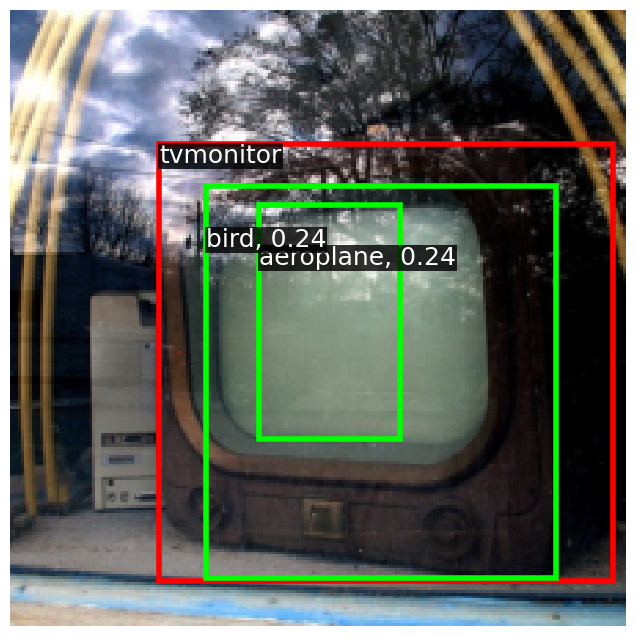

tensor([[ 35.1992,   0.0000, 224.0000,  58.0360],
        [  0.0000, 112.4807,  57.2059, 224.0000],
        [  0.0000,  34.7387,  88.4578, 202.6139],
        [  0.0000, 169.0074, 101.1431, 224.0000],
        [ 39.5383, 115.0166, 137.4041, 224.0000],
        [  3.8853, 152.5479, 202.5402, 224.0000],
        [  0.0000,  88.2804, 138.3938, 186.5738],
        [ 30.4609,   0.0000, 147.1031,  73.2187],
        [ 76.9929,   0.0000, 198.2536,  93.0486],
        [140.2223,   0.0000, 224.0000, 122.6186],
        [  0.0000,   0.0000, 118.6084, 125.7913],
        [ 88.4242, 168.9221, 224.0000, 224.0000],
        [ 54.8698,  53.0136, 153.7660, 218.8940],
        [  0.0000,   0.0000,  71.5246,  93.8822],
        [133.5990, 117.0226, 224.0000, 224.0000],
        [ 15.0764,   7.3468, 218.7048, 106.2142],
        [ 38.2336,   5.6018, 136.4688, 173.2537],
        [ 72.4416,  95.5981, 199.7506, 224.0000],
        [  0.0000,  39.9597, 186.4350, 138.4364],
        [ 70.9224,   3.9243, 169.3250, 170.5063],


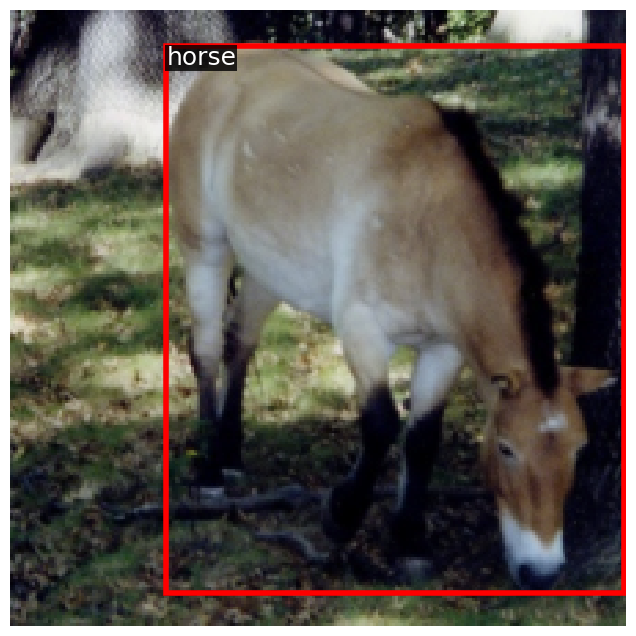

tensor([[  9.3610, 168.9783, 199.3636, 224.0000],
        [ 61.7691,   0.0000, 179.5602,  72.8296],
        [  0.0000, 112.2722,  57.0828, 224.0000],
        [ 38.0680,  84.3407, 137.7165, 224.0000],
        [  0.0000, 153.3251, 120.0952, 224.0000],
        [  0.0000,  87.0341, 203.6662, 185.7068],
        [ 59.9021,  66.7179, 181.1788, 204.5860],
        [ 70.4974, 115.4431, 169.3098, 224.0000],
        [ 14.7477, 119.5452, 219.4150, 218.4807],
        [  1.0640,   0.0000, 202.1446,  90.1748],
        [134.2687,   0.0000, 224.0000,  93.0967],
        [  0.0000,  66.5646, 103.5641, 205.2580],
        [118.9698,  20.1173, 217.9698, 188.9732],
        [ 92.3050,   0.0000, 213.7787, 124.5782],
        [ 64.6736,  56.0602, 224.0000, 153.8975],
        [  0.0000,   0.0000,  86.2867, 102.1135],
        [  0.0000,  55.8481, 140.3982, 155.5891],
        [ 69.9910,   4.8321, 169.7226, 174.7341],
        [  0.0000,  17.4427,  74.2846, 187.2172],
        [ 38.8794,   0.0000, 136.4410, 121.5261]],

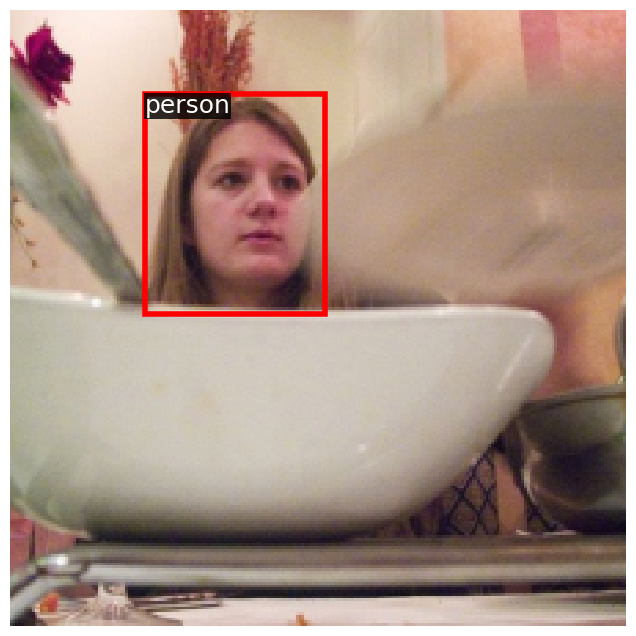

tensor([[ 60.4577, 153.3099, 177.2157, 224.0000],
        [  0.0000, 112.4009,  56.4936, 224.0000],
        [  0.0000, 169.1289, 117.4197, 224.0000],
        [ 78.3812,   0.0000, 195.2444,  74.2939],
        [ 17.7551, 134.9744, 218.4734, 224.0000],
        [134.3925, 115.7353, 224.0000, 224.0000],
        [  6.9641, 100.5216, 103.6881, 224.0000],
        [ 54.0915,   0.0000, 151.7580,  94.1570],
        [  0.0000,   0.0000,  83.5945,  69.9177],
        [  0.0000,  36.6367,  88.7692, 205.2789],
        [ 70.8018,   0.0000, 169.7241, 156.3201],
        [158.2476,   0.0000, 224.0000,  87.7618],
        [  1.3764,   7.9253, 202.2085, 105.9914],
        [  0.0000,  88.2558, 137.8818, 186.1671],
        [  0.0000,   0.0000, 103.3509, 121.9232],
        [ 39.4445,  68.6613, 136.0538, 224.0000],
        [ 26.9712,  36.5070, 150.3800, 172.0271],
        [ 91.5779,   0.0000, 214.1323, 124.4669],
        [ 72.6226,  99.2859, 197.5462, 224.0000],
        [ 58.5975,  50.7204, 184.2945, 186.5873],


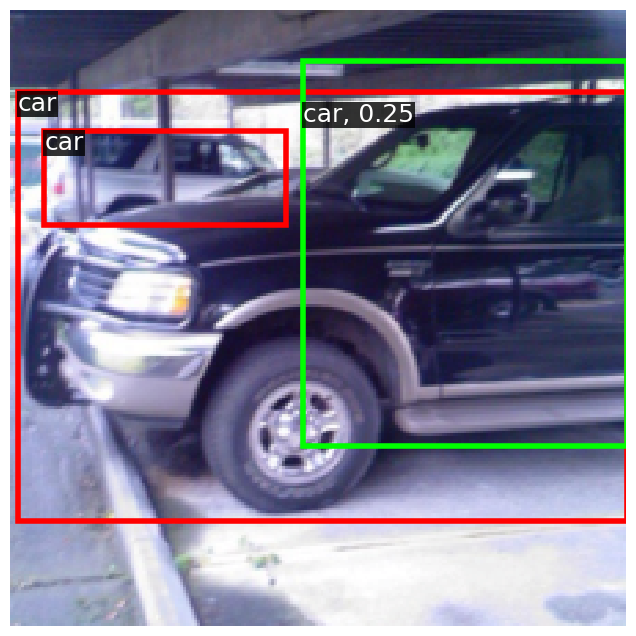

tensor([[ 44.3192, 154.2822, 162.8814, 224.0000],
        [  0.0000, 154.0538, 102.1196, 224.0000],
        [ 81.1786, 136.2725, 224.0000, 224.0000],
        [  0.0000, 120.7519, 185.8036, 218.5764],
        [ 20.0372,  23.5119, 217.6004, 122.2548],
        [ 70.3432,  84.4728, 168.5655, 224.0000],
        [ 87.4845,   0.0000, 183.5672, 139.6517],
        [ 38.1542,   0.0000, 136.4587, 108.7903],
        [  0.0000,   0.0000, 119.9744,  75.3559],
        [ 22.8409, 115.4911, 119.5686, 224.0000],
        [  5.7510,   0.0000, 104.8079, 140.2169],
        [ 75.9427,  51.8917, 197.1047, 185.4387],
        [ 22.1497,   0.0000, 214.4791,  57.3806],
        [107.7741,  20.4142, 224.0000, 153.1785],
        [ 55.3903,  19.0817, 152.6336, 186.5359],
        [  0.0000, 105.9849,  67.4332, 224.0000],
        [  0.0000,  56.2231, 185.1365, 154.4128],
        [  0.0000,  35.1719,  73.8379, 205.8602],
        [  0.0000,  88.7873, 121.4844, 187.0050]], device='cuda:0') tensor([-1, -1, -1, -1, -1, -1, 

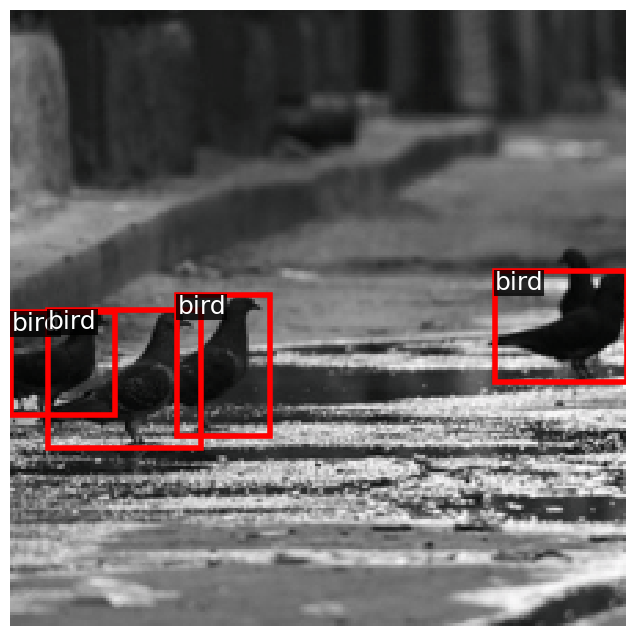

tensor([[ 21.0298,   0.0000, 213.5178,  57.8294],
        [  6.3343,   0.0000, 103.4144,  93.4645],
        [  0.0000,   2.3541,  73.8560, 172.0619],
        [ 54.2440,   0.0000, 151.2068,  93.4517],
        [ 86.9689,   0.0000, 183.6711,  93.2899],
        [  0.0000,  71.1491,  84.2058, 199.6954],
        [  0.0000,  57.3380, 121.5200, 154.9293],
        [ 32.4436,   7.7645, 224.0000, 106.1427],
        [102.6653,   0.0000, 201.4714, 138.8579],
        [ 27.6547,  20.1647, 149.2636, 154.6034],
        [  0.0000, 114.3387,  73.1670, 224.0000],
        [ 30.7393, 153.2610, 146.8149, 224.0000],
        [  0.0000, 135.1676, 184.9601, 224.0000],
        [ 22.5964,  84.6374, 120.6656, 224.0000],
        [ 18.3291,  39.8981, 216.7305, 137.7714],
        [ 71.0309, 116.4574, 168.8176, 224.0000],
        [150.2406, 116.5209, 224.0000, 224.0000],
        [ 71.4147,  20.9456, 168.2530, 188.9506],
        [  2.8783,  72.4608, 200.3823, 170.4030]], device='cuda:0') tensor([-1, -1, -1, -1, -1, -1, 

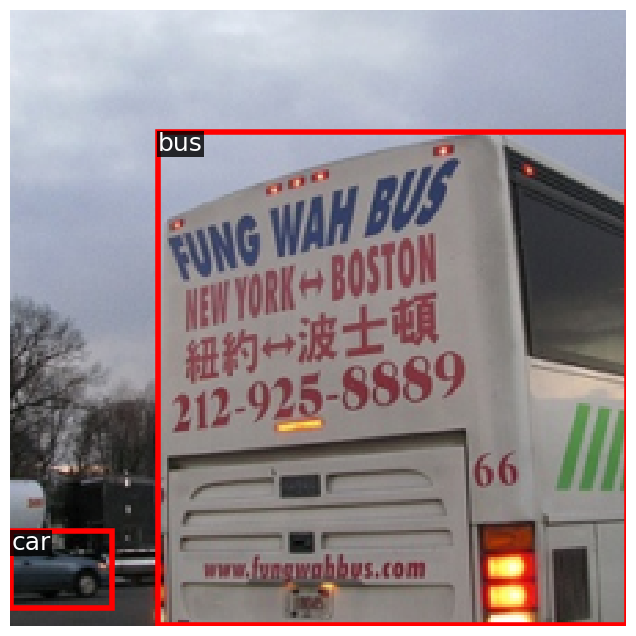

tensor([[  9.4778, 169.1481, 198.7793, 224.0000],
        [ 96.0583,   0.0000, 154.2379,  36.7079],
        [ 59.3333, 133.3534, 181.3560, 224.0000],
        [  0.0000, 153.3615, 101.6367, 224.0000],
        [ 68.9477,   4.3312, 162.8748,  51.8258],
        [ 14.6645, 118.6317, 219.5951, 218.7513],
        [  4.5234,   0.0000, 198.9833,  58.5003],
        [ 93.5908,   0.0000, 213.3629,  75.8056],
        [ 39.0586, 101.0905, 137.3025, 224.0000],
        [122.6096,  34.8350, 224.0000, 172.5434],
        [  0.0000,   0.0000,  88.3712, 108.1040],
        [ 90.8667, 117.1769, 156.2666, 199.6728],
        [ 85.4153,   0.0000, 186.3318, 120.6343],
        [ 72.6390,  64.5391, 199.8864, 206.6480],
        [ 39.1992,   4.7847, 137.9799, 169.8594],
        [  0.0000,  99.7282,  73.5285, 224.0000],
        [ 77.7951, 131.9822, 172.7839, 179.4195],
        [ 13.8919,   6.5662, 220.5171, 106.6116],
        [  0.0000,  55.1170, 140.6660, 156.1074],
        [ 74.1886,  59.9015, 174.1689, 108.5863],


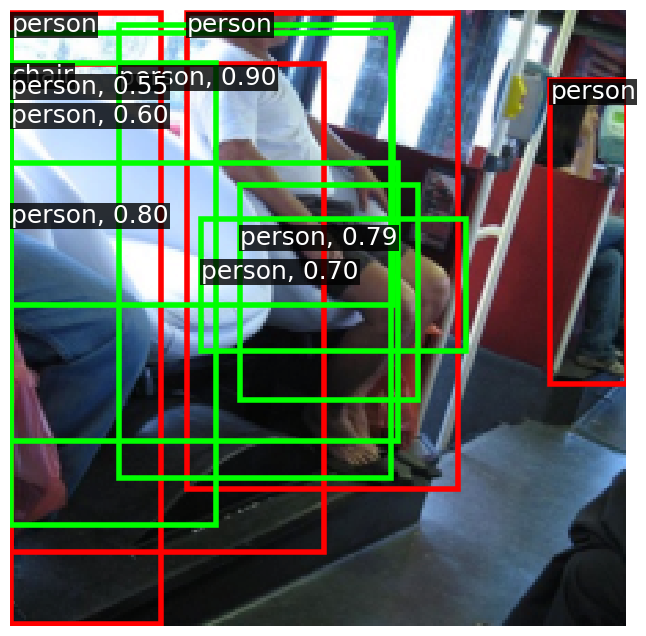

tensor([[ 43.4706,   0.0000, 167.2943, 125.0492],
        [  0.0000,  40.4394, 186.3821, 139.0683],
        [  0.9428,   0.0000, 201.9917,  74.9303],
        [ 38.8191,  19.7267, 137.7317, 187.6965],
        [  0.0000,  23.3707,  84.6975, 150.9405],
        [  0.0000,   0.0000, 118.6154, 109.2412],
        [  0.0000,  72.3692, 154.6571, 170.3736],
        [ 41.9997, 169.1296, 224.0000, 224.0000],
        [  0.0000,  64.7831,  56.8019, 224.0000],
        [102.2759,   0.0000, 199.3206,  93.1477],
        [ 74.8840,  18.3979, 200.4709, 157.0215],
        [  0.0000,   0.0000,  83.3744,  70.4128],
        [ 59.5230,  52.3625, 183.3967, 187.4966],
        [100.0921,  71.5410, 224.0000, 168.3251],
        [  0.0000, 168.8986, 117.8586, 224.0000],
        [  0.0000, 138.9947,  65.5188, 224.0000],
        [ 29.4955, 152.5880, 145.9871, 224.0000],
        [149.3365,  21.4273, 224.0000, 190.6748],
        [ 59.2596, 132.6493, 182.2897, 224.0000],
        [ 74.6010,  86.1995, 123.5795, 178.0417],


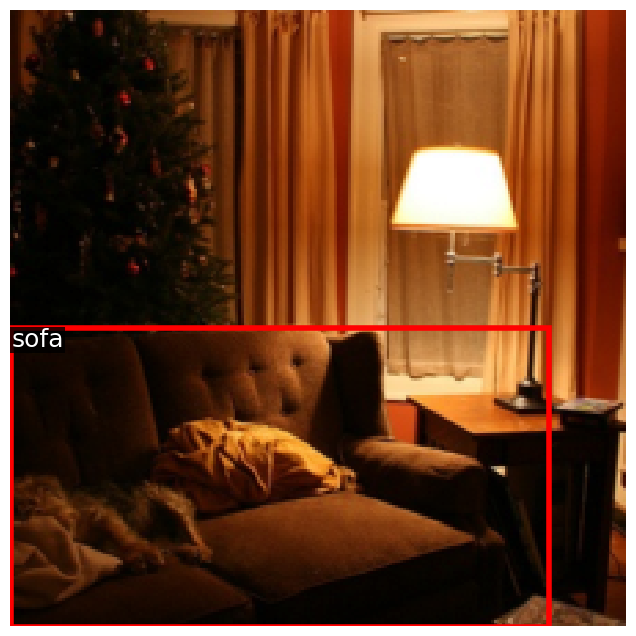

tensor([[ 56.1207,   0.0000, 152.6233, 138.3799],
        [ 29.6685, 153.7400, 146.5811, 224.0000],
        [ 70.9371, 180.2563, 161.8517, 224.0000],
        [ 51.2943,  23.9216, 224.0000, 121.2672],
        [ 98.8850,   6.6477, 146.3350,  98.9476],
        [ 82.5495,  37.4947, 168.2592,  83.1176],
        [ 90.6433, 157.8347, 140.2977, 224.0000],
        [ 86.6465,   0.0000, 183.5216,  93.0587],
        [ 36.7008,   0.0000, 224.0000,  57.8213],
        [  0.0000,   7.9627, 154.5173, 106.1700],
        [ 43.3769,  36.3636, 166.4207, 171.5865],
        [  0.0000,   0.0000,  71.3726,  93.5291],
        [  0.0000,  21.1243, 101.3385, 153.4002],
        [ 23.0517,  83.8803, 120.7405, 224.0000],
        [  0.0000, 115.9055,  87.9222, 224.0000],
        [  0.0000, 120.0339, 186.3703, 218.4877],
        [  0.0000,  72.7669, 121.2809, 170.8005],
        [ 54.1596,  70.5383, 152.1679, 224.0000],
        [ 74.7524, 133.4209, 197.8532, 224.0000],
        [ 86.0439,  21.4596, 184.8546, 190.3052],


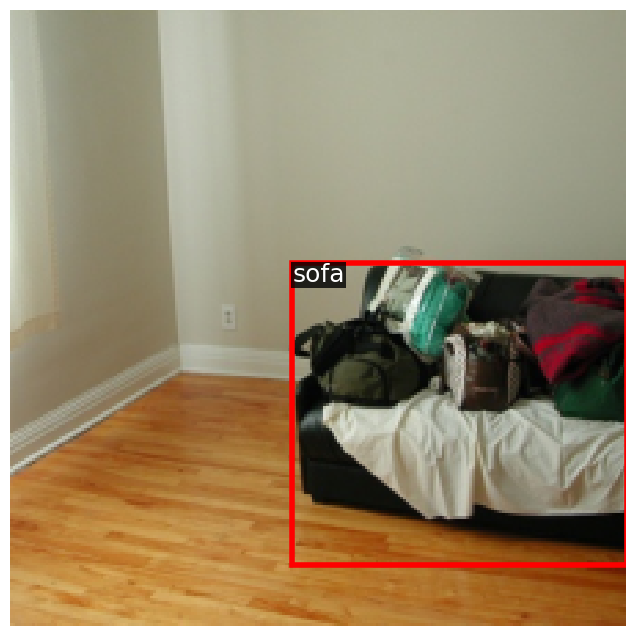

tensor([[0.0000e+00, 0.0000e+00, 7.3775e+01, 1.2416e+02],
        [0.0000e+00, 1.6888e+02, 1.1770e+02, 2.2400e+02],
        [0.0000e+00, 1.1386e+02, 7.2832e+01, 2.2400e+02],
        [3.7114e+00, 0.0000e+00, 1.9743e+02, 5.7856e+01],
        [6.9827e+01, 1.6130e+02, 1.3140e+02, 2.2400e+02],
        [0.0000e+00, 3.6904e+01, 8.7692e+01, 2.0375e+02],
        [4.5206e+01, 1.5382e+02, 1.6211e+02, 2.2400e+02],
        [9.4857e+01, 0.0000e+00, 2.1190e+02, 7.3748e+01],
        [1.2531e+02, 1.3383e+02, 2.2400e+02, 2.2400e+02],
        [3.8407e+01, 0.0000e+00, 1.3570e+02, 9.4457e+01],
        [0.0000e+00, 1.3421e+02, 2.0346e+02, 2.2400e+02],
        [0.0000e+00, 5.6307e+01, 1.3787e+02, 1.5447e+02],
        [1.4123e+02, 5.3976e+01, 2.2400e+02, 1.8522e+02],
        [7.1001e+01, 0.0000e+00, 1.6764e+02, 9.2955e+01],
        [2.3960e+01, 6.8768e+01, 1.2081e+02, 2.2400e+02],
        [8.6635e+01, 1.1460e+02, 1.8473e+02, 2.2400e+02],
        [7.4442e+01, 7.0674e+01, 1.2559e+02, 1.5936e+02],
        [1.637

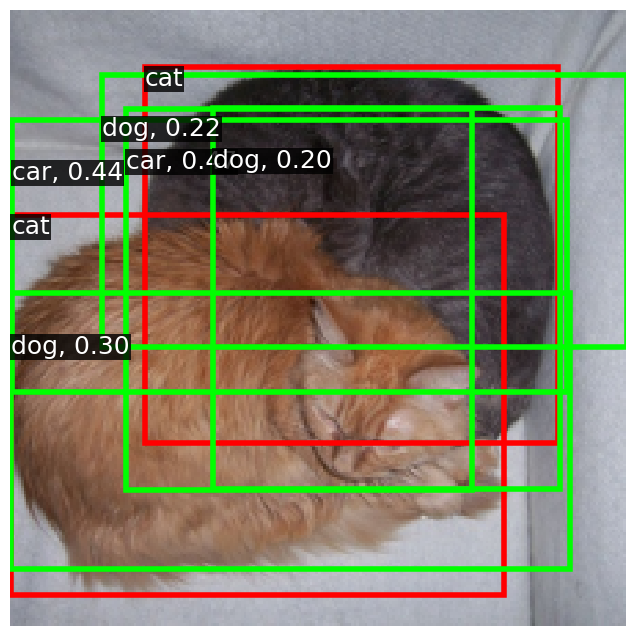

tensor([[ 87.1763,   2.1132, 146.6816,  70.9283],
        [  4.7767,   0.0000, 198.1664,  57.7787],
        [ 77.9843,  12.9890, 168.8425,  59.5860],
        [ 54.3882,   0.0000, 151.1683,  92.9873],
        [106.9921,   0.0000, 157.7093,  88.8129],
        [  0.0000,   0.0000,  88.2782, 121.5822],
        [ 54.8965,  38.1504, 154.6035, 204.0486],
        [ 74.2859,   0.0000, 200.8176, 111.2278],
        [ 66.1543,  84.3025, 165.0157, 133.5833],
        [ 82.5257,  63.6120, 134.0160, 146.6681],
        [ 85.5951,  27.8793, 179.2701,  75.4408],
        [ 86.7318,  21.9034, 185.3691, 187.8516],
        [  0.0000,  70.7225, 205.4438, 171.8877],
        [  0.0000,  52.3875, 103.7412, 187.6215],
        [  0.0000, 152.9353, 120.3146, 224.0000],
        [ 92.9399,  88.5010, 154.9331, 159.2474],
        [  0.0000,  98.6646,  73.7435, 224.0000],
        [ 73.4536, 107.8677, 174.1703, 156.9744],
        [ 79.4048, 162.8350, 138.1939, 224.0000],
        [ 38.7909, 115.7529, 136.3078, 224.0000],


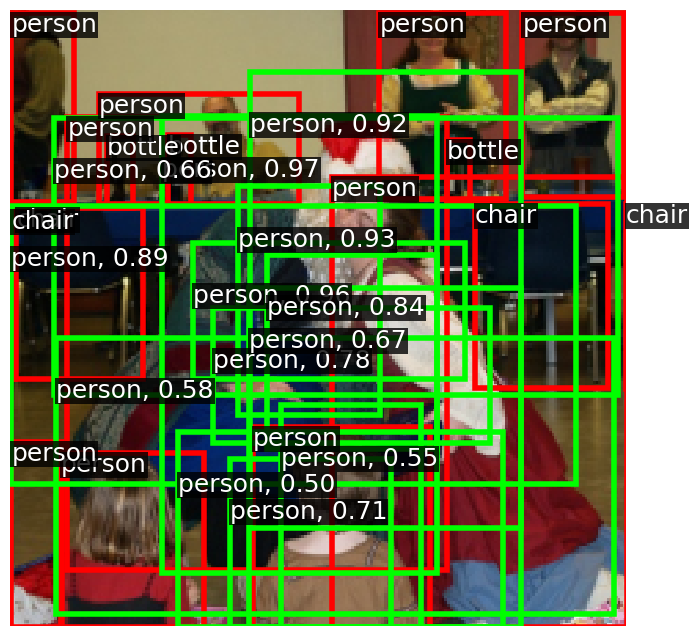

tensor([[  0.0000,   0.0000, 182.3318,  57.4795],
        [149.8081,  37.2098, 224.0000, 206.4645],
        [ 78.5144,   0.0000, 195.1891,  72.4872],
        [150.3660, 117.1856, 224.0000, 224.0000],
        [  0.0000,   0.0000,  84.5687,  87.5078],
        [149.3439,   0.0000, 224.0000, 125.4976],
        [  0.0000,  80.1854,  57.2740, 224.0000],
        [102.5000,   0.0000, 201.3770, 141.5005],
        [ 44.4534,   0.0000, 165.7315,  91.5310],
        [118.7312,  84.5785, 216.4903, 224.0000],
        [ 42.2093, 169.1871, 224.0000, 224.0000],
        [ 49.5022,  24.1007, 224.0000, 122.2878],
        [  0.0000, 153.4166, 120.5248, 224.0000],
        [  0.0000,   2.1631,  73.5094, 173.0379],
        [ 60.6303, 134.1945, 181.2153, 224.0000],
        [ 74.0505,  36.6797, 198.0405, 170.5315],
        [  0.0000,   0.0000, 119.5210, 124.6370],
        [ 17.2586, 120.1123, 218.6309, 218.2488],
        [ 54.8671,   3.6090, 151.6255, 170.0395],
        [ 34.5401,  87.2927, 224.0000, 185.9389],


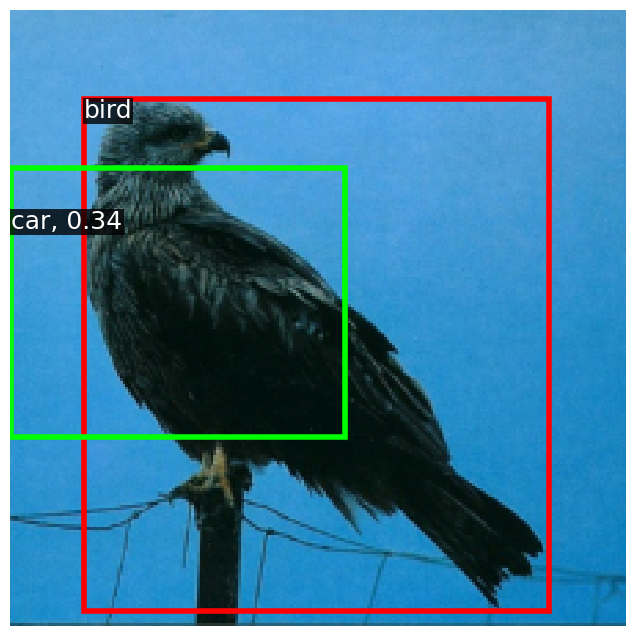

tensor([[  0.0000,  79.9711,  57.0503, 224.0000],
        [ 46.8612,   0.0000, 163.5888,  73.0866],
        [  0.0000,  55.8870,  84.7916, 184.3219],
        [ 30.4934,   0.0000, 224.0000,  90.2818],
        [ 86.0821,   0.0000, 183.4952,  92.8627],
        [ 55.2927,   0.0000, 153.7151, 155.9915],
        [  0.0000, 115.8763, 118.2730, 224.0000],
        [  0.0000,   0.0000, 137.6010,  90.6768],
        [  8.2920, 169.2382, 198.7101, 224.0000],
        [  0.0000,  39.6925, 185.6209, 138.3503],
        [  0.0000,   0.0000,  73.2226, 140.2826],
        [ 27.6522,  50.7046, 151.5513, 190.4392],
        [102.6511, 152.9560, 224.0000, 224.0000],
        [139.7446,  52.5415, 224.0000, 188.0832],
        [123.6119,   0.0000, 224.0000, 124.0397],
        [149.5474, 101.4367, 224.0000, 224.0000],
        [  0.0000,   0.0000,  83.0182,  70.5871],
        [ 31.6515,  71.5290, 224.0000, 170.2905],
        [  0.0000, 103.2012, 187.3317, 201.6944],
        [ 86.1766,  20.8240, 186.0029, 188.5588],


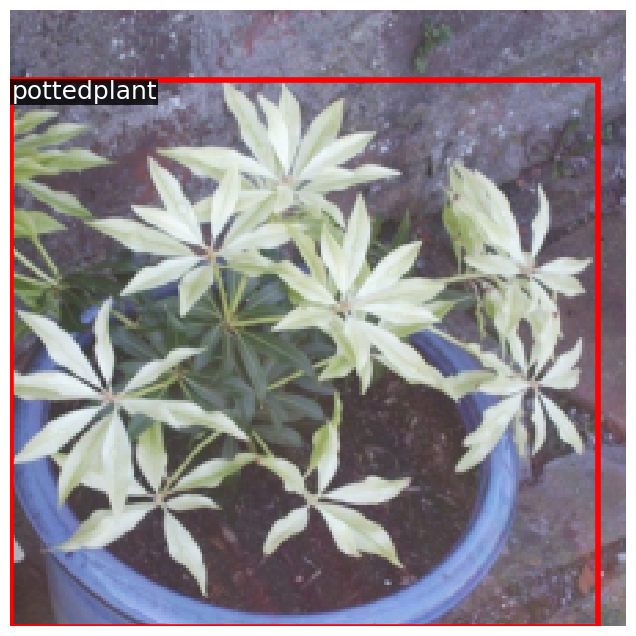

tensor([[ 46.4661,   0.0000, 164.1580,  72.4714],
        [  0.0000, 168.9094, 100.7661, 224.0000],
        [  0.0000,   0.0000,  84.3723, 117.8970],
        [ 22.8588,   0.0000, 121.4344, 122.2136],
        [  0.0000, 138.6573,  66.3306, 224.0000],
        [  0.0000,   7.0426, 186.9182, 107.0496],
        [ 41.8131, 169.4845, 224.0000, 224.0000],
        [ 90.8970,   0.0000, 213.8196, 107.9010],
        [ 79.7236,  54.6395, 224.0000, 153.5365],
        [ 86.3404,   7.0025, 183.2086, 171.4509],
        [  0.0000,  35.3145,  73.5213, 205.5496],
        [ 29.9584, 153.0851, 146.6491, 224.0000],
        [ 86.6921, 115.8065, 184.7180, 224.0000],
        [  0.0000, 135.5757, 203.0759, 224.0000],
        [ 30.6759, 103.0233, 224.0000, 202.1902],
        [ 26.4504,  35.1263, 152.8231, 172.6815],
        [  6.0551,  84.2835, 106.5767, 224.0000],
        [ 71.5745,  52.1861, 169.0730, 218.4208],
        [  0.2981,  87.4161, 202.2962, 186.3204],
        [  0.0000,  88.5602, 121.3728, 186.8308],


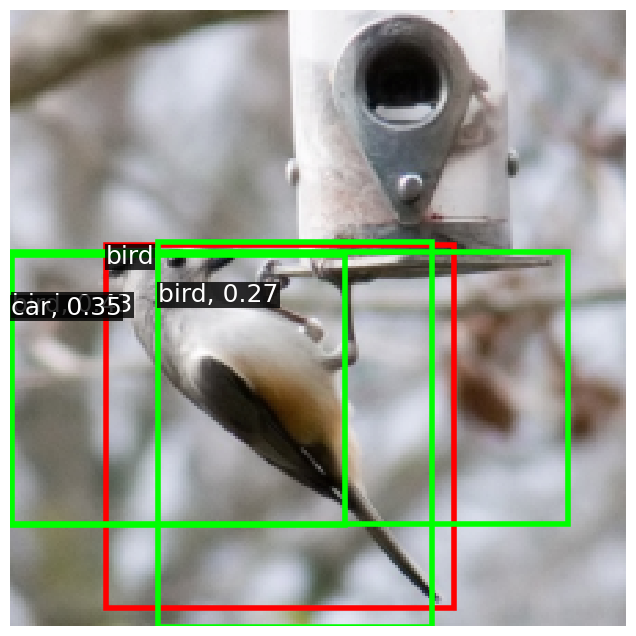

tensor([[ 90.2457, 150.4257, 141.1026, 224.0000],
        [ 45.0155, 153.5998, 162.7642, 224.0000],
        [ 79.7773,  28.8226, 171.3025,  75.3652],
        [ 62.2808,   0.0000, 179.3483,  71.6186],
        [102.9672, 152.8710, 224.0000, 224.0000],
        [  0.0000,   0.0000,  98.4535,  70.1378],
        [  2.2745,   0.0000, 201.4068,  89.7479],
        [ 93.9884,  15.6021, 156.3582,  91.8501],
        [  2.2315, 135.1271, 201.8672, 224.0000],
        [ 38.8942,   0.0000, 136.2664, 122.1356],
        [  0.0000,   0.0000,  87.4828, 140.9748],
        [ 39.6206, 100.6869, 136.6118, 224.0000],
        [ 91.2322,   0.0000, 213.4497, 106.1722],
        [  0.0000, 169.2198, 133.6875, 224.0000],
        [ 70.7063,   0.0000, 168.5294, 140.4294],
        [  0.0000,  33.5364, 119.4570, 174.3260],
        [  0.0000, 122.3820,  67.0796, 224.0000],
        [  0.0000,  70.9053,  85.9806, 200.7856],
        [ 54.4647,  19.6174, 152.4492, 187.1129],
        [  0.0000,  87.2696, 154.6834, 186.1348],


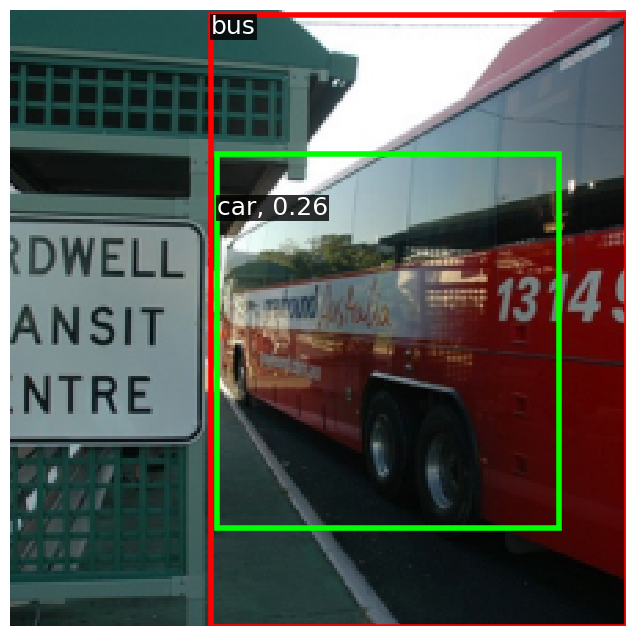

tensor([[  0.0000,   0.0000, 118.9520,  74.7982],
        [133.9505,  21.2190, 224.0000, 188.9281],
        [  0.0000,  70.3761,  85.9984, 199.4362],
        [  0.0000, 112.4443,  56.9003, 224.0000],
        [  0.0000,   0.0000,  73.8083, 125.3400],
        [118.0819,  99.8612, 217.5807, 224.0000],
        [ 20.8588,   0.0000, 213.1342,  57.4959],
        [124.1433,   0.0000, 224.0000, 107.6937],
        [ 22.9078,  83.2274, 121.5765, 224.0000],
        [  0.0000, 152.8204, 120.6883, 224.0000],
        [  6.2155,   4.0742, 105.2110, 170.7642],
        [ 79.0454,  71.6631, 224.0000, 170.4439],
        [ 78.0455, 154.2001, 194.2764, 224.0000],
        [ 32.5010, 136.1410, 224.0000, 224.0000],
        [ 86.7912,  83.9347, 185.5821, 224.0000],
        [ 60.6314,   0.0000, 181.4684,  90.9242],
        [  0.0000,  55.3284, 187.0799, 154.5295],
        [ 38.2973,  36.8101, 137.8710, 202.8797],
        [  0.0000,   7.7639, 201.0751, 106.0909],
        [ 38.8831,   0.0000, 137.0543, 124.2058],


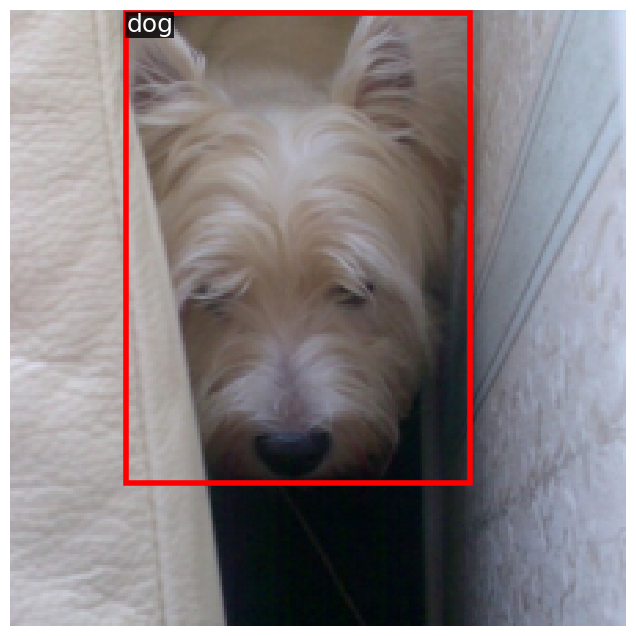

tensor([[103.4118,   0.0000, 161.5246,  35.9964],
        [ 55.0532,   0.0000, 152.4101, 108.5365],
        [  0.0000,   0.0000, 101.7905,  89.6743],
        [ 69.6965,   4.2265, 164.4154,  51.8930],
        [ 96.5131,   0.0000, 150.5830,  82.9377],
        [ 22.6193,   0.0000, 213.9165,  57.7574],
        [ 42.2195, 169.0600, 224.0000, 224.0000],
        [ 95.1914,  30.5044, 151.3939, 114.6039],
        [ 74.5285,  28.4928, 173.6525,  76.5744],
        [ 86.7886,   0.0000, 182.8346,  94.7554],
        [ 16.6138,   6.7373, 219.2905, 106.7954],
        [ 73.6201,  59.3223, 174.4896, 108.5428],
        [ 32.1128,  38.2571, 224.0000, 138.2448],
        [ 99.1964,  54.6414, 163.5063, 131.9873],
        [ 68.7683,  75.7504, 164.1982, 123.7009],
        [  0.0000,  39.8932,  84.4860, 165.7644],
        [ 29.0846, 153.2953, 146.2809, 224.0000],
        [ 70.3058,  19.6615, 168.9991, 185.2711],
        [ 60.7592, 133.3906, 181.6624, 224.0000],
        [  0.0000, 118.7933, 155.8645, 218.3884],


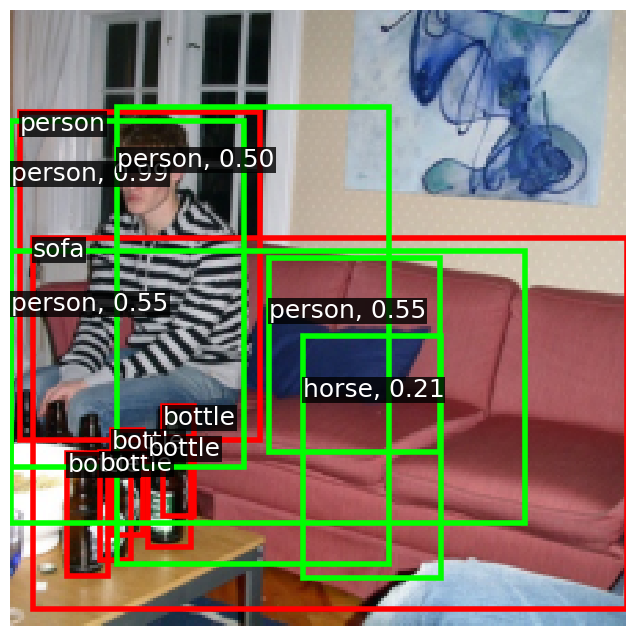

tensor([[  0.0000, 169.0517, 118.2051, 224.0000],
        [  0.0000, 139.6070,  65.8431, 224.0000],
        [  0.0000,  37.6836,  86.1261, 169.7554],
        [ 94.4194,   0.0000, 211.1031,  73.9288],
        [  0.0000,   0.0000,  73.6788, 124.6010],
        [123.3883,   0.0000, 224.0000, 125.2317],
        [  6.8664,  83.8688, 105.1433, 224.0000],
        [ 86.9111,   0.0000, 185.8188, 123.5614],
        [ 47.6778,   8.2513, 224.0000, 106.6262],
        [ 46.5899,   0.0000, 163.1819,  73.1361],
        [  0.0000,   0.0000, 120.0608,  75.0763],
        [139.9521, 101.4745, 224.0000, 224.0000],
        [118.9891,  36.2441, 215.8894, 202.9849],
        [  0.0000,  23.9086, 185.1363, 122.0785],
        [ 37.9098,   0.0000, 136.9182, 155.1491],
        [ 20.7447, 152.9944, 218.8272, 224.0000],
        [ 87.0023, 116.5419, 184.6960, 224.0000],
        [ 35.4113,  55.8099, 224.0000, 154.5595],
        [ 85.7778,  35.8029, 182.9759, 201.9449],
        [  0.0000,  71.7310, 153.9481, 169.7421],


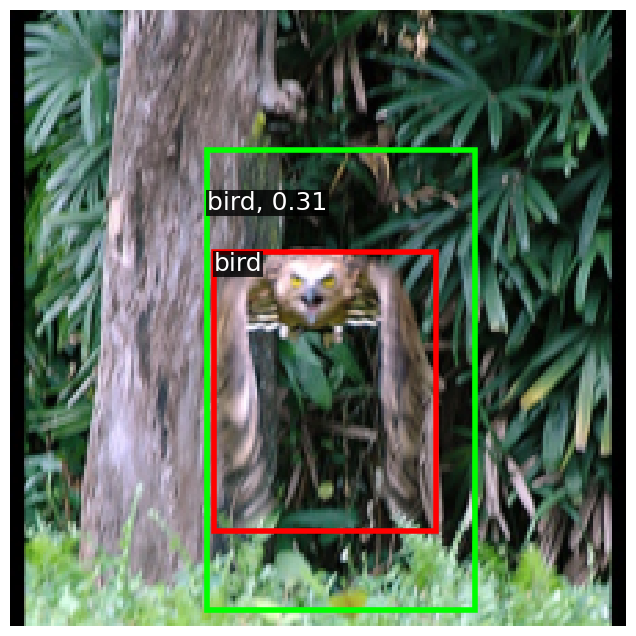

tensor([[7.9626e+01, 0.0000e+00, 1.7030e+02, 4.3658e+01],
        [5.4383e+00, 0.0000e+00, 1.9857e+02, 5.7875e+01],
        [9.9599e+01, 0.0000e+00, 1.4804e+02, 5.6521e+01],
        [5.4560e+01, 1.7312e+02, 1.4623e+02, 2.1988e+02],
        [0.0000e+00, 1.6915e+02, 1.6622e+02, 2.2400e+02],
        [3.8391e+01, 0.0000e+00, 1.3509e+02, 9.3019e+01],
        [7.4800e+01, 6.9765e+01, 1.2622e+02, 1.6236e+02],
        [5.4036e+01, 2.8271e+01, 1.4671e+02, 7.5224e+01],
        [9.3905e+01, 0.0000e+00, 2.1297e+02, 7.5040e+01],
        [5.3922e+01, 1.0070e+02, 1.4802e+02, 1.4807e+02],
        [3.4255e+01, 7.1717e+01, 2.2400e+02, 1.7000e+02],
        [7.4286e+01, 1.4094e+02, 1.2590e+02, 2.2400e+02],
        [0.0000e+00, 0.0000e+00, 8.7184e+01, 9.3685e+01],
        [5.5182e+01, 6.6443e+01, 1.5322e+02, 2.2400e+02],
        [7.7235e+01, 1.5351e+02, 1.9533e+02, 2.2400e+02],
        [2.7441e+01, 1.3346e+02, 1.4831e+02, 2.2400e+02],
        [7.0845e+01, 0.0000e+00, 1.6731e+02, 9.3010e+01],
        [9.079

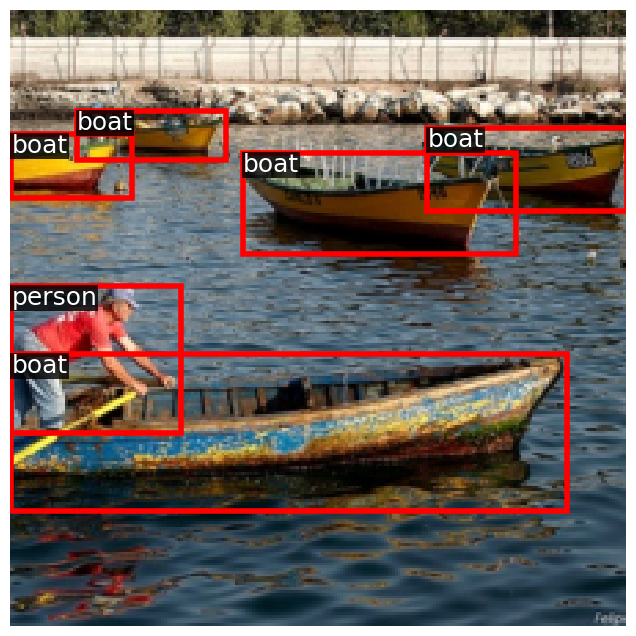

tensor([[102.3613,   0.0000, 199.1597,  93.0968],
        [ 61.8442,   0.0000, 180.4187,  74.6206],
        [114.8784,   5.0015, 165.9164,  97.6932],
        [  0.3680,   0.0000, 202.8924,  91.1238],
        [ 38.6949,   0.0000, 136.8958, 121.9400],
        [ 95.4791,  36.5170, 186.1613,  83.8047],
        [ 34.4677,  13.3505,  84.3175, 107.4538],
        [ 17.2539,  45.0394, 104.7151,  91.3993],
        [ 79.0849, 187.9248, 171.0773, 224.0000],
        [ 32.7325,  23.3558, 224.0000, 122.3723],
        [ 97.8773,  22.4667, 149.6057, 115.0569],
        [ 70.8241,   0.0000, 169.1372, 155.1306],
        [ 25.5072, 168.4715, 214.7428, 224.0000],
        [107.0256, 168.0597, 155.5800, 224.0000],
        [ 17.5458, 116.7964, 105.0578, 163.2728],
        [ 90.3358, 166.2715, 138.8275, 224.0000],
        [ 35.2201,  94.0674,  83.4625, 185.3327],
        [ 10.9836, 133.1785, 134.5092, 224.0000],
        [ 25.0060,  33.5112, 151.3063, 174.8995],
        [ 87.3585,  52.3515, 185.5880, 218.1616],


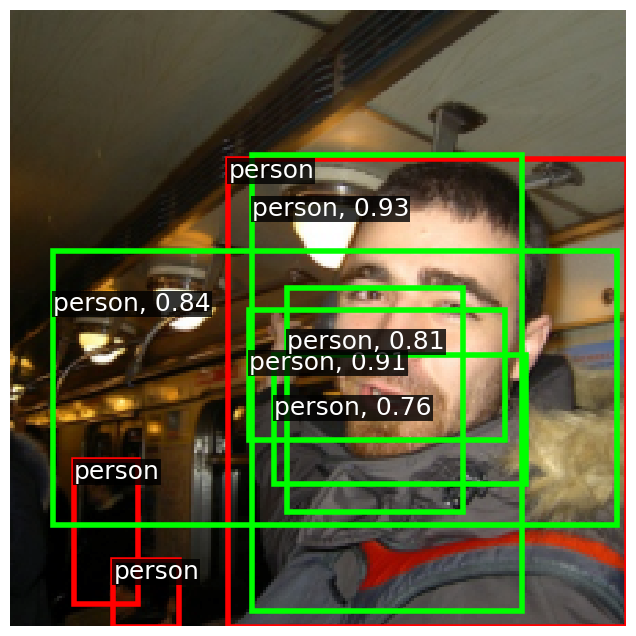

tensor([[  0.0000, 139.4203,  66.0835, 224.0000],
        [  0.0000,   0.0000,  82.8795,  70.5210],
        [  0.0000,   0.0000, 118.1013, 108.1903],
        [ 20.8012,   0.0000, 213.2495,  57.1867],
        [  0.0000, 169.2095, 117.8520, 224.0000],
        [ 44.6553,   0.0000, 168.9941, 109.6522],
        [ 89.8065,   0.0000, 140.3784,  80.6695],
        [140.2937, 117.5928, 224.0000, 224.0000],
        [ 92.7893,   0.0000, 213.6589,  91.6453],
        [ 17.9403,  23.4314, 217.7485, 122.2680],
        [  0.0000,   1.7845,  73.7713, 172.3260],
        [ 41.5203, 168.7288, 224.0000, 224.0000],
        [  6.2447, 100.9166, 105.2012, 224.0000],
        [ 74.2862, 115.9192, 197.8557, 224.0000],
        [148.6748,  20.8307, 224.0000, 189.5458],
        [  0.9440, 103.9686, 202.0771, 202.3155],
        [  0.0000,  57.2985, 120.4232, 154.8157],
        [ 86.7353,  21.3169, 184.9515, 187.5641],
        [ 39.3854,  21.6369, 136.2547, 188.7142],
        [ 64.5204, 164.5591, 153.3778, 210.7303],


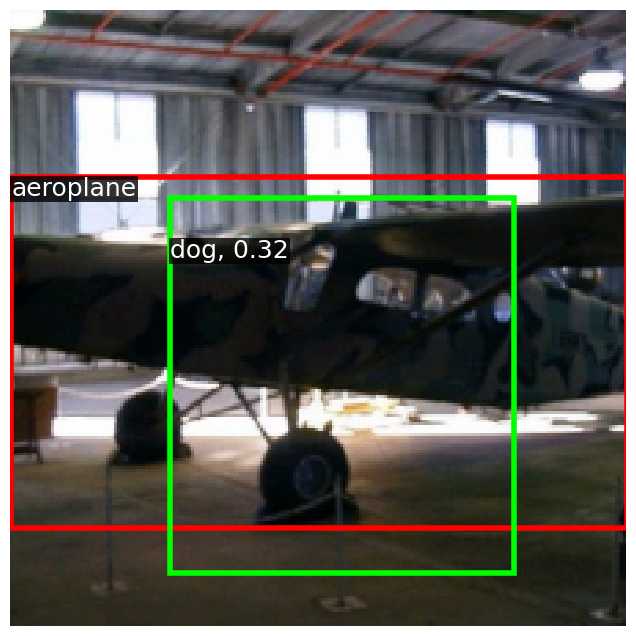

tensor([[  0.0000,   0.0000,  87.5899,  92.3141],
        [102.4606,   0.0000, 200.5526,  94.3811],
        [  0.0000,   0.0000, 205.9094,  91.4647],
        [105.9556,   0.0000, 157.2689,  57.3444],
        [ 86.7682,   0.0000, 179.3529,  43.7565],
        [ 29.6650,   0.0000, 150.1815,  75.6617],
        [ 70.0241,   0.0000, 167.9744,  93.8279],
        [ 85.8965,   0.0000, 185.4174, 152.8374],
        [ 15.2923,  23.4159, 220.1779, 123.3690],
        [ 38.7651,   0.0000, 137.8249, 138.5249],
        [ 83.9396,  68.3643, 179.1218, 115.9929],
        [ 24.6445, 168.7126, 214.5352, 224.0000],
        [ 95.2337,  58.3935, 153.9857, 125.8173],
        [  0.0000,  20.2115, 103.0442, 156.2336],
        [ 69.1752, 164.0374, 163.8236, 212.3287],
        [ 86.5685, 115.6071, 184.1948, 224.0000],
        [101.6104, 128.1485, 162.9728, 201.4041],
        [ 42.3291,  35.3532, 167.0641, 172.2901],
        [ 77.0505, 148.3173, 170.2909, 196.5077],
        [  0.0000,  84.0861,  89.0920, 224.0000],


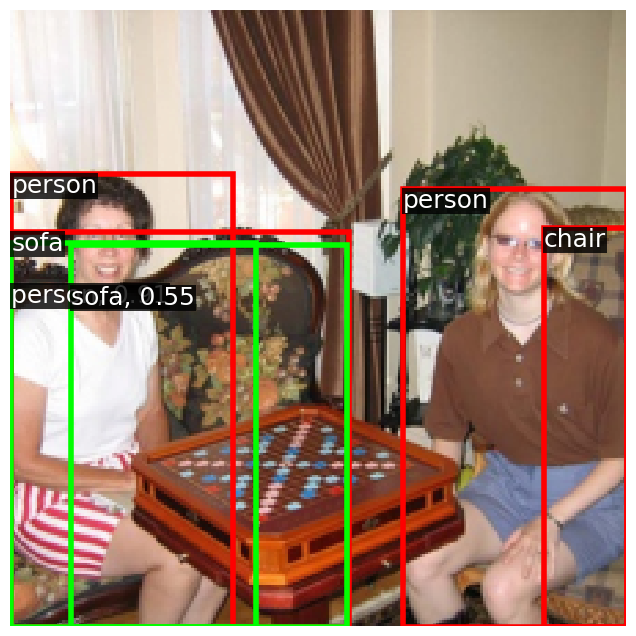

tensor([[ 93.5181,   0.0000, 212.7909,  73.2613],
        [  6.1968,   0.0000, 198.1427,  58.1091],
        [ 94.7755,   0.0000, 154.5372,  52.4099],
        [ 78.4355,  76.7619, 169.9547, 123.5771],
        [ 70.9279,   0.0000, 166.1032,  91.6355],
        [  0.0000,   0.0000,  87.0912,  92.5833],
        [ 76.2804,   0.0000, 172.7255,  36.4902],
        [ 75.1946,  51.0752, 198.7495, 187.5461],
        [103.8104,   0.0000, 199.6747, 138.6079],
        [ 18.2466,   6.7608, 218.1430, 106.0072],
        [ 98.4195,  46.8257, 148.7037, 137.8834],
        [  0.0000, 169.1181, 182.5370, 224.0000],
        [ 16.8963,  55.6731, 217.4659, 154.5364],
        [ 70.8430,  84.8626, 168.8755, 224.0000],
        [ 99.1267, 102.9676, 147.4636, 195.1834],
        [  0.0000,  22.9541, 101.7872, 150.6138],
        [ 54.8741,  20.4171, 153.3826, 187.6504],
        [ 77.6294,  60.5165, 170.0427, 107.5030],
        [ 78.0585, 153.4148, 194.7692, 224.0000],
        [  1.2698,  87.9275, 202.5044, 186.2642],


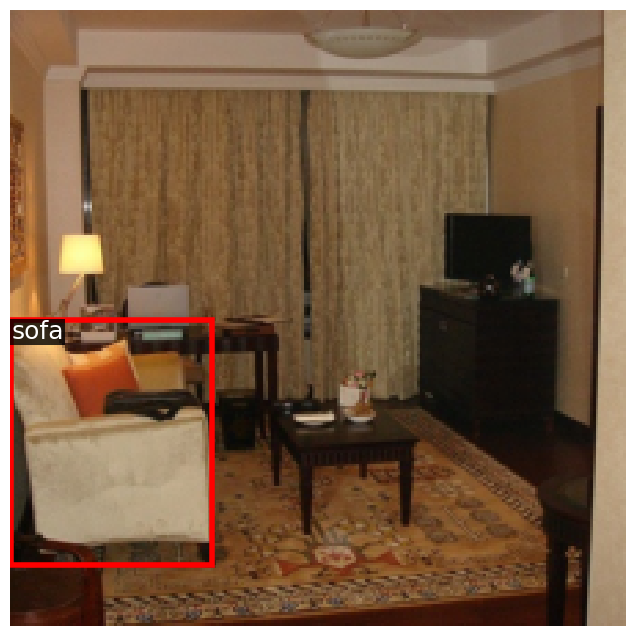

tensor([[  0.0000, 168.5217, 100.6432, 224.0000],
        [  0.0000, 106.3744,  67.3541, 224.0000],
        [ 29.9857,   0.0000, 147.9932,  74.1481],
        [134.2043,  84.3098, 224.0000, 224.0000],
        [ 70.1740,   0.0000, 169.4151, 107.6101],
        [ 93.6271,   0.0000, 211.0849,  72.9149],
        [ 14.5456,   0.0000, 218.4577,  91.5299],
        [ 94.0796,   0.0000, 156.2440,  65.1667],
        [ 76.2288, 133.1159, 198.3041, 224.0000],
        [ 42.2423, 169.4612, 224.0000, 224.0000],
        [  0.0000, 135.8578, 139.7079, 224.0000],
        [149.2568,  20.7750, 224.0000, 187.1487],
        [ 85.2746,   5.3354, 185.4114, 168.6807],
        [ 70.7906, 157.1075, 160.7146, 204.0939],
        [ 78.5627,  55.2266, 224.0000, 154.6492],
        [149.8825,   0.0000, 224.0000, 109.2940],
        [ 97.5205,  54.2255, 149.6199, 140.9923],
        [  0.0000,  38.1180, 203.2200, 139.6685],
        [  0.0000,  37.3270,  88.2047, 204.5418],
        [ 31.5852, 102.7457, 224.0000, 202.2750],


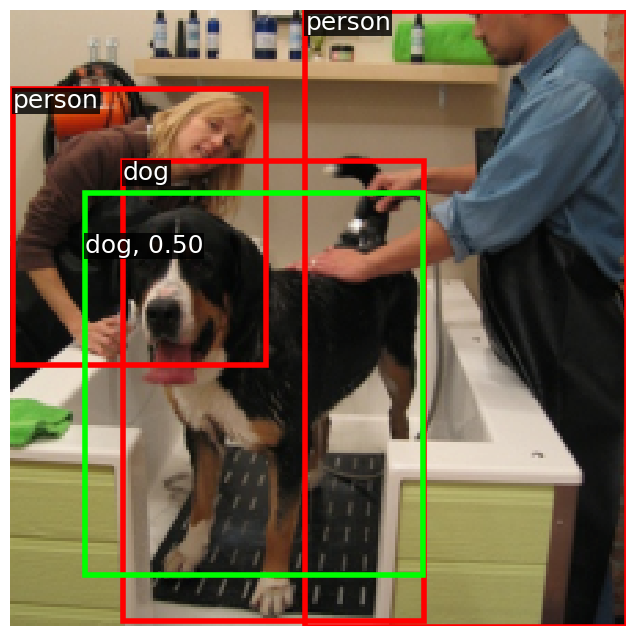

tensor([[0.0000e+00, 1.1482e+02, 7.2642e+01, 2.2400e+02],
        [0.0000e+00, 1.5333e+02, 1.1999e+02, 2.2400e+02],
        [0.0000e+00, 0.0000e+00, 8.3252e+01, 6.9946e+01],
        [0.0000e+00, 3.4533e+01, 7.3659e+01, 2.0474e+02],
        [9.4430e+01, 0.0000e+00, 2.1123e+02, 7.3012e+01],
        [7.1602e-02, 0.0000e+00, 2.0194e+02, 7.4929e+01],
        [5.8360e+00, 0.0000e+00, 1.0536e+02, 1.0839e+02],
        [2.4496e+01, 1.6867e+02, 2.1447e+02, 2.2400e+02],
        [5.4359e+01, 0.0000e+00, 1.5198e+02, 9.2216e+01],
        [1.4145e+02, 0.0000e+00, 2.2400e+02, 9.0424e+01],
        [8.6361e+01, 0.0000e+00, 1.8564e+02, 1.2364e+02],
        [0.0000e+00, 8.8965e+01, 1.2035e+02, 1.8712e+02],
        [7.4003e+01, 9.9649e+01, 1.9890e+02, 2.2400e+02],
        [0.0000e+00, 1.1917e+02, 1.8656e+02, 2.1810e+02],
        [1.6100e+01, 2.3535e+01, 2.1833e+02, 1.2260e+02],
        [0.0000e+00, 4.0297e+01, 1.3786e+02, 1.3851e+02],
        [1.0637e+02, 1.7695e+01, 2.2400e+02, 1.5886e+02],
        [1.339

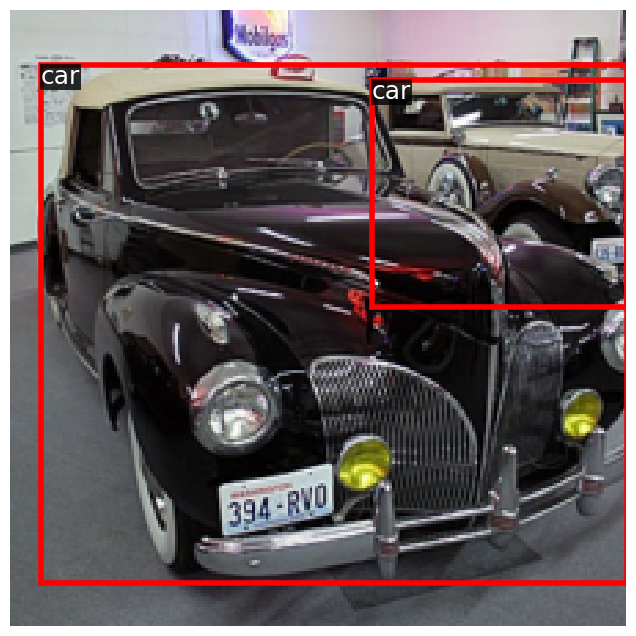

tensor([[  0.0000,   0.0000,  72.6030, 109.0099],
        [162.1045,   0.0000, 224.0000, 129.7852],
        [149.7259, 101.5023, 224.0000, 224.0000],
        [101.9568, 152.3726, 224.0000, 224.0000],
        [  0.0000, 138.7804,  66.5117, 224.0000],
        [  0.0000,  19.5028,  72.8014, 187.0893],
        [  0.0000,   0.0000, 181.4965,  57.6379],
        [  0.0000, 169.4260, 134.7997, 224.0000],
        [ 87.0713,  34.6551, 184.8508, 201.1595],
        [ 32.7755,  38.7044, 224.0000, 139.1733],
        [111.6929,  60.5906, 166.6626, 150.6061],
        [103.3739,   0.0000, 200.9249, 123.4536],
        [  6.4683,  84.4831, 104.3408, 224.0000],
        [ 85.7197, 163.6937, 178.0465, 211.2236],
        [ 17.1434,  86.3650, 218.2458, 186.2401],
        [105.9811, 134.2879, 157.3152, 223.1479],
        [  0.0000,   7.6622, 139.0017, 106.9797],
        [109.7781,   0.6513, 171.5225,  72.6512],
        [ 71.0881,  85.7083, 169.4093, 224.0000],
        [ 26.9348, 115.8315, 150.9343, 224.0000],


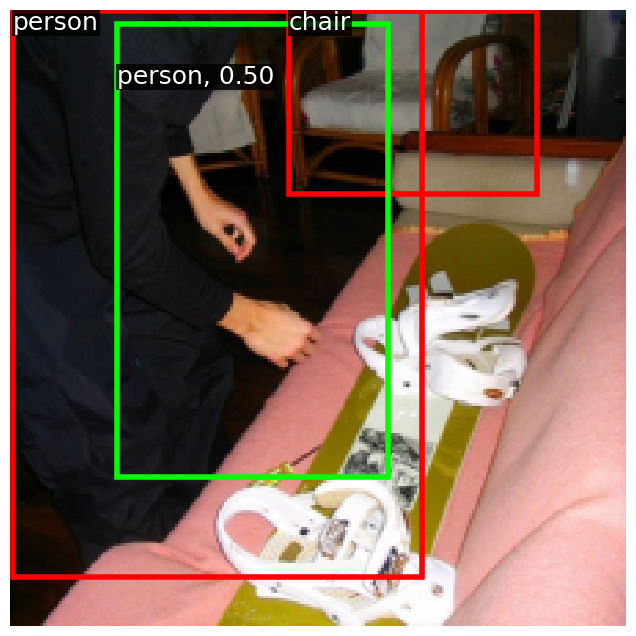

tensor([[ 90.8634,   0.0000, 139.6739,  91.9519],
        [ 37.2470,   0.0000, 224.0000,  57.5842],
        [ 60.9032,   0.0000, 181.8311,  89.9891],
        [ 80.8549,  29.2961, 167.7567,  75.4471],
        [102.2870,   7.3862, 163.6956,  80.9958],
        [  0.0000,  36.1640,  88.0683, 204.9818],
        [ 16.9160,   7.4906, 218.7449, 106.2053],
        [ 28.3315,  20.7847, 149.5703, 152.9606],
        [  0.0000, 135.3973, 100.2875, 224.0000],
        [102.4176,   0.0000, 201.4540, 123.1436],
        [ 71.3092,   4.2884, 168.6236, 170.0145],
        [ 71.3680, 180.8187, 160.4253, 224.0000],
        [ 23.1308,  84.5581, 121.0972, 224.0000],
        [  7.3251,   0.0000, 104.9847, 121.7248],
        [  9.0332, 168.8808, 197.9111, 224.0000],
        [ 92.5988,  80.3119, 138.1549, 167.8857],
        [ 90.7954, 151.2219, 139.5680, 224.0000],
        [ 96.4471,  85.6060, 154.1517, 144.2605],
        [ 56.0353,  84.7823, 152.7547, 224.0000],
        [ 34.4413,  71.4964, 224.0000, 171.0862],


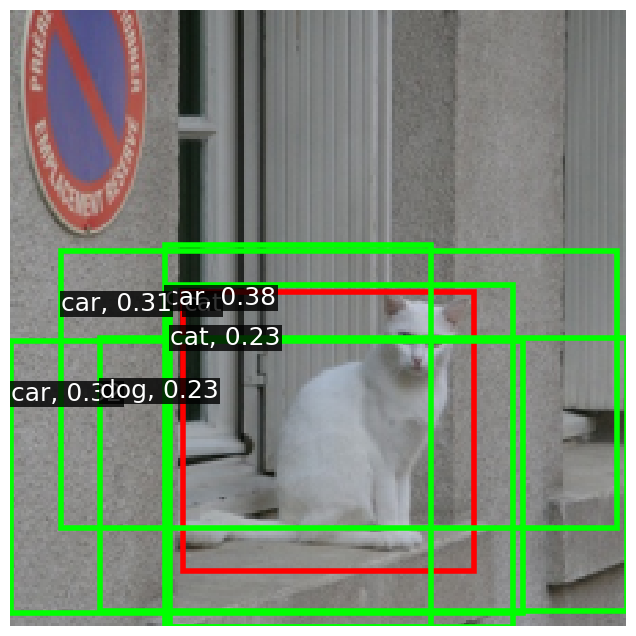

tensor([[ 76.8423, 152.3127, 195.2475, 224.0000],
        [  4.3233,   0.0000, 197.1155,  57.9775],
        [  0.0000,   0.0000,  99.8371,  71.7904],
        [ 93.8743,   0.0000, 212.9666,  74.2927],
        [  0.0000, 169.0911, 134.1058, 224.0000],
        [ 27.2774,   0.0000, 150.8256,  92.1836],
        [133.7048, 116.5947, 224.0000, 224.0000],
        [ 15.3661, 135.1934, 219.2984, 224.0000],
        [  0.0000, 118.8303,  85.7441, 224.0000],
        [  0.0000,   0.0000,  73.2004, 139.9806],
        [ 70.3231, 101.6971, 169.4702, 224.0000],
        [ 58.4327,   0.0000, 182.9119, 124.0529],
        [  0.0000,  35.2309,  89.0138, 202.0401],
        [ 80.9924,  87.6796, 224.0000, 185.3742],
        [  0.0000,  88.2780, 138.1201, 187.1644],
        [ 86.5676,  37.2098, 185.7958, 204.9200],
        [ 18.3475,  39.0087, 217.7910, 138.5781],
        [ 38.4311,  52.5590, 135.2759, 216.4924],
        [ 24.7179,  34.8036, 152.5704, 171.6737],
        [ 39.0969,  19.8536, 136.6138, 185.1793]],

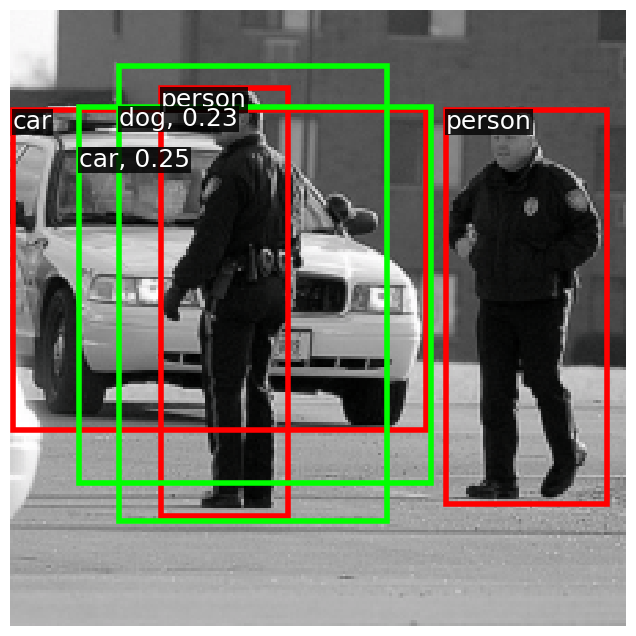

tensor([[ 25.4069, 169.3428, 214.6354, 224.0000],
        [ 28.2811, 133.6382, 148.7909, 224.0000],
        [  0.0000,   0.0000,  84.9774,  87.5934],
        [  0.0000,  17.9336,  73.9037, 188.4663],
        [108.3177, 132.9922, 224.0000, 224.0000],
        [  0.0000, 168.8988, 101.0151, 224.0000],
        [ 86.7427, 115.8185, 184.7216, 224.0000],
        [ 15.6726, 119.4283, 218.5779, 217.7513],
        [  0.0000,  97.7403, 119.2530, 224.0000],
        [  0.0000,  72.8919, 121.0552, 171.2019],
        [  0.0000, 111.8188,  57.3274, 224.0000],
        [107.5427,  49.2596, 224.0000, 189.9288],
        [ 22.1253,   0.0000, 119.5369,  93.2039],
        [ 20.3881,   0.0000, 213.4436,  57.3698],
        [  0.0000,  87.0476, 189.0511, 186.9800],
        [123.3698,   0.0000, 224.0000, 109.1645],
        [ 37.2846,  37.5772, 138.8672, 202.7073],
        [ 86.7910,   0.0000, 183.5435,  92.9773],
        [ 12.9619,  55.6579, 221.3344, 155.2276],
        [  0.0000,  40.2128, 155.1495, 139.2746],


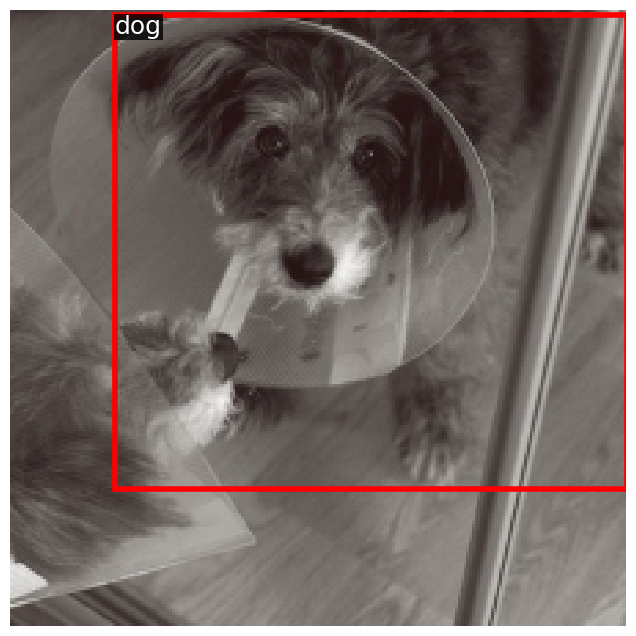

tensor([[  0.0000, 169.1273, 117.8603, 224.0000],
        [ 29.4410, 152.5329, 147.6210, 224.0000],
        [ 94.6249,   0.0000, 211.7457,  74.2736],
        [ 73.1522, 169.1351, 224.0000, 224.0000],
        [ 15.5710, 134.8675, 219.0728, 224.0000],
        [ 87.1248, 130.3734, 183.3760, 224.0000],
        [  5.8270,  99.8244, 105.2677, 224.0000],
        [125.1693, 116.5157, 224.0000, 224.0000],
        [ 16.8843,   0.0000, 218.1884,  90.0321],
        [  0.0000,   2.9636,  73.7221, 171.7649],
        [ 30.0841,   0.0000, 147.7549,  73.3823],
        [  0.0000,  80.4584,  57.1949, 224.0000],
        [  0.0000,   0.0000,  84.6225,  87.3187],
        [124.9185,   0.0000, 224.0000, 123.1524],
        [ 37.6200,  83.9728, 137.5142, 224.0000],
        [ 58.9865,   0.0000, 181.9878, 123.0026],
        [ 39.4640,   0.0000, 136.1053, 154.7448],
        [ 71.4432,  51.2458, 168.7435, 217.5160],
        [  0.0000,  40.1320, 139.1093, 138.9165],
        [ 80.4746,  87.7742, 224.0000, 185.2390],


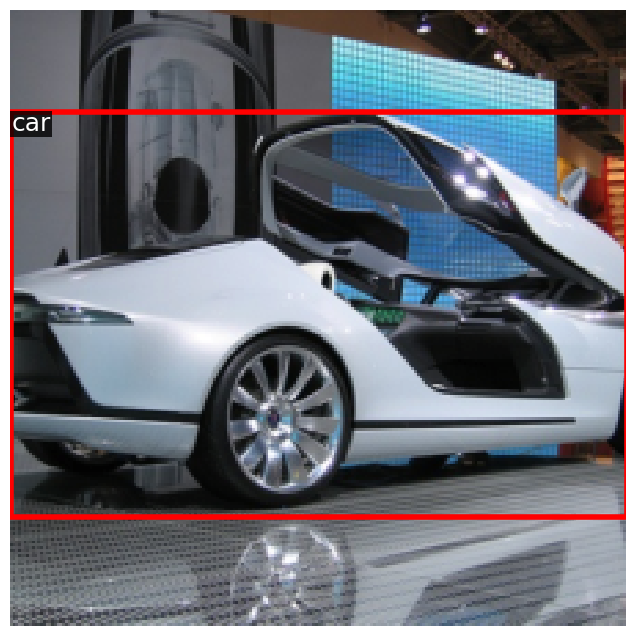

tensor([[ 29.3448, 153.4435, 146.3418, 224.0000],
        [  0.0000, 114.7945,  88.3752, 224.0000],
        [  0.0000,   0.0000,  71.6823,  94.0525],
        [  4.5229,   0.0000, 198.0349,  57.9328],
        [ 32.1674, 134.9307, 224.0000, 224.0000],
        [  0.0000,  34.6392,  74.2187, 205.8672],
        [  0.0000,   7.7801, 139.7711, 106.6303],
        [134.5905, 115.6837, 224.0000, 224.0000],
        [ 23.4184,  84.1703, 121.5168, 224.0000],
        [ 54.1815,   0.0000, 151.4083,  92.9813],
        [ 87.0575, 114.3763, 184.5364, 224.0000],
        [102.9373,   0.0000, 199.3086,  93.0757],
        [  0.0000,  55.9896, 138.7086, 154.7558],
        [ 40.2677,  21.0501, 137.1206, 188.7384],
        [  0.6595,  86.5795, 203.1733, 186.5769],
        [ 58.8821,   2.6362, 181.9517, 141.3450],
        [123.6761,  51.5355, 224.0000, 188.9285],
        [ 86.5271,  36.9776, 185.7501, 204.4207],
        [ 15.1598,  39.5862, 218.4230, 138.4081],
        [ 58.0122,  34.1708, 182.0425, 172.7728]],

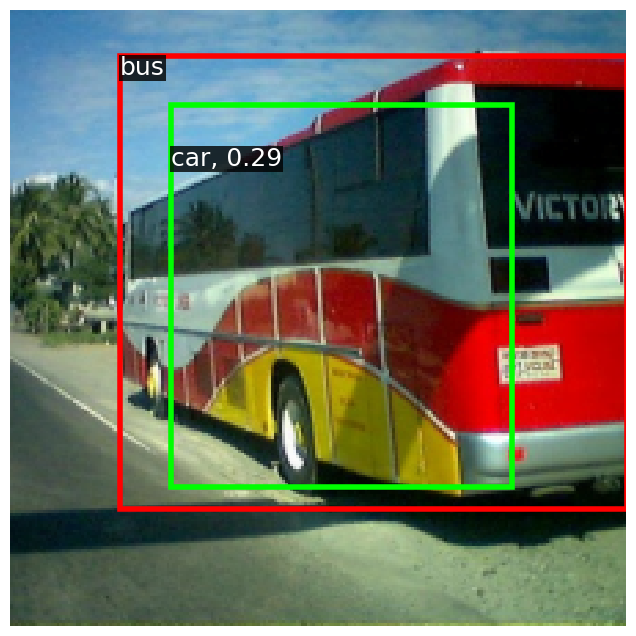

tensor([[ 25.3935, 169.0598, 213.9086, 224.0000],
        [ 70.8662,  67.6326, 168.7751, 224.0000],
        [ 76.9600, 133.5969, 196.3842, 224.0000],
        [ 31.7166,  88.2465, 224.0000, 186.1862],
        [119.3989,   0.0000, 224.0000,  71.8249],
        [164.2582,   0.0000, 224.0000,  96.1660],
        [  0.0000,   0.0000,  82.7303,  70.4629],
        [  0.0000,  71.2693, 139.0630, 169.8965],
        [ 16.7764, 119.4465, 217.4662, 217.4675],
        [ 38.4447, 101.7139, 136.4163, 224.0000],
        [  0.0000,  68.0218,  89.0371, 224.0000],
        [ 20.4016,   0.0000, 213.6859,  57.8158],
        [ 86.2726,   0.0000, 183.4947,  93.1986],
        [  0.0000,   0.0000,  72.9068, 139.5222],
        [ 12.2860,   0.0000, 134.3082,  90.6048],
        [  0.0000, 152.9074, 120.1082, 224.0000],
        [ 32.8538,   8.1359, 224.0000, 106.1786],
        [ 59.9372,  35.9523, 181.2444, 170.4558],
        [ 38.8001,  21.2509, 137.2973, 189.0572],
        [  0.0000, 111.6013,  56.6462, 224.0000],


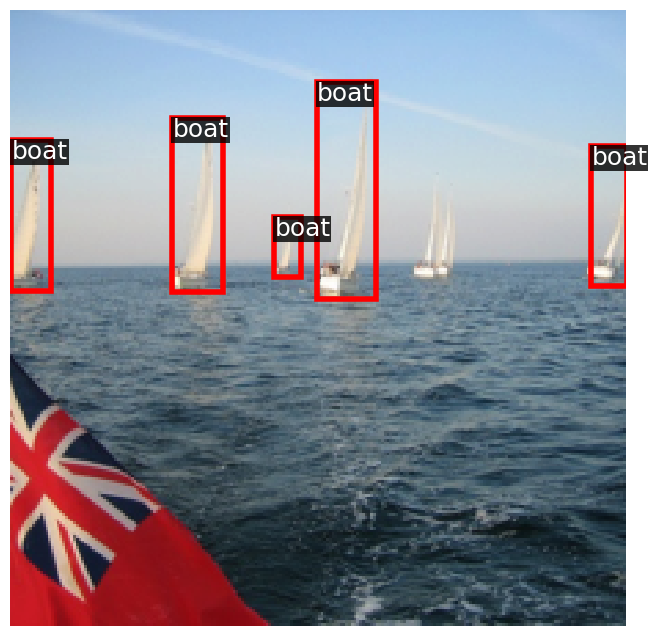

tensor([[ 27.3497,   0.0000, 150.4914, 123.7368],
        [  0.0000,   0.0000, 101.6075, 122.5406],
        [  0.0000, 137.5476,  83.4955, 224.0000],
        [ 11.2512, 116.4377, 134.4659, 224.0000],
        [  0.0000, 168.8228, 182.6484, 224.0000],
        [ 85.3166,   0.0000, 184.8971, 107.3275],
        [ 17.4371, 103.1006, 218.0671, 201.8616],
        [ 39.0055,  20.7668, 136.7311, 187.9922],
        [  4.9260,   0.0000, 197.4342,  58.0941],
        [ 87.6997, 129.6093, 183.7980, 224.0000],
        [134.4739,   0.0000, 224.0000,  93.2393],
        [  0.0000,  56.2655, 137.9607, 154.0424],
        [ 16.6661,  39.9605, 218.2918, 137.9330],
        [ 58.0203,  67.8723, 180.9047, 204.9079],
        [  0.0000,  35.5336,  88.3409, 203.1485],
        [ 75.6366,  20.5882, 197.4503, 155.8288],
        [  0.0000,  64.3529,  57.0776, 224.0000],
        [124.1445,  19.7891, 224.0000, 156.2810]], device='cuda:0') tensor([-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1],
 

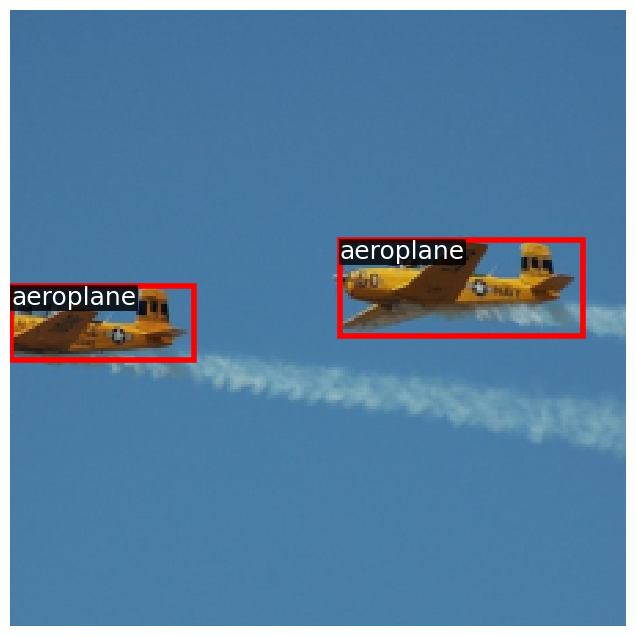

tensor([[ 90.3648,   0.0000, 141.2181,  71.4786],
        [ 45.4373,   0.0000, 165.5117,  75.8082],
        [ 77.1284,   3.6800, 169.2683,  51.5066],
        [ 94.4805,   0.0000, 212.1330,  72.1622],
        [  0.0000,   6.9104, 188.7391, 107.0940],
        [  0.0000,   0.0000,  87.2029,  92.4803],
        [ 86.7344,   0.0000, 183.2301, 139.5187],
        [  8.9901, 168.2978, 198.7586, 224.0000],
        [ 38.7752,   0.0000, 137.0980, 153.0727],
        [ 69.0741,  83.9805, 162.4001, 131.4226],
        [  0.0000,  40.6273, 120.7757, 138.2608],
        [  0.0000,   3.5312,  89.8400, 171.7070],
        [ 58.3482, 133.1189, 184.3600, 224.0000],
        [ 35.7927,  71.6914, 224.0000, 171.1033],
        [  0.0000, 133.8748, 101.5999, 224.0000],
        [ 34.4503,  38.5455, 224.0000, 138.4502],
        [  0.0000,  66.8810,  73.2610, 224.0000],
        [ 70.6254, 156.3085, 163.6711, 204.2051],
        [ 90.7683,  55.6563, 139.5306, 141.9526],
        [ 11.6509,  99.7379, 136.8978, 224.0000],


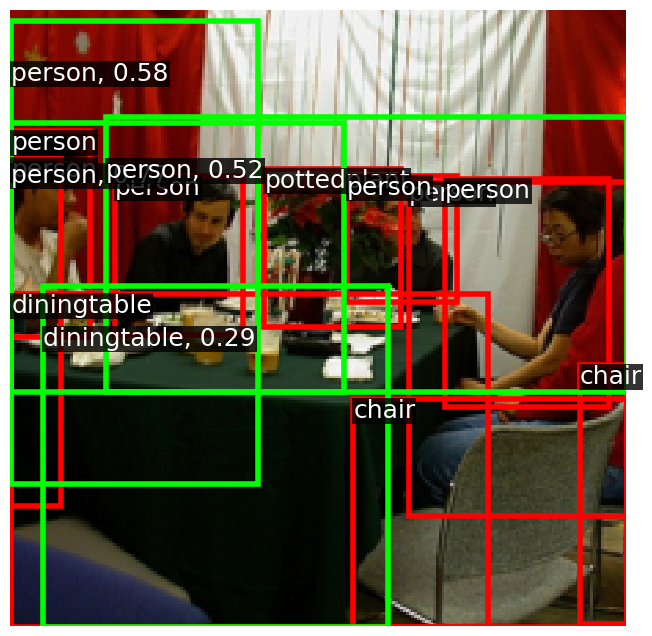

tensor([[ 91.6491,   0.0000, 215.3528, 106.9821],
        [ 21.0598,   0.0000, 213.6552,  57.1719],
        [  0.0000,   0.0000,  88.5950, 108.0819],
        [ 71.0993,   0.0000, 169.0521, 138.0401],
        [ 22.3012,   0.0000, 119.4205,  93.1046],
        [ 54.8160,   0.0000, 151.7159,  93.0425],
        [  0.6058,  23.9152, 202.3760, 123.0634],
        [  0.0000, 169.1995, 134.3700, 224.0000],
        [ 59.0426,  35.1733, 182.5110, 171.1462],
        [ 39.6263,  20.5181, 137.3660, 188.1679],
        [  0.0000, 115.5236,  87.9963, 224.0000],
        [ 55.0307, 100.5727, 153.2290, 224.0000],
        [ 33.0529,  87.6523, 224.0000, 186.4381],
        [ 22.6728,  83.6502, 121.2846, 224.0000],
        [140.7373, 135.7059, 224.0000, 224.0000],
        [  6.6104,  19.3690, 105.4298, 187.3770],
        [  0.0000,  71.9450, 154.7747, 170.0697],
        [ 16.4241, 119.6597, 217.5223, 218.8632],
        [ 78.0823, 154.1665, 194.4800, 224.0000],
        [107.3435, 151.0422, 155.0183, 224.0000]],

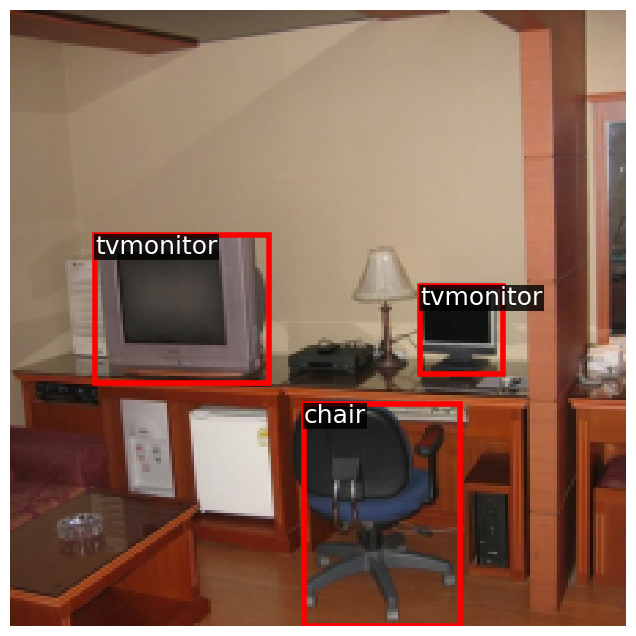

tensor([[ 81.4836, 142.0046, 131.5456, 224.0000],
        [ 29.4977, 153.3534, 145.6942, 224.0000],
        [ 94.7795,   0.0000, 211.2342,  72.4671],
        [ 65.1314, 164.7361, 152.4182, 210.9122],
        [  0.0000, 112.2850,  72.8366, 224.0000],
        [ 76.0660, 132.3977, 196.2702, 224.0000],
        [123.6172, 117.4375, 224.0000, 224.0000],
        [ 59.3540,   0.0000, 181.7552, 106.6261],
        [ 91.4368,   0.0000, 138.3271,  91.2258],
        [  0.0000,   0.0000, 101.7197, 123.6604],
        [  0.0000,   0.0000,  85.8034,  72.6951],
        [ 74.9022,  29.2060, 159.8934,  74.9800],
        [ 76.2953,  13.5812, 158.9106,  59.2330],
        [  0.0000, 119.3063, 187.9700, 218.6987],
        [  0.0000,  20.0797,  87.9270, 187.7997],
        [ 15.7064,  23.4580, 217.3617, 122.4778],
        [134.1485,  36.3435, 224.0000, 207.3297],
        [ 55.1664,  99.5110, 154.3205, 224.0000],
        [ 72.7110,  18.8708, 198.9039, 158.5120],
        [  0.0000,  73.2398, 138.8498, 170.4019],


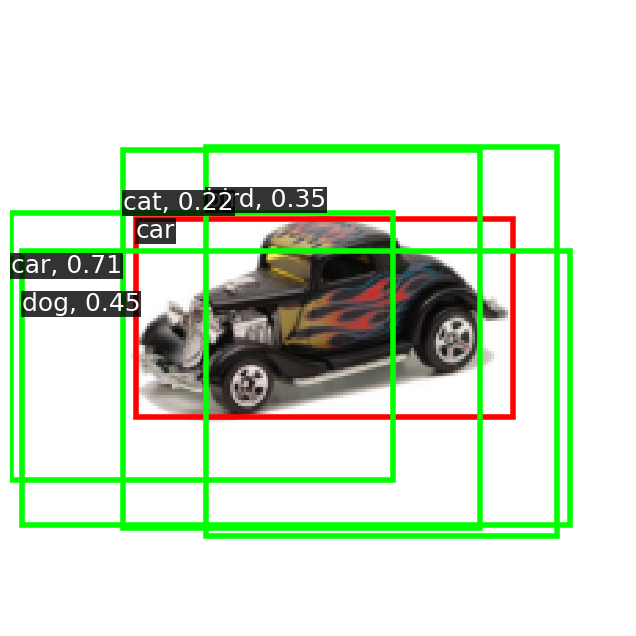

tensor([[  0.0000,   0.0000,  87.4435,  93.5376],
        [ 89.5107,   0.0000, 216.7097, 127.4101],
        [148.8902,   0.0000, 224.0000, 124.5506],
        [ 70.9769,   3.2044, 170.6661, 169.8928],
        [  0.0000,  39.5911, 204.6926, 139.4048],
        [ 27.2027,  34.8359, 151.4423, 174.0335],
        [ 27.1543,   0.0000, 152.1519, 110.7185],
        [  3.7128,   0.0000, 197.7931,  58.2762],
        [ 79.6565,  55.0409, 224.0000, 154.5444],
        [  0.0000,  19.9733, 102.8214, 156.1465],
        [ 76.1879, 152.9549, 194.5865, 224.0000],
        [ 55.0704, 115.3773, 153.3504, 224.0000],
        [ 14.4313, 135.7517, 221.1277, 224.0000],
        [134.3838,  35.9907, 224.0000, 202.8604],
        [ 86.0075,  84.2037, 186.0579, 224.0000],
        [100.5546, 119.7966, 224.0000, 216.5316],
        [  0.0000,  87.9491, 138.0589, 186.3892],
        [  0.0000, 169.0731, 134.1324, 224.0000],
        [  0.0000, 139.6258,  65.5912, 224.0000],
        [  0.0000, 115.6232,  88.1345, 224.0000]],

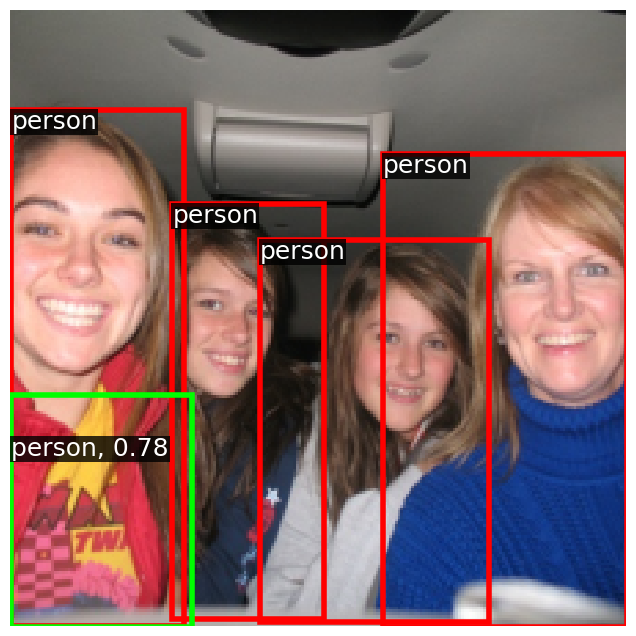

tensor([[  9.0179, 169.1493, 198.7316, 224.0000],
        [  0.0000,   0.0000,  83.0148,  70.2412],
        [ 71.9097, 129.7873, 167.6630, 224.0000],
        [  0.0000, 135.4102, 153.9606, 224.0000],
        [ 81.8330, 120.0351, 224.0000, 218.2890],
        [  4.2112,   0.0000, 197.3865,  57.4885],
        [150.6361,   0.0000, 224.0000,  93.7588],
        [  0.0000,  83.5385,  88.5336, 224.0000],
        [  0.0000,   2.2995,  73.5765, 172.0914],
        [ 54.4805,   0.0000, 151.7993,  93.2923],
        [  0.0000,   8.0959, 138.1807, 106.5107],
        [ 43.1997,  83.2957, 165.5804, 219.3459],
        [  0.0000,  72.1627, 120.7076, 170.5892],
        [  0.0000,  87.1009, 200.9876, 185.9259],
        [ 86.4122,  37.5597, 184.9896, 205.8864],
        [ 75.8782,   0.0000, 199.2018, 108.2250],
        [140.9406,  21.8761, 224.0000, 153.0893],
        [ 39.7665,  20.1477, 136.7057, 187.5591],
        [ 16.1493,  55.1544, 216.5595, 153.9526],
        [ 31.1302,  23.6504, 224.0000, 122.0420]],

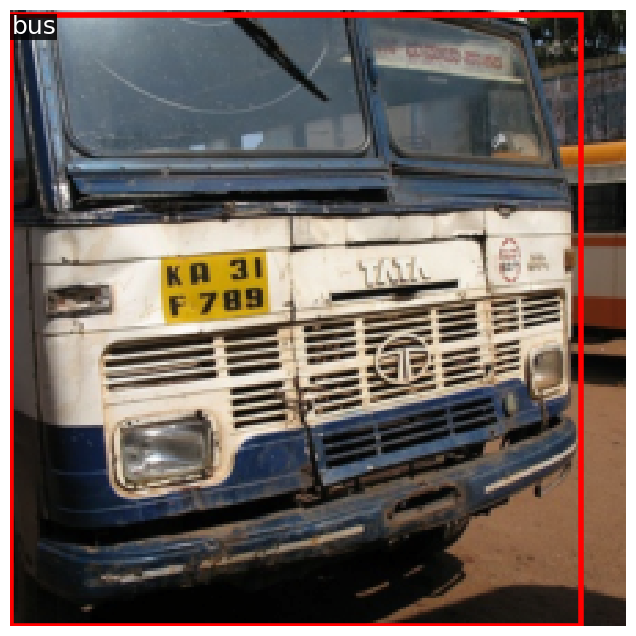

tensor([[  6.5016,   0.0000, 105.2155, 122.7817],
        [  0.0000,   1.8372,  73.2946, 171.3118],
        [ 79.9946,  92.2872, 169.6053, 139.0188],
        [  3.9833,   0.0000, 197.8175,  57.6327],
        [ 93.8089,   0.0000, 211.6150,  73.5562],
        [ 98.8105,  63.4102, 146.8516, 151.8596],
        [  0.0000,  55.6047, 203.0643, 155.4419],
        [ 26.0339,  17.8029, 152.5404, 159.1700],
        [ 93.8783,   0.0000, 156.1496,  63.8431],
        [ 86.7657,  20.3849, 183.7432, 184.0403],
        [103.3322,   0.0000, 200.3213, 139.0527],
        [ 44.5185,   0.0000, 166.1074,  91.6206],
        [ 48.8475,  23.5773, 224.0000, 122.7230],
        [  0.0000, 169.3476, 133.9516, 224.0000],
        [  0.0000, 114.0316,  72.4177, 224.0000],
        [ 16.9429,  87.4891, 218.0934, 186.5846],
        [ 78.1780, 153.5619, 194.6610, 224.0000],
        [ 43.1788,  67.0442, 166.2242, 202.8563],
        [ 80.7996, 165.1029, 167.3487, 211.2533],
        [  0.7098, 135.9565, 203.0030, 224.0000],


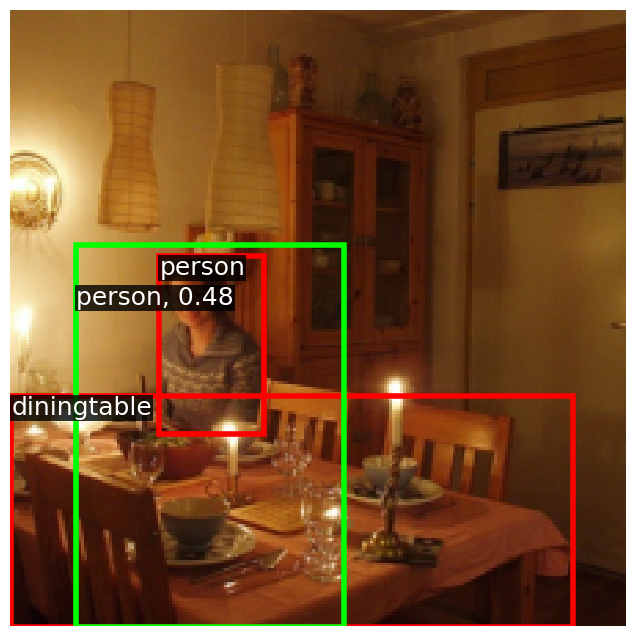

tensor([[  0.0000, 169.1620, 100.6299, 224.0000],
        [  0.0000, 139.1019,  66.6366, 224.0000],
        [  5.4537,   0.0000, 197.3263,  57.6178],
        [  0.0000, 103.7933, 187.0294, 202.7132],
        [ 74.0917,  98.2612, 198.2842, 224.0000],
        [133.6881,   0.0000, 224.0000, 109.4143],
        [ 41.4614, 168.9616, 224.0000, 224.0000],
        [ 93.4975,   0.0000, 211.6940,  74.3613],
        [ 42.6029,   0.0000, 167.7877,  93.8292],
        [ 43.2323, 132.6417, 165.7024, 224.0000],
        [102.4766,   0.0000, 201.1090, 138.9304],
        [  0.0000, 121.2291, 120.4780, 219.6518],
        [106.1118,  34.2648, 224.0000, 173.2611],
        [ 47.5768,  23.5021, 224.0000, 122.8638],
        [  0.0000,   0.0000, 119.9779,  91.1791],
        [ 32.6709,  70.8613, 224.0000, 170.3068],
        [ 69.7203,  35.6082, 168.8688, 202.1380],
        [  0.0000,  69.5457,  87.5133, 202.7150],
        [  0.0000,  56.9174, 122.0006, 156.1032],
        [ 37.3347,   6.0162, 137.5660, 171.0124]],

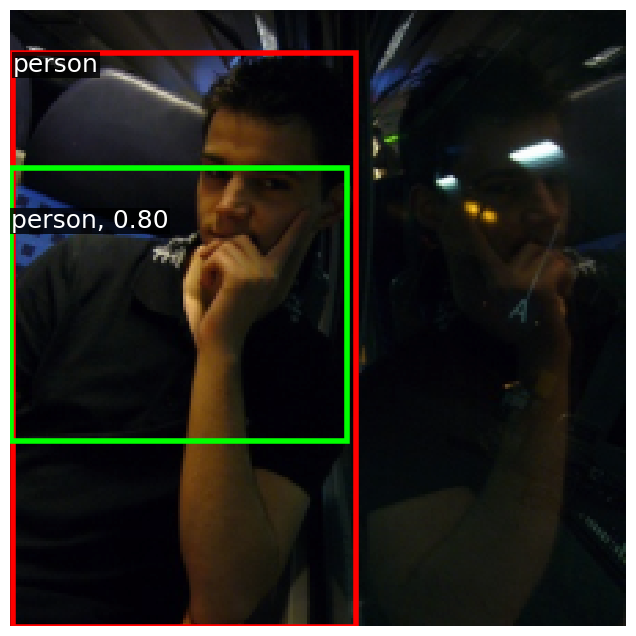

tensor([[ 44.1760,   0.0000, 166.5273,  94.0821],
        [  0.0000,   8.4919, 138.6486, 106.5020],
        [ 60.1016, 152.4895, 178.5002, 224.0000],
        [  0.0000,   0.0000, 181.6469,  57.7914],
        [  0.0000, 116.3215,  87.7516, 224.0000],
        [  0.0000, 168.6770, 165.9259, 224.0000],
        [ 93.1115,   0.0000, 214.0843,  91.9157],
        [  0.0000, 118.8083, 204.3623, 219.5058],
        [  0.0000,   0.0000,  71.3293,  94.0576],
        [  0.0000,   4.0261,  89.0077, 172.5457],
        [ 39.0485,  99.7119, 138.3450, 224.0000],
        [133.7520,   0.0000, 224.0000, 122.3796],
        [ 30.2448,  22.6150, 224.0000, 122.1917],
        [  0.0000,  67.2417, 119.6751, 204.8631],
        [ 38.7429,   4.8703, 137.5776, 171.9075],
        [133.2503, 100.5093, 224.0000, 224.0000],
        [ 85.4955,  68.8541, 186.0490, 224.0000],
        [ 13.5378,  85.9009, 219.7775, 186.5605],
        [ 57.2376,  33.8419, 183.6839, 175.3500],
        [ 80.6616,  55.8184, 224.0000, 153.4314]],

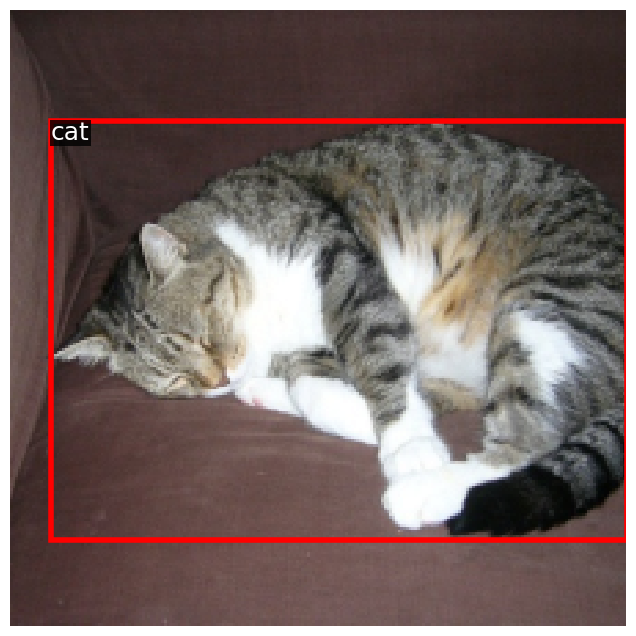

tensor([[  9.9880, 168.8570, 198.9545, 224.0000],
        [ 59.2831, 115.4354, 181.5777, 224.0000],
        [  0.0000, 153.3678, 101.8477, 224.0000],
        [ 38.5684,  85.1722, 137.7583, 224.0000],
        [  0.0000,   0.0000, 182.0434,  57.9442],
        [ 43.6833,   0.0000, 166.9845,  95.0310],
        [ 78.2092,   0.0000, 196.4506,  74.9194],
        [  0.0000,  87.7545, 203.0191, 186.4718],
        [  0.0000,   0.0000,  83.2510,  71.0252],
        [ 42.9375,  50.1517, 166.4262, 189.1815],
        [ 86.0133,  35.7807, 185.2550, 203.6398],
        [ 37.9748,   0.0000, 137.4944, 154.4364],
        [  0.0000,  23.3761, 186.8521, 122.2145],
        [  0.0000, 111.7746,  56.9969, 224.0000],
        [102.5954,   0.0000, 201.7073, 138.6674],
        [  0.0000,  72.5913, 121.0524, 170.8330],
        [  0.0000,   0.0000,  73.1499, 140.4267],
        [140.8428,  21.9062, 224.0000, 153.0139]], device='cuda:0') tensor([-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1],
 

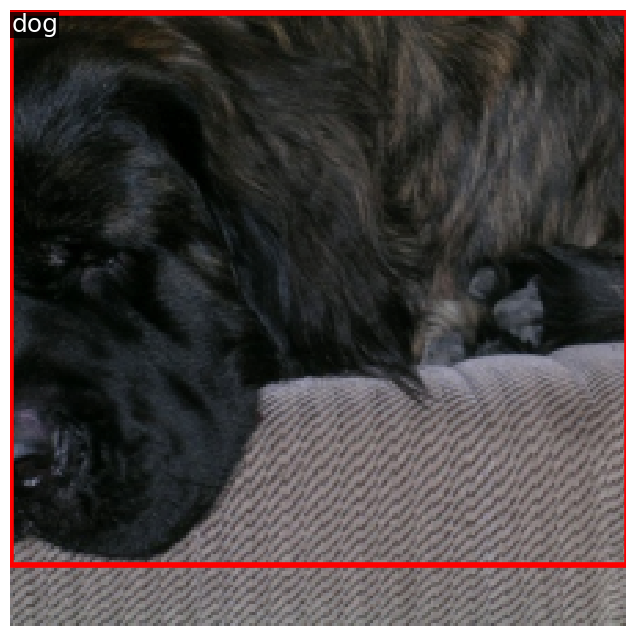

tensor([[ 36.1790,   0.0000, 224.0000,  57.7957],
        [ 25.7728, 168.7580, 214.6060, 224.0000],
        [  0.0000,   0.0000,  71.4205,  93.7516],
        [  0.0000, 153.7469, 101.5851, 224.0000],
        [ 30.7549,   0.0000, 148.0392,  72.9072],
        [ 71.0771,   0.0000, 167.5328,  92.7036],
        [  0.0000, 135.4664, 171.5243, 224.0000],
        [  0.0000,   0.0000, 118.7322, 124.6651],
        [ 74.3647, 132.7926, 198.0212, 224.0000],
        [125.0737, 134.2522, 224.0000, 224.0000],
        [  0.0000,  82.4022,  73.0407, 224.0000],
        [ 39.4578,   3.0411, 137.7558, 169.5085],
        [ 39.3471, 100.2234, 137.9290, 224.0000],
        [ 14.9735,   7.4086, 218.8866, 107.3116],
        [  6.3828,  20.2060, 105.6091, 187.1846],
        [140.7684,   0.0000, 224.0000, 121.4118],
        [  0.0000,  56.1912, 138.7789, 154.4789],
        [ 74.2799,   1.9398, 198.7030, 141.8311],
        [  0.4473, 103.1499, 202.9228, 202.9734],
        [ 71.4646,  37.0333, 168.6457, 202.8749],


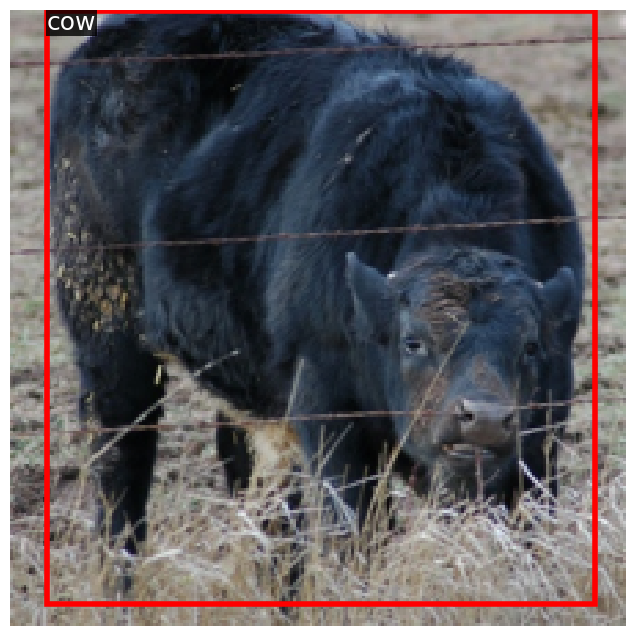

tensor([[0.0000e+00, 1.1641e+02, 8.7834e+01, 2.2400e+02],
        [0.0000e+00, 6.7041e+01, 1.0230e+02, 2.0371e+02],
        [6.3596e+01, 1.8852e+02, 1.5444e+02, 2.2400e+02],
        [0.0000e+00, 1.6921e+02, 1.3422e+02, 2.2400e+02],
        [8.5834e+01, 4.0549e-01, 1.4647e+02, 7.2426e+01],
        [0.0000e+00, 0.0000e+00, 8.5121e+01, 8.7201e+01],
        [7.0657e+01, 1.2569e+01, 1.6144e+02, 5.9659e+01],
        [1.9476e+01, 0.0000e+00, 2.1254e+02, 5.7866e+01],
        [8.6311e+01, 1.1509e+02, 1.8490e+02, 2.2400e+02],
        [0.0000e+00, 1.1973e+02, 1.7065e+02, 2.1859e+02],
        [4.3807e+01, 0.0000e+00, 1.6609e+02, 9.1009e+01],
        [1.8588e+01, 1.5111e+02, 2.1773e+02, 2.2400e+02],
        [5.9804e+01, 1.6425e+02, 1.5503e+02, 2.1195e+02],
        [7.2101e+01, 3.6861e+01, 1.6116e+02, 8.3824e+01],
        [1.0151e+02, 0.0000e+00, 2.0066e+02, 1.0861e+02],
        [3.9500e+01, 8.5716e+01, 1.3682e+02, 2.2400e+02],
        [8.5646e+01, 2.4384e+01, 1.4773e+02, 9.8673e+01],
        [8.325

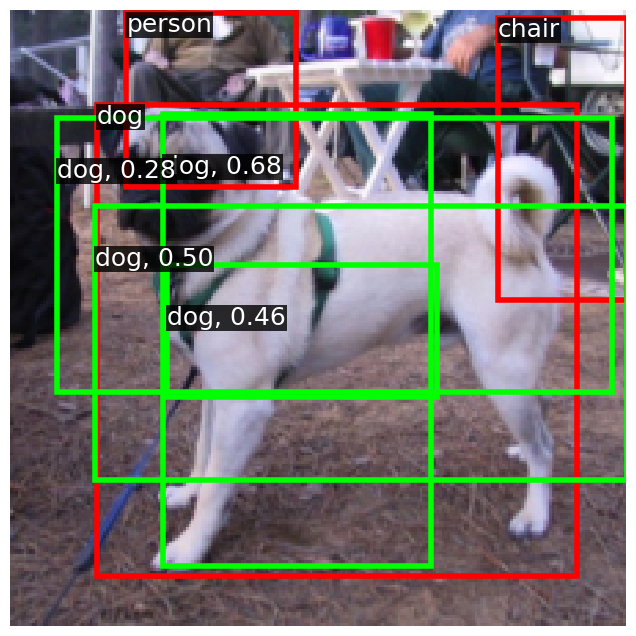

tensor([[ 73.8162,   0.0000, 201.8362, 114.1118],
        [  0.0000,   0.0000,  88.7079, 122.9607],
        [  0.0000,  24.2178, 188.1272, 123.0085],
        [  4.4263,   0.0000, 198.3961,  57.8766],
        [ 54.2310,   0.0000, 151.5020,  93.0058],
        [ 41.2447, 130.7255, 169.0182, 224.0000],
        [ 39.0707,   4.6233, 137.4091, 171.1940],
        [ 86.6826,  20.2959, 184.6848, 187.8364],
        [139.4748,   0.0000, 224.0000, 122.6981],
        [ 22.6051, 116.0453, 121.0013, 224.0000],
        [  0.0000,  51.5144, 118.1115, 188.3902],
        [  0.0000, 168.9315, 134.2937, 224.0000],
        [  0.0000, 103.9351, 188.6827, 203.6914],
        [  1.6632,  71.6716, 202.5505, 170.3976],
        [ 25.3339, 168.2051, 215.8425, 224.0000],
        [122.9775,  66.0199, 224.0000, 207.0704],
        [ 99.1438, 119.4894, 224.0000, 217.3870],
        [ 79.1252,  87.3694, 224.0000, 186.2631],
        [  0.0000, 112.0098,  57.1121, 224.0000]], device='cuda:0') tensor([-1, -1, -1, -1, -1, -1, 

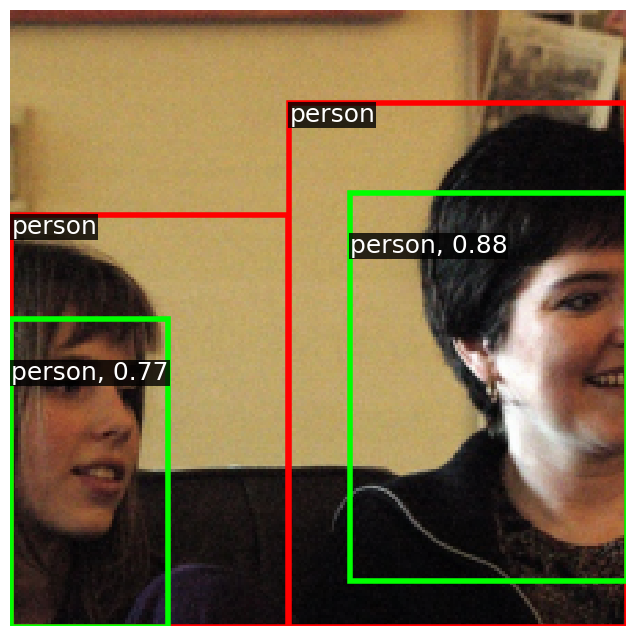

tensor([[ 27.9636, 152.8837, 145.8889, 224.0000],
        [  0.0000,   0.0000,  84.2480, 102.7395],
        [  0.0000,  18.4879,  72.4841, 187.0828],
        [ 84.8009, 152.4741, 224.0000, 224.0000],
        [  0.0000, 111.5833,  57.7309, 224.0000],
        [  0.0000, 133.6293, 102.2036, 224.0000],
        [  0.0000,   0.0000, 181.3117,  57.3567],
        [132.4949, 101.4402, 224.0000, 224.0000],
        [  0.0000,  88.1029, 137.9642, 186.8206],
        [ 15.3131, 117.6458, 219.3779, 218.6806],
        [ 28.4237,   0.0000, 149.9046, 122.5390],
        [149.7283,   0.0000, 224.0000, 124.7149],
        [ 69.9511, 101.3396, 169.6243, 224.0000],
        [ 78.2932,   0.0000, 195.2839,  73.3228],
        [ 39.8362,  39.3032, 135.1265, 204.6140],
        [ 82.2780,   6.0354, 131.6722, 100.1160],
        [  1.6071,  24.5806, 202.0401, 123.0847],
        [ 41.2556,  37.2527, 166.4358, 170.8536],
        [  0.0000,  54.9795, 185.6156, 154.5664],
        [  1.5328,  86.4644, 202.2370, 186.9987],


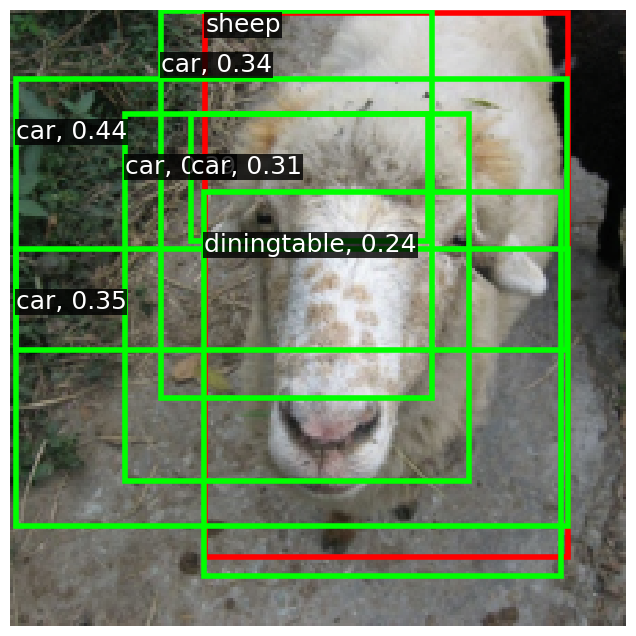

tensor([[  0.0000,   0.0000,  84.3470,  72.1116],
        [ 77.8781,   0.0000, 196.6776,  74.3929],
        [ 25.4306, 168.7075, 215.5452, 224.0000],
        [ 88.9096,   0.0000, 216.4296, 128.1088],
        [  0.0000,  20.5786,  88.2821, 156.4056],
        [  5.8425, 100.3359, 106.4733, 224.0000],
        [  0.0000, 168.9696, 117.8394, 224.0000],
        [ 53.9236,   0.0000, 151.9316,  95.0849],
        [  0.0000, 139.5311,  65.7342, 224.0000],
        [ 67.3610,   0.0000, 130.4618,  66.8923],
        [ 13.6053, 103.4132, 221.1133, 203.7045],
        [ 52.6866,  83.8324, 148.0604, 131.8019],
        [  0.0000,  86.6700, 140.0289, 187.4305],
        [  0.0000,   6.9018, 203.3584, 106.7634],
        [ 65.7263, 133.1656, 117.9805, 224.0000],
        [ 72.5096,  54.3061, 126.9568, 142.3105],
        [ 53.2921,  34.7975, 154.4120, 202.6593],
        [  0.0000,   9.2114, 121.9102, 108.4651],
        [ 73.4761,  65.1182, 201.7508, 208.0799],
        [ 58.5959, 130.8532, 184.7754, 224.0000],


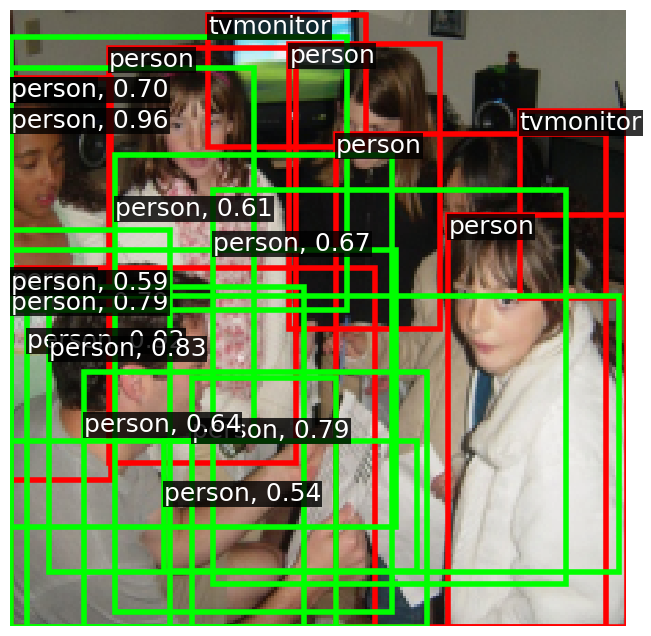

tensor([[  0.0000,   0.0000, 119.0159,  94.5552],
        [  0.0000, 136.8376,  84.1955, 224.0000],
        [ 19.6532,   0.0000, 213.3878,  57.6666],
        [ 86.0991,  67.4426, 185.7554, 224.0000],
        [100.1560,   0.0000, 224.0000,  73.3669],
        [  0.0000,   2.8201,  73.6122, 173.6158],
        [133.8519,  83.8651, 224.0000, 224.0000],
        [ 43.9424, 116.0540, 164.9143, 224.0000],
        [  0.0000, 152.6828, 185.5013, 224.0000],
        [ 78.4955,  71.2266, 224.0000, 170.5047],
        [ 82.1496, 136.4985, 224.0000, 224.0000],
        [ 54.0117,   0.0000, 151.4944,  92.6677],
        [149.7685,   5.2807, 224.0000, 173.8216],
        [  0.0000,  87.6273, 186.8749, 187.1719],
        [  0.0000,   7.5544, 203.0386, 106.9463],
        [  0.0000,  73.1256, 121.1038, 170.2969],
        [ 86.3447,   0.0000, 185.9000, 139.8621],
        [ 38.8744,   3.0367, 137.0886, 169.1260],
        [ 58.4155,  34.5661, 183.3680, 173.2373]], device='cuda:0') tensor([-1, -1, -1, -1, -1, -1, 

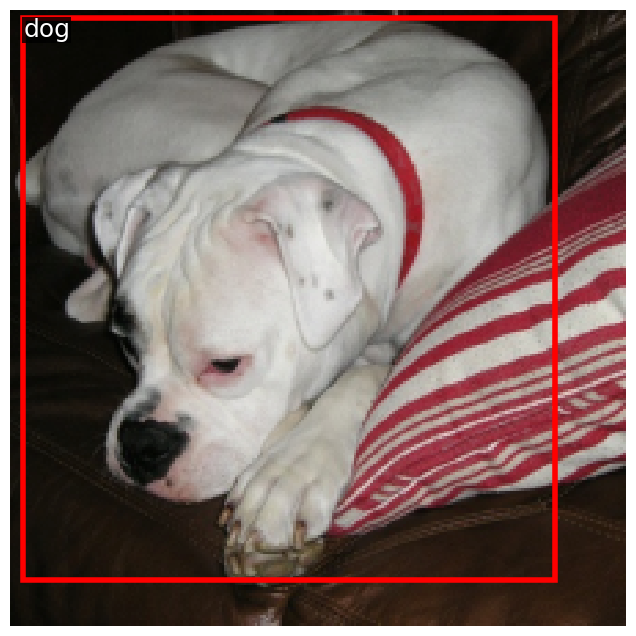

Total inference time: 58.2s


In [41]:
from lib.train import inference_with_detector


# Change the loader to have (batch size = 1) as required for inference.
small_train_loader = torch.utils.data.DataLoader(
    small_dataset, batch_size=1, pin_memory=True, num_workers=NUM_WORKERS
)

inference_with_detector(
    faster_rcnn,
    small_train_loader,
    val_dataset.idx_to_class,
    score_thresh=0.2,
    nms_thresh=0.5,
    device=DEVICE,
    dtype=torch.float32,
)

## Train a net

Now it's time to train the full Faster R-CNN model on a larger subset of the the training data.
We will train for 9000 iterations; this should take about 2-3 hours on a K80 GPU.
Note that real object detection systems typically train for 12-24 hours, distribute training over multiple GPUs, and use much faster GPUs. As such our result will be far from the state of the art, but it should give some reasonable results!

(Optional) If you train the model longer (e.g., 25K+ iterations), you should see a better mAP. But make sure you revert the code back for grading purposes.

For dummy input images with shape: (2, 3, 224, 224)
Shape of c3 features: torch.Size([2, 64, 28, 28])
Shape of c4 features: torch.Size([2, 160, 14, 14])
Shape of c5 features: torch.Size([2, 400, 7, 7])
[Iter 0][loss: 3.976][loss_rpn_obj: 0.692][loss_rpn_box: 0.231][loss_cls: 3.053]
[Iter 50][loss: 1.970][loss_rpn_obj: 0.569][loss_rpn_box: 0.242][loss_cls: 1.159]
[Iter 100][loss: 2.061][loss_rpn_obj: 0.586][loss_rpn_box: 0.227][loss_cls: 1.248]
[Iter 150][loss: 1.650][loss_rpn_obj: 0.590][loss_rpn_box: 0.242][loss_cls: 0.818]
[Iter 200][loss: 1.446][loss_rpn_obj: 0.543][loss_rpn_box: 0.211][loss_cls: 0.692]
[Iter 250][loss: 1.241][loss_rpn_obj: 0.496][loss_rpn_box: 0.216][loss_cls: 0.529]
[Iter 300][loss: 1.370][loss_rpn_obj: 0.569][loss_rpn_box: 0.226][loss_cls: 0.576]
[Iter 350][loss: 1.416][loss_rpn_obj: 0.536][loss_rpn_box: 0.227][loss_cls: 0.653]
[Iter 400][loss: 1.213][loss_rpn_obj: 0.448][loss_rpn_box: 0.212][loss_cls: 0.552]
[Iter 450][loss: 0.984][loss_rpn_obj: 0.429][loss_rpn_

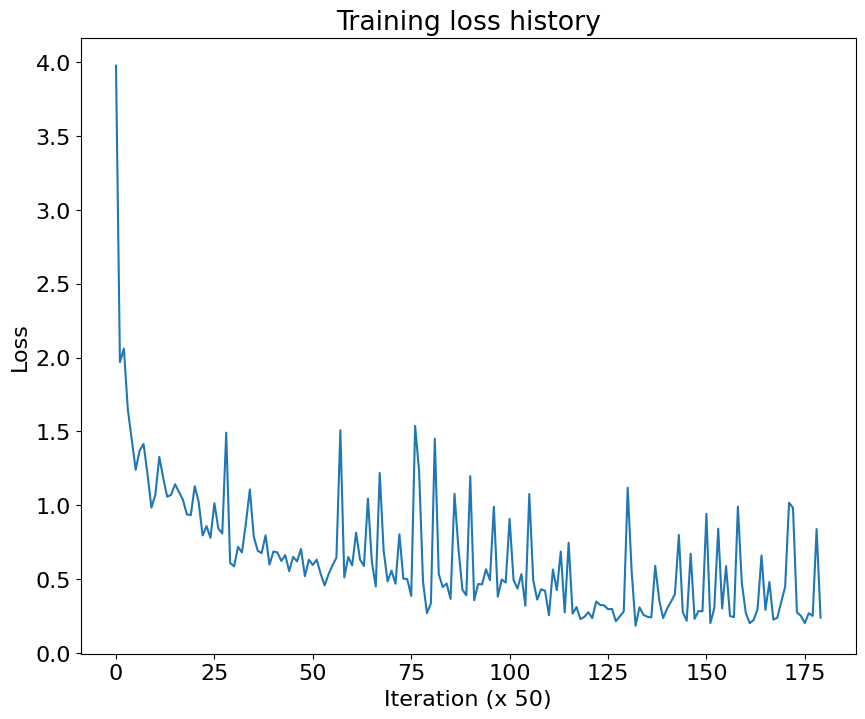

In [42]:
from two_stage_detector import RPN, FasterRCNN
reset_seed(0)

# Slightly larger detector than in above cell.
FPN_CHANNELS = 128
backbone = DetectorBackboneWithFPN(out_channels=FPN_CHANNELS)
rpn = RPN(
    fpn_channels=FPN_CHANNELS,
    stem_channels=[FPN_CHANNELS, FPN_CHANNELS],
    batch_size_per_image=16,
    pre_nms_topk=500,
    post_nms_topk=200  # Other args from previous cell are default args in RPN.
)
# fmt: off
faster_rcnn = FasterRCNN(
    backbone, rpn, num_classes=NUM_CLASSES, roi_size=(7, 7),
    stem_channels=[FPN_CHANNELS, FPN_CHANNELS],
    batch_size_per_image=32,
)
# fmt: on

train_detector(
    faster_rcnn,
    train_loader,
    learning_rate=0.005,
    max_iters=9000,
    log_period=50,
    device=DEVICE,
)

# After you've trained your model, save the weights for submission.
weights_path = os.path.join(PATH, "rcnn_detector.pt")
torch.save(faster_rcnn.state_dict(), weights_path)

### Inference

VIsualize a few outputs from the full trained model. They may be less accurate than FCOS.
This is expected since our Faster R-CNN model is weaker than expected: we used a smaller model, trained for short duration, and did not include box regression in the second stage.

For dummy input images with shape: (2, 3, 224, 224)
Shape of c3 features: torch.Size([2, 64, 28, 28])
Shape of c4 features: torch.Size([2, 160, 14, 14])
Shape of c5 features: torch.Size([2, 400, 7, 7])


/tmp/ipykernel_1327642/3290446729.py:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  faster_rcnn.load_state_dict(torch.load(weights_path, map_location="cpu"))


tensor([[136.8685,  26.9872, 216.8470,  81.4526],
        [141.2521,  48.9728, 224.0000, 106.9048],
        [  0.0000,  75.9940,  61.6568, 136.7164],
        [157.6655,   6.9792, 204.1304,  86.2533],
        [ 13.4725, 142.9002,  63.7534, 224.0000],
        [147.7296, 163.3601, 199.8726, 219.9116],
        [125.2579,  51.2279, 224.0000, 159.6276],
        [  0.0000, 104.2903,  72.8899, 147.7176],
        [130.4467,  97.1202, 212.9309, 149.0941],
        [ 15.1404,  10.3055,  82.3178,  78.2860],
        [  0.0000, 126.8640,  47.3244, 224.0000],
        [160.7987,  73.8264, 201.0424, 160.4276],
        [  0.0000, 157.2085,  58.4933, 204.7373],
        [159.7773, 141.2889, 205.5571, 214.9187],
        [ 90.2703,  31.2803, 159.2792, 105.1284],
        [ 26.5432, 104.3611,  85.6764, 170.6383],
        [111.3009, 151.0670, 154.8275, 224.0000],
        [ 42.0982,  80.0264, 102.8186, 151.8177],
        [  0.0000, 180.3209,  73.4582, 222.3452],
        [  0.0000, 169.9587,  44.6451, 212.3450],


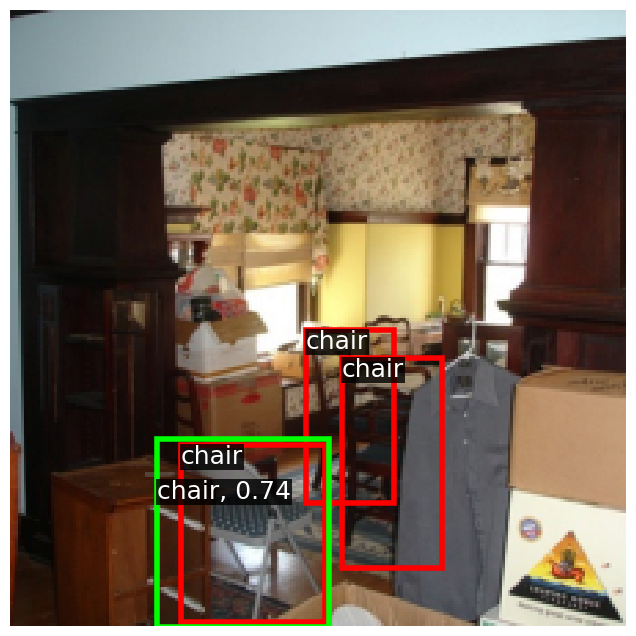

tensor([[116.3320,  66.7325, 224.0000, 147.7325],
        [130.9142, 105.0302, 166.3939, 195.1478],
        [ 51.0441,  28.1823, 101.7098, 119.2897],
        [114.9088, 111.0596, 190.4443, 172.4733],
        [ 99.3186,  26.2072, 224.0000, 103.4888],
        [175.1925,   0.0000, 224.0000, 122.4825],
        [  1.7760,   0.0000, 224.0000, 211.3209],
        [  0.0000,  14.5203,  62.8115, 145.1246],
        [ 91.8596, 131.1193, 173.7619, 224.0000],
        [ 61.0526,   0.0000, 189.7246,  81.5462],
        [137.9630,   0.0000, 224.0000,  72.9229],
        [ 15.0905,   0.0000, 103.5128,  99.3501],
        [  0.0000,   0.0000, 205.6865,  29.4326],
        [ 81.4442,   0.0000, 197.2622, 147.9983],
        [  0.0000,   0.0000,  73.6063,  45.4295],
        [118.1445,   0.0000, 224.0000,  33.7740],
        [121.5381, 152.7447, 203.3697, 224.0000],
        [ 95.8067, 147.2820, 224.0000, 208.2525],
        [ 60.3596, 182.0293, 224.0000, 224.0000],
        [127.9279, 103.3316, 224.0000, 198.9841],


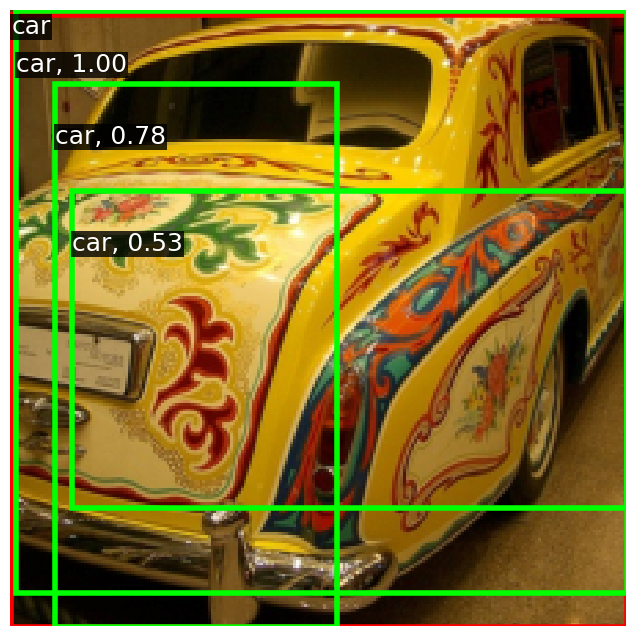

tensor([[ 26.5480,  34.0754,  72.2145, 112.0354],
        [  9.3351,  50.5348, 100.3112, 103.1392],
        [  0.0000,  90.4100,  75.8350, 137.8290],
        [ 44.1202,  97.5979, 110.4717, 224.0000],
        [151.7249, 202.8724, 224.0000, 224.0000],
        [ 83.2545, 189.3129, 171.0239, 224.0000],
        [ 70.8124, 179.2420, 132.8264, 224.0000],
        [ 34.3662, 146.6155,  88.1378, 218.3211],
        [ 30.7362, 151.1384, 146.6952, 224.0000],
        [ 17.7792, 196.1032, 101.2402, 224.0000],
        [105.3388, 205.2243, 195.6626, 224.0000],
        [ 37.0045, 105.3676,  78.9671, 192.0303],
        [ 91.1518,  10.4090, 136.8029, 106.2552],
        [156.2181, 172.1707, 224.0000, 219.4220],
        [ 99.3535,  24.0929, 159.8256,  84.5184],
        [ 52.6021,  99.5140, 132.1882, 185.1026],
        [114.5797, 170.2282, 164.5198, 224.0000],
        [ 46.7837,  32.2584,  93.7028, 120.0579],
        [ 88.9045, 148.6902, 138.0437, 222.9857],
        [ 42.3068,  73.0350,  90.7897, 156.7424],


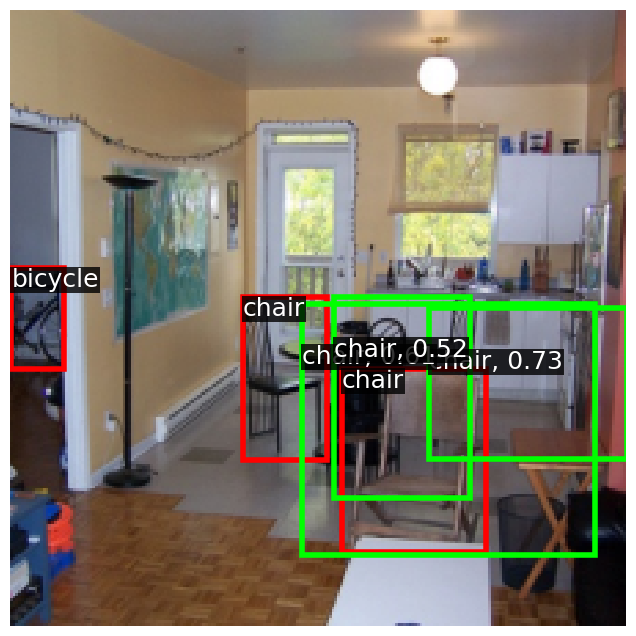

tensor([[153.3165,  52.8138, 224.0000, 103.7647],
        [ 41.7983,  57.1117,  88.4885, 141.8832],
        [ 23.5928,   1.1535,  77.5687, 103.8048],
        [  9.3129, 110.1512,  98.3785, 161.4608],
        [ 20.4895,  70.2793,  91.7473, 212.6809],
        [174.2737,  11.0448, 221.9308,  98.0882],
        [ 99.1003, 132.7482, 158.6528, 224.0000],
        [ 17.1003, 101.9091, 168.4840, 186.5092],
        [117.7798, 173.1297, 204.0205, 224.0000],
        [143.7998,  15.7589, 197.0862,  82.3639],
        [ 27.3589,  44.7569, 121.5835, 149.7118],
        [ 96.7793,  60.1403, 215.6040, 157.1407],
        [154.5172,  70.4209, 221.3768, 135.9884],
        [ 53.5372,  32.7564, 196.6148, 124.0828],
        [ 34.0480, 100.8804, 117.3701, 148.9348],
        [121.6422, 144.4178, 174.1627, 224.0000],
        [119.1393,  38.2491, 188.0485, 184.3857],
        [ 80.7279, 144.8210, 160.0570, 194.9665],
        [ 87.0452,   5.7780, 165.3219,  51.9269],
        [  6.4003,  66.8814,  72.4815, 135.6649],


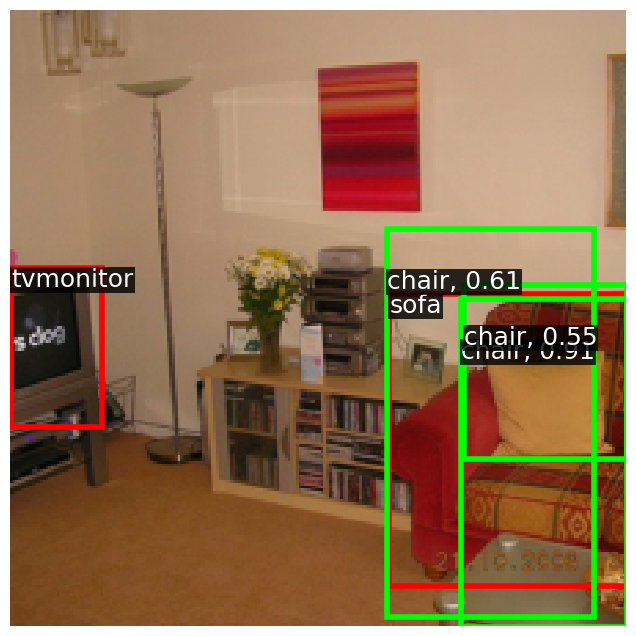

tensor([[ 35.5187,  10.9192,  73.5088,  90.3240],
        [ 23.0970,  22.3175,  93.0683,  75.8629],
        [ 31.4504,  54.7480, 112.2072, 101.1051],
        [  5.8055,   1.9796, 134.2647, 119.8042],
        [144.1868,  97.3203, 224.0000, 177.0944],
        [ 62.7179,  52.0797, 110.6317, 142.8276],
        [ 31.1551, 151.4451,  73.6589, 224.0000],
        [  0.0000,  18.9011,  30.2081, 123.0559],
        [105.1686,  97.7342, 199.8390, 189.1576],
        [ 26.1557,   0.0000, 102.7726, 182.3453],
        [ 94.5547,  39.8939, 151.8344, 109.1473],
        [ 22.2661, 108.7593, 112.2754, 155.4857],
        [ 43.4810,  70.0871, 136.6808, 117.5120],
        [ 15.2287,  72.5294, 143.3155, 195.0863],
        [ 18.6876, 166.7610,  89.7722, 220.6528],
        [ 38.9538,  66.4500,  79.8481, 153.2950],
        [ 48.3591,  90.7715,  92.9590, 185.5955],
        [176.0972, 129.2068, 220.7279, 224.0000],
        [ 55.7647, 126.2879,  93.9738, 211.1655],
        [ 17.2934,  90.8764, 109.4911, 138.9644],


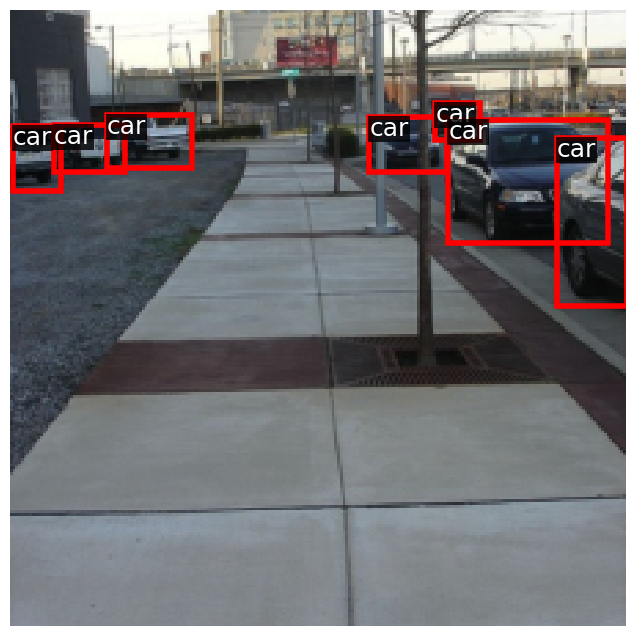

tensor([[  6.6986,  85.4293,  99.3042, 223.3126],
        [ 62.3906, 119.3219, 224.0000, 199.7767],
        [153.4226,  67.6645, 224.0000, 115.9828],
        [ 89.4564, 106.2397, 134.6638, 204.0916],
        [ 83.1728, 126.8124, 160.1275, 193.9604],
        [ 62.2687,  86.8393, 224.0000, 163.3862],
        [  0.0000,   0.0000, 101.2227,  61.0161],
        [  0.0000, 135.5047,  49.9318, 224.0000],
        [ 92.9636,  55.3530, 199.3129, 178.0486],
        [ 67.0823,  46.7003, 222.2922, 134.6967],
        [  0.0000, 120.2332, 180.9511, 221.0785],
        [ 35.8581, 118.2624, 106.7078, 190.2032],
        [ 34.6224,  77.0699, 114.8840, 156.5222],
        [ 76.3030, 167.6494, 224.0000, 224.0000],
        [ 64.0310,   0.0000, 151.6096, 123.8291],
        [ 48.9485, 148.8218, 143.9765, 224.0000],
        [141.1442,  30.9326, 207.7987, 208.6668],
        [  0.0000,   0.0000, 124.1301,  33.6638],
        [ 13.4581, 173.4801, 186.9915, 224.0000],
        [ 17.6375,   0.0000, 197.3616,  70.2072],


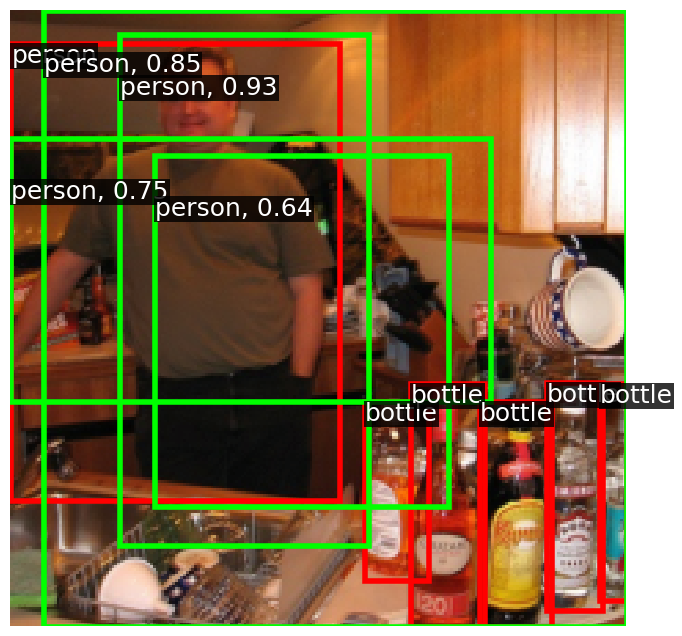

tensor([[ 30.1960, 114.7584, 114.2605, 179.4601],
        [ 53.1442,  76.7008,  93.3892, 188.2972],
        [ 34.6110,  71.5544,  99.2699, 224.0000],
        [ 31.4933, 102.8973, 137.4696, 210.2254],
        [  0.0000, 117.5963,  67.2708, 193.2313],
        [108.9801,  41.2473, 188.6246, 224.0000],
        [ 95.8159, 122.8085, 201.8764, 170.8601],
        [ 33.4043,  98.2764, 116.9940, 157.0377],
        [  0.0000,  22.1282,  63.1571, 224.0000],
        [  6.4685,  89.2212,  38.7933, 186.0769],
        [182.3579,  28.7476, 224.0000, 165.1916],
        [ 61.7569,  57.7295, 100.9588, 168.8659],
        [ 29.4417,  13.5425, 112.7435, 177.9085],
        [  0.0000,  75.7354,  83.7942, 189.7448],
        [ 68.7291,  67.3284, 194.5731, 191.7908],
        [ 67.1518, 133.0571, 103.4872, 224.0000],
        [136.1511,  59.6780, 179.0163, 163.5262],
        [ 96.2815,  11.7004, 205.1743,  62.7052],
        [ 35.4104, 116.2148, 218.2580, 199.3114],
        [168.7478, 110.4361, 224.0000, 192.5538],


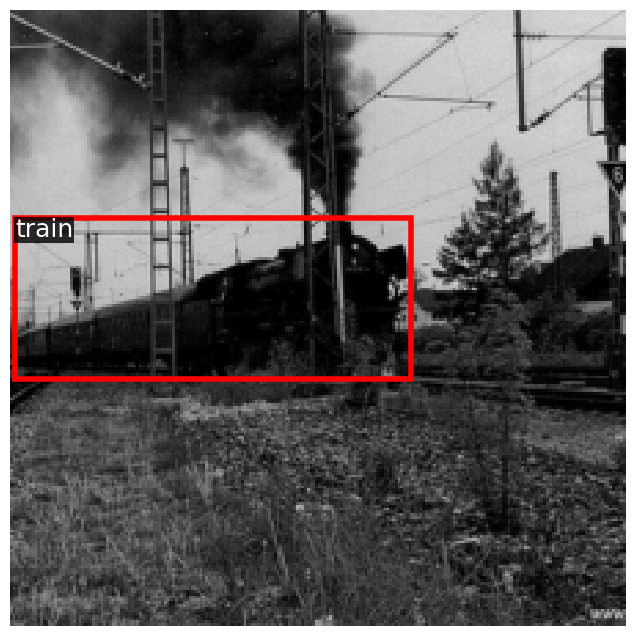

tensor([[151.0086,   0.0000, 224.0000, 113.4331],
        [  0.0000, 143.7824,  92.7319, 224.0000],
        [110.3448,  99.9734, 185.8870, 184.1174],
        [  0.0000,   0.0000, 100.2256, 106.1438],
        [ 68.8899,   0.0000, 182.6754,  64.6096],
        [121.3568, 114.2227, 172.2025, 212.9199],
        [ 98.7392, 151.9981, 209.0076, 206.4621],
        [  0.0000, 176.6456, 187.3801, 224.0000],
        [139.5699, 100.3920, 224.0000, 208.9926],
        [107.9108,  18.6374, 224.0000,  94.4029],
        [ 41.5394,   7.4377, 107.6083, 113.6386],
        [109.1235,  29.7274, 191.0279, 122.4113],
        [ 41.7585,   0.0000, 203.3993,  35.7067],
        [ 70.4303, 132.2027, 168.2250, 224.0000],
        [ 85.5844, 179.0340, 224.0000, 224.0000],
        [  0.0000,   0.0000, 122.0466,  32.8715],
        [ 30.8518,  44.6711, 134.9216, 108.5610],
        [  0.0000,   7.5275, 221.5934, 217.7308],
        [  0.0000,  19.1539, 160.8653,  94.2125],
        [123.0555,  57.7610, 220.8707, 177.1291],


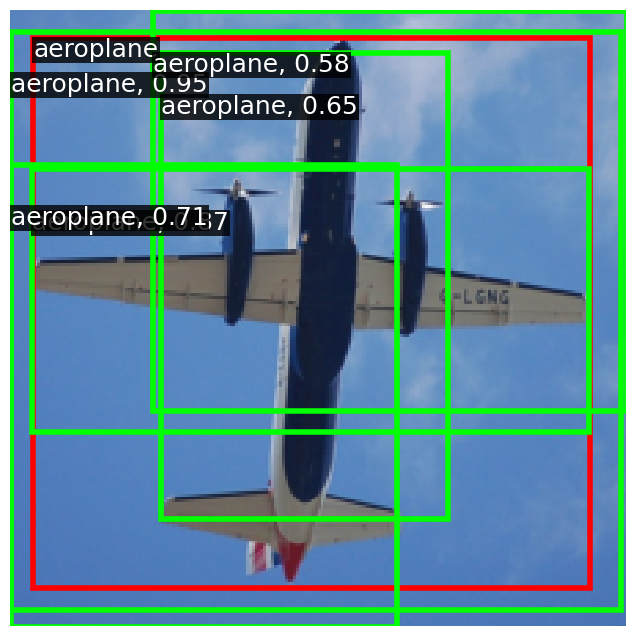

tensor([[0.0000e+00, 1.8193e+02, 7.9865e+01, 2.2400e+02],
        [0.0000e+00, 1.3368e+02, 4.4300e+01, 2.2400e+02],
        [1.7467e+01, 1.4655e+02, 2.2400e+02, 2.2366e+02],
        [5.0722e+01, 1.8815e+02, 2.2400e+02, 2.2400e+02],
        [0.0000e+00, 0.0000e+00, 1.3881e+02, 3.0280e+01],
        [3.7585e+01, 7.1370e+00, 2.0419e+02, 1.1558e+02],
        [2.2473e+01, 1.0234e+02, 2.2400e+02, 2.0693e+02],
        [4.0760e+01, 1.1839e+02, 1.6103e+02, 2.2400e+02],
        [2.1505e+00, 2.3511e+01, 1.2251e+02, 1.9279e+02],
        [0.0000e+00, 1.5328e+02, 1.3373e+02, 2.2400e+02],
        [8.7429e+01, 1.7471e+02, 1.7933e+02, 2.2056e+02],
        [1.2913e+02, 6.6256e+01, 2.1035e+02, 2.2400e+02],
        [8.7672e+01, 7.9120e+01, 1.7293e+02, 2.2400e+02],
        [1.4637e+00, 0.0000e+00, 1.1195e+02, 5.6064e+01],
        [0.0000e+00, 1.0199e+02, 6.8665e+01, 2.2400e+02],
        [2.4116e+01, 5.4904e+01, 1.9694e+02, 1.5533e+02],
        [8.9318e+01, 9.0650e+01, 2.2400e+02, 1.5808e+02],
        [1.485

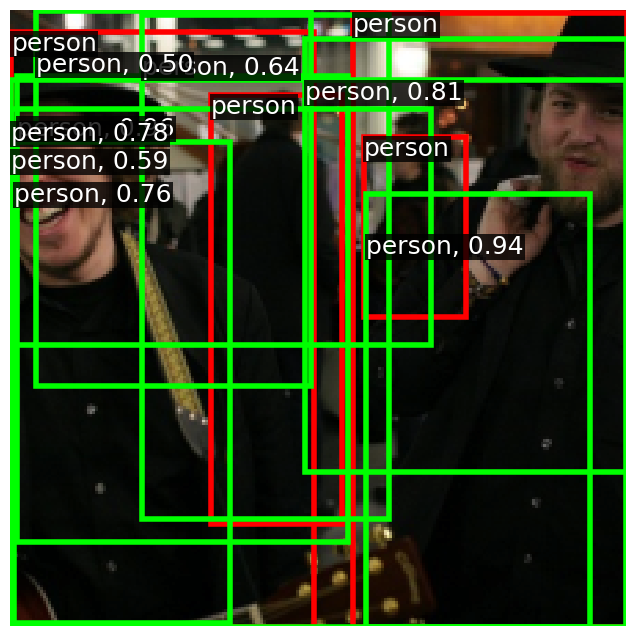

tensor([[  0.6197,  12.7765, 222.7507, 215.9968],
        [ 33.9445, 144.1137, 132.6200, 224.0000],
        [138.8245,  95.0646, 224.0000, 197.7782],
        [ 70.6386, 137.6541, 167.0397, 224.0000],
        [  0.0000, 176.9797, 105.4348, 224.0000],
        [149.5098,   0.0000, 222.9123,  79.5634],
        [ 73.6722,   0.0000, 164.9263, 122.2335],
        [ 98.9120, 138.2901, 224.0000, 207.8107],
        [125.5309,   0.0000, 223.8665, 121.1631],
        [  0.0000,  60.2470,  99.7593, 183.4463],
        [115.3592,  46.2607, 224.0000, 158.7788],
        [107.7638, 109.7885, 186.8000, 224.0000],
        [  0.0000, 158.8574, 190.4836, 224.0000],
        [  3.2037,  32.2740,  67.5674, 215.4038],
        [  4.1758,  17.9911, 127.5752, 149.6326],
        [ 58.4804, 181.8464, 224.0000, 224.0000],
        [ 53.6580,  90.2184, 146.0332, 224.0000],
        [ 42.0752,   0.0000, 213.0134,  33.3420],
        [  0.0000,   0.0000, 108.9826,  83.4477],
        [ 66.2069,  78.3610, 224.0000, 174.2922],


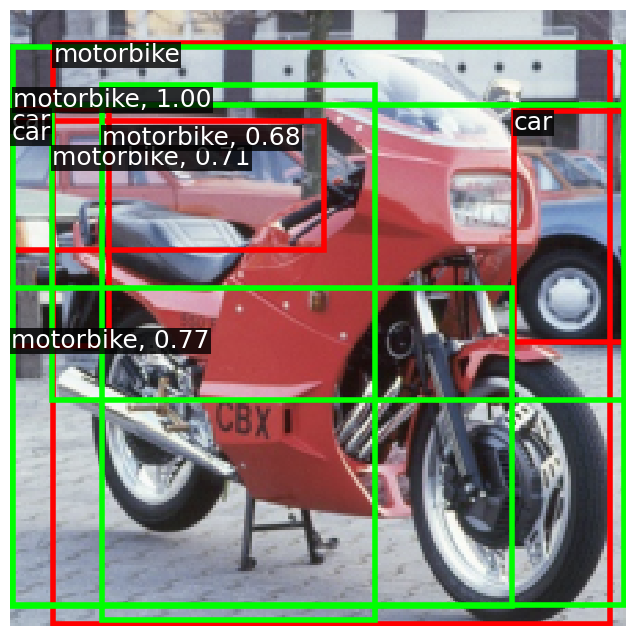

tensor([[ 46.0283, 112.3667, 137.5627, 172.9148],
        [101.7841, 192.3548, 224.0000, 224.0000],
        [ 67.2875,  83.7973, 117.1108, 180.7918],
        [  0.0000, 145.7941,  84.3136, 224.0000],
        [ 57.5390,   0.0000, 167.8932, 121.5938],
        [ 91.4706, 106.0721, 171.0816, 224.0000],
        [100.6155,  86.0163, 224.0000, 157.5979],
        [ 32.0930,   0.0000, 212.0586,  43.7459],
        [ 10.0399,   0.0000, 101.6916, 109.7503],
        [ 34.2244, 103.9002, 113.3477, 224.0000],
        [  0.0000,   0.0000, 120.9348,  32.1919],
        [ 57.4251,  36.1146, 224.0000, 146.4292],
        [156.4460,   0.0000, 224.0000,  88.0509],
        [  0.0000,  57.8141, 132.2253, 146.4472],
        [137.0186, 162.9167, 224.0000, 224.0000],
        [  0.0000,  10.2059, 217.6880, 219.5403],
        [  0.7188,  64.8638,  89.3220, 202.0667],
        [ 54.7691, 146.3220, 224.0000, 224.0000],
        [  0.0000, 126.1557, 169.1218, 224.0000],
        [126.1488,   0.0000, 224.0000,  28.8700],


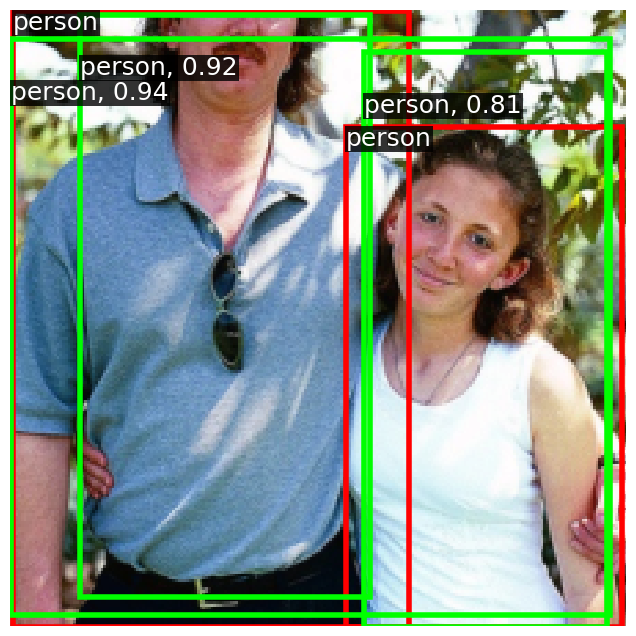

tensor([[107.6507,  71.8991, 208.9211, 189.7082],
        [108.7664, 135.0159, 224.0000, 202.4332],
        [136.6184,  28.0680, 224.0000, 163.5031],
        [ 64.6995,   0.0000, 170.3724,  53.3855],
        [177.2978,  12.4482, 223.2155, 119.8833],
        [ 40.1992,   0.0000, 116.1272,  62.6684],
        [156.6938,  48.7052, 203.3122, 158.9732],
        [100.5535,  17.6466, 207.6136, 142.8410],
        [  0.0000, 148.9444,  78.3847, 218.7910],
        [150.0645,   0.0000, 224.0000,  94.8491],
        [ 35.7495,  20.6693, 224.0000,  92.4690],
        [121.7119, 123.0521, 174.0328, 183.3104],
        [100.4605,   0.0000, 224.0000,  43.5368],
        [ 15.5337,  28.0017, 121.8442, 143.5559],
        [  0.3047,   2.9309,  92.5952, 131.2537],
        [ 36.2271,   0.0000, 224.0000,  66.4785],
        [180.7006,  78.5031, 224.0000, 183.7058],
        [155.6345,  66.2674, 224.0000, 224.0000],
        [135.3716,  89.7201, 223.4213, 139.7934],
        [ 43.8221,  63.7845, 213.6331, 161.6210],


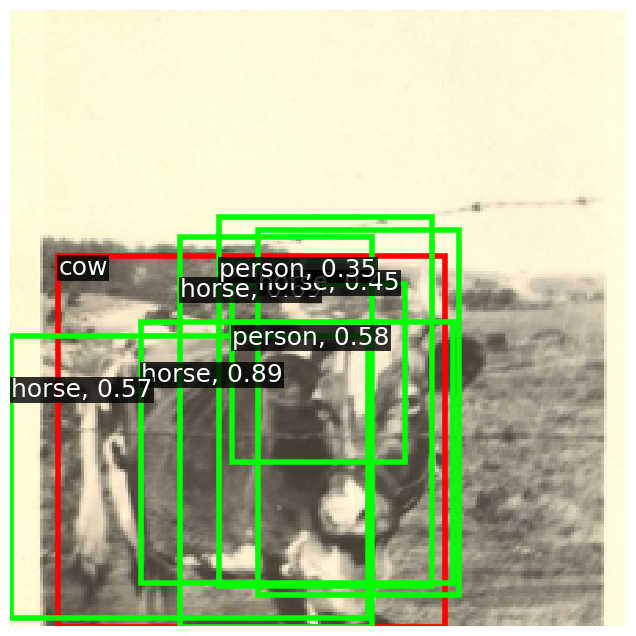

tensor([[ 57.9824, 131.7131, 148.9518, 224.0000],
        [ 88.1055, 144.6671, 172.0171, 206.6456],
        [116.8180, 114.5718, 164.0146, 224.0000],
        [136.8244, 145.7250, 224.0000, 224.0000],
        [102.0811,  95.7410, 147.7899, 204.4395],
        [103.0882, 128.4804, 194.9837, 180.5707],
        [  0.0000, 146.1491,  91.5435, 224.0000],
        [ 70.8534, 121.7057, 224.0000, 201.5788],
        [  0.0000, 118.3391, 131.4919, 213.8322],
        [ 60.4211, 168.4613, 224.0000, 224.0000],
        [156.5371,  14.2066, 224.0000, 165.5912],
        [156.6547,  67.2691, 224.0000, 224.0000],
        [ 46.7477,  17.8887,  97.0745, 113.7057],
        [ 33.0942,  57.8997, 112.4620, 102.4613],
        [ 44.8666,  91.3081, 167.4127, 202.1575],
        [ 99.5062, 110.7252, 193.7570, 161.3171],
        [ 48.0602,  57.1875, 126.0505, 223.8915],
        [ 33.2740,  10.3311, 152.3221, 120.0671],
        [  0.0000,   0.0000,  96.2093, 111.6118],
        [ 39.5324,   5.8809, 106.4340,  73.1555],


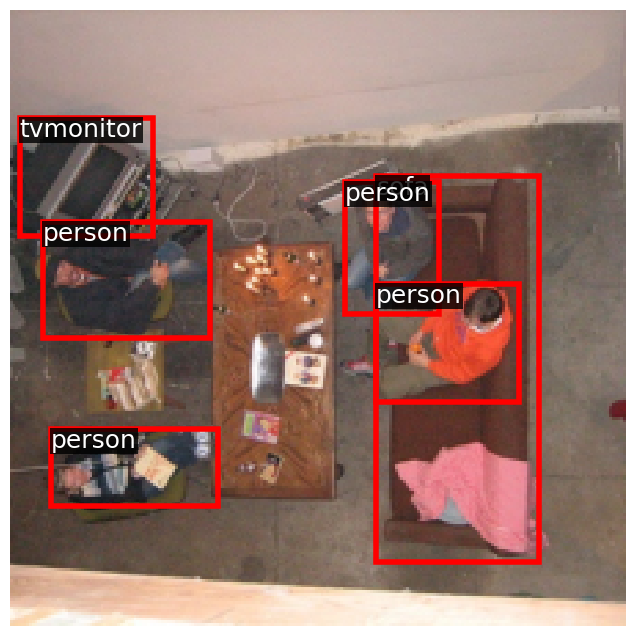

tensor([[  0.0000, 154.9174, 163.7094, 224.0000],
        [  0.0000,  27.2938, 119.0474, 106.5828],
        [  0.0000, 109.4358, 165.1046, 199.4876],
        [ 12.3128,  26.9640, 175.9664, 124.6875],
        [ 46.6043, 184.5726, 224.0000, 224.0000],
        [  7.5185,   0.0000,  84.7490, 152.3979],
        [  0.0000,   0.0000, 132.2495,  71.8255],
        [  0.0000,  69.3628, 132.4533, 158.5688],
        [ 89.2280,  12.6774, 224.0000,  80.8026],
        [ 66.4088,   0.0000, 192.1897, 111.0877],
        [ 98.3951,  37.8012, 224.0000, 111.3715],
        [ 16.2176,  12.4888, 109.5122, 224.0000],
        [157.5952,   0.0000, 224.0000,  74.8777],
        [  3.7056,  94.5884,  85.4756, 224.0000],
        [ 35.6089,   0.0000, 122.4865, 164.3518],
        [ 87.7930,   5.7257, 224.0000, 224.0000],
        [ 96.5636, 111.6257, 186.4303, 193.5529],
        [ 47.8865, 128.8433, 185.6652, 224.0000],
        [103.6463, 100.2211, 224.0000, 175.7126],
        [ 36.5067,  67.6538, 224.0000, 161.8360],


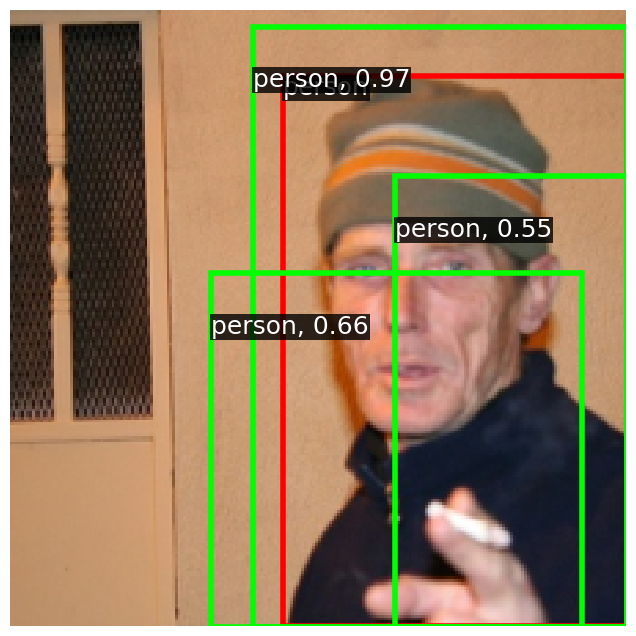

tensor([[  0.0000, 166.2021,  73.9069, 215.6355],
        [  0.0000, 185.8925,  70.9285, 224.0000],
        [ 96.6912,  11.6375, 185.7191, 135.4966],
        [ 85.7460,   0.0000, 158.1977,  96.8805],
        [ 60.7161,  33.6405, 136.7947, 166.0811],
        [118.5436,  28.7408, 218.6811, 164.8299],
        [ 66.6912,  63.4280, 107.7601, 183.0389],
        [  7.1105, 152.8321,  52.5594, 224.0000],
        [ 47.6738,  40.8200, 184.7510, 124.3220],
        [ 57.4501,  21.0177, 224.0000,  98.2452],
        [126.1012,  79.1037, 173.5286, 151.6290],
        [ 32.3656,  17.1880, 103.5868, 157.2763],
        [126.9311,  98.1098, 221.1627, 146.3448],
        [154.7724,  56.5499, 197.7609, 139.8784],
        [ 54.4787,  67.3140,  94.0716, 177.8151],
        [  0.0000,  31.5581,  75.2965, 219.8064],
        [  0.0000,  55.0546, 114.5928, 172.0753],
        [ 41.1528,   0.0000, 206.1762,  38.1511],
        [ 76.8593,  86.8472, 144.4680, 158.8533],
        [144.8750, 171.6617, 224.0000, 221.3006],


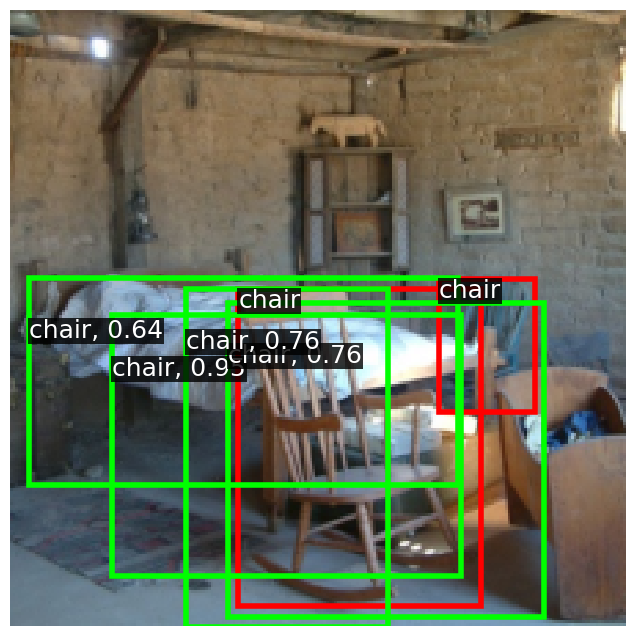

tensor([[1.1340e+02, 8.9554e+01, 1.9401e+02, 1.4358e+02],
        [1.7760e+02, 0.0000e+00, 2.2400e+02, 1.8267e+02],
        [1.2012e+02, 1.9281e+01, 2.1214e+02, 1.7098e+02],
        [0.0000e+00, 1.4587e+02, 7.9864e+01, 1.9935e+02],
        [9.5900e+01, 8.0541e+01, 2.0238e+02, 1.8947e+02],
        [6.4747e-02, 8.6414e+00, 8.6792e+01, 5.6425e+01],
        [3.8969e+01, 0.0000e+00, 1.0300e+02, 5.3227e+01],
        [8.8888e+01, 0.0000e+00, 2.2400e+02, 7.8528e+01],
        [7.3333e+01, 6.1419e+01, 2.2400e+02, 1.4667e+02],
        [1.2988e+02, 5.6846e+01, 1.8092e+02, 1.4635e+02],
        [1.1104e+01, 0.0000e+00, 6.3954e+01, 8.2580e+01],
        [0.0000e+00, 1.0793e+02, 1.0126e+02, 2.1311e+02],
        [9.7282e+01, 1.0020e+02, 1.7184e+02, 2.2400e+02],
        [6.2771e+01, 7.4451e+01, 1.0613e+02, 1.6373e+02],
        [1.3932e+02, 1.0631e+02, 2.2400e+02, 2.2400e+02],
        [5.6010e+01, 2.4763e+01, 9.7082e+01, 1.1261e+02],
        [7.7986e+01, 7.0254e+01, 1.5390e+02, 2.0677e+02],
        [7.800

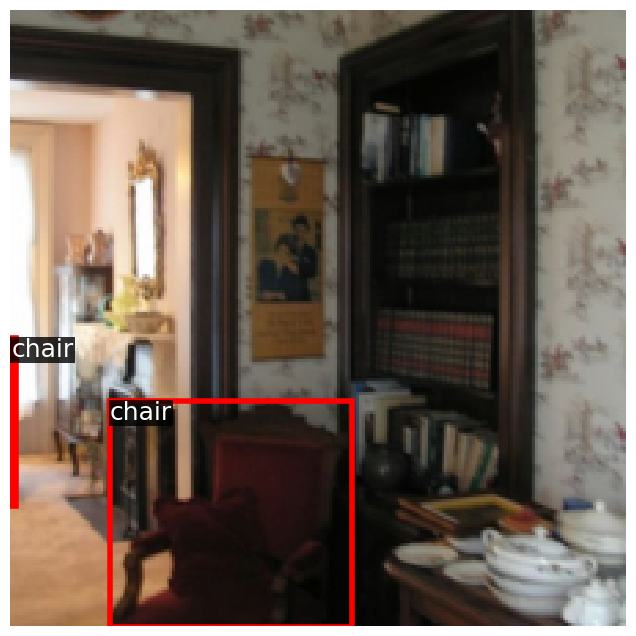

tensor([[162.4260,  81.5124, 224.0000, 136.3202],
        [104.8290,  71.5848, 143.0123, 147.8406],
        [138.7917, 101.0229, 224.0000, 144.5400],
        [145.3463,  22.4703, 224.0000,  77.5980],
        [  2.7269,  40.9519,  70.6041, 209.4958],
        [149.2692,   0.0000, 219.7953, 189.7115],
        [181.0235,  48.3274, 223.8110, 144.8905],
        [  0.0000, 138.8768,  85.4951, 224.0000],
        [153.5709,   0.0000, 224.0000,  50.4300],
        [ 93.0197,  62.9566, 157.6849, 123.6311],
        [144.7597,  79.0344, 224.0000, 207.1971],
        [164.5343,  68.9275, 224.0000, 114.2245],
        [  0.7359,  72.7663,  88.5405, 117.8351],
        [ 19.9104,   0.0000, 183.6694,  42.3573],
        [ 63.2916,  77.5626, 211.8298, 163.7521],
        [ 42.1582, 151.1822, 130.8024, 224.0000],
        [129.5023, 122.3059, 207.5467, 224.0000],
        [  0.0000, 187.8002, 179.6543, 224.0000],
        [146.7426, 135.0486, 218.4164, 204.4060],
        [118.8813,   0.0000, 219.3273,  75.6160],


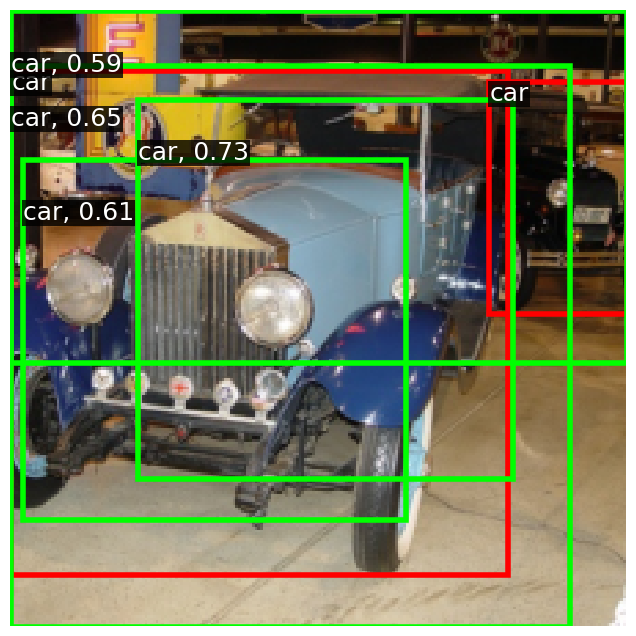

tensor([[ 28.2985,  41.4406, 109.0689, 124.7960],
        [ 10.7558,   0.0000,  63.6253,  52.3842],
        [  0.0000, 171.1217, 162.3771, 224.0000],
        [  0.0000,   0.0000, 131.9599,  33.6366],
        [160.6251, 105.8220, 214.4072, 217.4666],
        [140.5624,   0.0000, 219.0746,  43.7916],
        [131.9223,  80.6624, 219.4700, 224.0000],
        [ 70.9781,  94.2016, 215.0503, 197.6715],
        [110.8352,  31.4683, 185.6209, 218.8582],
        [  6.5092, 124.0380,  48.2976, 205.1198],
        [ 18.5966, 149.1755,  61.2498, 224.0000],
        [137.3393,   0.0000, 203.3402,  91.6336],
        [ 65.7269, 169.3616, 223.0535, 224.0000],
        [142.6618, 140.0638, 224.0000, 192.6093],
        [  0.0000,  68.2291,  73.0356, 224.0000],
        [ 93.0260,   0.0000, 134.8153,  64.2151],
        [ 46.7861,  28.1123,  91.6732, 138.0409],
        [ 64.3130,   2.0035, 157.1721,  41.5973],
        [  0.0000, 116.8720, 180.6811, 203.6141],
        [ 86.4109,   0.0000, 142.0786,  25.2331],


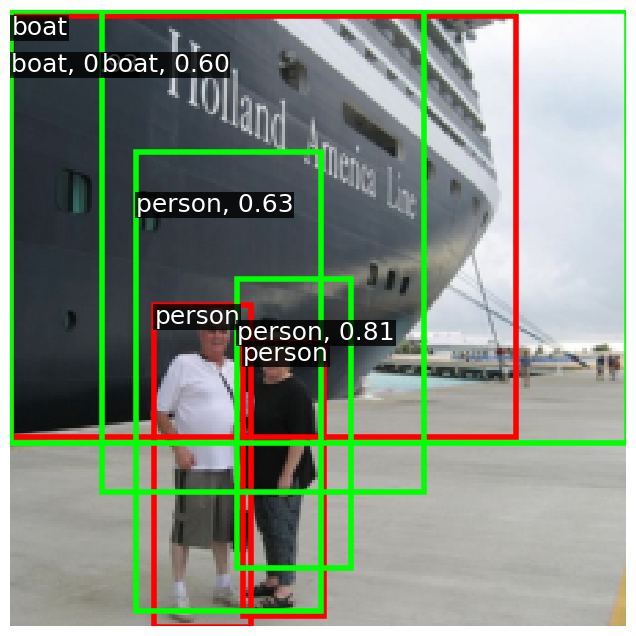

tensor([[159.6677,  38.0060, 224.0000,  94.3450],
        [ 38.7177,  18.4582, 117.1579,  81.4964],
        [ 58.0325,  52.0338, 154.5567, 100.9088],
        [118.1239,  45.8225, 222.7672, 151.7543],
        [110.2728,  28.3786, 198.8427,  75.1296],
        [ 32.0128,  12.0940, 109.1485, 169.3761],
        [137.3868,  38.2010, 180.9381, 134.8030],
        [108.5677,  27.3016, 190.0447, 193.1082],
        [107.6374,  63.6399, 204.7044, 102.6760],
        [  0.0000,  90.5095,  61.1767, 146.5117],
        [ 22.1115,  32.5568, 144.4115, 135.1248],
        [133.0174,   0.0000, 181.2560,  93.7170],
        [ 15.7115, 110.2164, 132.7852, 157.3450],
        [105.6668,  78.0441, 202.6831, 119.1280],
        [178.6198,  12.2345, 221.3027, 116.0234],
        [108.2911, 116.2596, 204.9730, 159.6264],
        [  0.0000,  33.8076,  67.2596, 105.8339],
        [117.2227,   0.0000, 224.0000, 224.0000],
        [160.0751,  91.3685, 205.0636, 199.3612],
        [ 72.0545,  57.4146, 111.5001, 157.5870],


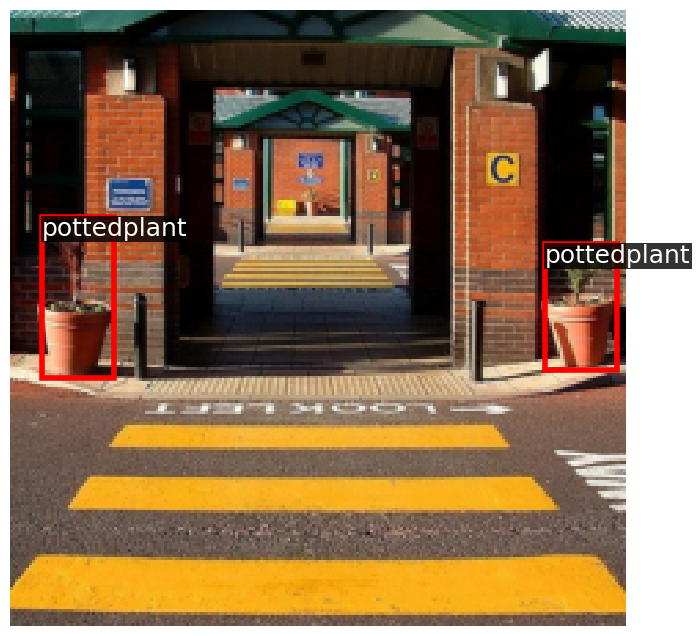

tensor([[124.6706, 126.7587, 212.3481, 224.0000],
        [ 43.9834,  69.1718, 137.4505, 193.6618],
        [ 22.1806, 108.8695, 183.5449, 200.8127],
        [  3.8378,  81.6393, 160.8261, 164.1650],
        [118.2108, 136.8784, 179.4296, 213.8838],
        [ 50.4684,  31.4009, 166.2715, 156.9834],
        [ 21.5861,  38.1524, 124.5376, 163.4939],
        [126.2857,  94.8778, 170.2072, 195.9298],
        [106.6070, 153.6762, 191.7839, 197.0569],
        [ 66.7487, 171.7093, 224.0000, 224.0000],
        [ 60.4406,  40.2098, 104.2320, 150.9065],
        [ 74.1135,  67.6104, 153.1357, 224.0000],
        [  0.0000, 122.6564, 139.3188, 215.5751],
        [ 71.9580, 103.9019, 114.3568, 202.2980],
        [140.7777,  93.0072, 187.8909, 197.8982],
        [131.0406,   0.0000, 219.6656,  23.3700],
        [105.5436,  70.1135, 204.1284, 116.4376],
        [  0.8429,  53.7670,  72.9867, 224.0000],
        [ 65.2000,   0.0000, 139.1307,  37.3798],
        [149.8246,  24.2602, 196.0324, 130.6293],


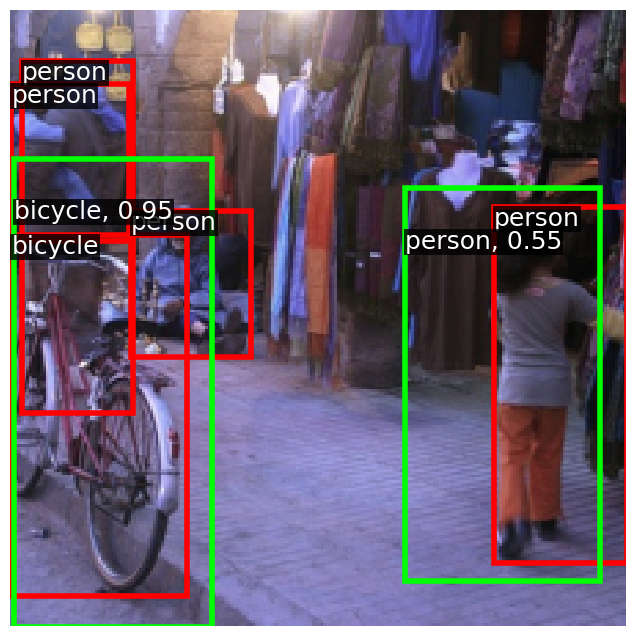

Total inference time: 15.4s


In [43]:
# Add some imports to run this cell independently of above few cells
# (you will need to run first few cells at the top)
from lib.train import inference_with_detector
from fcos import DetectorBackboneWithFPN
from two_stage_detector import RPN, FasterRCNN


# Re-initialize so this cell is independent from prior cells.
# Slightly larger detector than in above cell.
FPN_CHANNELS = 128
backbone = DetectorBackboneWithFPN(out_channels=FPN_CHANNELS)
rpn = RPN(fpn_channels=FPN_CHANNELS, stem_channels=[FPN_CHANNELS, FPN_CHANNELS], batch_size_per_image=16)
faster_rcnn = FasterRCNN(
    backbone, rpn, num_classes=NUM_CLASSES, roi_size=(7, 7),
    stem_channels=[FPN_CHANNELS, FPN_CHANNELS],
    batch_size_per_image=32,
)
faster_rcnn.to(device=DEVICE)

weights_path = os.path.join(PATH, "rcnn_detector.pt")
faster_rcnn.load_state_dict(torch.load(weights_path, map_location="cpu"))

# Prepare a small val daataset for inference:
small_dataset = torch.utils.data.Subset(
    val_dataset,
    torch.linspace(0, len(val_dataset) - 1, steps=20).long()
)
small_val_loader = torch.utils.data.DataLoader(
    small_dataset, batch_size=1, pin_memory=True, num_workers=NUM_WORKERS
)

inference_with_detector(
    faster_rcnn,
    small_val_loader,
    val_dataset.idx_to_class,
    score_thresh=0.1,
    nms_thresh=0.5,
    device=DEVICE,
    dtype=torch.float32,
)

## Evaluation

Evaluate your Faster R-CNN like FCOS.
(**NOTE:** It is okay if your model does not perform as good as your FCOS implementation, since we didn't train for FCOS.)

In [ ]:
inference_with_detector(
    faster_rcnn,
    val_loader,
    val_dataset.idx_to_class,
    score_thresh=0.2,
    nms_thresh=0.5,
    device=DEVICE,
    dtype=torch.float32,
    output_dir="mAP/input",
)
!cd mAP && python main.py

# This script outputs an image containing per-class AP. Display it here:
from IPython.display import Image
Image(filename="./mAP/output/mAP.png")

tensor([[136.8685,  26.9872, 216.8470,  81.4526],
        [141.2521,  48.9728, 224.0000, 106.9048],
        [  0.0000,  75.9940,  61.6568, 136.7164],
        [157.6655,   6.9792, 204.1304,  86.2533],
        [ 13.4725, 142.9002,  63.7534, 224.0000],
        [147.7296, 163.3601, 199.8726, 219.9116],
        [125.2579,  51.2279, 224.0000, 159.6276],
        [  0.0000, 104.2903,  72.8899, 147.7176],
        [130.4467,  97.1202, 212.9309, 149.0941],
        [ 15.1404,  10.3055,  82.3178,  78.2860],
        [  0.0000, 126.8640,  47.3244, 224.0000],
        [160.7987,  73.8264, 201.0424, 160.4276],
        [  0.0000, 157.2085,  58.4933, 204.7373],
        [159.7773, 141.2889, 205.5571, 214.9187],
        [ 90.2703,  31.2803, 159.2792, 105.1284],
        [ 26.5432, 104.3611,  85.6764, 170.6383],
        [111.3009, 151.0670, 154.8275, 224.0000],
        [ 42.0982,  80.0264, 102.8186, 151.8177],
        [  0.0000, 180.3209,  73.4582, 222.3452],
        [  0.0000, 169.9587,  44.6451, 212.3450],
